In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

from sklearn.metrics import confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
import torch
from torch.utils.data import TensorDataset, DataLoader
from tqdm import tqdm
import pickle as pkl

In [2]:
import sys
sys.path.append("..")
from common.utility import to_categorical, torch_device
from notebook_utils.utility import class_plot
from notebook_utils.generate_gaussian import generate_gaussian
from notebook_utils.eigan import Encoder, Discriminator
from notebook_utils.eigan_training import centralized
from notebook_utils.bertran import bertran as bertran_gan
from notebook_utils.metrics import centralized as metrics

In [3]:
device='gpu'
device = torch_device(device=device)
device

device(type='cuda')

# Training

VAR1: 0.2, VAR2: 0.2, TRIAL: 0
X, y_1, y2
(2488, 2) (2488, 1) (2488, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1990, 2) (498, 2) (1990, 1) (498, 1) (1990, 1) (498, 1)
class weights => w1, w2 [2.42979243 1.69940222] [1.55833986 2.79102384]


  0%|          | 0/2001 [00:00<?, ?it/s]/pytorch/torch/csrc/autograd/generated/python_variable_methods.cpp:1334: UserWarning: This overload of add_ is deprecated:
add_(Number alpha, Tensor other)
Consider using one of the following signatures instead:
add_(Tensor other, Number alpha)
/pytorch/torch/csrc/autograd/generated/python_variable_methods.cpp:1550: UserWarning: This overload of addcmul_ is deprecated:
addcmul_(Number value, Tensor tensor1, Tensor tensor2)
Consider using one of the following signatures instead:
addcmul_(Tensor tensor1, Tensor tensor2, Number value)
/pytorch/torch/csrc/autograd/generated/python_variable_methods.cpp:1480: UserWarning: This overload of addcdiv_ is deprecated:
addcdiv_(Number value, Tensor tensor1, Tensor tensor2)
Consider using one of the following signatures instead:
addcdiv_(Tensor tensor1, Tensor tensor2, Number value)
  0%|          | 1/2001 [00:00<03:46,  8.83it/s]

tensor sizes => torch.Size([1990, 2]) torch.Size([498, 2]) torch.Size([1990, 2]) torch.Size([498, 2]) torch.Size([1990, 2]) torch.Size([498, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.70529044 	 0.70682275 	 1.04715049 	 1.04865599 	 1.03542769 	 1.03498042


 25%|██▌       | 503/2001 [00:35<01:47, 13.99it/s]

500 	 -0.03295365 	 -0.04575619 	 0.21003127 	 0.20108274 	 0.93629622 	 0.93998611


 50%|█████     | 1002/2001 [01:10<01:16, 13.04it/s]

1000 	 -0.19995397 	 -0.21387355 	 0.04819089 	 0.03300460 	 0.94129997 	 0.94002533


 75%|███████▌  | 1502/2001 [01:45<00:34, 14.38it/s]

1500 	 -0.23382063 	 -0.23638625 	 0.01484794 	 0.01032386 	 0.94180316 	 0.93985730


100%|██████████| 2001/2001 [02:19<00:00, 14.31it/s]


2000 	 -0.23097444 	 -0.24091323 	 0.01887549 	 0.00590353 	 0.94300252 	 0.93996394


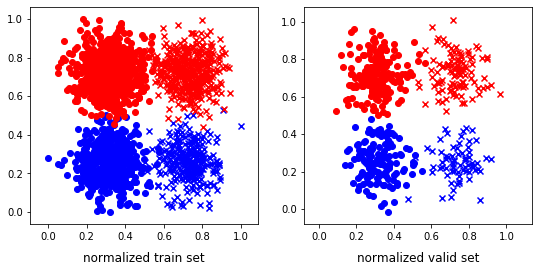

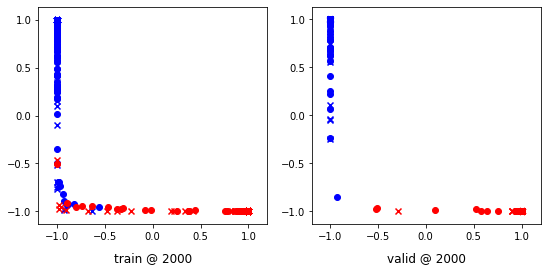

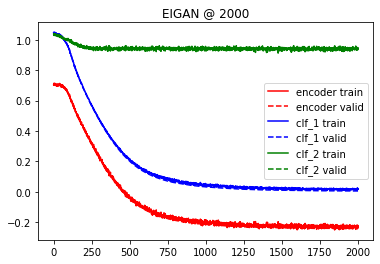

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:04, 16.09it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.02151071 	 0.02375469 	 -0.02179152 	 -0.02003942 	 -0.00804855 	 -0.00927044


 25%|██▌       | 503/2001 [00:34<01:52, 13.27it/s]

500 	 -0.03669450 	 -0.03949034 	 -0.11603938 	 -0.11885970 	 -0.08165949 	 -0.08172566


 50%|█████     | 1003/2001 [01:07<01:09, 14.29it/s]

1000 	 -0.12659511 	 -0.12161665 	 -0.20679532 	 -0.20216849 	 -0.08317967 	 -0.08381657


 75%|███████▌  | 1502/2001 [01:41<00:29, 16.87it/s]

1500 	 -0.19457598 	 -0.20365991 	 -0.31239519 	 -0.32209194 	 -0.14324708 	 -0.14413954


100%|██████████| 2001/2001 [02:14<00:00, 14.88it/s]


2000 	 -0.29275340 	 -0.28951615 	 -0.46268877 	 -0.45937055 	 -0.21223196 	 -0.21213396


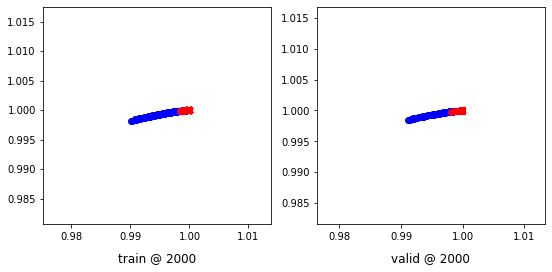

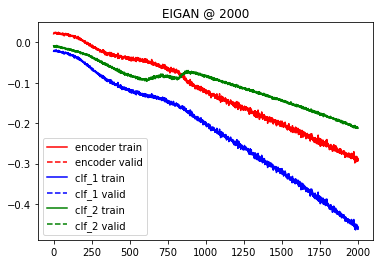

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.012772 	 1.012921 	 0.5924
200 	 0.270135 	 0.272114 	 0.9960
400 	 0.056522 	 0.054915 	 0.9980
600 	 0.027625 	 0.022313 	 1.0000
800 	 0.020927 	 0.013486 	 1.0000
1000 	 0.018595 	 0.009852 	 1.0000
Accuracy: 1.0
Error Rate: 0.0
F1 Score: 1.0
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 1.0
Error Rate: 0.0
F1 Score: 1.0
SVM
--------------------------------------------------------------------------------
Accuracy: 1.0
Error Rate: 0.0
F1 Score: 1.0
--------------------------------------------------------------------------------
ALLY: EIGAN

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.7730923694779116
Error Rate: 0.22690763052208834
F1 Score: 0.6666666666666666
VAR1: 0.2, VAR2: 0.4, TRIAL: 0
X, y_1, y2
(2641, 2) (2641, 1) (2641, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2112, 2) (529, 2) (2112, 1) (529, 1) (2112, 1) (529, 1)
class weights => w1, w2 [1.66299213 2.50831354] [2.27096774 1.78680203]
tensor sizes => torch.Size([2112, 2]) torch.Size([529, 2]) torch.Size([2112, 2]) torch.Size([529, 2]) torch.Size([2112, 2]) torch.Size([529, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid


  0%|          | 3/2001 [00:00<03:34,  9.30it/s]

0 	 0.68286049 	 0.67851722 	 1.03222466 	 1.01233447 	 1.04291356 	 1.02696443


 25%|██▌       | 503/2001 [00:46<02:10, 11.44it/s]

500 	 0.23083913 	 0.16113064 	 0.48865107 	 0.41860524 	 0.95079875 	 0.95062178


 50%|█████     | 1002/2001 [01:31<01:27, 11.39it/s]

1000 	 0.09638542 	 0.14480639 	 0.35194725 	 0.40365094 	 0.94873214 	 0.95199174


 75%|███████▌  | 1503/2001 [02:17<00:45, 10.92it/s]

1500 	 0.08033890 	 0.14412591 	 0.31967044 	 0.40193543 	 0.93333483 	 0.95095670


100%|██████████| 2001/2001 [03:02<00:00, 10.94it/s]


2000 	 0.05271706 	 0.14318937 	 0.28736579 	 0.40054190 	 0.92822909 	 0.95049971


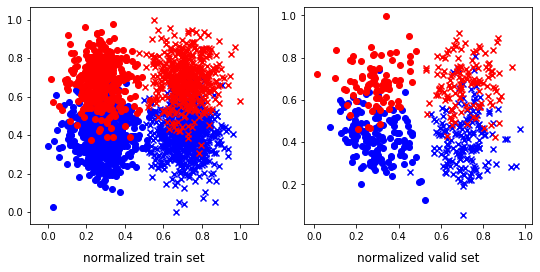

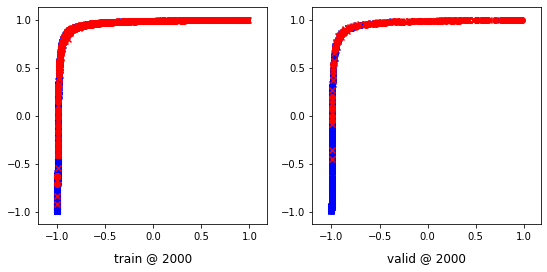

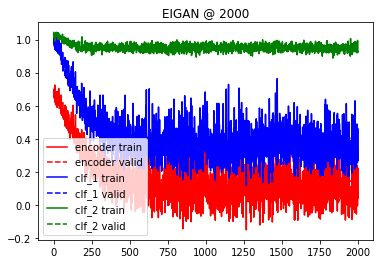

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 1/2001 [00:00<04:50,  6.90it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.00232774 	 0.00593048 	 -0.01265134 	 -0.01072110 	 0.07774785 	 0.07095902


 25%|██▌       | 502/2001 [00:44<02:17, 10.92it/s]

500 	 -0.07090081 	 -0.06892350 	 -0.10682977 	 -0.10844107 	 0.01045904 	 0.00120974


 50%|█████     | 1002/2001 [01:29<01:26, 11.59it/s]

1000 	 -0.09761534 	 -0.09403330 	 -0.18368074 	 -0.18098657 	 -0.09335671 	 -0.09487839


 75%|███████▌  | 1502/2001 [02:13<00:43, 11.35it/s]

1500 	 -0.07758032 	 -0.07736017 	 -0.26002657 	 -0.25876686 	 -0.22713602 	 -0.22591864


100%|██████████| 2001/2001 [02:57<00:00, 11.28it/s]


2000 	 0.03275982 	 0.02494052 	 -0.35421312 	 -0.35323185 	 -0.42205316 	 -0.41495723


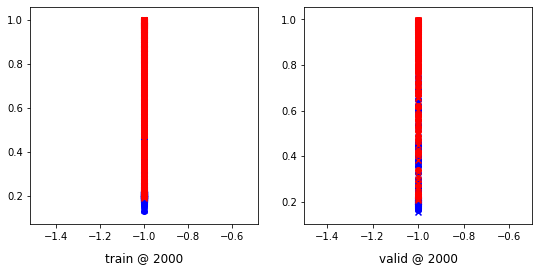

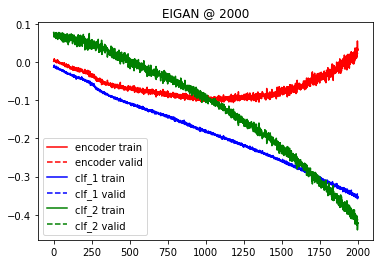

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.022019 	 1.021925 	 0.3989
200 	 0.658115 	 0.671198 	 0.8885
400 	 0.367652 	 0.399789 	 0.8885
600 	 0.358462 	 0.394778 	 0.8885
800 	 0.358272 	 0.394759 	 0.8885
1000 	 0.358202 	 0.394404 	 0.8885
Accuracy: 0.888468809073724
Error Rate: 0.11153119092627599
F1 Score: 0.8637413394919168
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8771266540642723
Error Rate: 0.12287334593572778
F1 Score: 0.8539325842696629
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8846880907372401
Error Rate: 0.11

  0%|          | 2/2001 [00:00<01:42, 19.57it/s]

Accuracy: 0.5595463137996219
Error Rate: 0.44045368620037806
F1 Score: 0.7175757575757575
VAR1: 0.2, VAR2: 0.6, TRIAL: 0
X, y_1, y2
(977, 2) (977, 1) (977, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(781, 2) (196, 2) (781, 1) (196, 1) (781, 1) (196, 1)
class weights => w1, w2 [1.73170732 2.36666667] [2.18156425 1.8463357 ]
tensor sizes => torch.Size([781, 2]) torch.Size([196, 2]) torch.Size([781, 2]) torch.Size([196, 2]) torch.Size([781, 2]) torch.Size([196, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.69075096 	 0.69047463 	 1.02094066 	 1.02085006 	 1.02351356 	 1.02352262


 25%|██▌       | 505/2001 [00:16<00:48, 30.67it/s]

500 	 0.53835386 	 0.55183846 	 0.82018292 	 0.83534098 	 0.97499341 	 0.97664970


 50%|█████     | 1005/2001 [00:32<00:28, 35.37it/s]

1000 	 0.41496164 	 0.45925033 	 0.66154605 	 0.71172065 	 0.93975502 	 0.94561750


 75%|███████▌  | 1503/2001 [00:48<00:20, 24.17it/s]

1500 	 0.37981713 	 0.46991593 	 0.61632103 	 0.71495616 	 0.92966455 	 0.93818742


100%|██████████| 2001/2001 [01:04<00:00, 30.91it/s]


2000 	 0.37588024 	 0.48381317 	 0.61091369 	 0.72757727 	 0.92818868 	 0.93691128


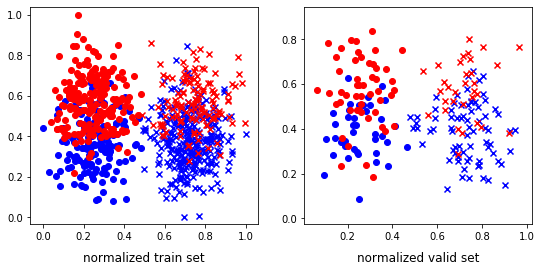

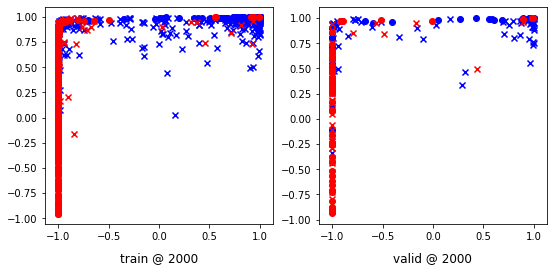

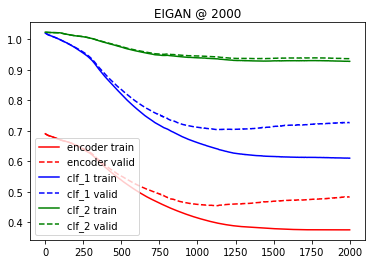

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 5/2001 [00:00<00:53, 36.96it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.06227073 	 -0.06211546 	 -0.11315471 	 -0.11304894 	 -0.02553972 	 -0.02568446


 25%|██▌       | 503/2001 [00:16<00:46, 32.16it/s]

500 	 -0.07242215 	 -0.07225385 	 -0.14351894 	 -0.14338517 	 -0.06657558 	 -0.06670457


 50%|█████     | 1005/2001 [00:31<00:32, 30.74it/s]

1000 	 -0.07976525 	 -0.07953524 	 -0.18334968 	 -0.18320659 	 -0.12184325 	 -0.12198037


 75%|███████▌  | 1506/2001 [00:47<00:16, 30.19it/s]

1500 	 -0.07451732 	 -0.07426758 	 -0.20541854 	 -0.20513600 	 -0.16180184 	 -0.16175741


100%|██████████| 2001/2001 [01:02<00:00, 31.88it/s]


2000 	 -0.06604329 	 -0.06573299 	 -0.22682628 	 -0.22631384 	 -0.20097706 	 -0.20072544


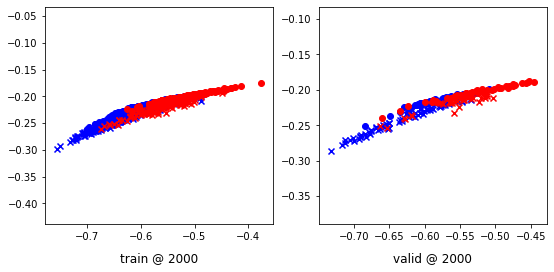

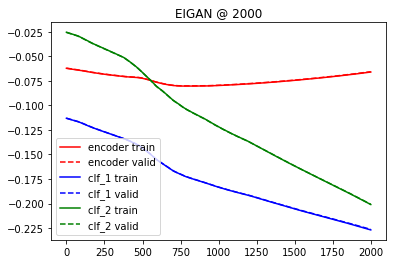

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.044521 	 1.044207 	 0.5765
200 	 0.726243 	 0.739589 	 0.7653
400 	 0.611985 	 0.659145 	 0.7959
600 	 0.609114 	 0.662384 	 0.7908
800 	 0.606927 	 0.664983 	 0.7806
1000 	 0.604370 	 0.670941 	 0.7755
Accuracy: 0.7755102040816326
Error Rate: 0.22448979591836735
F1 Score: 0.7411764705882353
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7806122448979592
Error Rate: 0.2193877551020408
F1 Score: 0.7542857142857142
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7806122448979592
Error Rate: 0.21

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.665522 	 0.687654 	 0.7092
Accuracy: 0.7091836734693877
Error Rate: 0.29081632653061223
F1 Score: 0.7015706806282721
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.6479591836734694
Error Rate: 0.3520408163265306
F1 Score: 0.6387434554973821
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9387755102040817
Error Rate: 0.061224489795918366
F1 Score: 0.9433962264150944
VAR1: 0.2, VAR2: 0.8, TRIAL: 0
X, y_1, y2
(1151, 2) (1151, 1) (1151, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(920, 2) (231, 2) (920, 1) (231, 1) (920, 1) (231, 1)
class weights => w1, w2 [1.25511596 4.9197861 ] [1.54621849 2.83076923]
tensor sizes => torch.Size([920, 2]) torch.Size([231, 2]) torch.Size([920, 2]) torch.Size([231, 2]) torch.Size([920, 2]) torch.Size([231, 2])
--------------------------------------------------------------------------------
EIGAN Training
-----------

 25%|██▌       | 506/2001 [00:17<00:51, 29.15it/s]

500 	 0.59831762 	 0.59288061 	 0.87629831 	 0.86945385 	 0.97120279 	 0.96972042


 50%|█████     | 1007/2001 [00:35<00:32, 30.70it/s]

1000 	 0.48638427 	 0.45004207 	 0.73834032 	 0.69917315 	 0.94512707 	 0.94227827


 75%|███████▌  | 1505/2001 [00:51<00:18, 27.55it/s]

1500 	 0.44454873 	 0.40936774 	 0.69059145 	 0.65162283 	 0.93920386 	 0.93540227


100%|██████████| 2001/2001 [01:08<00:00, 29.01it/s]


2000 	 0.43148118 	 0.39549482 	 0.67689717 	 0.63600385 	 0.93856394 	 0.93365622


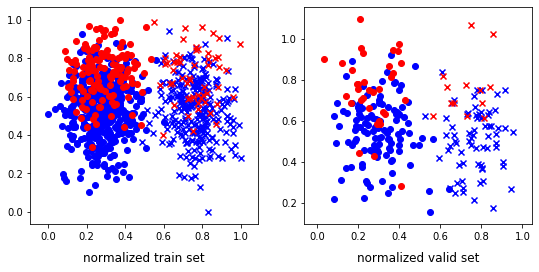

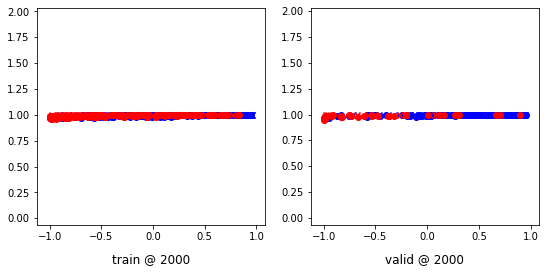

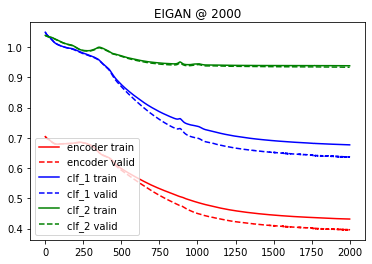

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 4/2001 [00:00<00:59, 33.80it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.00002556 	 -0.00000500 	 -0.03113871 	 -0.03110496 	 0.02355668 	 0.02364821


 25%|██▌       | 505/2001 [00:16<00:50, 29.60it/s]

500 	 -0.03530743 	 -0.03556827 	 -0.07486352 	 -0.07501723 	 0.00143158 	 0.00138240


 50%|█████     | 1003/2001 [00:33<00:29, 33.47it/s]

1000 	 -0.08335995 	 -0.08345469 	 -0.14062400 	 -0.14076670 	 -0.03928231 	 -0.03939926


 75%|███████▌  | 1503/2001 [00:49<00:15, 32.16it/s]

1500 	 -0.11287597 	 -0.11292394 	 -0.18339856 	 -0.18351032 	 -0.06555815 	 -0.06568096


100%|██████████| 2001/2001 [01:05<00:00, 30.34it/s]


2000 	 -0.14150825 	 -0.14152949 	 -0.22623764 	 -0.22634205 	 -0.09108231 	 -0.09122596


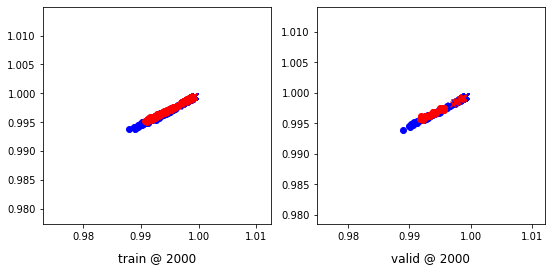

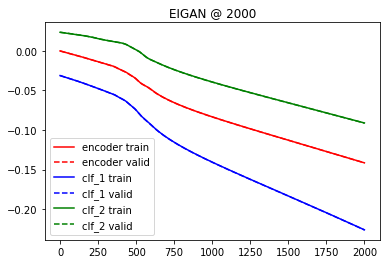

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.029893 	 1.030381 	 0.2597
200 	 0.739790 	 0.711007 	 0.8485
400 	 0.671066 	 0.641720 	 0.8398
600 	 0.667675 	 0.637247 	 0.8398
800 	 0.667352 	 0.636508 	 0.8355
1000 	 0.667301 	 0.636364 	 0.8355
Accuracy: 0.8354978354978355
Error Rate: 0.1645021645021645
F1 Score: 0.6122448979591838
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7489177489177489
Error Rate: 0.2510822510822511
F1 Score: 0.5671641791044776
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8225108225108225
Error Rate: 0.177

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.938846 	 0.937136 	 0.6494
Accuracy: 0.6493506493506493
Error Rate: 0.35064935064935066
F1 Score: 0.0
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9653679653679653
Error Rate: 0.03463203463203463
F1 Score: 0.9529411764705883
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9783549783549783
Error Rate: 0.021645021645021644
F1 Score: 0.9696969696969696
VAR1: 0.4, VAR2: 0.2, TRIAL: 0
X, y_1, y2
(2142, 2) (2142, 1) (2142, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1713, 2) (429, 2) (1713, 1) (429, 1) (1713, 1) (429, 1)
class weights => w1, w2 [1.82622601 2.21032258] [2.32428765 1.75512295]
tensor sizes => torch.Size([1713, 2]) torch.Size([429, 2]) torch.Size([1713, 2]) torch.Size([429, 2]) torch.Size([1713, 2]) torch.Size([429, 2])
--------------------------------------------------------------------------------
EIGAN Training
-------------------

  0%|          | 3/2001 [00:00<03:10, 10.48it/s]

0 	 0.65833986 	 0.65834987 	 1.04984367 	 1.04928052 	 1.08488083 	 1.08407784


 25%|██▌       | 503/2001 [00:32<01:34, 15.79it/s]

500 	 0.02326232 	 0.01967147 	 0.27969030 	 0.27523628 	 0.94966954 	 0.94871199


 50%|█████     | 1003/2001 [01:04<01:14, 13.33it/s]

1000 	 -0.20991373 	 -0.20707567 	 0.04389401 	 0.04675184 	 0.94696081 	 0.94697469


 75%|███████▌  | 1504/2001 [01:35<00:33, 14.74it/s]

1500 	 -0.24293089 	 -0.23082505 	 0.02115224 	 0.02302225 	 0.95720476 	 0.94699448


100%|██████████| 2001/2001 [02:08<00:00, 15.56it/s]


2000 	 -0.23133117 	 -0.23599309 	 0.02104972 	 0.01804768 	 0.94560570 	 0.94718796


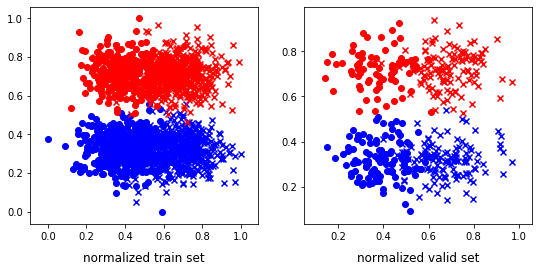

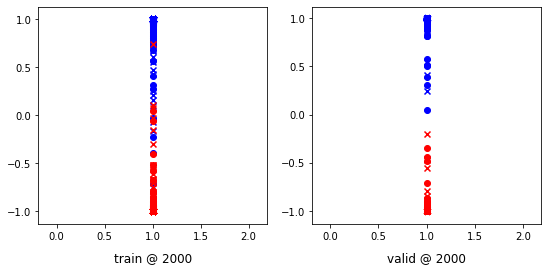

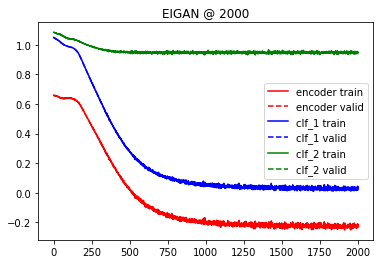

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<01:59, 16.76it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.00738362 	 -0.00649449 	 -0.03697558 	 -0.03572096 	 0.02806413 	 0.02904250


 25%|██▌       | 502/2001 [00:31<01:27, 17.16it/s]

500 	 -0.07134807 	 -0.07158528 	 -0.11142129 	 -0.11149035 	 -0.00015032 	 0.00023747


 50%|█████     | 1003/2001 [01:00<00:58, 16.97it/s]

1000 	 -0.11980730 	 -0.11939919 	 -0.18015759 	 -0.17991370 	 -0.04565433 	 -0.04599698


 75%|███████▌  | 1503/2001 [01:32<00:34, 14.59it/s]

1500 	 -0.19126317 	 -0.19141871 	 -0.28625691 	 -0.28685474 	 -0.10818028 	 -0.10892724


100%|██████████| 2001/2001 [02:04<00:00, 16.12it/s]


2000 	 -0.25816697 	 -0.25569209 	 -0.39842677 	 -0.39676103 	 -0.17450720 	 -0.17559147


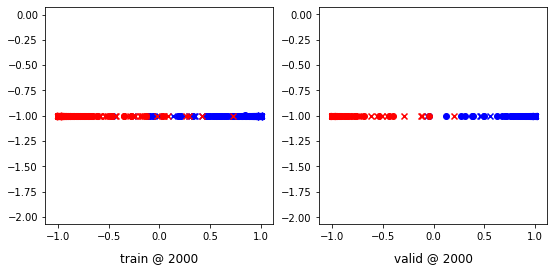

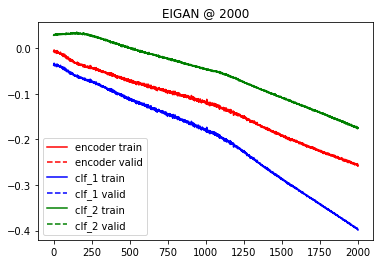

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.032613 	 1.032926 	 0.4289
200 	 0.609954 	 0.605738 	 0.9627
400 	 0.081346 	 0.082996 	 0.9930
600 	 0.032717 	 0.034997 	 0.9977
800 	 0.024771 	 0.025892 	 0.9977
1000 	 0.022127 	 0.022131 	 0.9977
Accuracy: 0.9976689976689976
Error Rate: 0.002331002331002331
F1 Score: 0.9974293059125964
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9976689976689976
Error Rate: 0.002331002331002331
F1 Score: 0.9974293059125964
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9976689976689976
Error Rate: 0

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.5710955710955711
Error Rate: 0.4289044289044289
F1 Score: 0.7270029673590505
VAR1: 0.4, VAR2: 0.4, TRIAL: 0
X, y_1, y2
(1253, 2) (1253, 1) (1253, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1002, 2) (251, 2) (1002, 1) (251, 1) (1002, 1) (251, 1)
class weights => w1, w2 [1.36885246 3.71111111] [1.32539683 4.07317073]
tensor sizes => torch.Size([1002, 2]) torch.Size([251, 2]) torch.Size([1002, 2]) torch.Size([251, 2]) torch.Size([1002, 2]) torch.Size([251, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.65218544 	 0.65130484 	 1.03287160 	 1.03388286 	 1.07450092 	 1.07572520


 25%|██▌       | 504/2001 [00:18<00:48, 30.79it/s]

500 	 0.51552618 	 0.51340461 	 0.75516969 	 0.74669999 	 0.93282294 	 0.92644256


 50%|█████     | 1005/2001 [00:36<00:37, 26.33it/s]

1000 	 0.45198816 	 0.45485747 	 0.55091161 	 0.52356744 	 0.79209048 	 0.76185715


 75%|███████▌  | 1505/2001 [00:54<00:17, 28.42it/s]

1500 	 0.40082699 	 0.39286417 	 0.44238254 	 0.40316969 	 0.73480958 	 0.70345271


100%|██████████| 2001/2001 [01:12<00:00, 27.68it/s]


2000 	 0.35987186 	 0.35927218 	 0.41150925 	 0.38177198 	 0.74482393 	 0.71564698


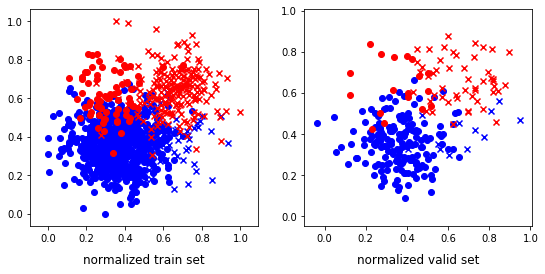

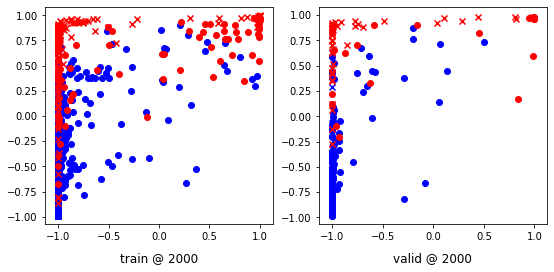

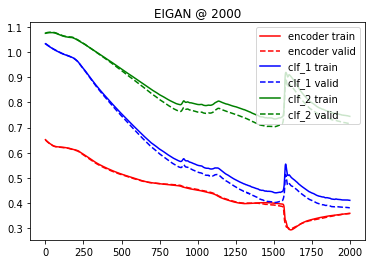

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:07, 29.64it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.13155927 	 -0.13162813 	 -0.15072265 	 -0.15080541 	 0.06174219 	 0.06151792


 25%|██▌       | 505/2001 [00:17<01:02, 23.80it/s]

500 	 -0.17455903 	 -0.17466432 	 -0.19791500 	 -0.19808976 	 0.04731142 	 0.04694625


 50%|█████     | 1004/2001 [00:34<00:41, 24.15it/s]

1000 	 -0.22336137 	 -0.22344887 	 -0.25743502 	 -0.25765705 	 0.01546154 	 0.01504544


 75%|███████▌  | 1506/2001 [00:52<00:18, 26.22it/s]

1500 	 -0.25955167 	 -0.25956202 	 -0.30909649 	 -0.30924892 	 -0.02257829 	 -0.02290558


100%|██████████| 2001/2001 [01:10<00:00, 28.52it/s]


2000 	 -0.29096356 	 -0.29093769 	 -0.35687652 	 -0.35699633 	 -0.05673207 	 -0.05701873


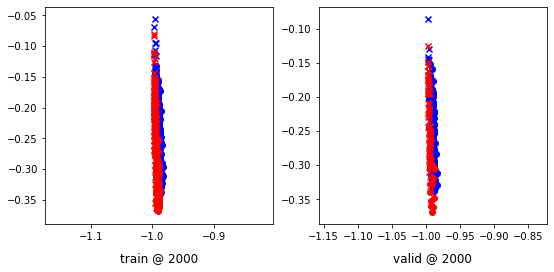

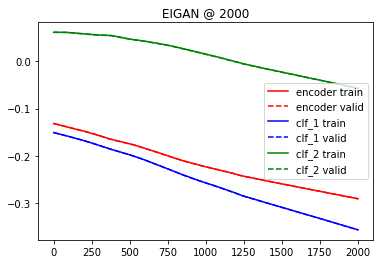

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.047660 	 1.048900 	 0.7291
200 	 0.574990 	 0.555233 	 0.9084
400 	 0.325245 	 0.294049 	 0.9203
600 	 0.317733 	 0.285375 	 0.9203
800 	 0.317270 	 0.285143 	 0.9203
1000 	 0.317104 	 0.285101 	 0.9203
Accuracy: 0.9203187250996016
Error Rate: 0.0796812749003984
F1 Score: 0.863013698630137
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9043824701195219
Error Rate: 0.09561752988047809
F1 Score: 0.84
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9163346613545816
Error Rate: 0.08366533864541832

  0%|          | 3/2001 [00:00<01:46, 18.70it/s]

tensor sizes => torch.Size([1600, 2]) torch.Size([401, 2]) torch.Size([1600, 2]) torch.Size([401, 2]) torch.Size([1600, 2]) torch.Size([401, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.72458434 	 0.71039152 	 1.07045686 	 1.07018828 	 1.03926528 	 1.05294394


 25%|██▌       | 502/2001 [00:31<01:29, 16.80it/s]

500 	 0.50446844 	 0.51980937 	 0.71809894 	 0.73496455 	 0.90676361 	 0.90830237


 50%|█████     | 1003/2001 [01:02<01:04, 15.36it/s]

1000 	 0.38619149 	 0.40403605 	 0.59595078 	 0.61095989 	 0.90336442 	 0.90007102


 75%|███████▌  | 1503/2001 [01:34<00:30, 16.14it/s]

1500 	 0.41420156 	 0.38498455 	 0.58944839 	 0.59115463 	 0.86863196 	 0.89931726


100%|██████████| 2001/2001 [02:05<00:00, 15.97it/s]


2000 	 0.39311284 	 0.37760949 	 0.62535852 	 0.58350891 	 0.92554730 	 0.89904660


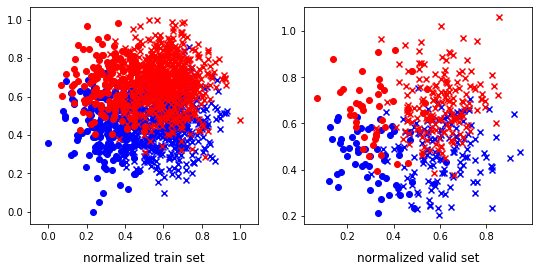

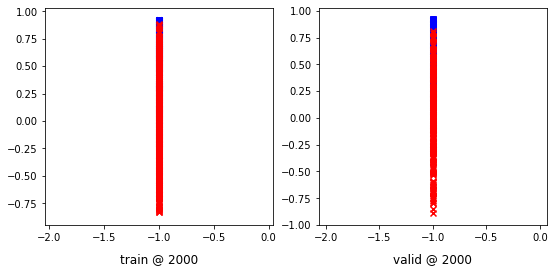

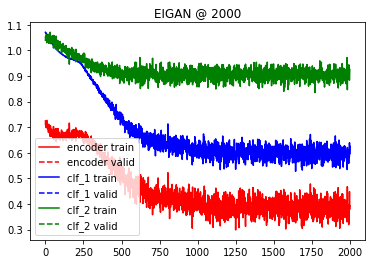

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:11, 15.15it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.10233550 	 0.10241588 	 0.07558013 	 0.07516234 	 0.03646363 	 0.03491353


 25%|██▌       | 504/2001 [00:30<01:24, 17.67it/s]

500 	 -0.02205174 	 -0.02399653 	 -0.06830601 	 -0.06860001 	 -0.01499754 	 -0.01119536


 50%|█████     | 1003/2001 [01:00<01:05, 15.21it/s]

1000 	 -0.09048584 	 -0.08884652 	 -0.17909148 	 -0.17725816 	 -0.09766105 	 -0.09734096


 75%|███████▌  | 1503/2001 [01:30<00:30, 16.58it/s]

1500 	 -0.14034006 	 -0.13532826 	 -0.28289667 	 -0.27868333 	 -0.17756604 	 -0.17862257


100%|██████████| 2001/2001 [02:00<00:00, 16.54it/s]


2000 	 -0.17129602 	 -0.17359363 	 -0.37220708 	 -0.37331066 	 -0.24823046 	 -0.24689712


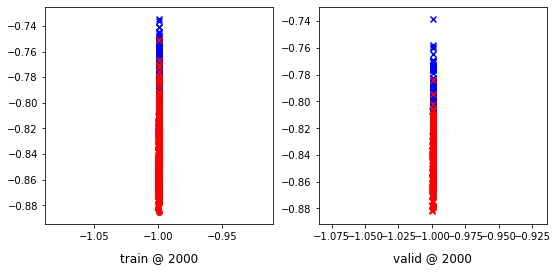

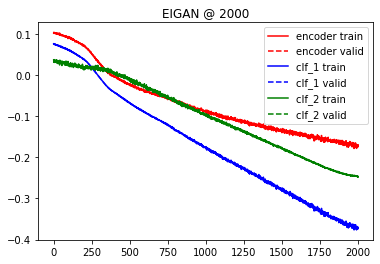

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.031072 	 1.031038 	 0.4788
200 	 0.823108 	 0.822697 	 0.7681
400 	 0.591388 	 0.588554 	 0.8005
600 	 0.587519 	 0.583235 	 0.8005
800 	 0.587395 	 0.583104 	 0.8005
1000 	 0.587328 	 0.583050 	 0.8005
Accuracy: 0.800498753117207
Error Rate: 0.19950124688279303
F1 Score: 0.8058252427184467
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7955112219451371
Error Rate: 0.20448877805486285
F1 Score: 0.7999999999999999
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7930174563591023
Error Rate: 0.20

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.7506234413965087
Error Rate: 0.24937655860349128
F1 Score: 0.8563218390804598
VAR1: 0.4, VAR2: 0.8, TRIAL: 0
X, y_1, y2
(2261, 2) (2261, 1) (2261, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1808, 2) (453, 2) (1808, 1) (453, 1) (1808, 1) (453, 1)
class weights => w1, w2 [1.4048174  3.47024952] [2.39153439 1.71863118]
tensor sizes => torch.Size([1808, 2]) torch.Size([453, 2]) torch.Size([1808, 2]) torch.Size([453, 2]) torch.Size([1808, 2]) torch.Size([453, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.75106752 	 0.75268865 	 1.06139612 	 1.06294012 	 1.00356007 	 1.00339866


 25%|██▌       | 503/2001 [00:32<01:31, 16.36it/s]

500 	 0.50824249 	 0.51931006 	 0.76135027 	 0.77615082 	 0.94626707 	 0.94998795


 50%|█████     | 1003/2001 [01:05<01:12, 13.85it/s]

1000 	 0.42879719 	 0.47048068 	 0.68932772 	 0.72799963 	 0.95382851 	 0.95066613


 75%|███████▌  | 1503/2001 [01:39<00:34, 14.30it/s]

1500 	 0.45774174 	 0.46233529 	 0.71477818 	 0.71972030 	 0.95057732 	 0.95053220


100%|██████████| 2001/2001 [02:13<00:00, 15.02it/s]


2000 	 0.43481886 	 0.46016735 	 0.68091595 	 0.71763963 	 0.93904632 	 0.95061946


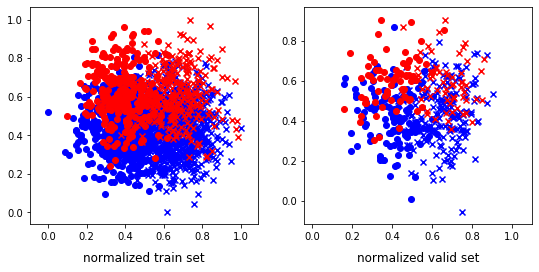

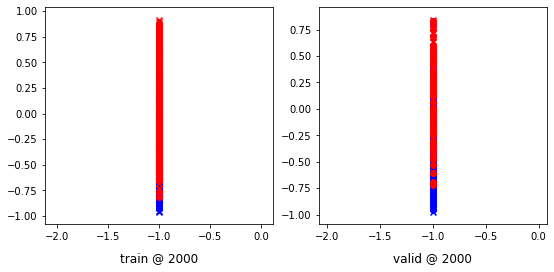

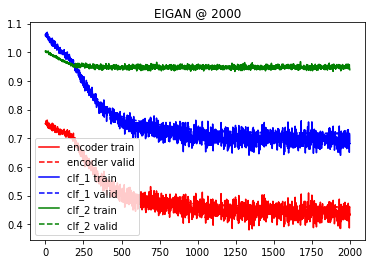

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:37, 20.45it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.06322019 	 0.06243072 	 0.01530162 	 0.01495040 	 -0.01874514 	 -0.01789980


 25%|██▌       | 503/2001 [00:31<01:48, 13.85it/s]

500 	 -0.07746509 	 -0.07864895 	 -0.14847718 	 -0.14928478 	 -0.06644955 	 -0.06577399


 50%|█████     | 1002/2001 [01:03<01:08, 14.49it/s]

1000 	 -0.14399980 	 -0.14155486 	 -0.24424756 	 -0.24272904 	 -0.11661771 	 -0.11807889


 75%|███████▌  | 1503/2001 [01:36<00:32, 15.43it/s]

1500 	 -0.20782214 	 -0.20392881 	 -0.34398261 	 -0.34125328 	 -0.16899899 	 -0.17057317


100%|██████████| 2001/2001 [02:07<00:00, 15.68it/s]


2000 	 -0.27157813 	 -0.27363223 	 -0.45631632 	 -0.45679224 	 -0.22981176 	 -0.22797197


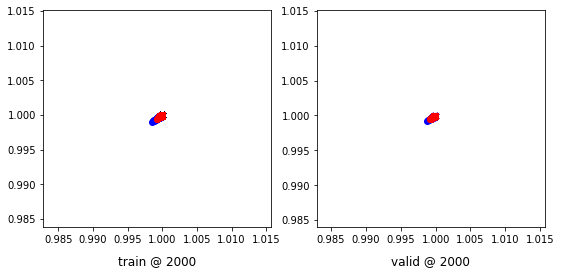

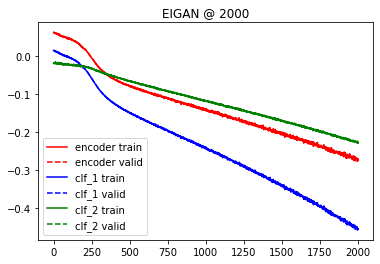

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.067038 	 1.067627 	 0.2892
200 	 0.793196 	 0.803375 	 0.7439
400 	 0.692804 	 0.710517 	 0.7616
600 	 0.686483 	 0.706507 	 0.7638
800 	 0.686234 	 0.706576 	 0.7638
1000 	 0.686195 	 0.706548 	 0.7616
Accuracy: 0.7615894039735099
Error Rate: 0.23841059602649006
F1 Score: 0.5748031496062992
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7350993377483444
Error Rate: 0.26490066225165565
F1 Score: 0.6052631578947368
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7704194260485652
Error Rate: 0.2

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.7814569536423841
Error Rate: 0.2185430463576159
F1 Score: 0.8023952095808383
VAR1: 0.6, VAR2: 0.2, TRIAL: 0
X, y_1, y2
(2607, 2) (2607, 1) (2607, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2085, 2) (522, 2) (2085, 1) (522, 1) (2085, 1) (522, 1)
class weights => w1, w2 [2.34006734 1.74623116] [3.39576547 1.41740313]
tensor sizes => torch.Size([2085, 2]) torch.Size([522, 2]) torch.Size([2085, 2]) torch.Size([522, 2]) torch.Size([2085, 2]) torch.Size([522, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.75066769 	 0.73031485 	 1.10195518 	 1.06053770 	 1.04464376 	 1.02337003


 25%|██▌       | 502/2001 [00:46<02:17, 10.93it/s]

500 	 -0.16542447 	 -0.13815707 	 0.06535340 	 0.06653351 	 0.92392856 	 0.89783776


 50%|█████     | 1002/2001 [01:31<01:33, 10.65it/s]

1000 	 -0.21804929 	 -0.18651986 	 0.01283625 	 0.01810216 	 0.92413145 	 0.89776921


 75%|███████▌  | 1502/2001 [02:17<00:45, 10.91it/s]

1500 	 -0.10770755 	 -0.19364592 	 0.00795533 	 0.01205005 	 0.80884492 	 0.89884317


100%|██████████| 2001/2001 [03:03<00:00, 10.93it/s]

2000 	 -0.32329467 	 -0.19405387 	 0.00327899 	 0.00985564 	 1.01966989 	 0.89705670


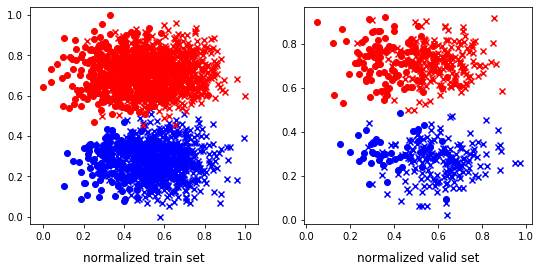

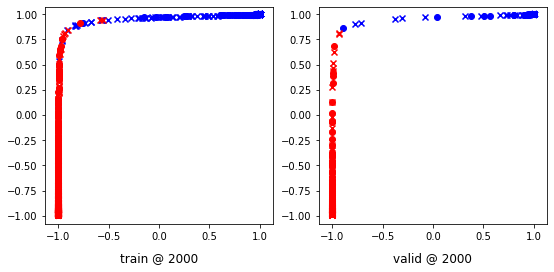

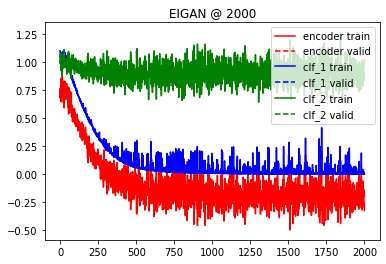

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 1/2001 [00:00<03:59,  8.34it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.02176471 	 0.02262092 	 -0.05396241 	 -0.05404704 	 -0.07511329 	 -0.07688978


 25%|██▌       | 503/2001 [00:45<02:21, 10.59it/s]

500 	 -0.02098504 	 -0.03539287 	 -0.19233668 	 -0.20126353 	 -0.21394444 	 -0.20727222


 50%|█████     | 1003/2001 [01:29<01:23, 11.89it/s]

1000 	 -0.01883733 	 -0.02437353 	 -0.33821422 	 -0.32722074 	 -0.36513439 	 -0.35031554


 75%|███████▌  | 1503/2001 [02:13<00:39, 12.65it/s]

1500 	 0.03019014 	 0.03182063 	 -0.49634120 	 -0.49569538 	 -0.52562481 	 -0.52630299


100%|██████████| 2001/2001 [02:57<00:00, 11.27it/s]


2000 	 0.14390576 	 0.18573529 	 -0.71355468 	 -0.70325994 	 -0.72599047 	 -0.74286544


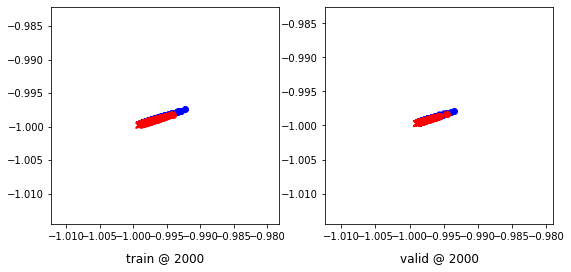

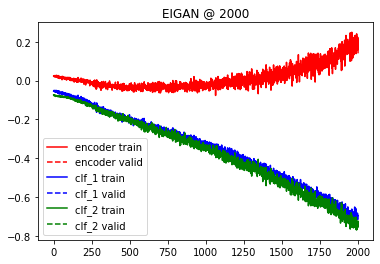

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.010565 	 1.010323 	 0.5728
200 	 0.489111 	 0.478040 	 0.9808
400 	 0.076443 	 0.064079 	 0.9981
600 	 0.039785 	 0.027990 	 0.9981
800 	 0.030625 	 0.018598 	 1.0000
1000 	 0.027119 	 0.014620 	 1.0000
Accuracy: 1.0
Error Rate: 0.0
F1 Score: 1.0
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 1.0
Error Rate: 0.0
F1 Score: 1.0
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9980842911877394
Error Rate: 0.0019157088122605363
F1 Score: 0.998324958123953
---------------------------------------------

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.8409961685823755
Error Rate: 0.15900383141762453
F1 Score: 0.8903566710700134
VAR1: 0.6, VAR2: 0.4, TRIAL: 0
X, y_1, y2
(2190, 2) (2190, 1) (2190, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1752, 2) (438, 2) (1752, 1) (438, 1) (1752, 1) (438, 1)
class weights => w1, w2 [1.22689076 5.40740741] [1.96632997 2.03484321]
tensor sizes => torch.Size([1752, 2]) torch.Size([438, 2]) torch.Size([1752, 2]) torch.Size([438, 2]) torch.Size([1752, 2]) torch.Size([438, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.64378023 	 0.61545491 	 1.05757868 	 1.02814221 	 1.10730398 	 1.10583448


 25%|██▌       | 502/2001 [00:32<01:36, 15.47it/s]

500 	 0.22958523 	 0.18095815 	 0.48743588 	 0.43319267 	 0.95154923 	 0.94538170


 50%|█████     | 1002/2001 [01:05<01:04, 15.55it/s]

1000 	 0.12789261 	 0.06412423 	 0.37711468 	 0.31663644 	 0.94236088 	 0.94565940


 75%|███████▌  | 1503/2001 [01:38<00:33, 14.69it/s]

1500 	 0.10063741 	 0.04262519 	 0.35337985 	 0.29338026 	 0.94650620 	 0.94390225


100%|██████████| 2001/2001 [02:11<00:00, 15.22it/s]


2000 	 0.14719993 	 0.03650442 	 0.39043671 	 0.28561810 	 0.93687892 	 0.94226086


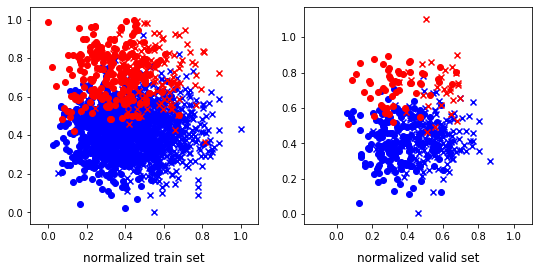

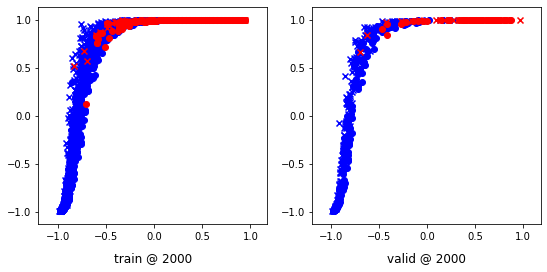

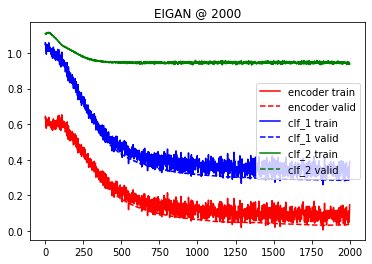

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<01:47, 18.61it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.03189456 	 0.03361853 	 -0.00582981 	 -0.00572991 	 0.00588249 	 0.00163558


 25%|██▌       | 502/2001 [00:31<01:29, 16.75it/s]

500 	 -0.04141629 	 -0.04207975 	 -0.10703394 	 -0.10732686 	 -0.05611518 	 -0.05543512


 50%|█████     | 1003/2001 [01:03<00:59, 16.84it/s]

1000 	 -0.11821089 	 -0.11904155 	 -0.22127630 	 -0.22192934 	 -0.12103467 	 -0.12076126


 75%|███████▌  | 1504/2001 [01:35<00:32, 15.46it/s]

1500 	 -0.18324097 	 -0.18360960 	 -0.33623782 	 -0.33627921 	 -0.19114786 	 -0.19072957


100%|██████████| 2001/2001 [02:06<00:00, 15.78it/s]


2000 	 -0.24415584 	 -0.24448375 	 -0.46331328 	 -0.46367437 	 -0.26814246 	 -0.26817799


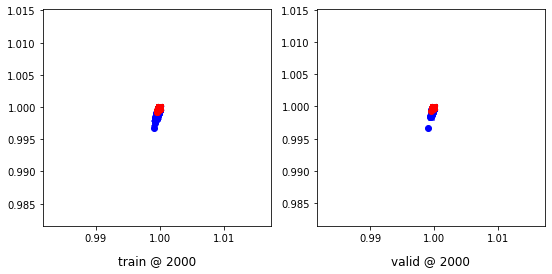

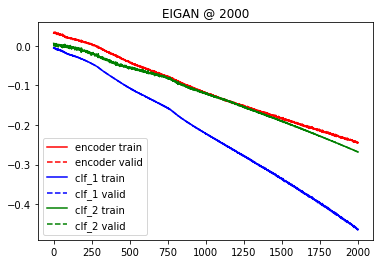

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.017699 	 1.018425 	 0.8151
200 	 0.587841 	 0.579108 	 0.8995
400 	 0.354259 	 0.307197 	 0.9338
600 	 0.345601 	 0.291535 	 0.9361
800 	 0.344771 	 0.289931 	 0.9338
1000 	 0.344595 	 0.289536 	 0.9338
Accuracy: 0.9337899543378996
Error Rate: 0.06621004566210045
F1 Score: 0.8242424242424242
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8995433789954338
Error Rate: 0.1004566210045662
F1 Score: 0.7708333333333333
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9292237442922374
Error Rate: 0.07

  0%|          | 3/2001 [00:00<01:26, 23.20it/s]

Accuracy: 0.7899543378995434
Error Rate: 0.2100456621004566
F1 Score: 0.778846153846154
VAR1: 0.6, VAR2: 0.6, TRIAL: 0
X, y_1, y2
(1977, 2) (1977, 1) (1977, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1581, 2) (396, 2) (1581, 1) (396, 1) (1581, 1) (396, 1)
class weights => w1, w2 [4.17150396 1.31530782] [2.00634518 1.99369483]
tensor sizes => torch.Size([1581, 2]) torch.Size([396, 2]) torch.Size([1581, 2]) torch.Size([396, 2]) torch.Size([1581, 2]) torch.Size([396, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.72918224 	 0.72836673 	 1.04009163 	 1.03808713 	 1.00419283 	 1.00286758


 25%|██▌       | 504/2001 [00:31<01:30, 16.60it/s]

500 	 0.36738789 	 0.38450295 	 0.62607837 	 0.64598829 	 0.95195472 	 0.95463252


 50%|█████     | 1002/2001 [01:01<01:07, 14.80it/s]

1000 	 0.33992195 	 0.34121764 	 0.59646219 	 0.60657418 	 0.94976097 	 0.95850372


 75%|███████▌  | 1503/2001 [01:33<00:28, 17.42it/s]

1500 	 0.33035082 	 0.33125246 	 0.58949161 	 0.59716463 	 0.95228249 	 0.95905936


100%|██████████| 2001/2001 [02:04<00:00, 16.04it/s]


2000 	 0.28245848 	 0.32943416 	 0.54451394 	 0.59521246 	 0.95516557 	 0.95892549


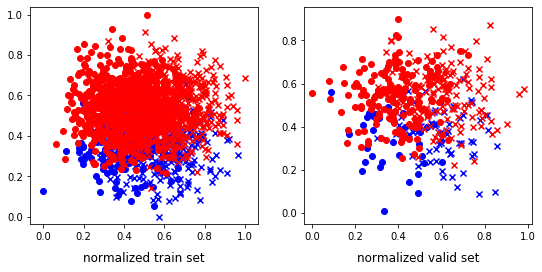

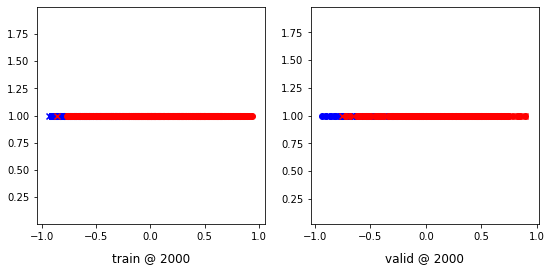

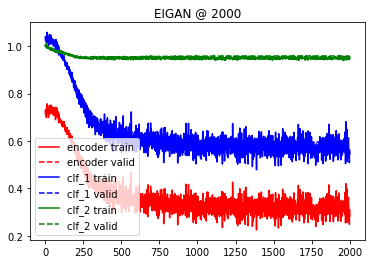

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:19, 25.26it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.03533487 	 0.03295018 	 -0.00538389 	 -0.00770742 	 -0.00173076 	 -0.00163730


 25%|██▌       | 504/2001 [00:29<01:22, 18.13it/s]

500 	 -0.01585892 	 -0.01614485 	 -0.07452502 	 -0.07468969 	 -0.04214624 	 -0.04196042


 50%|█████     | 1003/2001 [00:59<01:12, 13.67it/s]

1000 	 -0.04988379 	 -0.04937901 	 -0.13113917 	 -0.13126470 	 -0.08504990 	 -0.08615678


 75%|███████▌  | 1502/2001 [01:28<00:30, 16.35it/s]

1500 	 -0.06894393 	 -0.06876085 	 -0.17628545 	 -0.17639378 	 -0.12762532 	 -0.12807456


100%|██████████| 2001/2001 [01:57<00:00, 16.96it/s]


2000 	 -0.08803064 	 -0.08770911 	 -0.22222780 	 -0.22361334 	 -0.16632566 	 -0.16865189


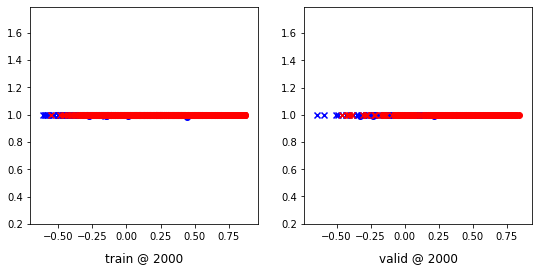

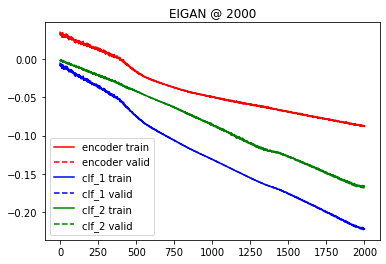

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.031670 	 1.032058 	 0.7601
200 	 0.760035 	 0.760644 	 0.8005
400 	 0.577748 	 0.590505 	 0.8081
600 	 0.570791 	 0.585847 	 0.8030
800 	 0.570264 	 0.585771 	 0.8030
1000 	 0.570076 	 0.586241 	 0.8030
Accuracy: 0.803030303030303
Error Rate: 0.19696969696969696
F1 Score: 0.8699999999999999
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7954545454545454
Error Rate: 0.20454545454545456
F1 Score: 0.8571428571428571
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8106060606060606
Error Rate: 0.18

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.6818181818181818
Error Rate: 0.3181818181818182
F1 Score: 0.6701570680628273
VAR1: 0.6, VAR2: 0.8, TRIAL: 0
X, y_1, y2
(2033, 2) (2033, 1) (2033, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1626, 2) (407, 2) (1626, 1) (407, 1) (1626, 1) (407, 1)
class weights => w1, w2 [4.04477612 1.32843137] [3.23260437 1.44790739]
tensor sizes => torch.Size([1626, 2]) torch.Size([407, 2]) torch.Size([1626, 2]) torch.Size([407, 2]) torch.Size([1626, 2]) torch.Size([407, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.68349433 	 0.67833757 	 1.04141366 	 1.03322005 	 1.05125725 	 1.04802966


 25%|██▌       | 504/2001 [00:31<01:31, 16.29it/s]

500 	 0.50874609 	 0.51381946 	 0.74078679 	 0.73653048 	 0.92518246 	 0.91585821


 50%|█████     | 1002/2001 [01:02<01:02, 15.86it/s]

1000 	 0.48921174 	 0.48800063 	 0.70706016 	 0.71448231 	 0.91114110 	 0.91962886


 75%|███████▌  | 1503/2001 [01:34<00:32, 15.54it/s]

1500 	 0.47046930 	 0.47931516 	 0.70324504 	 0.70631230 	 0.92573988 	 0.92014432


100%|██████████| 2001/2001 [02:06<00:00, 15.82it/s]


2000 	 0.48216224 	 0.47825450 	 0.72053045 	 0.71203279 	 0.93191385 	 0.92692548


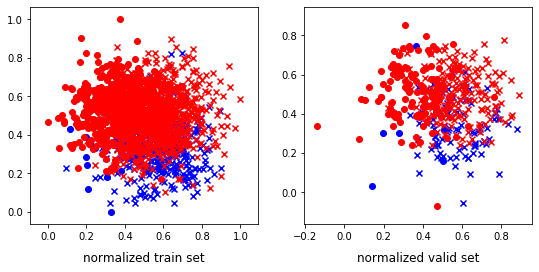

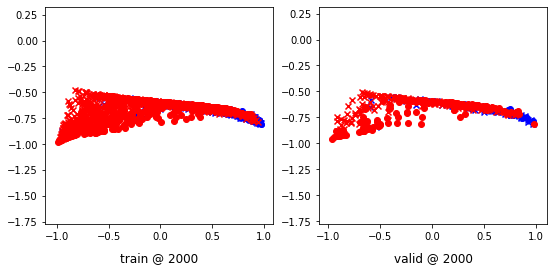

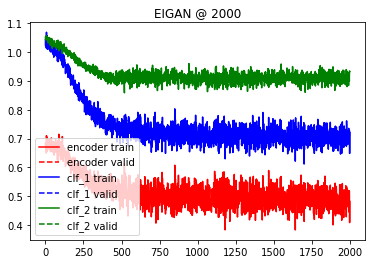

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:06, 15.80it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.08791415 	 -0.08785572 	 -0.12430327 	 -0.12442726 	 0.00932577 	 0.00876313


 25%|██▌       | 504/2001 [00:30<01:35, 15.61it/s]

500 	 -0.21617749 	 -0.21698083 	 -0.26515943 	 -0.26555380 	 -0.02128163 	 -0.02039277


 50%|█████     | 1003/2001 [01:01<01:03, 15.76it/s]

1000 	 -0.33061892 	 -0.33170110 	 -0.39579439 	 -0.39715418 	 -0.05528083 	 -0.05583796


 75%|███████▌  | 1503/2001 [01:31<00:28, 17.76it/s]

1500 	 -0.47456127 	 -0.47480351 	 -0.56542575 	 -0.56618446 	 -0.10143649 	 -0.10229282


100%|██████████| 2001/2001 [02:01<00:00, 16.46it/s]


2000 	 -0.61873138 	 -0.62049907 	 -0.74447262 	 -0.74636400 	 -0.15460005 	 -0.15477444


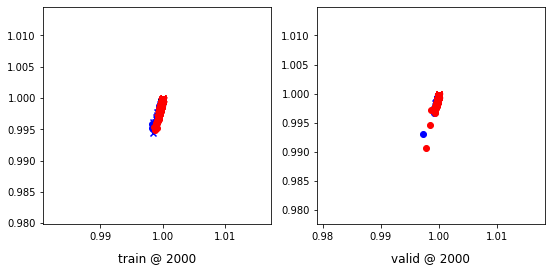

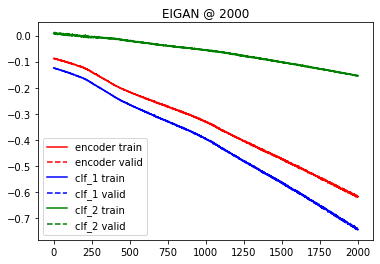

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.004263 	 1.003130 	 0.7174
200 	 0.797492 	 0.794686 	 0.7862
400 	 0.693626 	 0.688586 	 0.7961
600 	 0.682147 	 0.676236 	 0.8059
800 	 0.676846 	 0.671227 	 0.7936
1000 	 0.674227 	 0.669785 	 0.7912
Accuracy: 0.7911547911547911
Error Rate: 0.20884520884520885
F1 Score: 0.8599670510708401
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7395577395577395
Error Rate: 0.26044226044226043
F1 Score: 0.8100358422939069
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7960687960687961
Error Rate: 0.2

  0%|          | 3/2001 [00:00<01:31, 21.84it/s]

Accuracy: 0.8378378378378378
Error Rate: 0.16216216216216217
F1 Score: 0.8873720136518771
VAR1: 0.8, VAR2: 0.2, TRIAL: 0
X, y_1, y2
(1936, 2) (1936, 1) (1936, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1548, 2) (388, 2) (1548, 1) (388, 1) (1548, 1) (388, 1)
class weights => w1, w2 [2.02883355 1.97197452] [2.21142857 1.8254717 ]
tensor sizes => torch.Size([1548, 2]) torch.Size([388, 2]) torch.Size([1548, 2]) torch.Size([388, 2]) torch.Size([1548, 2]) torch.Size([388, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.63024402 	 0.62974781 	 0.99546593 	 0.99489325 	 1.05863059 	 1.05829263


 25%|██▌       | 503/2001 [00:31<01:45, 14.14it/s]

500 	 -0.10654843 	 -0.10906249 	 0.15559845 	 0.15036529 	 0.95516211 	 0.95257497


 50%|█████     | 1004/2001 [01:02<00:58, 17.06it/s]

1000 	 -0.21483307 	 -0.21359253 	 0.04625536 	 0.04570556 	 0.95414251 	 0.95244527


 75%|███████▌  | 1503/2001 [01:33<00:33, 14.80it/s]

1500 	 -0.21574852 	 -0.22526485 	 0.04343153 	 0.03402270 	 0.95245099 	 0.95243472


100%|██████████| 2001/2001 [02:04<00:00, 16.06it/s]


2000 	 -0.22141933 	 -0.22820935 	 0.03753337 	 0.03105363 	 0.95208377 	 0.95241016


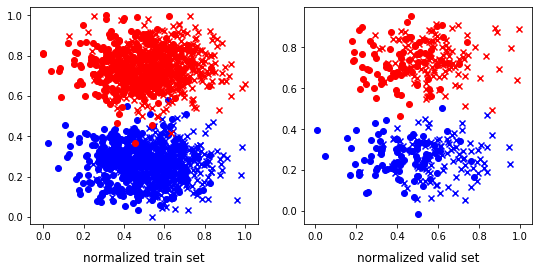

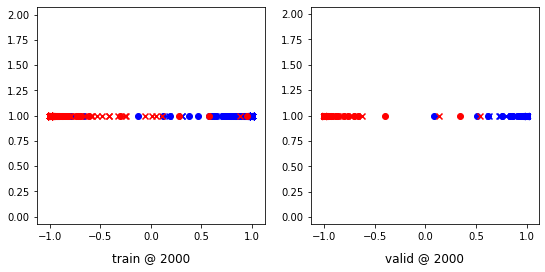

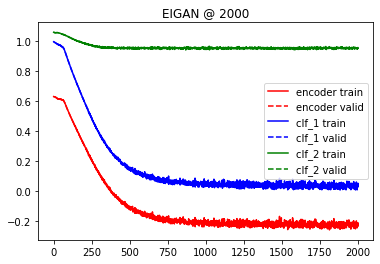

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<01:40, 19.97it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.00895276 	 0.00877704 	 -0.01864551 	 -0.01865722 	 0.03391505 	 0.03436707


 25%|██▌       | 503/2001 [00:29<01:33, 16.06it/s]

500 	 -0.04378951 	 -0.04350530 	 -0.08158910 	 -0.08129279 	 0.00570537 	 0.00560998


 50%|█████     | 1003/2001 [00:58<00:54, 18.16it/s]

1000 	 -0.13436766 	 -0.13400465 	 -0.18496318 	 -0.18439735 	 -0.02491830 	 -0.02448319


 75%|███████▌  | 1503/2001 [01:27<00:34, 14.54it/s]

1500 	 -0.20922568 	 -0.20911422 	 -0.28652322 	 -0.28623614 	 -0.07801218 	 -0.07770832


100%|██████████| 2001/2001 [01:57<00:00, 17.00it/s]


2000 	 -0.28533465 	 -0.28454414 	 -0.40101644 	 -0.39969507 	 -0.14011616 	 -0.13933896


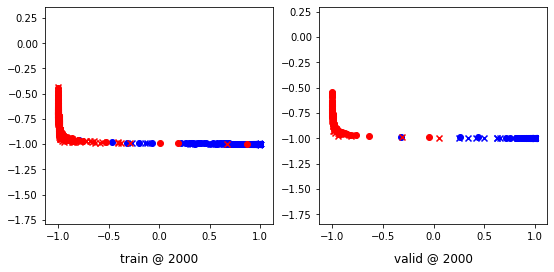

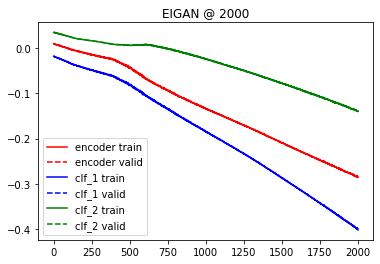

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.008121 	 1.008279 	 0.0155
200 	 0.324426 	 0.331514 	 0.9923
400 	 0.055807 	 0.056062 	 0.9923
600 	 0.036660 	 0.033666 	 0.9923
800 	 0.031866 	 0.026971 	 0.9923
1000 	 0.030184 	 0.024038 	 0.9923
Accuracy: 0.9922680412371134
Error Rate: 0.007731958762886598
F1 Score: 0.9923273657289001
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9922680412371134
Error Rate: 0.007731958762886598
F1 Score: 0.9923273657289001
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9922680412371134
Error Rate: 0

  0%|          | 1/2001 [00:00<03:31,  9.48it/s]

Accuracy: 0.5489690721649485
Error Rate: 0.45103092783505155
F1 Score: 0.7088186356073212
VAR1: 0.8, VAR2: 0.4, TRIAL: 0
X, y_1, y2
(2739, 2) (2739, 1) (2739, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2191, 2) (548, 2) (2191, 1) (548, 1) (2191, 1) (548, 1)
class weights => w1, w2 [3.41277259 1.41446094] [1.59577567 2.67848411]
tensor sizes => torch.Size([2191, 2]) torch.Size([548, 2]) torch.Size([2191, 2]) torch.Size([548, 2]) torch.Size([2191, 2]) torch.Size([548, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.70479703 	 0.66203940 	 1.03529024 	 1.01152956 	 1.02392006 	 1.04263735


 25%|██▌       | 503/2001 [00:47<02:19, 10.76it/s]

500 	 0.11866793 	 0.19692132 	 0.32662639 	 0.36761609 	 0.90094984 	 0.86384195


 50%|█████     | 1003/2001 [01:33<01:31, 10.92it/s]

1000 	 0.19123337 	 0.17592925 	 0.34470335 	 0.33261353 	 0.84654671 	 0.84983146


 75%|███████▌  | 1502/2001 [02:19<00:44, 11.13it/s]

1500 	 0.09943390 	 0.17033431 	 0.29528883 	 0.32889745 	 0.89080638 	 0.85171032


100%|██████████| 2001/2001 [03:05<00:00, 10.81it/s]

2000 	 0.05371794 	 0.16742724 	 0.26165605 	 0.33001059 	 0.90129668 	 0.85573053


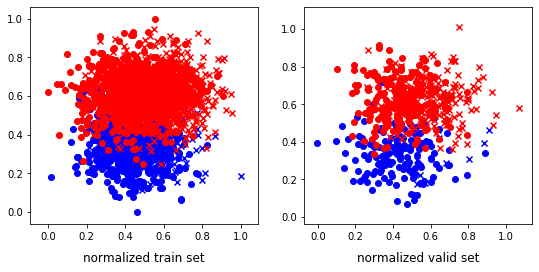

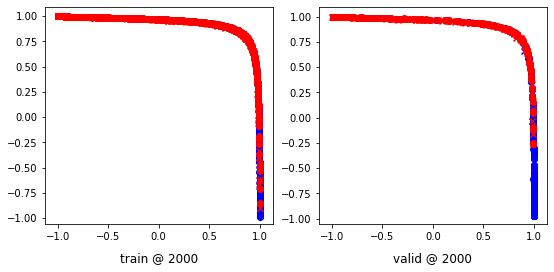

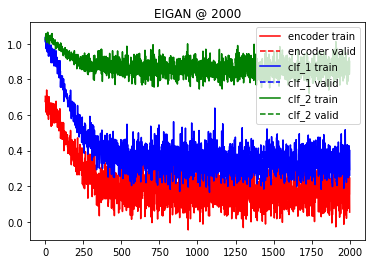

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<03:12, 10.39it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.01162002 	 0.01714587 	 -0.03555179 	 -0.03120612 	 -0.01686987 	 -0.01989086


 25%|██▌       | 502/2001 [00:45<02:14, 11.17it/s]

500 	 -0.11926931 	 -0.13399425 	 -0.19390596 	 -0.20643857 	 -0.07318669 	 -0.06915482


 50%|█████     | 1002/2001 [01:30<01:32, 10.80it/s]

1000 	 -0.18354763 	 -0.18713279 	 -0.32379127 	 -0.32713419 	 -0.17446686 	 -0.17416760


 75%|███████▌  | 1502/2001 [02:15<00:44, 11.31it/s]

1500 	 -0.21753278 	 -0.21819821 	 -0.45729998 	 -0.45333004 	 -0.28965813 	 -0.28490391


100%|██████████| 2001/2001 [03:00<00:00, 11.10it/s]


2000 	 -0.17505470 	 -0.17251489 	 -0.58038467 	 -0.57396710 	 -0.43665206 	 -0.43360254


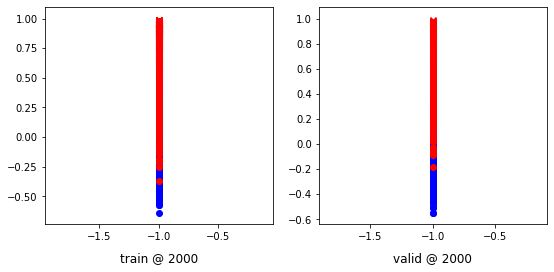

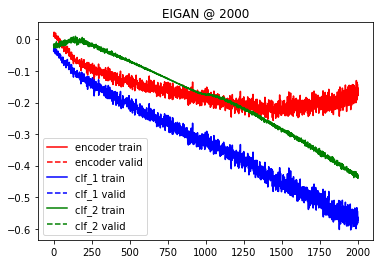

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.035361 	 1.034548 	 0.7080
200 	 0.503124 	 0.494851 	 0.9106
400 	 0.332307 	 0.323500 	 0.9106
600 	 0.326901 	 0.317469 	 0.9106
800 	 0.325923 	 0.316555 	 0.9088
1000 	 0.325389 	 0.316348 	 0.9106
Accuracy: 0.9105839416058394
Error Rate: 0.08941605839416059
F1 Score: 0.9361147327249023
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9014598540145985
Error Rate: 0.09854014598540146
F1 Score: 0.9283819628647215
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9087591240875912
Error Rate: 0.0

  0%|          | 4/2001 [00:00<00:53, 37.16it/s]

Accuracy: 0.7116788321167883
Error Rate: 0.28832116788321166
F1 Score: 0.6325581395348837
VAR1: 0.8, VAR2: 0.6, TRIAL: 0
X, y_1, y2
(1206, 2) (1206, 1) (1206, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(964, 2) (242, 2) (964, 1) (242, 1) (964, 1) (242, 1)
class weights => w1, w2 [2.69273743 1.59075908] [6.98550725 1.16707022]
tensor sizes => torch.Size([964, 2]) torch.Size([242, 2]) torch.Size([964, 2]) torch.Size([242, 2]) torch.Size([964, 2]) torch.Size([242, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.74044597 	 0.73794889 	 1.06895912 	 1.06895006 	 1.02174294 	 1.02414834


 25%|██▌       | 505/2001 [00:17<00:58, 25.71it/s]

500 	 0.71236950 	 0.70968258 	 0.97047251 	 0.97055060 	 0.95125031 	 0.95401520


 50%|█████     | 1006/2001 [00:35<00:33, 29.28it/s]

1000 	 0.73780936 	 0.73589557 	 0.94300956 	 0.94641298 	 0.89842701 	 0.90366459


 75%|███████▌  | 1503/2001 [00:52<00:16, 29.83it/s]

1500 	 0.57449907 	 0.57939082 	 0.67051339 	 0.73216671 	 0.78917283 	 0.84592307


100%|██████████| 2001/2001 [01:10<00:00, 28.52it/s]


2000 	 0.52772790 	 0.54703707 	 0.61136460 	 0.69775552 	 0.77679032 	 0.84386563


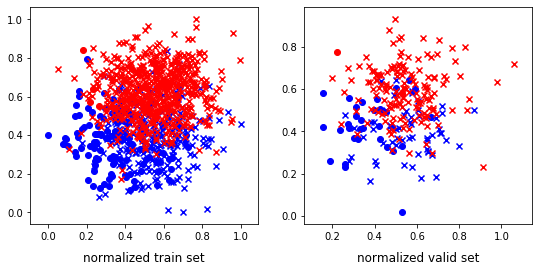

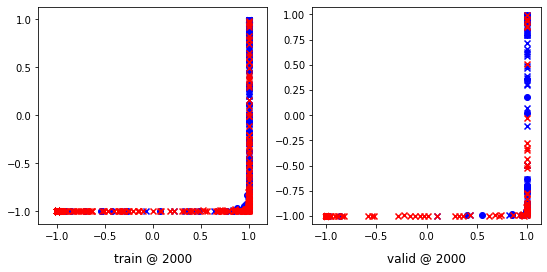

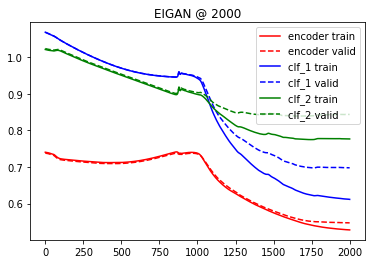

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:10, 28.29it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.06750512 	 0.06730714 	 0.00102078 	 0.00095721 	 -0.05772016 	 -0.05758481


 25%|██▌       | 507/2001 [00:17<00:53, 28.14it/s]

500 	 0.02519006 	 0.02492590 	 -0.05566212 	 -0.05572920 	 -0.08423796 	 -0.08399840


 50%|█████     | 1004/2001 [00:32<00:29, 33.57it/s]

1000 	 -0.01607882 	 -0.01633224 	 -0.11890633 	 -0.11895850 	 -0.12061241 	 -0.12035333


 75%|███████▌  | 1504/2001 [00:49<00:16, 29.91it/s]

1500 	 -0.04481570 	 -0.04516903 	 -0.17311597 	 -0.17326632 	 -0.15818341 	 -0.15790680


100%|██████████| 2001/2001 [01:06<00:00, 30.14it/s]

2000 	 -0.06549884 	 -0.06588058 	 -0.22030053 	 -0.22045235 	 -0.19344692 	 -0.19315615


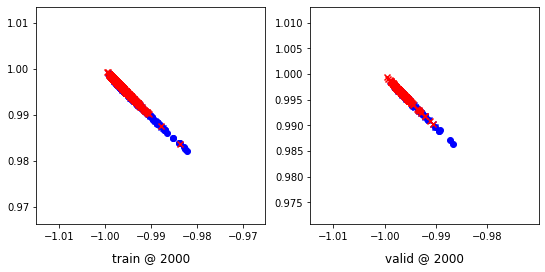

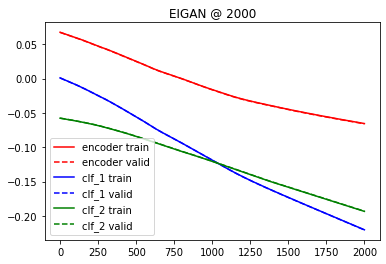

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.037014 	 1.039709 	 0.6281
200 	 0.736457 	 0.784667 	 0.7645
400 	 0.546857 	 0.628803 	 0.7727
600 	 0.545911 	 0.629026 	 0.7686
800 	 0.543189 	 0.629169 	 0.7810
1000 	 0.540215 	 0.628263 	 0.7851
Accuracy: 0.7851239669421488
Error Rate: 0.21487603305785125
F1 Score: 0.8311688311688312
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7851239669421488
Error Rate: 0.21487603305785125
F1 Score: 0.8181818181818181
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7933884297520661
Error Rate: 0.2

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.856080 	 0.860195 	 0.8554
Accuracy: 0.8553719008264463
Error Rate: 0.1446280991735537
F1 Score: 0.9220489977728286
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8429752066115702
Error Rate: 0.15702479338842976
F1 Score: 0.9068627450980392
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8553719008264463
Error Rate: 0.1446280991735537
F1 Score: 0.9220489977728286
VAR1: 0.8, VAR2: 0.8, TRIAL: 0
X, y_1, y2
(1231, 2) (1231, 1) (1231, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(984, 2) (247, 2) (984, 1) (247, 1) (984, 1) (247, 1)
class weights => w1, w2 [1.41786744 3.39310345] [1.31375167 4.18723404]
tensor sizes => torch.Size([984, 2]) torch.Size([247, 2]) torch.Size([984, 2]) torch.Size([247, 2]) torch.Size([984, 2]) torch.Size([247, 2])
--------------------------------------------------------------------------------
EIGAN Training
-------------

  0%|          | 6/2001 [00:00<00:38, 51.35it/s]

0 	 0.71974039 	 0.71732426 	 1.04121244 	 1.03884506 	 1.01485705 	 1.01466799


 25%|██▌       | 504/2001 [00:17<00:58, 25.58it/s]

500 	 0.65358710 	 0.65306419 	 0.79441184 	 0.79843289 	 0.83397913 	 0.83851588


 50%|█████     | 1006/2001 [00:32<00:22, 44.80it/s]

1000 	 0.65107167 	 0.66629547 	 0.70134354 	 0.72788703 	 0.74343413 	 0.75473875


 75%|███████▌  | 1503/2001 [00:45<00:10, 45.56it/s]

1500 	 0.65035850 	 0.69199008 	 0.68753839 	 0.74597222 	 0.73036706 	 0.74712932


100%|██████████| 2001/2001 [00:57<00:00, 34.72it/s]


2000 	 0.63197637 	 0.67972416 	 0.67478675 	 0.72525823 	 0.73595744 	 0.73868126


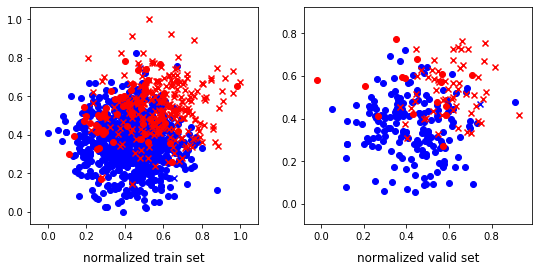

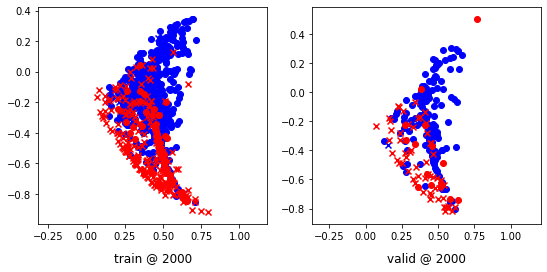

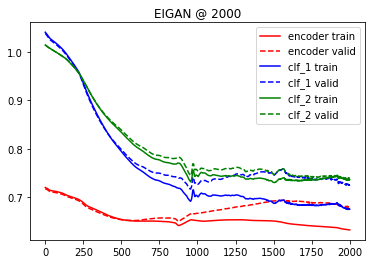

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:12, 27.70it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.08568461 	 0.08580180 	 0.05051203 	 0.05067577 	 0.01261817 	 0.01258063


 25%|██▌       | 505/2001 [00:12<00:41, 36.04it/s]

500 	 0.07088564 	 0.07106803 	 0.02873705 	 0.02890009 	 -0.00529442 	 -0.00534832


 50%|█████     | 1007/2001 [00:25<00:23, 42.10it/s]

1000 	 0.05836446 	 0.05857013 	 0.00728885 	 0.00746097 	 -0.02598881 	 -0.02607334


 75%|███████▌  | 1508/2001 [00:37<00:10, 45.73it/s]

1500 	 0.05602625 	 0.05623949 	 -0.01387581 	 -0.01371548 	 -0.06438956 	 -0.06449000


100%|██████████| 2001/2001 [00:49<00:00, 40.26it/s]


2000 	 0.05547807 	 0.05561664 	 -0.03094715 	 -0.03087162 	 -0.09398083 	 -0.09408887


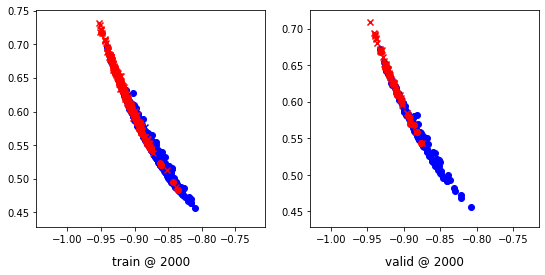

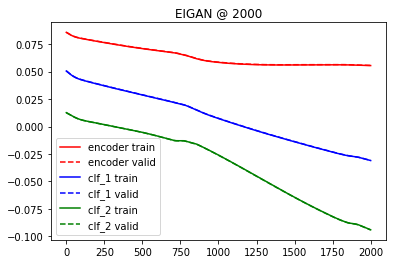

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.086080 	 1.082768 	 0.7287
200 	 0.795213 	 0.785892 	 0.7976
400 	 0.611584 	 0.595320 	 0.8178
600 	 0.603527 	 0.595466 	 0.8219
800 	 0.598378 	 0.598801 	 0.8259
1000 	 0.594643 	 0.605727 	 0.8219
Accuracy: 0.8218623481781376
Error Rate: 0.17813765182186234
F1 Score: 0.6986301369863014
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7813765182186235
Error Rate: 0.21862348178137653
F1 Score: 0.6785714285714286
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8299595141700404
Error Rate: 0.1

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.577731 	 0.557830 	 0.8421
Accuracy: 0.8421052631578947
Error Rate: 0.15789473684210525
F1 Score: 0.6929133858267716
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7854251012145749
Error Rate: 0.2145748987854251
F1 Score: 0.6490066225165564
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8380566801619433
Error Rate: 0.16194331983805668
F1 Score: 0.6296296296296295
Writing trial 0 ...
VAR1: 0.2, VAR2: 0.2, TRIAL: 1
X, y_1, y2
(1780, 2) (1780, 1) (1780, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1424, 2) (356, 2) (1424, 1) (356, 1) (1424, 1) (356, 1)
class weights => w1, w2 [2.39327731 1.71773221] [1.98882682 2.01129944]
tensor sizes => torch.Size([1424, 2]) torch.Size([356, 2]) torch.Size([1424, 2]) torch.Size([356, 2]) torch.Size([1424, 2]) torch.Size([356, 2])
--------------------------------------------------------------------------------
E

  0%|          | 5/2001 [00:00<01:37, 20.40it/s]

0 	 0.67890751 	 0.66728830 	 1.01848865 	 1.01615822 	 1.03286576 	 1.04201710


 25%|██▌       | 503/2001 [00:30<01:29, 16.79it/s]

500 	 0.21035072 	 0.19131225 	 0.26309019 	 0.25281155 	 0.74592668 	 0.75464648


 50%|█████     | 1004/2001 [01:00<01:04, 15.54it/s]

1000 	 0.08471280 	 0.03664367 	 0.07090187 	 0.05867534 	 0.67944288 	 0.71517885


 75%|███████▌  | 1504/2001 [01:30<00:31, 15.99it/s]

1500 	 0.08221237 	 0.03363851 	 0.06714203 	 0.04794183 	 0.67818773 	 0.70745051


100%|██████████| 2001/2001 [02:00<00:00, 16.64it/s]


2000 	 0.01002619 	 0.02494287 	 0.02667424 	 0.03187537 	 0.71041423 	 0.70007968


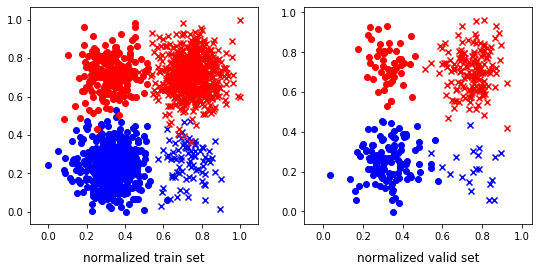

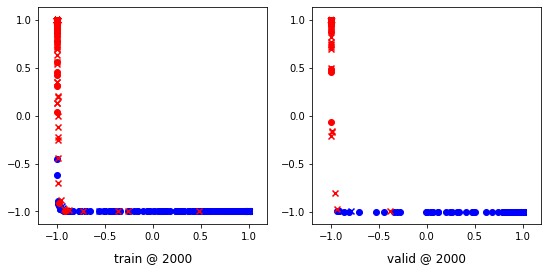

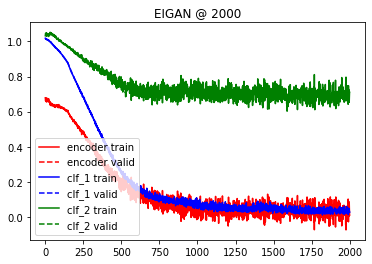

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:23, 23.89it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.08221950 	 0.07955196 	 0.03326190 	 0.03014336 	 -0.02122259 	 -0.02228045


 25%|██▌       | 504/2001 [00:28<01:34, 15.87it/s]

500 	 0.04069290 	 0.04240628 	 -0.01806461 	 -0.01657864 	 -0.04237815 	 -0.04286811


 50%|█████     | 1003/2001 [00:57<00:54, 18.24it/s]

1000 	 -0.00010558 	 0.00144418 	 -0.08382992 	 -0.08239838 	 -0.08934903 	 -0.08955581


 75%|███████▌  | 1504/2001 [01:26<00:27, 18.34it/s]

1500 	 -0.02967098 	 -0.02716682 	 -0.14657514 	 -0.14347422 	 -0.14191188 	 -0.14103869


100%|██████████| 2001/2001 [01:55<00:00, 17.35it/s]


2000 	 -0.05290318 	 -0.05169253 	 -0.20614515 	 -0.20373295 	 -0.19146033 	 -0.18992360


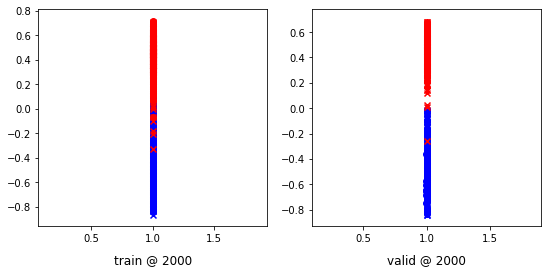

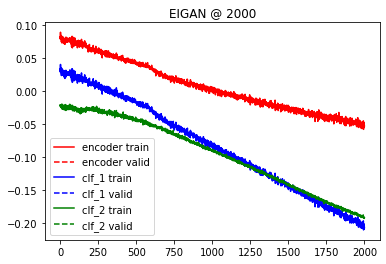

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.082262 	 1.081559 	 0.5843
200 	 0.669909 	 0.671626 	 0.9663
400 	 0.097846 	 0.092092 	 0.9972
600 	 0.047135 	 0.038871 	 1.0000
800 	 0.036021 	 0.025944 	 1.0000
1000 	 0.032014 	 0.020452 	 1.0000
Accuracy: 1.0
Error Rate: 0.0
F1 Score: 1.0
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9971910112359551
Error Rate: 0.0028089887640449437
F1 Score: 0.9976019184652278
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9971910112359551
Error Rate: 0.0028089887640449437
F1 Score: 0.9976019184652

  0%|          | 3/2001 [00:00<01:14, 26.75it/s]

(716, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(572, 2) (144, 2) (572, 1) (144, 1) (572, 1) (144, 1)
class weights => w1, w2 [1.26548673 4.76666667] [1.85714286 2.16666667]
tensor sizes => torch.Size([572, 2]) torch.Size([144, 2]) torch.Size([572, 2]) torch.Size([144, 2]) torch.Size([572, 2]) torch.Size([144, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.69175601 	 0.68906546 	 1.08267975 	 1.08086550 	 1.08437788 	 1.08494723


 25%|██▌       | 506/2001 [00:13<00:43, 33.99it/s]

500 	 0.68118727 	 0.67841536 	 0.98777217 	 0.98569852 	 0.99973965 	 1.00043035


 50%|█████     | 1008/2001 [00:28<00:29, 33.10it/s]

1000 	 0.64141637 	 0.63850081 	 0.90216744 	 0.89994073 	 0.95389837 	 0.95458710


 75%|███████▌  | 1504/2001 [00:42<00:15, 32.33it/s]

1500 	 0.63266701 	 0.62953222 	 0.89330363 	 0.89078861 	 0.95378381 	 0.95440358


100%|██████████| 2001/2001 [00:56<00:00, 35.42it/s]


2000 	 0.63265389 	 0.62950760 	 0.89329046 	 0.89076358 	 0.95378381 	 0.95440316


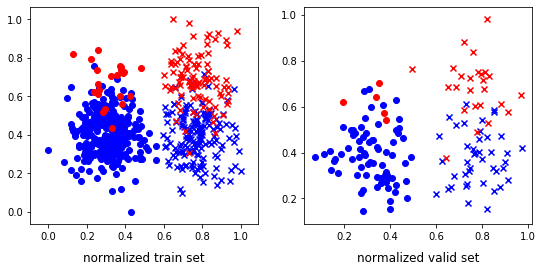

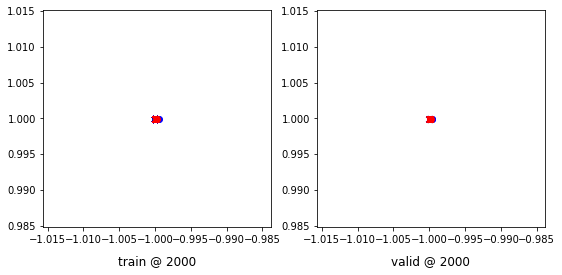

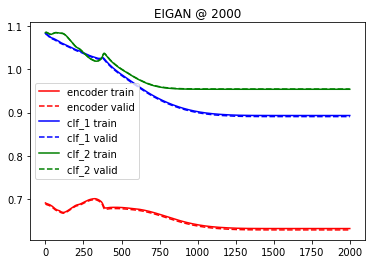

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 5/2001 [00:00<00:49, 39.96it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.07954744 	 0.07966869 	 0.05493613 	 0.05504506 	 0.04318677 	 0.04308083


 25%|██▌       | 504/2001 [00:13<00:43, 34.54it/s]

500 	 0.06125016 	 0.06136342 	 0.03694425 	 0.03702673 	 0.04412900 	 0.04399778


 50%|█████     | 1008/2001 [00:27<00:27, 35.96it/s]

1000 	 0.04762609 	 0.04774527 	 0.01868592 	 0.01875119 	 0.02990334 	 0.02972355


 75%|███████▌  | 1507/2001 [00:41<00:14, 34.26it/s]

1500 	 0.02949231 	 0.02958890 	 -0.00641497 	 -0.00636942 	 0.01052476 	 0.01037323


100%|██████████| 2001/2001 [00:54<00:00, 36.49it/s]


2000 	 0.01312996 	 0.01321902 	 -0.03351484 	 -0.03347970 	 -0.01596978 	 -0.01609887


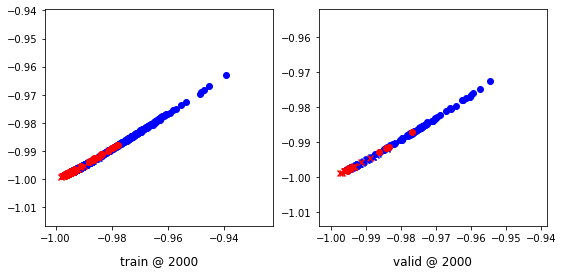

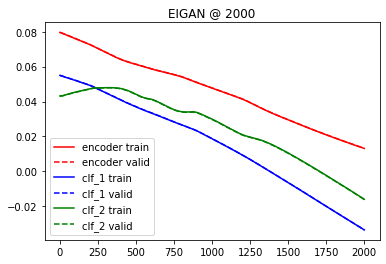

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.011003 	 1.009058 	 0.7500
200 	 0.505189 	 0.504425 	 0.9306
400 	 0.311401 	 0.323435 	 0.9167
600 	 0.304852 	 0.319008 	 0.9167
800 	 0.304262 	 0.318612 	 0.9167
1000 	 0.304054 	 0.318417 	 0.9167
Accuracy: 0.9166666666666666
Error Rate: 0.08333333333333333
F1 Score: 0.8064516129032259
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.875
Error Rate: 0.125
F1 Score: 0.7352941176470588
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9236111111111112
Error Rate: 0.0763888888888889
F1 Score: 0

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.724409 	 0.726770 	 0.9722
Accuracy: 0.9722222222222222
Error Rate: 0.027777777777777776
F1 Score: 0.9705882352941176
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9236111111111112
Error Rate: 0.0763888888888889
F1 Score: 0.9241379310344827
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9791666666666666
Error Rate: 0.020833333333333332
F1 Score: 0.9774436090225564
VAR1: 0.2, VAR2: 0.6, TRIAL: 1
X, y_1, y2
(2453, 2) (2453, 1) (2453, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1962, 2) (491, 2) (1962, 1) (491, 1) (1962, 1) (491, 1)
class weights => w1, w2 [2.0310559  1.96987952] [1.54609929 2.83116883]
tensor sizes => torch.Size([1962, 2]) torch.Size([491, 2]) torch.Size([1962, 2]) torch.Size([491, 2]) torch.Size([1962, 2]) torch.Size([491, 2])
--------------------------------------------------------------------------------
EIGAN Training
----

 25%|██▌       | 503/2001 [00:34<01:38, 15.27it/s]

500 	 0.47667903 	 0.47742993 	 0.69197851 	 0.70540535 	 0.90869635 	 0.92112261


 50%|█████     | 1003/2001 [01:08<01:10, 14.14it/s]

1000 	 0.37370950 	 0.41498214 	 0.60446960 	 0.63683069 	 0.92474395 	 0.91499573


 75%|███████▌  | 1502/2001 [01:43<00:35, 14.15it/s]

1500 	 0.37928140 	 0.40553427 	 0.60543162 	 0.62443900 	 0.91961354 	 0.91205192


100%|██████████| 2001/2001 [02:18<00:00, 14.44it/s]


2000 	 0.37925285 	 0.40524495 	 0.60028315 	 0.62432069 	 0.91460663 	 0.91222292


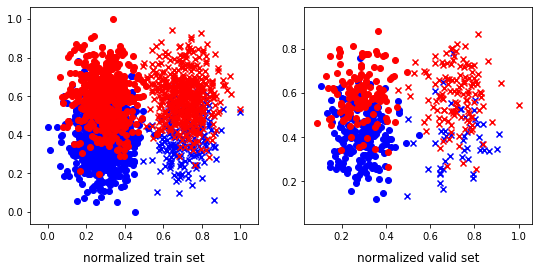

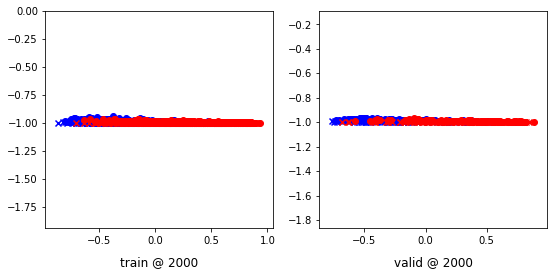

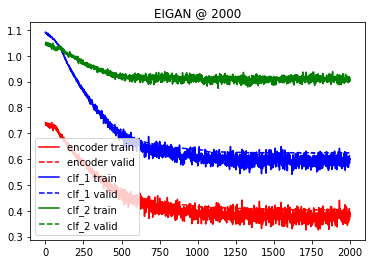

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:44, 19.18it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.05357609 	 0.05377512 	 0.02434826 	 0.02418667 	 0.02912250 	 0.02798704


 25%|██▌       | 504/2001 [00:34<01:46, 14.11it/s]

500 	 0.02480053 	 0.02396147 	 -0.00586560 	 -0.00671291 	 0.02492071 	 0.02485896


 50%|█████     | 1002/2001 [01:08<01:17, 12.82it/s]

1000 	 -0.01160391 	 -0.01273444 	 -0.05913905 	 -0.06019477 	 -0.01802229 	 -0.01785390


 75%|███████▌  | 1505/2001 [01:41<00:30, 16.14it/s]

1500 	 -0.04561826 	 -0.04531654 	 -0.11132830 	 -0.11108141 	 -0.05633936 	 -0.05644662


100%|██████████| 2001/2001 [02:15<00:00, 14.77it/s]

2000 	 -0.08348617 	 -0.08266763 	 -0.17192742 	 -0.17198648 	 -0.09739064 	 -0.09886259


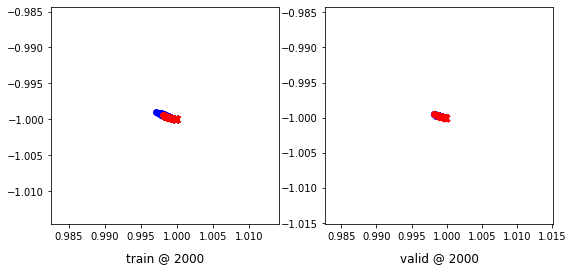

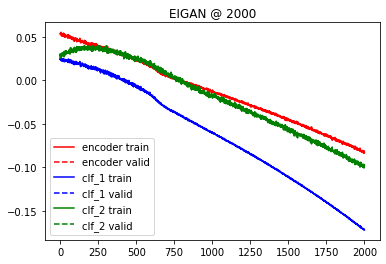

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.069464 	 1.069849 	 0.4949
200 	 0.668208 	 0.690461 	 0.7882
400 	 0.552795 	 0.592292 	 0.8106
600 	 0.552271 	 0.592282 	 0.8126
800 	 0.552058 	 0.592225 	 0.8126
1000 	 0.551886 	 0.592173 	 0.8106
Accuracy: 0.8105906313645621
Error Rate: 0.1894093686354379
F1 Score: 0.8128772635814889
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8085539714867617
Error Rate: 0.19144602851323828
F1 Score: 0.810483870967742
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8024439918533605
Error Rate: 0.197

  0%|          | 3/2001 [00:00<01:34, 21.11it/s]

Accuracy: 0.6476578411405295
Error Rate: 0.35234215885947046
F1 Score: 0.0
VAR1: 0.2, VAR2: 0.8, TRIAL: 1
X, y_1, y2
(1476, 2) (1476, 1) (1476, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1180, 2) (296, 2) (1180, 1) (296, 1) (1180, 1) (296, 1)
class weights => w1, w2 [4.35424354 1.29812981] [4.62745098 1.27567568]
tensor sizes => torch.Size([1180, 2]) torch.Size([296, 2]) torch.Size([1180, 2]) torch.Size([296, 2]) torch.Size([1180, 2]) torch.Size([296, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.56909323 	 0.61010587 	 0.97705185 	 1.01371598 	 1.10150397 	 1.09675729


 25%|██▌       | 504/2001 [00:28<01:28, 16.83it/s]

500 	 0.70352787 	 0.64128774 	 0.88113308 	 0.87969047 	 0.87087131 	 0.93154991


 50%|█████     | 1003/2001 [00:57<01:05, 15.29it/s]

1000 	 0.46785420 	 0.50789887 	 0.66673142 	 0.67208582 	 0.89211625 	 0.85733414


 75%|███████▌  | 1503/2001 [01:26<00:28, 17.69it/s]

1500 	 0.59897745 	 0.50665271 	 0.75002563 	 0.67264855 	 0.84435302 	 0.85914302


100%|██████████| 2001/2001 [01:54<00:00, 17.46it/s]


2000 	 0.44377106 	 0.50062591 	 0.60212618 	 0.67015129 	 0.85514033 	 0.86267257


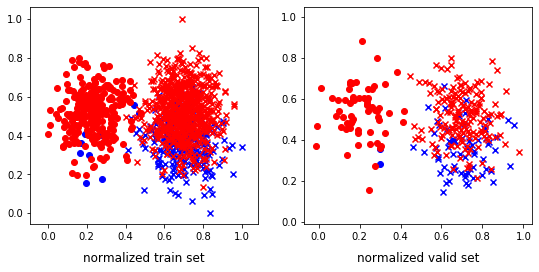

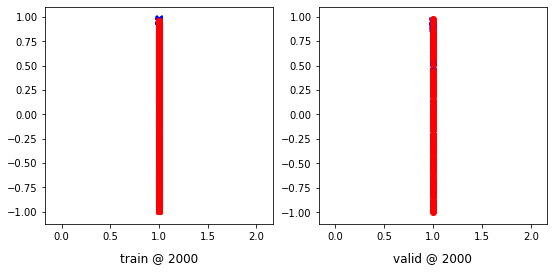

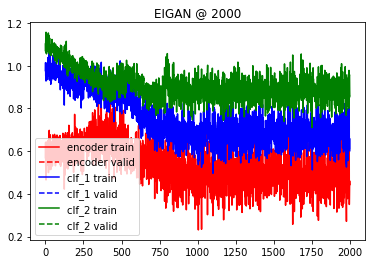

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:34, 21.13it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.02397284 	 0.02696334 	 -0.05012132 	 -0.04603623 	 -0.07206374 	 -0.07018434


 25%|██▌       | 504/2001 [00:27<01:26, 17.40it/s]

500 	 -0.03834900 	 -0.03426067 	 -0.13672186 	 -0.13510545 	 -0.11363300 	 -0.11756068


 50%|█████     | 1002/2001 [00:54<00:53, 18.83it/s]

1000 	 -0.04628031 	 -0.04458767 	 -0.20935132 	 -0.21023282 	 -0.20381840 	 -0.20699526


 75%|███████▌  | 1503/2001 [01:21<00:23, 20.80it/s]

1500 	 -0.04017493 	 -0.02948207 	 -0.29104912 	 -0.28312817 	 -0.30087322 	 -0.30363289


100%|██████████| 2001/2001 [01:48<00:00, 18.39it/s]


2000 	 0.02002609 	 0.01484752 	 -0.36136624 	 -0.36156186 	 -0.41756913 	 -0.41352212


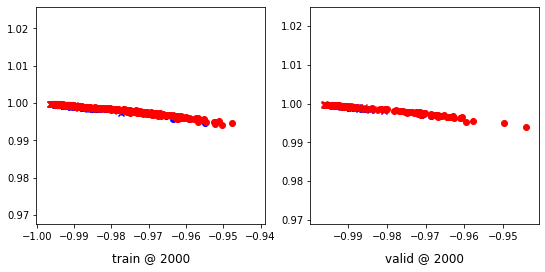

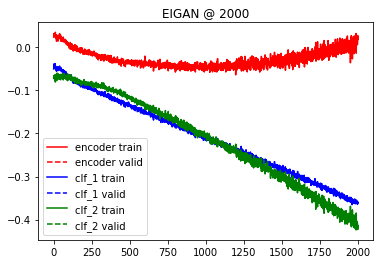

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.018763 	 1.019362 	 0.7703
200 	 0.767472 	 0.753415 	 0.8074
400 	 0.648340 	 0.619093 	 0.8108
600 	 0.646303 	 0.616751 	 0.8108
800 	 0.645135 	 0.616892 	 0.8142
1000 	 0.643603 	 0.617734 	 0.8142
Accuracy: 0.8141891891891891
Error Rate: 0.1858108108108108
F1 Score: 0.8741418764302059
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7533783783783784
Error Rate: 0.24662162162162163
F1 Score: 0.8206388206388207
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8243243243243243
Error Rate: 0.17

  0%|          | 2/2001 [00:00<01:56, 17.20it/s]

X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1918, 2) (480, 2) (1918, 1) (480, 1) (1918, 1) (480, 1)
class weights => w1, w2 [1.93152064 2.07351351] [2.12168142 1.89151874]
tensor sizes => torch.Size([1918, 2]) torch.Size([480, 2]) torch.Size([1918, 2]) torch.Size([480, 2]) torch.Size([1918, 2]) torch.Size([480, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.66729569 	 0.66729176 	 1.01458824 	 1.01434100 	 1.04082048 	 1.04019642


 25%|██▌       | 504/2001 [00:34<01:28, 16.96it/s]

500 	 0.06563696 	 0.06186944 	 0.22140323 	 0.21311611 	 0.84891039 	 0.84439385


 50%|█████     | 1003/2001 [01:09<01:02, 15.85it/s]

1000 	 -0.08955313 	 -0.10496441 	 0.05131032 	 0.04106208 	 0.83409673 	 0.83917367


 75%|███████▌  | 1505/2001 [01:43<00:27, 18.00it/s]

1500 	 -0.11116201 	 -0.12616129 	 0.03084351 	 0.02034001 	 0.83515263 	 0.83964849


100%|██████████| 2001/2001 [02:17<00:00, 14.53it/s]


2000 	 -0.11057254 	 -0.13005863 	 0.03556343 	 0.01541907 	 0.83942205 	 0.83862489


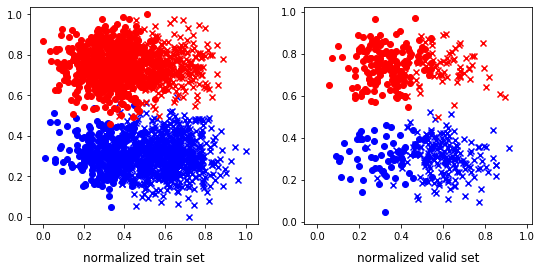

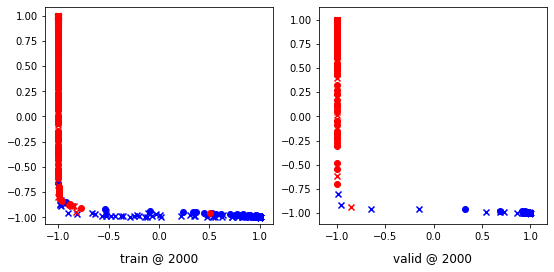

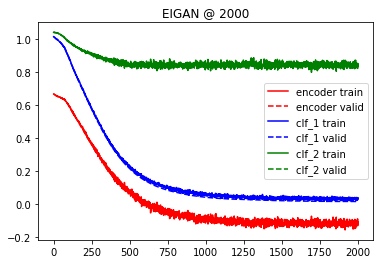

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:01, 16.47it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.06851662 	 0.06844626 	 0.03936655 	 0.03932300 	 0.02931770 	 0.02934460


 25%|██▌       | 502/2001 [00:33<01:45, 14.20it/s]

500 	 -0.04379008 	 -0.04250117 	 -0.08561493 	 -0.08413606 	 -0.00445331 	 -0.00404630


 50%|█████     | 1004/2001 [01:07<00:58, 16.91it/s]

1000 	 -0.11693466 	 -0.11684468 	 -0.18255070 	 -0.18330447 	 -0.05615193 	 -0.05779795


 75%|███████▌  | 1502/2001 [01:41<00:32, 15.16it/s]

1500 	 -0.17884210 	 -0.17962508 	 -0.27721792 	 -0.27878815 	 -0.11364852 	 -0.11490168


100%|██████████| 2001/2001 [02:13<00:00, 15.02it/s]


2000 	 -0.24503338 	 -0.24267614 	 -0.39009556 	 -0.38900587 	 -0.18087018 	 -0.18253067


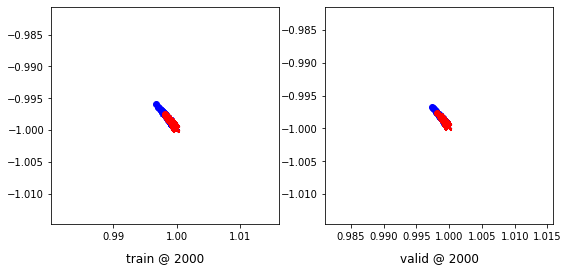

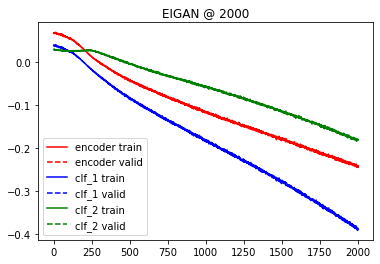

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 0.994181 	 0.993758 	 0.5188
200 	 0.256169 	 0.252199 	 0.9938
400 	 0.057723 	 0.046876 	 0.9979
600 	 0.036720 	 0.024417 	 0.9979
800 	 0.030914 	 0.017927 	 0.9979
1000 	 0.028639 	 0.015237 	 0.9979
Accuracy: 0.9979166666666667
Error Rate: 0.0020833333333333333
F1 Score: 0.9978308026030369
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9979166666666667
Error Rate: 0.0020833333333333333
F1 Score: 0.9978308026030369
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9979166666666667
Error Rate:

  0%|          | 1/2001 [00:00<03:25,  9.72it/s]

Accuracy: 0.5291666666666667
Error Rate: 0.4708333333333333
F1 Score: 0.6920980926430518
VAR1: 0.4, VAR2: 0.4, TRIAL: 1
X, y_1, y2
(2354, 2) (2354, 1) (2354, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1883, 2) (471, 2) (1883, 1) (471, 1) (1883, 1) (471, 1)
class weights => w1, w2 [1.38557763 3.59351145] [1.49563145 3.01762821]
tensor sizes => torch.Size([1883, 2]) torch.Size([471, 2]) torch.Size([1883, 2]) torch.Size([471, 2]) torch.Size([1883, 2]) torch.Size([471, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.63093293 	 0.64548504 	 1.01665080 	 1.02985585 	 1.07918465 	 1.07751799


 25%|██▌       | 502/2001 [00:34<01:53, 13.17it/s]

500 	 0.31466752 	 0.34857821 	 0.54366404 	 0.57753414 	 0.92214537 	 0.92210311


 50%|█████     | 1005/2001 [01:09<01:05, 15.31it/s]

1000 	 0.19972113 	 0.22381863 	 0.36929113 	 0.42477444 	 0.86273599 	 0.89410299


 75%|███████▌  | 1503/2001 [01:43<00:32, 15.41it/s]

1500 	 0.14730388 	 0.20751968 	 0.34003496 	 0.39840940 	 0.88587552 	 0.88403690


100%|██████████| 2001/2001 [02:18<00:00, 14.47it/s]


2000 	 0.14935252 	 0.20490807 	 0.33803242 	 0.38780922 	 0.88181633 	 0.87604833


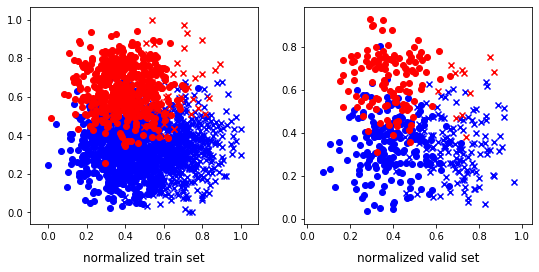

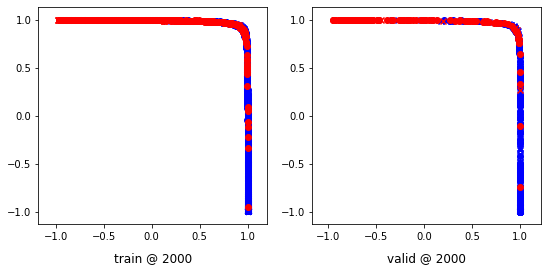

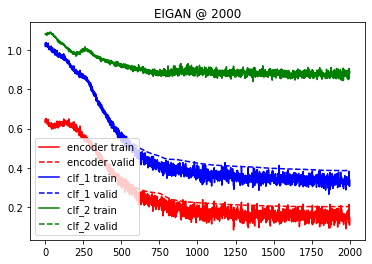

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:01, 16.44it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.02092390 	 -0.02100607 	 -0.06008342 	 -0.06031463 	 0.00211772 	 0.00173615


 25%|██▌       | 503/2001 [00:33<01:41, 14.72it/s]

500 	 -0.10661617 	 -0.10679317 	 -0.15575030 	 -0.15556327 	 -0.02161868 	 -0.02083952


 50%|█████     | 1003/2001 [01:06<01:05, 15.23it/s]

1000 	 -0.21342702 	 -0.21362360 	 -0.27567112 	 -0.27607056 	 -0.04948639 	 -0.04989391


 75%|███████▌  | 1504/2001 [01:38<00:31, 16.00it/s]

1500 	 -0.32958871 	 -0.33204141 	 -0.40668023 	 -0.40939489 	 -0.07765339 	 -0.07812493


100%|██████████| 2001/2001 [02:10<00:00, 15.33it/s]


2000 	 -0.47682473 	 -0.47168562 	 -0.57082629 	 -0.56574708 	 -0.10659663 	 -0.10669441


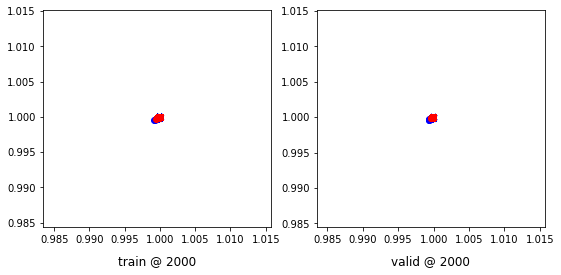

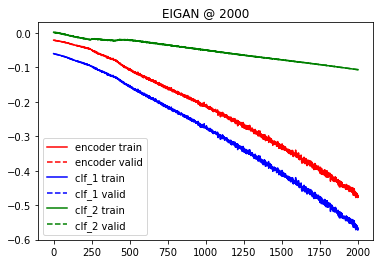

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.093777 	 1.092096 	 0.2760
200 	 0.533214 	 0.540739 	 0.8896
400 	 0.328796 	 0.368668 	 0.8896
600 	 0.319866 	 0.368433 	 0.8896
800 	 0.316888 	 0.367664 	 0.8938
1000 	 0.315048 	 0.367473 	 0.8960
Accuracy: 0.8959660297239915
Error Rate: 0.1040339702760085
F1 Score: 0.8205128205128205
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8832271762208068
Error Rate: 0.11677282377919321
F1 Score: 0.8056537102473499
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9065817409766455
Error Rate: 0.09

  0%|          | 3/2001 [00:00<01:15, 26.33it/s]

Accuracy: 0.8726114649681529
Error Rate: 0.12738853503184713
F1 Score: 0.8148148148148148
VAR1: 0.4, VAR2: 0.6, TRIAL: 1
X, y_1, y2
(1757, 2) (1757, 1) (1757, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1405, 2) (352, 2) (1405, 1) (352, 1) (1405, 1) (352, 1)
class weights => w1, w2 [2.03034682 1.97054698] [1.52717391 2.89690722]
tensor sizes => torch.Size([1405, 2]) torch.Size([352, 2]) torch.Size([1405, 2]) torch.Size([352, 2]) torch.Size([1405, 2]) torch.Size([352, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.74684227 	 0.74476814 	 1.07825601 	 1.07778692 	 1.02493870 	 1.02616596


 25%|██▌       | 503/2001 [00:30<01:37, 15.37it/s]

500 	 0.45090896 	 0.48660612 	 0.68515325 	 0.70531017 	 0.92726171 	 0.91185123


 50%|█████     | 1004/2001 [01:01<00:57, 17.36it/s]

1000 	 0.39900303 	 0.37826896 	 0.61627120 	 0.58993828 	 0.91096222 	 0.90481651


 75%|███████▌  | 1503/2001 [01:31<00:26, 18.67it/s]

1500 	 0.34115690 	 0.37343103 	 0.58587545 	 0.58645362 	 0.93808407 	 0.90616977


100%|██████████| 2001/2001 [02:01<00:00, 16.52it/s]

2000 	 0.40157884 	 0.37588078 	 0.58696097 	 0.58558959 	 0.87909544 	 0.90285599


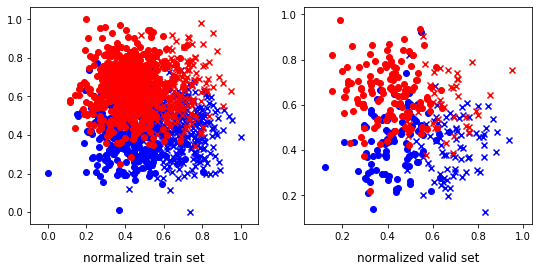

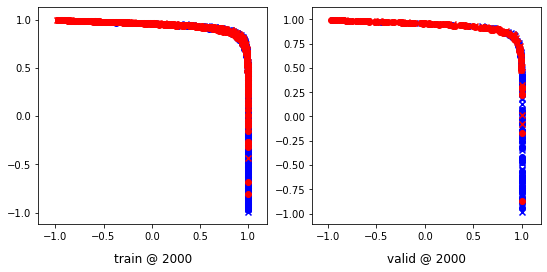

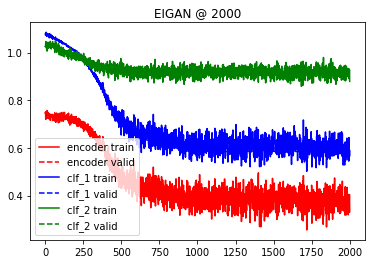

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:40, 19.85it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.01473690 	 0.01457151 	 -0.02729100 	 -0.02853527 	 -0.00495512 	 -0.00762173


 25%|██▌       | 503/2001 [00:29<01:29, 16.66it/s]

500 	 -0.19363147 	 -0.19207984 	 -0.23843908 	 -0.23899706 	 -0.01158127 	 -0.01660382


 50%|█████     | 1003/2001 [00:57<01:00, 16.58it/s]

1000 	 -0.30445984 	 -0.30571872 	 -0.37268275 	 -0.37213847 	 -0.06119148 	 -0.05772029


 75%|███████▌  | 1504/2001 [01:26<00:30, 16.43it/s]

1500 	 -0.40485486 	 -0.40428612 	 -0.49600536 	 -0.49592480 	 -0.10191078 	 -0.10271880


100%|██████████| 2001/2001 [01:55<00:00, 17.39it/s]


2000 	 -0.51372504 	 -0.51070160 	 -0.63605320 	 -0.63615644 	 -0.14975423 	 -0.15419605


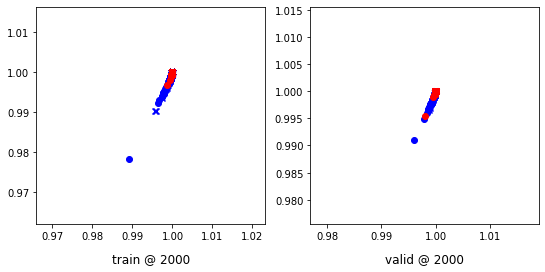

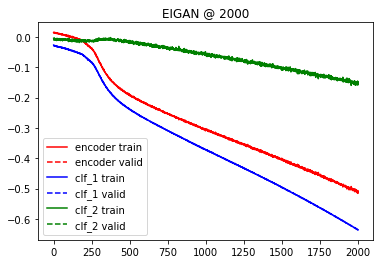

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.090030 	 1.090328 	 0.5057
200 	 0.710146 	 0.704028 	 0.8153
400 	 0.591821 	 0.580223 	 0.8153
600 	 0.590220 	 0.579595 	 0.8068
800 	 0.589840 	 0.579434 	 0.8068
1000 	 0.589598 	 0.579400 	 0.8068
Accuracy: 0.8068181818181818
Error Rate: 0.19318181818181818
F1 Score: 0.8079096045197739
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8096590909090909
Error Rate: 0.1903409090909091
F1 Score: 0.8091168091168092
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8153409090909091
Error Rate: 0.18

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.65625
Error Rate: 0.34375
F1 Score: 0.0
VAR1: 0.4, VAR2: 0.8, TRIAL: 1
X, y_1, y2
(2172, 2) (2172, 1) (2172, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1737, 2) (435, 2) (1737, 1) (435, 1) (1737, 1) (435, 1)
class weights => w1, w2 [2.29155673 1.77425945] [3.20479705 1.45355649]
tensor sizes => torch.Size([1737, 2]) torch.Size([435, 2]) torch.Size([1737, 2]) torch.Size([435, 2]) torch.Size([1737, 2]) torch.Size([435, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.75341928 	 0.74653459 	 1.07223928 	 1.06924021 	 1.01209557 	 1.01585281


 25%|██▌       | 503/2001 [00:33<01:43, 14.49it/s]

500 	 0.53426129 	 0.58387041 	 0.76390272 	 0.80767947 	 0.92287314 	 0.91695625


 50%|█████     | 1005/2001 [01:07<00:55, 17.99it/s]

1000 	 0.48427659 	 0.56471580 	 0.71423692 	 0.78428721 	 0.92317289 	 0.91271859


 75%|███████▌  | 1504/2001 [01:40<00:36, 13.67it/s]

1500 	 0.49821776 	 0.56537980 	 0.72760993 	 0.78442872 	 0.92254382 	 0.91219610


100%|██████████| 2001/2001 [02:12<00:00, 15.06it/s]


2000 	 0.45224667 	 0.56459367 	 0.68174285 	 0.78356016 	 0.92239016 	 0.91211367


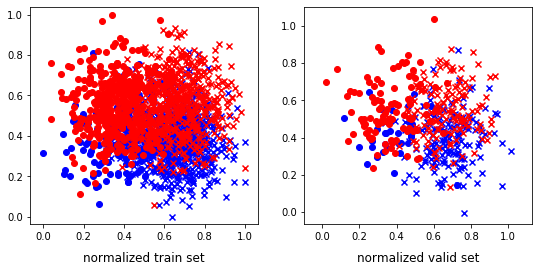

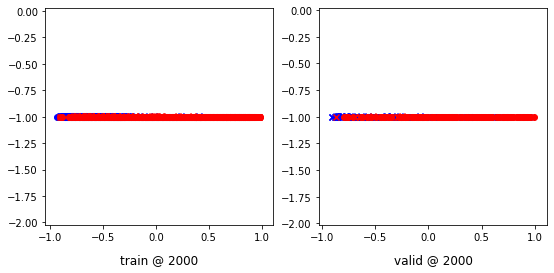

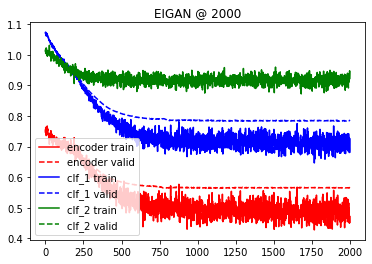

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:26, 13.66it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.09251453 	 0.09257764 	 0.04565878 	 0.04567754 	 -0.01634627 	 -0.01656433


 25%|██▌       | 504/2001 [00:30<01:35, 15.72it/s]

500 	 -0.00839452 	 -0.00849517 	 -0.06582777 	 -0.06592271 	 -0.03958702 	 -0.03964043


 50%|█████     | 1003/2001 [01:01<00:59, 16.72it/s]

1000 	 -0.04814924 	 -0.04858173 	 -0.14642197 	 -0.14689867 	 -0.11348286 	 -0.11355533


 75%|███████▌  | 1503/2001 [01:32<00:31, 15.65it/s]

1500 	 -0.08521956 	 -0.08521932 	 -0.23292045 	 -0.23307775 	 -0.18431838 	 -0.18452361


100%|██████████| 2001/2001 [02:02<00:00, 16.31it/s]


2000 	 -0.12143031 	 -0.12177931 	 -0.33199546 	 -0.33241451 	 -0.25887373 	 -0.25895011


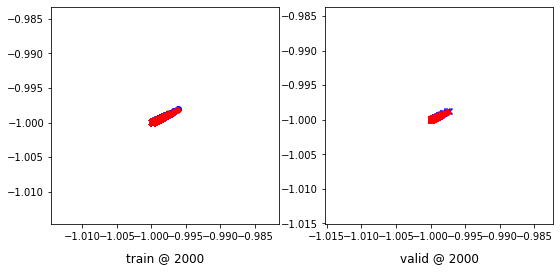

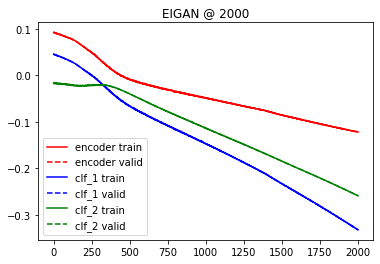

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.074218 	 1.073373 	 0.5632
200 	 0.784752 	 0.798109 	 0.7195
400 	 0.702949 	 0.747543 	 0.7287
600 	 0.700351 	 0.748890 	 0.7218
800 	 0.698434 	 0.749650 	 0.7218
1000 	 0.697111 	 0.750846 	 0.7241
Accuracy: 0.7241379310344828
Error Rate: 0.27586206896551724
F1 Score: 0.7560975609756099
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7241379310344828
Error Rate: 0.27586206896551724
F1 Score: 0.7499999999999999
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7241379310344828
Error Rate: 0.2

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.8160919540229885
Error Rate: 0.1839080459770115
F1 Score: 0.8738170347003155
VAR1: 0.6, VAR2: 0.2, TRIAL: 1
X, y_1, y2
(3040, 2) (3040, 1) (3040, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2432, 2) (608, 2) (2432, 1) (608, 1) (2432, 1) (608, 1)
class weights => w1, w2 [2.49948613 1.66689513] [1.88089714 2.13520632]
tensor sizes => torch.Size([2432, 2]) torch.Size([608, 2]) torch.Size([2432, 2]) torch.Size([608, 2]) torch.Size([2432, 2]) torch.Size([608, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.70141923 	 0.70754683 	 1.02868783 	 1.03086662 	 1.02109456 	 1.01646698


 25%|██▌       | 503/2001 [00:48<02:29, 10.02it/s]

500 	 -0.19160277 	 -0.19289327 	 0.05788311 	 0.05976254 	 0.94252366 	 0.94580299


 50%|█████     | 1002/2001 [01:35<01:41,  9.89it/s]

1000 	 -0.23424397 	 -0.23961170 	 0.01910334 	 0.01325462 	 0.94650930 	 0.94601351


 75%|███████▌  | 1503/2001 [02:22<00:44, 11.15it/s]

1500 	 -0.21944685 	 -0.24354173 	 0.02437205 	 0.00969670 	 0.93717545 	 0.94638562


100%|██████████| 2001/2001 [03:09<00:00, 10.58it/s]

2000 	 -0.21857001 	 -0.24388471 	 0.03631559 	 0.00936058 	 0.94810724 	 0.94639248


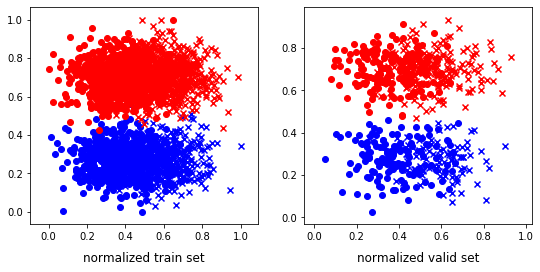

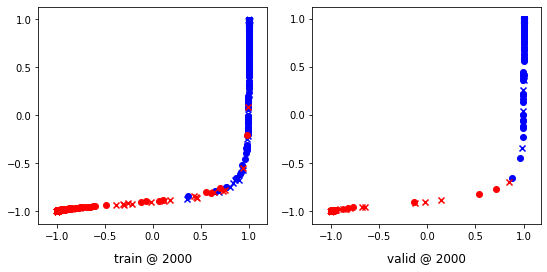

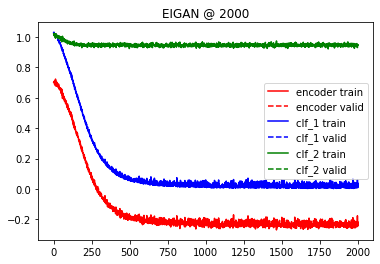

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:31, 13.18it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.05262774 	 0.05397613 	 0.00863561 	 0.00870932 	 -0.00963117 	 -0.01275999


 25%|██▌       | 502/2001 [00:46<02:20, 10.65it/s]

500 	 -0.03708016 	 -0.03546686 	 -0.09369268 	 -0.09172963 	 -0.03792031 	 -0.03719772


 50%|█████     | 1002/2001 [01:32<01:29, 11.16it/s]

1000 	 -0.12457997 	 -0.12508875 	 -0.25659233 	 -0.25548938 	 -0.16331652 	 -0.16111027


 75%|███████▌  | 1502/2001 [02:18<00:48, 10.39it/s]

1500 	 -0.17726621 	 -0.17411378 	 -0.46478105 	 -0.45104769 	 -0.33620256 	 -0.32624513


100%|██████████| 2001/2001 [03:04<00:00, 10.82it/s]


2000 	 -0.12548324 	 -0.13863844 	 -0.62191296 	 -0.62519473 	 -0.50457013 	 -0.49753585


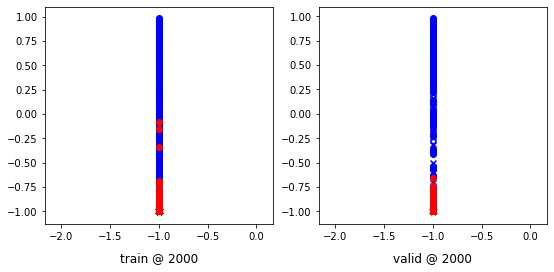

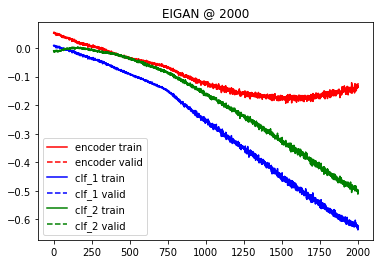

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.065910 	 1.066108 	 0.3997
200 	 0.384949 	 0.390461 	 0.9984
400 	 0.070772 	 0.069446 	 0.9967
600 	 0.037419 	 0.033913 	 0.9967
800 	 0.027812 	 0.023083 	 0.9967
1000 	 0.023700 	 0.018096 	 0.9967
Accuracy: 0.9967105263157895
Error Rate: 0.003289473684210526
F1 Score: 0.9972527472527473
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9950657894736842
Error Rate: 0.004934210526315789
F1 Score: 0.9958734525447043
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9967105263157895
Error Rate: 0

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.5493421052631579
Error Rate: 0.4506578947368421
F1 Score: 0.6040462427745664
VAR1: 0.6, VAR2: 0.4, TRIAL: 1
X, y_1, y2
(3260, 2) (3260, 1) (3260, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2608, 2) (652, 2) (2608, 1) (652, 1) (2608, 1) (652, 1)
class weights => w1, w2 [1.85227273 2.17333333] [1.90643275 2.10322581]
tensor sizes => torch.Size([2608, 2]) torch.Size([652, 2]) torch.Size([2608, 2]) torch.Size([652, 2]) torch.Size([2608, 2]) torch.Size([652, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.68391168 	 0.68449354 	 1.02335203 	 1.02816546 	 1.03274214 	 1.03681910


 25%|██▌       | 503/2001 [00:48<02:46,  8.99it/s]

500 	 0.12921423 	 0.19392338 	 0.38761598 	 0.44705418 	 0.95166367 	 0.94627798


 50%|█████     | 1003/2001 [01:38<01:38, 10.13it/s]

1000 	 0.04436699 	 0.16837183 	 0.30051208 	 0.41897193 	 0.94963837 	 0.94374728


 75%|███████▌  | 1501/2001 [02:26<00:48, 10.27it/s]

1500 	 0.09973010 	 0.16538998 	 0.35603380 	 0.41646609 	 0.94956249 	 0.94422328


100%|██████████| 2001/2001 [03:15<00:00, 10.23it/s]


2000 	 0.08906686 	 0.16455895 	 0.33050251 	 0.41634214 	 0.93593442 	 0.94493037


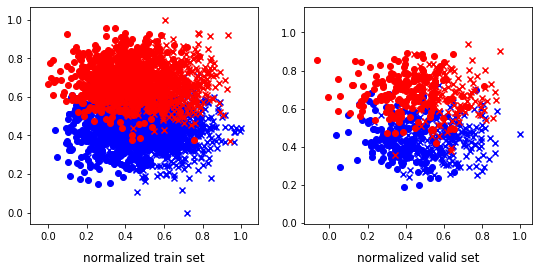

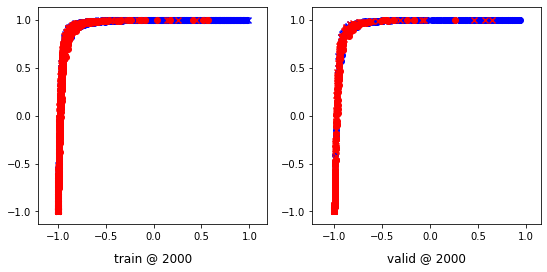

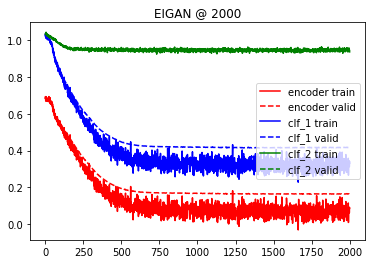

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:10, 15.36it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.07855860 	 0.07739318 	 0.02178038 	 0.02126203 	 -0.03826620 	 -0.03692013


 25%|██▌       | 501/2001 [00:47<02:20, 10.66it/s]

500 	 0.07590450 	 0.07579332 	 -0.03358198 	 -0.03403436 	 -0.13085014 	 -0.13140261


 50%|█████     | 1002/2001 [01:34<01:47,  9.33it/s]

1000 	 0.12989715 	 0.12981178 	 -0.09182994 	 -0.09195833 	 -0.27087769 	 -0.27092475


 75%|███████▌  | 1503/2001 [02:21<00:45, 11.04it/s]

1500 	 0.20506325 	 0.20549196 	 -0.08835996 	 -0.08783703 	 -0.34167722 	 -0.34159854


100%|██████████| 2001/2001 [03:08<00:00, 10.64it/s]

2000 	 0.35164040 	 0.35200661 	 -0.13465047 	 -0.13474454 	 -0.49734497 	 -0.49767551


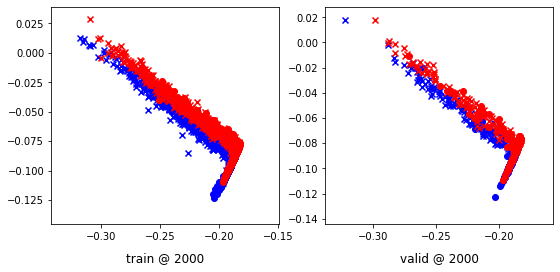

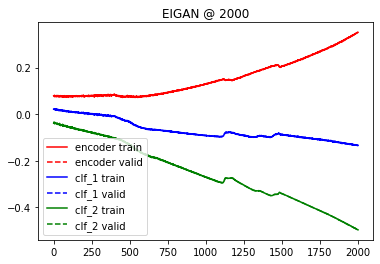

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.108755 	 1.108773 	 0.4601
200 	 0.806157 	 0.817740 	 0.8083
400 	 0.360976 	 0.419351 	 0.8742
600 	 0.323492 	 0.409706 	 0.8727
800 	 0.321621 	 0.414277 	 0.8727
1000 	 0.321354 	 0.414953 	 0.8727
Accuracy: 0.8726993865030674
Error Rate: 0.1273006134969325
F1 Score: 0.8632619439868204
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8742331288343558
Error Rate: 0.12576687116564417
F1 Score: 0.8655737704918034
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8757668711656442
Error Rate: 0.12

  0%|          | 2/2001 [00:00<02:21, 14.11it/s]

Accuracy: 0.7914110429447853
Error Rate: 0.2085889570552147
F1 Score: 0.7622377622377623
VAR1: 0.6, VAR2: 0.6, TRIAL: 1
X, y_1, y2
(1637, 2) (1637, 1) (1637, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1309, 2) (328, 2) (1309, 1) (328, 1) (1309, 1) (328, 1)
class weights => w1, w2 [1.79315068 2.26079447] [5.8963964  1.20423183]
tensor sizes => torch.Size([1309, 2]) torch.Size([328, 2]) torch.Size([1309, 2]) torch.Size([328, 2]) torch.Size([1309, 2]) torch.Size([328, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.71013236 	 0.69837701 	 1.03870523 	 1.03853226 	 1.02183008 	 1.03330243


 25%|██▌       | 504/2001 [00:30<01:38, 15.12it/s]

500 	 0.41741461 	 0.50432134 	 0.63957179 	 0.67871982 	 0.91586369 	 0.86754566


 50%|█████     | 1004/2001 [01:00<00:59, 16.69it/s]

1000 	 0.36861551 	 0.46151662 	 0.57443786 	 0.63469070 	 0.89903140 	 0.86632127


 75%|███████▌  | 1504/2001 [01:29<00:27, 17.79it/s]

1500 	 0.34594268 	 0.44895494 	 0.56092036 	 0.62789887 	 0.90813935 	 0.87209111


100%|██████████| 2001/2001 [01:59<00:00, 16.74it/s]


2000 	 0.32806718 	 0.44744915 	 0.52533782 	 0.62219059 	 0.89071381 	 0.86788863


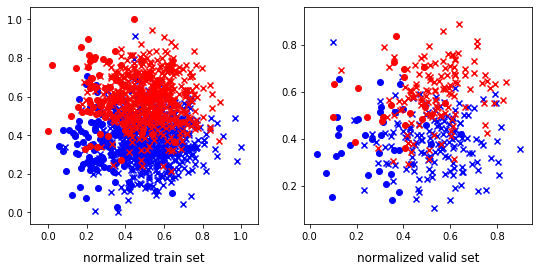

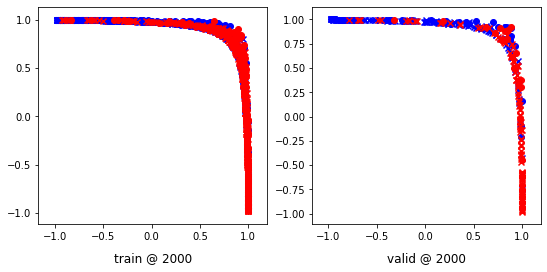

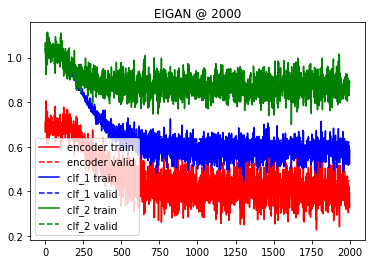

  0%|          | 0/2001 [00:00<?, ?it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.03130305 	 0.03135283 	 0.01132397 	 0.01153127 	 0.05886078 	 0.05921094


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
 25%|██▌       | 504/2001 [00:29<01:35, 15.69it/s]

500 	 -0.10558534 	 -0.10571863 	 -0.13641199 	 -0.13652173 	 0.02447654 	 0.02449189


 50%|█████     | 1003/2001 [00:57<00:55, 17.94it/s]

1000 	 -0.17775850 	 -0.17695914 	 -0.22242574 	 -0.22211345 	 -0.01134389 	 -0.01249541


 75%|███████▌  | 1503/2001 [01:25<00:30, 16.30it/s]

1500 	 -0.24802041 	 -0.24819311 	 -0.31202045 	 -0.31251326 	 -0.05298187 	 -0.05361418


100%|██████████| 2001/2001 [01:53<00:00, 17.63it/s]


2000 	 -0.32844615 	 -0.32915318 	 -0.41743898 	 -0.41770002 	 -0.09831651 	 -0.09756821


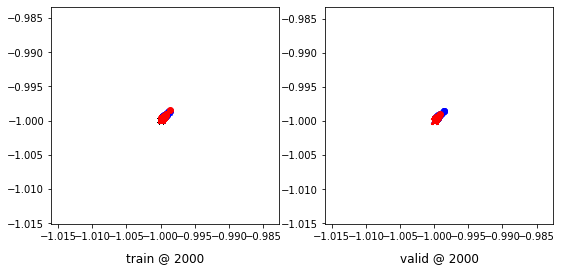

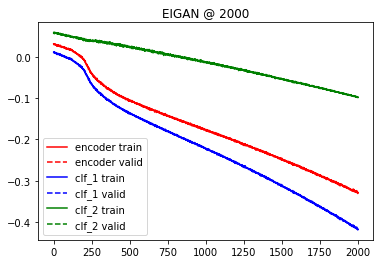

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.027615 	 1.026935 	 0.4421
200 	 0.797485 	 0.811326 	 0.7896
400 	 0.584123 	 0.615771 	 0.7988
600 	 0.582945 	 0.614608 	 0.7988
800 	 0.582810 	 0.614360 	 0.7988
1000 	 0.582713 	 0.614077 	 0.7988
Accuracy: 0.7987804878048781
Error Rate: 0.20121951219512196
F1 Score: 0.777027027027027
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.801829268292683
Error Rate: 0.19817073170731708
F1 Score: 0.7840531561461794
SVM
--------------------------------------------------------------------------------
Accuracy: 0.801829268292683
Error Rate: 0.1981

  0%|          | 0/2001 [00:00<?, ?it/s]

X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2230, 2) (558, 2) (2230, 1) (558, 1) (2230, 1) (558, 1)
class weights => w1, w2 [2.30610134 1.76563737] [1.42401022 3.35843373]
tensor sizes => torch.Size([2230, 2]) torch.Size([558, 2]) torch.Size([2230, 2]) torch.Size([558, 2]) torch.Size([2230, 2]) torch.Size([558, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.67822599 	 0.65551460 	 1.02566171 	 1.03115129 	 1.04091918 	 1.06878388


 25%|██▌       | 502/2001 [00:47<02:24, 10.34it/s]

500 	 0.44131601 	 0.50766879 	 0.68948835 	 0.73521310 	 0.94328380 	 0.92069149


 50%|█████     | 1001/2001 [01:34<01:33, 10.66it/s]

1000 	 0.48087835 	 0.50108838 	 0.68080825 	 0.72436172 	 0.89322901 	 0.91642052


 75%|███████▌  | 1503/2001 [02:21<00:49, 10.11it/s]

1500 	 0.54682463 	 0.50351459 	 0.77002037 	 0.72820377 	 0.91843802 	 0.91783637


100%|██████████| 2001/2001 [03:08<00:00, 10.63it/s]


2000 	 0.40192622 	 0.49636388 	 0.62326133 	 0.72224176 	 0.91539222 	 0.91902506


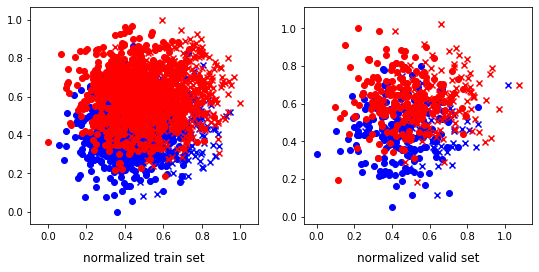

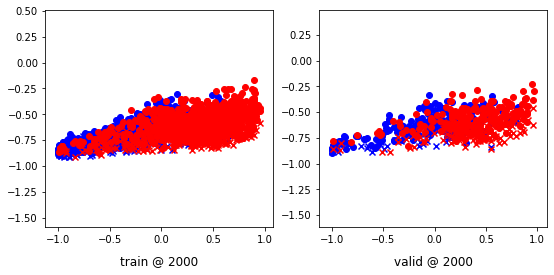

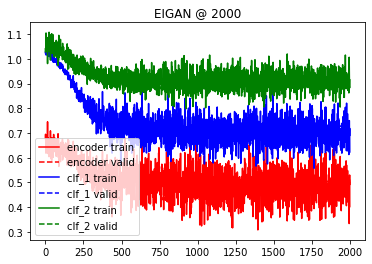

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 1/2001 [00:00<03:47,  8.81it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.00226880 	 -0.00121496 	 -0.04273411 	 -0.04104929 	 -0.00108106 	 0.00041461


 25%|██▌       | 502/2001 [00:45<02:13, 11.24it/s]

500 	 -0.09869406 	 -0.09988934 	 -0.16492523 	 -0.16404583 	 -0.05735156 	 -0.05329132


 50%|█████     | 1002/2001 [01:31<01:37, 10.24it/s]

1000 	 -0.18076330 	 -0.18076625 	 -0.28334460 	 -0.28413951 	 -0.12028136 	 -0.12151710


 75%|███████▌  | 1502/2001 [02:16<00:44, 11.22it/s]

1500 	 -0.27370423 	 -0.27162880 	 -0.43659225 	 -0.43705028 	 -0.20359203 	 -0.20672041


100%|██████████| 2001/2001 [03:02<00:00, 10.97it/s]


2000 	 -0.36136621 	 -0.36509240 	 -0.62537605 	 -0.62640065 	 -0.31381819 	 -0.31118318


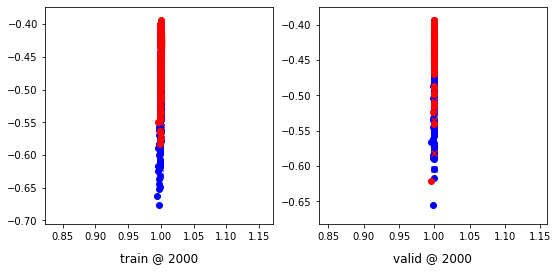

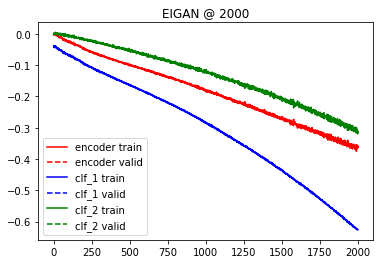

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.065254 	 1.064990 	 0.5663
200 	 0.877718 	 0.880447 	 0.6703
400 	 0.693752 	 0.715234 	 0.7670
600 	 0.693248 	 0.715122 	 0.7652
800 	 0.693188 	 0.715104 	 0.7652
1000 	 0.693111 	 0.715002 	 0.7670
Accuracy: 0.7670250896057348
Error Rate: 0.23297491039426524
F1 Score: 0.8006134969325154
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7616487455197133
Error Rate: 0.23835125448028674
F1 Score: 0.7912087912087913
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7634408602150538
Error Rate: 0.2

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.7007168458781362
Error Rate: 0.2992831541218638
F1 Score: 0.0
VAR1: 0.8, VAR2: 0.2, TRIAL: 1
X, y_1, y2
(1826, 2) (1826, 1) (1826, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1460, 2) (366, 2) (1460, 1) (366, 1) (1460, 1) (366, 1)
class weights => w1, w2 [2.64014467 1.60970232] [2.21884498 1.82044888]
tensor sizes => torch.Size([1460, 2]) torch.Size([366, 2]) torch.Size([1460, 2]) torch.Size([366, 2]) torch.Size([1460, 2]) torch.Size([366, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.68773079 	 0.69283378 	 1.02828228 	 1.03263223 	 1.03399110 	 1.03294563


 25%|██▌       | 502/2001 [00:30<01:36, 15.51it/s]

500 	 0.10122532 	 0.09217566 	 0.29011998 	 0.28535634 	 0.88213634 	 0.88632786


 50%|█████     | 1004/2001 [01:01<01:04, 15.40it/s]

1000 	 -0.09352323 	 -0.11683509 	 0.09302001 	 0.07528552 	 0.87968910 	 0.88526779


 75%|███████▌  | 1504/2001 [01:31<00:26, 19.04it/s]

1500 	 -0.14134593 	 -0.13557887 	 0.05479315 	 0.05601985 	 0.88940203 	 0.88474590


100%|██████████| 2001/2001 [02:01<00:00, 16.45it/s]


2000 	 -0.15323587 	 -0.14526688 	 0.05126552 	 0.04707177 	 0.89808923 	 0.88548583


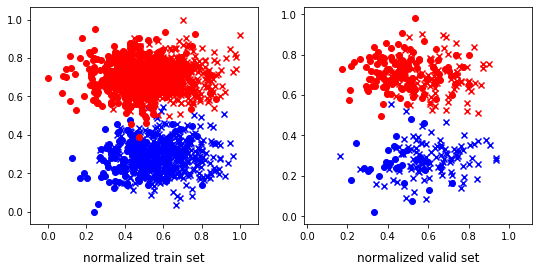

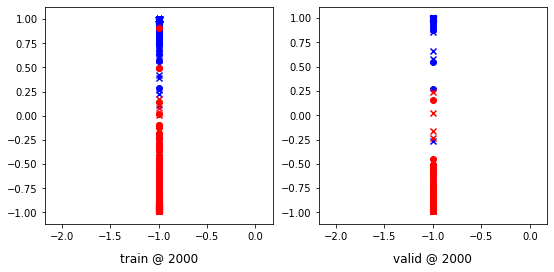

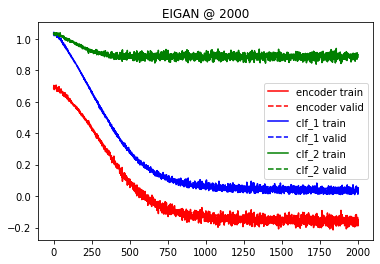

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:34, 21.21it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.11082502 	 0.11063188 	 0.09167121 	 0.09159180 	 0.06176755 	 0.06201420


 25%|██▌       | 503/2001 [00:29<01:30, 16.58it/s]

500 	 0.01733578 	 0.01872632 	 -0.01121583 	 -0.00924929 	 0.03109050 	 0.03274088


 50%|█████     | 1003/2001 [00:59<01:03, 15.79it/s]

1000 	 -0.01850890 	 -0.01549730 	 -0.08127352 	 -0.07853567 	 -0.05052761 	 -0.05107443


 75%|███████▌  | 1503/2001 [01:29<00:31, 15.96it/s]

1500 	 -0.03381424 	 -0.03466021 	 -0.14797196 	 -0.15016706 	 -0.13786203 	 -0.13986300


100%|██████████| 2001/2001 [01:58<00:00, 16.86it/s]


2000 	 -0.06681673 	 -0.06845564 	 -0.23582511 	 -0.23900548 	 -0.21109495 	 -0.21297680


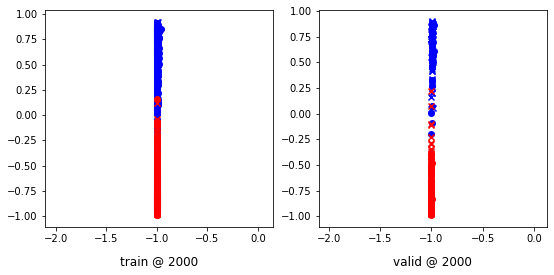

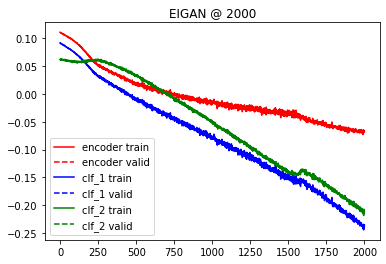

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.023018 	 1.024089 	 0.6202
200 	 0.358607 	 0.349849 	 0.9863
400 	 0.063134 	 0.065404 	 0.9918
600 	 0.035713 	 0.043980 	 0.9918
800 	 0.029019 	 0.040885 	 0.9918
1000 	 0.027318 	 0.041180 	 0.9918
Accuracy: 0.9918032786885246
Error Rate: 0.00819672131147541
F1 Score: 0.9934065934065934
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9918032786885246
Error Rate: 0.00819672131147541
F1 Score: 0.9934065934065934
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9918032786885246
Error Rate: 0.0

  0%|          | 2/2001 [00:00<02:06, 15.76it/s]

Accuracy: 0.6912568306010929
Error Rate: 0.3087431693989071
F1 Score: 0.7002652519893898
VAR1: 0.8, VAR2: 0.4, TRIAL: 1
X, y_1, y2
(2670, 2) (2670, 1) (2670, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2136, 2) (534, 2) (2136, 1) (534, 1) (2136, 1) (534, 1)
class weights => w1, w2 [2.0518732  1.95068493] [2.05780347 1.94535519]
tensor sizes => torch.Size([2136, 2]) torch.Size([534, 2]) torch.Size([2136, 2]) torch.Size([534, 2]) torch.Size([2136, 2]) torch.Size([534, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.70251489 	 0.72615278 	 1.06883049 	 1.09240663 	 1.05982292 	 1.05940104


 25%|██▌       | 503/2001 [00:46<02:07, 11.74it/s]

500 	 0.17871684 	 0.22313020 	 0.38630557 	 0.43423650 	 0.90089005 	 0.90425348


 50%|█████     | 1002/2001 [01:32<01:36, 10.36it/s]

1000 	 0.15542224 	 0.13739491 	 0.31781426 	 0.35083187 	 0.85524511 	 0.90658414


 75%|███████▌  | 1503/2001 [02:18<00:44, 11.21it/s]

1500 	 0.28956509 	 0.13131326 	 0.50077671 	 0.34240460 	 0.90570533 	 0.90423852


100%|██████████| 2001/2001 [03:04<00:00, 10.84it/s]

2000 	 0.09776077 	 0.13044783 	 0.29774237 	 0.34150073 	 0.89338410 	 0.90420008


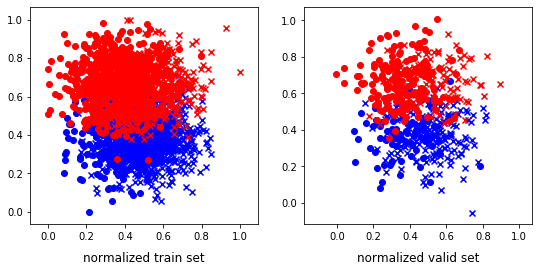

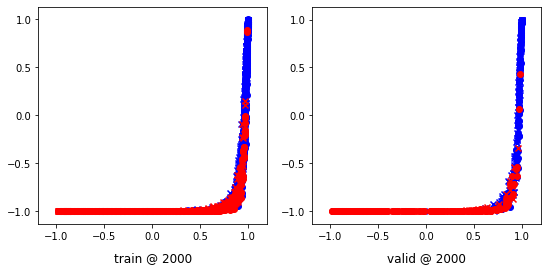

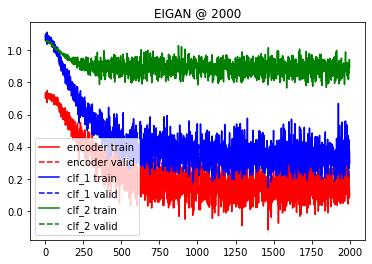

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:24, 13.79it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.01535506 	 0.01560843 	 -0.05080299 	 -0.05309136 	 -0.05718341 	 -0.06210645


 25%|██▌       | 502/2001 [00:44<02:15, 11.10it/s]

500 	 -0.00384966 	 0.00092981 	 -0.11361928 	 -0.10998988 	 -0.13130501 	 -0.13304609


 50%|█████     | 1002/2001 [01:28<01:25, 11.62it/s]

1000 	 -0.02308962 	 -0.02579299 	 -0.22881004 	 -0.22941440 	 -0.25356007 	 -0.25124428


 75%|███████▌  | 1502/2001 [02:13<00:43, 11.37it/s]

1500 	 -0.02604252 	 -0.03252640 	 -0.38740280 	 -0.38783956 	 -0.40113235 	 -0.39608148


100%|██████████| 2001/2001 [02:58<00:00, 11.20it/s]


2000 	 0.01846480 	 0.02582794 	 -0.56679189 	 -0.57010436 	 -0.56502068 	 -0.57196653


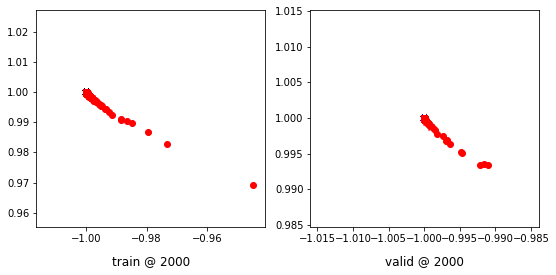

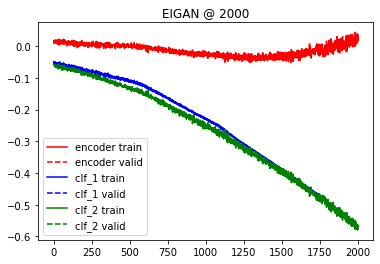

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.038762 	 1.038696 	 0.5131
200 	 0.630783 	 0.626518 	 0.8989
400 	 0.353314 	 0.346271 	 0.9045
600 	 0.337490 	 0.329753 	 0.8989
800 	 0.336918 	 0.329053 	 0.8989
1000 	 0.336837 	 0.329009 	 0.8989
Accuracy: 0.898876404494382
Error Rate: 0.10112359550561797
F1 Score: 0.9003690036900369
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.897003745318352
Error Rate: 0.10299625468164794
F1 Score: 0.898336414048059
SVM
--------------------------------------------------------------------------------
Accuracy: 0.898876404494382
Error Rate: 0.10112

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.5149812734082397
Error Rate: 0.4850187265917603
F1 Score: 0.6798516687268232
VAR1: 0.8, VAR2: 0.6, TRIAL: 1
X, y_1, y2
(2590, 2) (2590, 1) (2590, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2072, 2) (518, 2) (2072, 1) (518, 1) (2072, 1) (518, 1)
class weights => w1, w2 [1.60123648 2.66323907] [2.49939686 1.66693484]
tensor sizes => torch.Size([2072, 2]) torch.Size([518, 2]) torch.Size([2072, 2]) torch.Size([518, 2]) torch.Size([2072, 2]) torch.Size([518, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.58517182 	 0.67732430 	 0.97838593 	 1.01962340 	 1.08643401 	 1.03544629


 25%|██▌       | 503/2001 [00:46<02:02, 12.28it/s]

500 	 0.55079126 	 0.49744451 	 0.70367706 	 0.64468133 	 0.84618187 	 0.84038401


 50%|█████     | 1002/2001 [01:32<01:30, 11.07it/s]

1000 	 0.53868562 	 0.47948825 	 0.64075059 	 0.62392801 	 0.79589641 	 0.83758694


 75%|███████▌  | 1502/2001 [02:17<00:50,  9.79it/s]

1500 	 0.72669786 	 0.47378260 	 0.67328727 	 0.61594111 	 0.64367384 	 0.83530569


100%|██████████| 2001/2001 [03:02<00:00, 10.95it/s]


2000 	 0.34617263 	 0.46639270 	 0.47361159 	 0.61061943 	 0.82187647 	 0.83737391


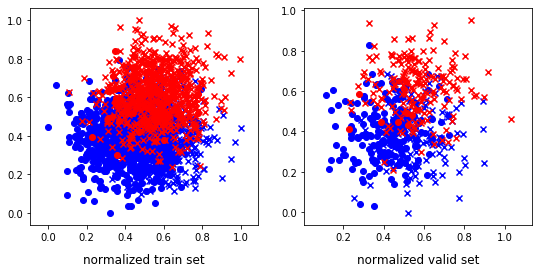

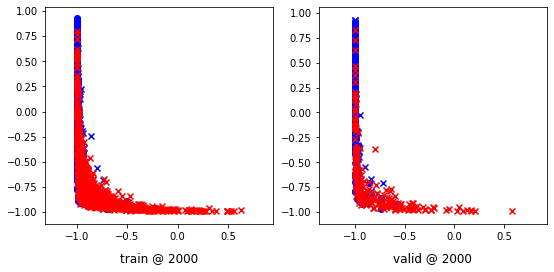

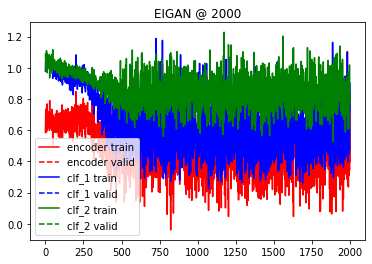

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<03:01, 11.02it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.05069182 	 -0.05236937 	 -0.08107325 	 -0.08119586 	 0.02575790 	 0.03021635


 25%|██▌       | 502/2001 [00:44<02:23, 10.46it/s]

500 	 -0.18893550 	 -0.16444869 	 -0.24696976 	 -0.21722187 	 -0.04089576 	 -0.02972413


 50%|█████     | 1002/2001 [01:29<01:30, 11.10it/s]

1000 	 -0.30890077 	 -0.28973693 	 -0.39722019 	 -0.37146837 	 -0.09718546 	 -0.08588710


 75%|███████▌  | 1502/2001 [02:13<00:40, 12.21it/s]

1500 	 -0.45923513 	 -0.43192041 	 -0.57140672 	 -0.55508530 	 -0.13492027 	 -0.15094857


100%|██████████| 2001/2001 [02:58<00:00, 11.21it/s]

2000 	 -0.56977665 	 -0.60051376 	 -0.74152946 	 -0.78404003 	 -0.21443066 	 -0.22839965


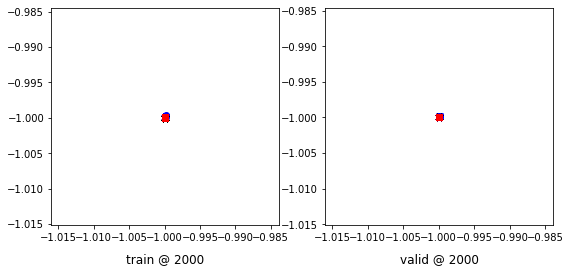

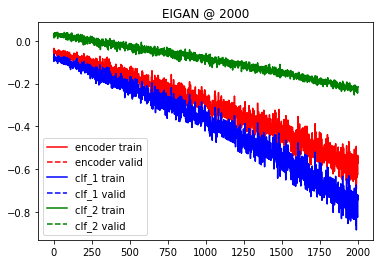

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.065896 	 1.065893 	 0.3745
200 	 0.850523 	 0.848769 	 0.7934
400 	 0.541608 	 0.568076 	 0.8147
600 	 0.538564 	 0.571413 	 0.8147
800 	 0.538012 	 0.571441 	 0.8147
1000 	 0.537596 	 0.571328 	 0.8147
Accuracy: 0.8146718146718147
Error Rate: 0.18532818532818532
F1 Score: 0.7611940298507462
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8011583011583011
Error Rate: 0.19884169884169883
F1 Score: 0.7529976019184653
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8127413127413128
Error Rate: 0.1

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.7432432432432432
Error Rate: 0.25675675675675674
F1 Score: 0.783739837398374
VAR1: 0.8, VAR2: 0.8, TRIAL: 1
X, y_1, y2
(2769, 2) (2769, 1) (2769, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2215, 2) (554, 2) (2215, 1) (554, 1) (2215, 1) (554, 1)
class weights => w1, w2 [2.72113022 1.58101356] [2.19306931 1.83817427]
tensor sizes => torch.Size([2215, 2]) torch.Size([554, 2]) torch.Size([2215, 2]) torch.Size([554, 2]) torch.Size([2215, 2]) torch.Size([554, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.69712842 	 0.69510865 	 1.05138099 	 1.04604959 	 1.04758632 	 1.04408813


 25%|██▌       | 502/2001 [00:46<02:34,  9.68it/s]

500 	 0.55406690 	 0.50680047 	 0.82492304 	 0.76551282 	 0.96421552 	 0.95185953


 50%|█████     | 1002/2001 [01:33<01:33, 10.65it/s]

1000 	 0.51511115 	 0.46511662 	 0.76655149 	 0.72383827 	 0.94878769 	 0.95186883


 75%|███████▌  | 1501/2001 [02:19<00:47, 10.62it/s]

1500 	 0.42811030 	 0.45671129 	 0.69950223 	 0.71540844 	 0.96581781 	 0.95184433


100%|██████████| 2001/2001 [03:06<00:00, 10.75it/s]


2000 	 0.38252234 	 0.45582658 	 0.65026760 	 0.71450931 	 0.96071202 	 0.95182991


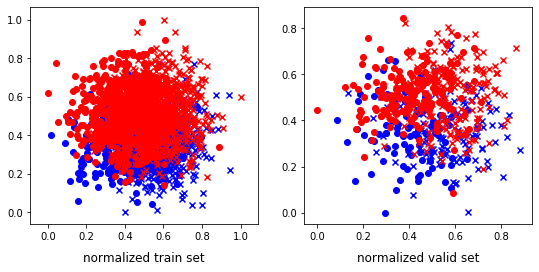

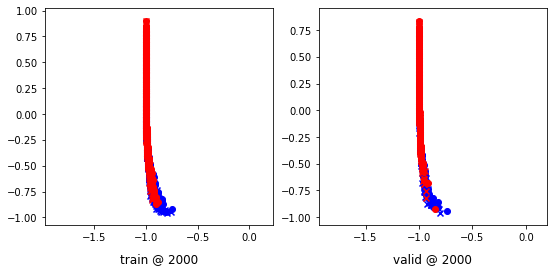

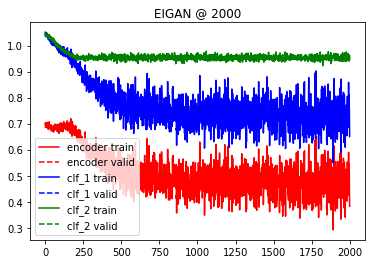

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:14, 14.86it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.02510833 	 -0.02238425 	 -0.08178201 	 -0.07905095 	 -0.03795522 	 -0.03804769


 25%|██▌       | 502/2001 [00:46<02:38,  9.47it/s]

500 	 -0.07970521 	 -0.09463659 	 -0.23473747 	 -0.23969734 	 -0.19369170 	 -0.18086840


 50%|█████     | 1002/2001 [01:30<01:23, 11.92it/s]

1000 	 -0.17219019 	 -0.16800791 	 -0.51516777 	 -0.51184446 	 -0.38564196 	 -0.38637578


 75%|███████▌  | 1502/2001 [02:15<00:45, 10.93it/s]

1500 	 -0.21162507 	 -0.20202819 	 -0.58754992 	 -0.56016546 	 -0.41311803 	 -0.39844570


100%|██████████| 2001/2001 [03:01<00:00, 11.04it/s]


2000 	 -0.22488528 	 -0.22295552 	 -0.58670092 	 -0.58967477 	 -0.40150672 	 -0.40557349


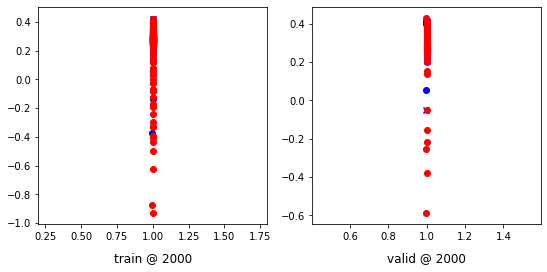

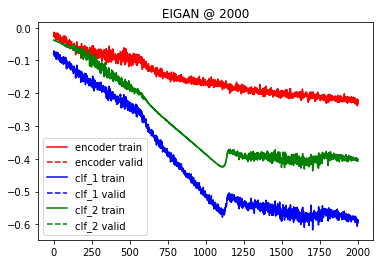

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.058217 	 1.057575 	 0.3664
200 	 0.754539 	 0.747763 	 0.7563
400 	 0.727212 	 0.716295 	 0.7617
600 	 0.726912 	 0.716170 	 0.7617
800 	 0.726716 	 0.716302 	 0.7617
1000 	 0.726450 	 0.716807 	 0.7617
Accuracy: 0.7617328519855595
Error Rate: 0.23826714801444043
F1 Score: 0.8108882521489972
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.759927797833935
Error Rate: 0.24007220216606498
F1 Score: 0.800599700149925
SVM
--------------------------------------------------------------------------------
Accuracy: 0.759927797833935
Error Rate: 0.2400

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.7057761732851986
Error Rate: 0.29422382671480146
F1 Score: 0.7457098283931357
Writing trial 1 ...
VAR1: 0.2, VAR2: 0.2, TRIAL: 2
X, y_1, y2
(2039, 2) (2039, 1) (2039, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1631, 2) (408, 2) (1631, 1) (408, 1) (1631, 1) (408, 1)
class weights => w1, w2 [3.36983471 1.42197036] [1.60058881 2.66503268]
tensor sizes => torch.Size([1631, 2]) torch.Size([408, 2]) torch.Size([1631, 2]) torch.Size([408, 2]) torch.Size([1631, 2]) torch.Size([408, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.64499187 	 0.64549029 	 1.00910509 	 1.01199400 	 1.05745244 	 1.05965090


 25%|██▌       | 503/2001 [00:32<01:21, 18.33it/s]

500 	 0.01703402 	 0.01925313 	 0.27341795 	 0.26128995 	 0.94955820 	 0.93518400


 50%|█████     | 1003/2001 [01:04<01:05, 15.12it/s]

1000 	 -0.20418420 	 -0.19813004 	 0.04853138 	 0.04358223 	 0.94609064 	 0.93485945


 75%|███████▌  | 1502/2001 [01:37<00:32, 15.46it/s]

1500 	 -0.22299099 	 -0.21703520 	 0.03032755 	 0.02434669 	 0.94652039 	 0.93452907


100%|██████████| 2001/2001 [02:09<00:00, 15.45it/s]


2000 	 -0.22484997 	 -0.22082895 	 0.01392734 	 0.02058137 	 0.93185681 	 0.93455750


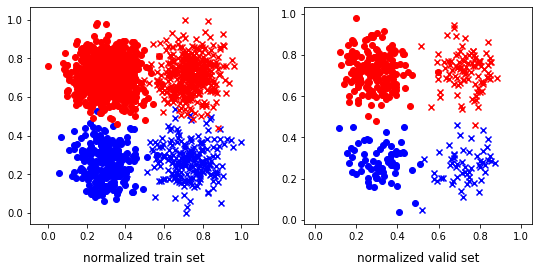

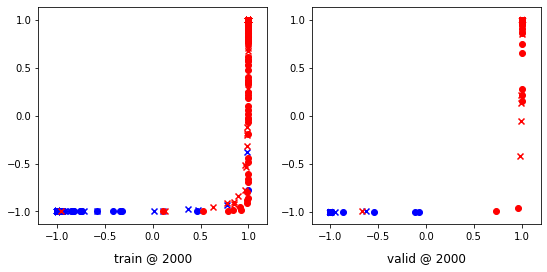

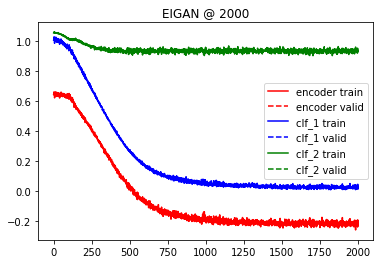

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 1/2001 [00:00<03:33,  9.38it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.01479518 	 -0.01601185 	 -0.03800628 	 -0.03907507 	 0.04783208 	 0.04813420


 25%|██▌       | 504/2001 [00:31<01:28, 16.99it/s]

500 	 -0.11563659 	 -0.11514675 	 -0.14874338 	 -0.14878549 	 0.01807383 	 0.01659134


 50%|█████     | 1003/2001 [01:02<01:15, 13.15it/s]

1000 	 -0.17462113 	 -0.17462470 	 -0.22776379 	 -0.22790237 	 -0.03052542 	 -0.03081954


 75%|███████▌  | 1504/2001 [01:32<00:27, 17.94it/s]

1500 	 -0.23226747 	 -0.23250757 	 -0.31139693 	 -0.31113982 	 -0.08129943 	 -0.08041444


100%|██████████| 2001/2001 [02:02<00:00, 16.35it/s]


2000 	 -0.29222459 	 -0.29173896 	 -0.40789351 	 -0.40740326 	 -0.14010130 	 -0.14009458


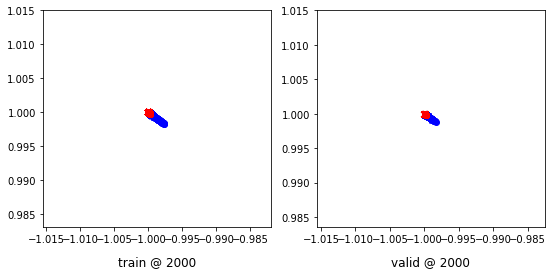

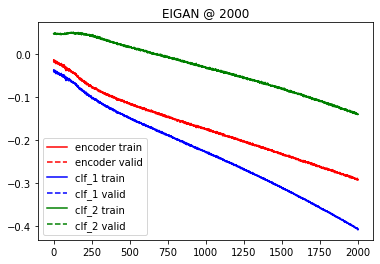

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.016353 	 1.014461 	 0.7059
200 	 0.306138 	 0.301809 	 0.9853
400 	 0.060489 	 0.053600 	 0.9975
600 	 0.034086 	 0.026877 	 0.9975
800 	 0.025514 	 0.018138 	 0.9951
1000 	 0.022806 	 0.015282 	 0.9951
Accuracy: 0.9950980392156863
Error Rate: 0.004901960784313725
F1 Score: 0.9965156794425087
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9950980392156863
Error Rate: 0.004901960784313725
F1 Score: 0.9965156794425087
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9975490196078431
Error Rate: 0

  0%|          | 3/2001 [00:00<01:26, 23.19it/s]

Accuracy: 0.625
Error Rate: 0.375
F1 Score: 0.0
VAR1: 0.2, VAR2: 0.4, TRIAL: 2
X, y_1, y2
(2173, 2) (2173, 1) (2173, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1738, 2) (435, 2) (1738, 1) (435, 1) (1738, 1) (435, 1)
class weights => w1, w2 [4.14797136 1.3176649 ] [2.03512881 1.96606335]
tensor sizes => torch.Size([1738, 2]) torch.Size([435, 2]) torch.Size([1738, 2]) torch.Size([435, 2]) torch.Size([1738, 2]) torch.Size([435, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.64252889 	 0.67066002 	 0.98234051 	 1.01077068 	 1.03334391 	 1.03325784


 25%|██▌       | 503/2001 [00:32<01:43, 14.44it/s]

500 	 0.21823296 	 0.20004496 	 0.42751464 	 0.41696808 	 0.90245849 	 0.91007030


 50%|█████     | 1002/2001 [01:06<01:03, 15.65it/s]

1000 	 0.10962555 	 0.07725832 	 0.32559112 	 0.28815624 	 0.90914279 	 0.90404510


 75%|███████▌  | 1503/2001 [01:38<00:33, 14.97it/s]

1500 	 0.09234163 	 0.06616694 	 0.30067348 	 0.27398300 	 0.90146387 	 0.90096325


100%|██████████| 2001/2001 [02:12<00:00, 15.14it/s]


2000 	 0.09956720 	 0.06250036 	 0.30209145 	 0.27002949 	 0.89594626 	 0.90067631


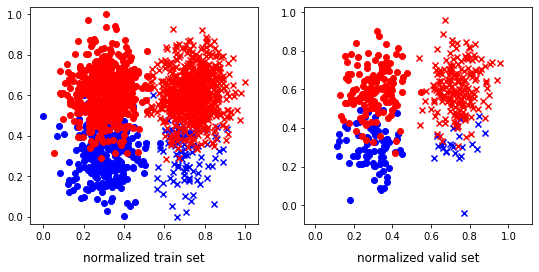

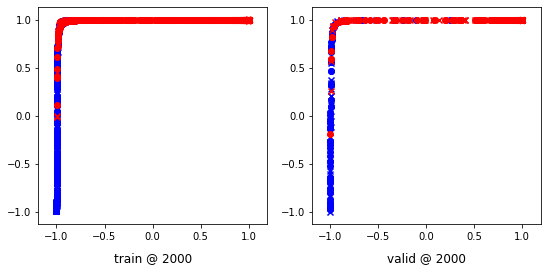

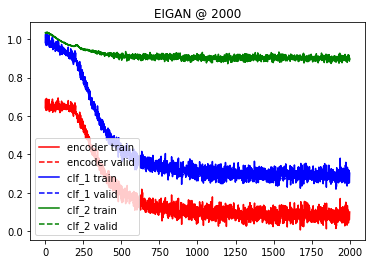

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:28, 22.46it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.03077832 	 -0.03080557 	 -0.05125453 	 -0.05125200 	 0.05705487 	 0.05700901


 25%|██▌       | 504/2001 [00:31<01:33, 16.02it/s]

500 	 -0.08236843 	 -0.08220632 	 -0.10724840 	 -0.10715292 	 0.04228511 	 0.04205507


 50%|█████     | 1002/2001 [01:02<01:04, 15.60it/s]

1000 	 -0.11659333 	 -0.11669882 	 -0.15675560 	 -0.15689868 	 -0.00040196 	 -0.00049903


 75%|███████▌  | 1504/2001 [01:34<00:30, 16.04it/s]

1500 	 -0.20423567 	 -0.20148464 	 -0.26410615 	 -0.26097202 	 -0.04461181 	 -0.04390036


100%|██████████| 2001/2001 [02:05<00:00, 15.96it/s]


2000 	 -0.32169685 	 -0.31891105 	 -0.41602522 	 -0.41261289 	 -0.10711853 	 -0.10610755


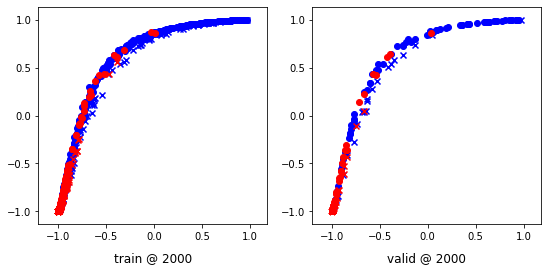

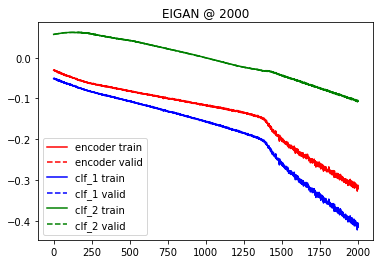

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 0.982070 	 0.980004 	 0.7609
200 	 0.461366 	 0.453003 	 0.9195
400 	 0.283668 	 0.272089 	 0.9172
600 	 0.277542 	 0.266072 	 0.9195
800 	 0.277124 	 0.265806 	 0.9218
1000 	 0.276993 	 0.265818 	 0.9218
Accuracy: 0.9218390804597701
Error Rate: 0.07816091954022988
F1 Score: 0.9473684210526315
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9126436781609195
Error Rate: 0.08735632183908046
F1 Score: 0.9402515723270439
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9149425287356322
Error Rate: 0.0

  0%|          | 2/2001 [00:00<01:44, 19.19it/s]

Accuracy: 0.6620689655172414
Error Rate: 0.33793103448275863
F1 Score: 0.7178502879078694
VAR1: 0.2, VAR2: 0.6, TRIAL: 2
X, y_1, y2
(1309, 2) (1309, 1) (1309, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1047, 2) (262, 2) (1047, 1) (262, 1) (1047, 1) (262, 1)
class weights => w1, w2 [1.25690276 4.89252336] [1.30548628 4.27346939]
tensor sizes => torch.Size([1047, 2]) torch.Size([262, 2]) torch.Size([1047, 2]) torch.Size([262, 2]) torch.Size([1047, 2]) torch.Size([262, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.58940339 	 0.69350970 	 0.98089975 	 1.01988184 	 1.08481288 	 1.01951933


 25%|██▌       | 504/2001 [00:26<01:30, 16.62it/s]

500 	 0.53476608 	 0.66574329 	 0.83900088 	 0.89408815 	 0.99738199 	 0.92149204


 50%|█████     | 1003/2001 [00:54<00:55, 18.06it/s]

1000 	 0.86851430 	 0.67910129 	 0.99313241 	 0.89386094 	 0.81776553 	 0.90790683


 75%|███████▌  | 1503/2001 [01:21<00:26, 18.57it/s]

1500 	 0.86953229 	 0.49272680 	 0.86672509 	 0.70656681 	 0.69436961 	 0.90698719


100%|██████████| 2001/2001 [01:47<00:00, 18.56it/s]


2000 	 0.48079473 	 0.39354646 	 0.66316992 	 0.60854530 	 0.87482750 	 0.90814602


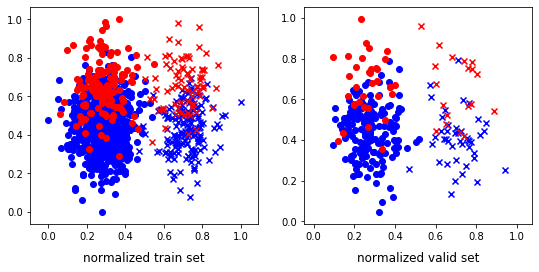

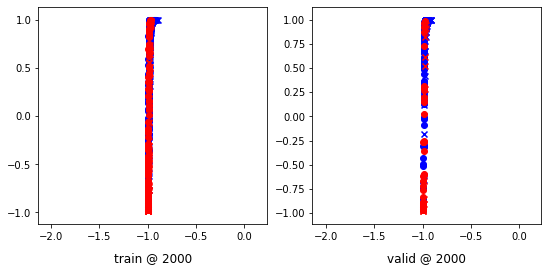

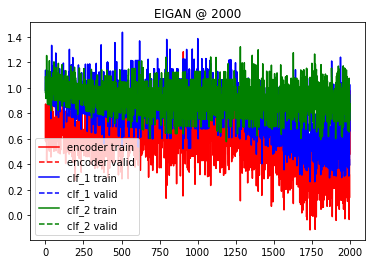

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:26, 23.19it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.11071887 	 0.11170759 	 0.05165356 	 0.05292044 	 -0.04295923 	 -0.04246061


 25%|██▌       | 504/2001 [00:26<01:18, 19.01it/s]

500 	 -0.00022470 	 0.01491783 	 -0.07072870 	 -0.05797347 	 -0.06551270 	 -0.06998390


 50%|█████     | 1004/2001 [00:53<00:52, 19.11it/s]

1000 	 -0.06462733 	 -0.06618915 	 -0.17262205 	 -0.17484361 	 -0.12862253 	 -0.12962776


 75%|███████▌  | 1502/2001 [01:19<00:23, 21.09it/s]

1500 	 -0.11779763 	 -0.12407117 	 -0.27220050 	 -0.27740008 	 -0.19294101 	 -0.19157235


100%|██████████| 2001/2001 [01:44<00:00, 19.22it/s]


2000 	 -0.16918948 	 -0.17630576 	 -0.38946110 	 -0.39012367 	 -0.26933104 	 -0.26240447


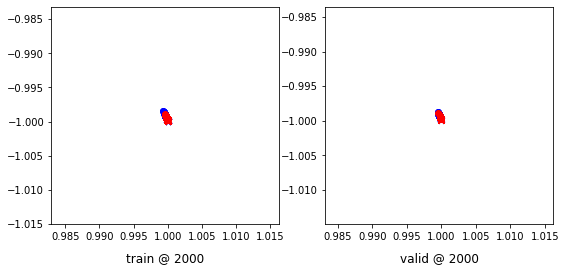

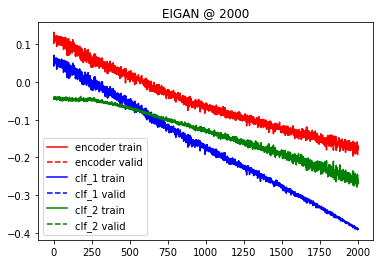

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.006875 	 1.009009 	 0.2748
200 	 0.695992 	 0.689825 	 0.8473
400 	 0.561862 	 0.562917 	 0.8550
600 	 0.558520 	 0.560098 	 0.8550
800 	 0.558194 	 0.560001 	 0.8550
1000 	 0.558123 	 0.559925 	 0.8550
Accuracy: 0.8549618320610687
Error Rate: 0.1450381679389313
F1 Score: 0.6415094339622641
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8320610687022901
Error Rate: 0.16793893129770993
F1 Score: 0.65625
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8549618320610687
Error Rate: 0.1450381679389

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.903952 	 0.907888 	 0.7634
Accuracy: 0.7633587786259542
Error Rate: 0.2366412213740458
F1 Score: 0.0
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8854961832061069
Error Rate: 0.11450381679389313
F1 Score: 0.8026315789473685
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7633587786259542
Error Rate: 0.2366412213740458
F1 Score: 0.0
VAR1: 0.2, VAR2: 0.8, TRIAL: 2
X, y_1, y2
(521, 2) (521, 1) (521, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(416, 2) (105, 2) (416, 1) (105, 1) (416, 1) (105, 1)
class weights => w1, w2 [6.11764706 1.1954023 ] [4.95238095 1.25301205]
tensor sizes => torch.Size([416, 2]) torch.Size([105, 2]) torch.Size([416, 2]) torch.Size([105, 2]) torch.Size([416, 2]) torch.Size([105, 2])
--------------------------------------------------------------------------------
EIGAN Training
----------------------------------------------

  0%|          | 5/2001 [00:00<00:46, 42.57it/s]

0 	 0.61586416 	 0.62857032 	 0.99837381 	 1.00908899 	 1.07590616 	 1.07366586


 25%|██▌       | 507/2001 [00:13<00:40, 37.05it/s]

500 	 0.59315711 	 0.61341882 	 0.87106794 	 0.88883048 	 0.97107673 	 0.96855885


 50%|█████     | 1004/2001 [00:26<00:27, 35.86it/s]

1000 	 0.52896827 	 0.50704539 	 0.77125227 	 0.74455738 	 0.93544757 	 0.93065917


 75%|███████▌  | 1505/2001 [00:40<00:12, 40.92it/s]

1500 	 0.51344311 	 0.51713789 	 0.72018349 	 0.72326124 	 0.90002882 	 0.89927053


100%|██████████| 2001/2001 [00:53<00:00, 37.21it/s]


2000 	 0.49201679 	 0.51580602 	 0.67946792 	 0.70050204 	 0.88059050 	 0.87784320


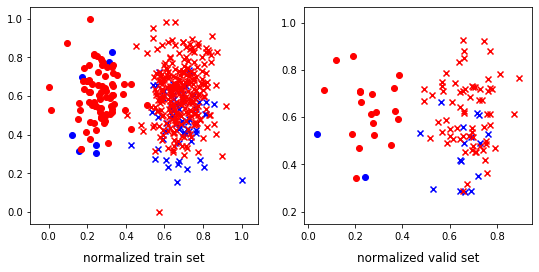

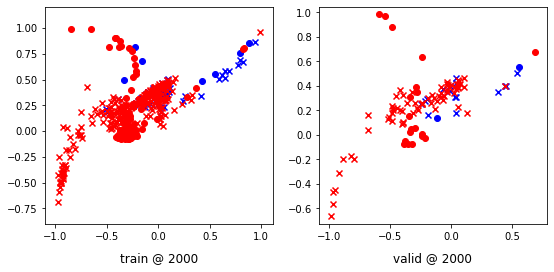

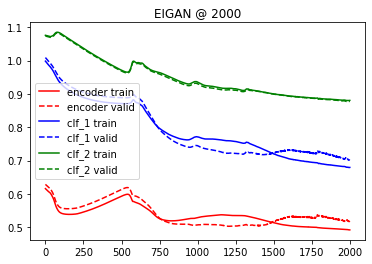

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 5/2001 [00:00<00:51, 39.03it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.02769157 	 0.02803812 	 -0.01048005 	 -0.01005861 	 0.00468659 	 0.00481616


 25%|██▌       | 507/2001 [00:12<00:35, 41.64it/s]

500 	 -0.02253340 	 -0.02207488 	 -0.06638689 	 -0.06581382 	 -0.00922525 	 -0.00913858


 50%|█████     | 1008/2001 [00:25<00:25, 38.20it/s]

1000 	 -0.05496969 	 -0.05430476 	 -0.10914502 	 -0.10843843 	 -0.03274832 	 -0.03266643


 75%|███████▌  | 1506/2001 [00:37<00:14, 33.98it/s]

1500 	 -0.07563032 	 -0.07480071 	 -0.14681572 	 -0.14596170 	 -0.06680218 	 -0.06676016


100%|██████████| 2001/2001 [00:50<00:00, 39.72it/s]


2000 	 -0.09335411 	 -0.09241989 	 -0.18177660 	 -0.18082519 	 -0.09735870 	 -0.09733028


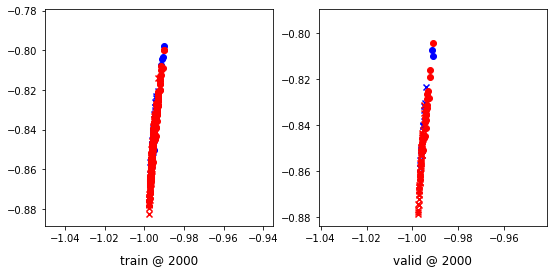

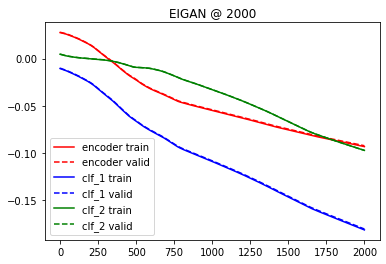

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.065937 	 1.077880 	 0.1714
200 	 0.806233 	 0.795023 	 0.8286
400 	 0.754358 	 0.713809 	 0.8381
600 	 0.745506 	 0.705240 	 0.8476
800 	 0.734867 	 0.697959 	 0.8381
1000 	 0.723322 	 0.695022 	 0.8286
Accuracy: 0.8285714285714286
Error Rate: 0.17142857142857143
F1 Score: 0.901098901098901
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.6761904761904762
Error Rate: 0.3238095238095238
F1 Score: 0.7763157894736842
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8285714285714286
Error Rate: 0.171

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.790449 	 0.789452 	 0.8000
Accuracy: 0.8
Error Rate: 0.2
F1 Score: 0.888888888888889
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8666666666666667
Error Rate: 0.13333333333333333
F1 Score: 0.9125000000000001
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8666666666666667
Error Rate: 0.13333333333333333
F1 Score: 0.9186046511627907
VAR1: 0.4, VAR2: 0.2, TRIAL: 2
X, y_1, y2
(2304, 2) (2304, 1) (2304, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1843, 2) (461, 2) (1843, 1) (461, 1) (1843, 1) (461, 1)
class weights => w1, w2 [4.1509009  1.31736955] [2.20718563 1.82837302]
tensor sizes => torch.Size([1843, 2]) torch.Size([461, 2]) torch.Size([1843, 2]) torch.Size([461, 2]) torch.Size([1843, 2]) torch.Size([461, 2])
--------------------------------------------------------------------------------
EIGAN Training
-------------------------------------

 25%|██▌       | 504/2001 [00:32<01:34, 15.92it/s]

500 	 0.18437979 	 0.18754697 	 0.44639486 	 0.44839823 	 0.95516515 	 0.95399845


 50%|█████     | 1003/2001 [01:06<01:08, 14.48it/s]

1000 	 -0.18590218 	 -0.14899752 	 0.07852764 	 0.11063120 	 0.95768023 	 0.95277590


 75%|███████▌  | 1502/2001 [01:39<00:32, 15.34it/s]

1500 	 -0.23128678 	 -0.18051831 	 0.02643614 	 0.07914104 	 0.95124578 	 0.95280653


100%|██████████| 2001/2001 [02:10<00:00, 15.36it/s]


2000 	 -0.25120360 	 -0.17416985 	 0.00871771 	 0.08554398 	 0.95306271 	 0.95286101


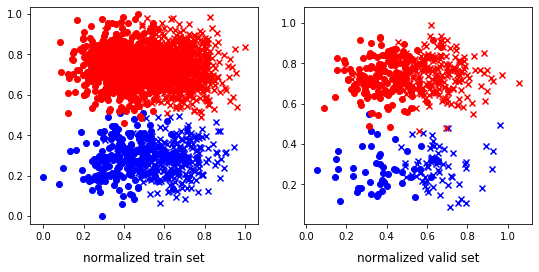

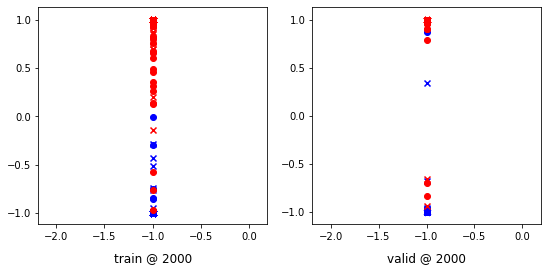

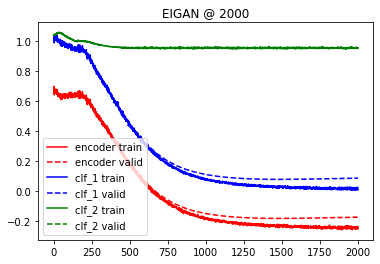

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:34, 21.06it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.02074498 	 0.01971135 	 -0.01647478 	 -0.01786659 	 0.00719029 	 0.00614969


 25%|██▌       | 501/2001 [00:32<01:48, 13.88it/s]

500 	 -0.05288865 	 -0.04799890 	 -0.09491766 	 -0.09158465 	 -0.00494460 	 -0.00877200


 50%|█████     | 1003/2001 [01:05<01:02, 15.98it/s]

1000 	 -0.09424307 	 -0.09758761 	 -0.15505478 	 -0.15824251 	 -0.04659559 	 -0.04628215


 75%|███████▌  | 1503/2001 [01:39<00:33, 14.77it/s]

1500 	 -0.14216423 	 -0.14165390 	 -0.22745870 	 -0.22788449 	 -0.09205093 	 -0.09365045


100%|██████████| 2001/2001 [02:11<00:00, 15.25it/s]


2000 	 -0.18361312 	 -0.18231967 	 -0.30807316 	 -0.30878583 	 -0.15278780 	 -0.15562080


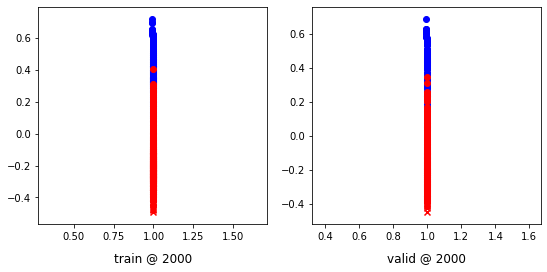

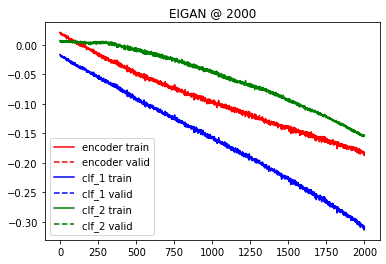

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.062867 	 1.061379 	 0.2386
200 	 0.329152 	 0.328741 	 0.9826
400 	 0.058756 	 0.067177 	 0.9935
600 	 0.029023 	 0.041428 	 0.9892
800 	 0.020687 	 0.035722 	 0.9892
1000 	 0.017006 	 0.034220 	 0.9892
Accuracy: 0.9891540130151844
Error Rate: 0.010845986984815618
F1 Score: 0.9928469241773963
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9891540130151844
Error Rate: 0.010845986984815618
F1 Score: 0.9928469241773963
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9891540130151844
Error Rate: 0

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.6832971800433839
Error Rate: 0.31670281995661603
F1 Score: 0.6826086956521739
VAR1: 0.4, VAR2: 0.4, TRIAL: 2
X, y_1, y2
(1807, 2) (1807, 1) (1807, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1445, 2) (362, 2) (1445, 1) (362, 1) (1445, 1) (362, 1)
class weights => w1, w2 [3.78272251 1.3593603 ] [4.00277008 1.33302583]
tensor sizes => torch.Size([1445, 2]) torch.Size([362, 2]) torch.Size([1445, 2]) torch.Size([362, 2]) torch.Size([1445, 2]) torch.Size([362, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.70916188 	 0.69555569 	 1.05752015 	 1.04086220 	 1.04173791 	 1.03845370


 25%|██▌       | 502/2001 [00:30<01:32, 16.22it/s]

500 	 0.36051565 	 0.29527792 	 0.54916918 	 0.48893133 	 0.88195992 	 0.88680059


 50%|█████     | 1004/2001 [01:01<00:56, 17.50it/s]

1000 	 0.24963024 	 0.21137524 	 0.44190469 	 0.37749499 	 0.88547194 	 0.85926694


 75%|███████▌  | 1504/2001 [01:32<00:31, 15.79it/s]

1500 	 0.22947136 	 0.21335199 	 0.38593733 	 0.36393419 	 0.85052043 	 0.84372938


100%|██████████| 2001/2001 [02:02<00:00, 16.36it/s]

2000 	 0.23370361 	 0.21638945 	 0.38638714 	 0.36124673 	 0.84626359 	 0.83800447


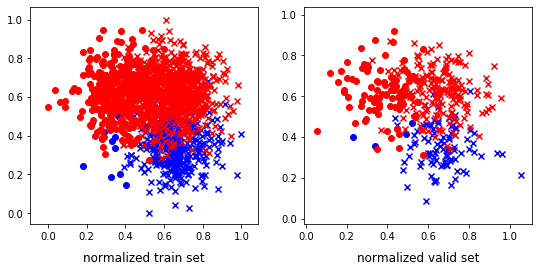

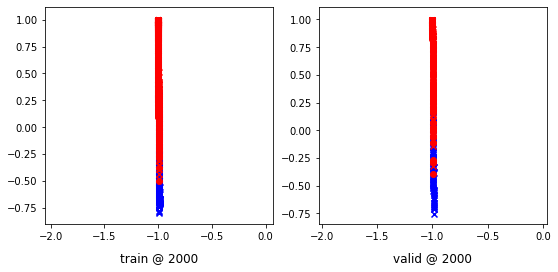

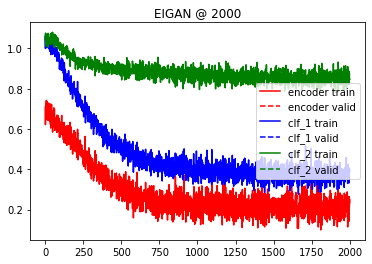

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:32, 21.57it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.05930994 	 0.05910199 	 0.01245760 	 0.01186823 	 -0.01640746 	 -0.01733329


 25%|██▌       | 504/2001 [00:28<01:34, 15.78it/s]

500 	 0.02890213 	 0.02831220 	 -0.04703326 	 -0.04713515 	 -0.07556015 	 -0.07467680


 50%|█████     | 1004/2001 [00:58<01:01, 16.21it/s]

1000 	 0.01154451 	 0.01185847 	 -0.08741012 	 -0.08590063 	 -0.11455105 	 -0.11266450


 75%|███████▌  | 1503/2001 [01:27<00:30, 16.28it/s]

1500 	 -0.01423727 	 -0.01203442 	 -0.15398954 	 -0.15132825 	 -0.17382513 	 -0.17322089


100%|██████████| 2001/2001 [01:56<00:00, 17.22it/s]


2000 	 -0.02890772 	 -0.03253101 	 -0.23212396 	 -0.23197226 	 -0.25079250 	 -0.24658847


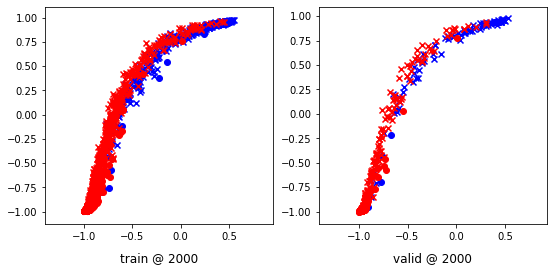

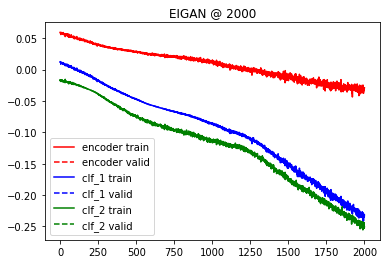

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.030183 	 1.031114 	 0.7348
200 	 0.591166 	 0.592531 	 0.8867
400 	 0.374177 	 0.365532 	 0.8840
600 	 0.359410 	 0.348767 	 0.8950
800 	 0.356384 	 0.346029 	 0.8950
1000 	 0.353062 	 0.343648 	 0.8950
Accuracy: 0.8950276243093923
Error Rate: 0.10497237569060773
F1 Score: 0.9269230769230768
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8812154696132597
Error Rate: 0.11878453038674033
F1 Score: 0.9141716566866267
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9088397790055248
Error Rate: 0.0

  0%|          | 2/2001 [00:00<01:42, 19.50it/s]

tensor sizes => torch.Size([1951, 2]) torch.Size([488, 2]) torch.Size([1951, 2]) torch.Size([488, 2]) torch.Size([1951, 2]) torch.Size([488, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.70859861 	 0.69639027 	 1.05590987 	 1.05586624 	 1.04095912 	 1.05262315


 25%|██▌       | 502/2001 [00:35<01:48, 13.85it/s]

500 	 0.46062493 	 0.50443733 	 0.69722778 	 0.73850316 	 0.92987460 	 0.92721301


 50%|█████     | 1003/2001 [01:10<01:04, 15.52it/s]

1000 	 0.36348808 	 0.42056924 	 0.60307723 	 0.65338898 	 0.93271756 	 0.92596692


 75%|███████▌  | 1502/2001 [01:45<00:35, 14.19it/s]

1500 	 0.37221414 	 0.40492272 	 0.57164723 	 0.63789904 	 0.89265800 	 0.92612350


100%|██████████| 2001/2001 [02:21<00:00, 14.15it/s]


2000 	 0.37015826 	 0.40076089 	 0.59603775 	 0.63381809 	 0.91904563 	 0.92620438


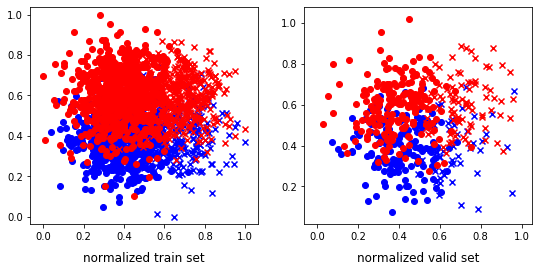

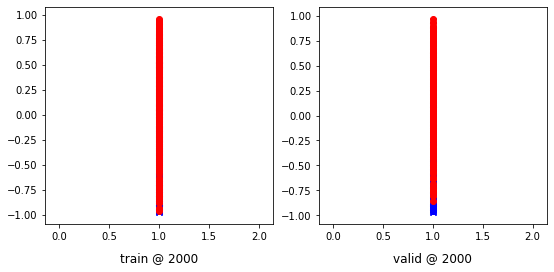

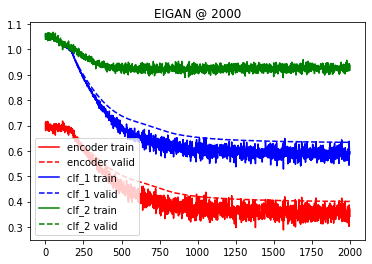

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:45, 12.05it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.07809678 	 -0.07865274 	 -0.10479636 	 -0.10484757 	 0.03664870 	 0.03815183


 25%|██▌       | 501/2001 [00:35<01:41, 14.74it/s]

500 	 -0.16276398 	 -0.16277489 	 -0.21825555 	 -0.21895376 	 -0.03555339 	 -0.03702083


 50%|█████     | 1002/2001 [01:09<00:59, 16.72it/s]

1000 	 -0.26940590 	 -0.26991874 	 -0.38510939 	 -0.38460129 	 -0.14014633 	 -0.13864811


 75%|███████▌  | 1502/2001 [01:43<00:36, 13.79it/s]

1500 	 -0.36524153 	 -0.36743486 	 -0.56368005 	 -0.56636059 	 -0.24546407 	 -0.24601087


100%|██████████| 2001/2001 [02:17<00:00, 14.59it/s]


2000 	 -0.43869013 	 -0.43823513 	 -0.76287681 	 -0.76412773 	 -0.36937389 	 -0.37087002


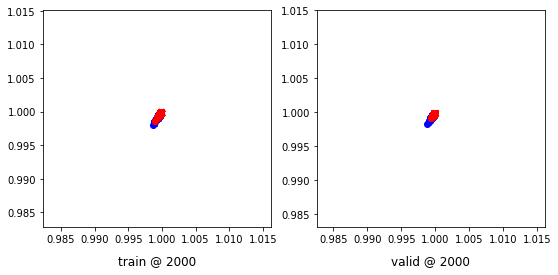

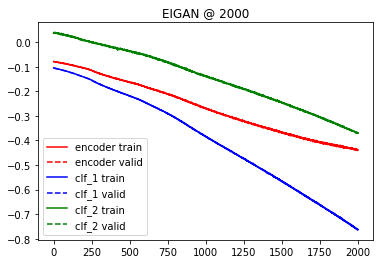

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 0.992647 	 0.992252 	 0.7049
200 	 0.710065 	 0.718746 	 0.7807
400 	 0.588799 	 0.624228 	 0.7725
600 	 0.588320 	 0.624590 	 0.7725
800 	 0.588200 	 0.624651 	 0.7725
1000 	 0.588122 	 0.624741 	 0.7725
Accuracy: 0.7725409836065574
Error Rate: 0.22745901639344263
F1 Score: 0.8069565217391306
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7663934426229508
Error Rate: 0.2336065573770492
F1 Score: 0.7978723404255318
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7848360655737705
Error Rate: 0.21

  0%|          | 2/2001 [00:00<02:14, 14.91it/s]

Accuracy: 0.7110655737704918
Error Rate: 0.2889344262295082
F1 Score: 0.07843137254901959
VAR1: 0.4, VAR2: 0.8, TRIAL: 2
X, y_1, y2
(1972, 2) (1972, 1) (1972, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1577, 2) (395, 2) (1577, 1) (395, 1) (1577, 1) (395, 1)
class weights => w1, w2 [1.36183074 3.76372315] [1.81056257 2.23371105]
tensor sizes => torch.Size([1577, 2]) torch.Size([395, 2]) torch.Size([1577, 2]) torch.Size([395, 2]) torch.Size([1577, 2]) torch.Size([395, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.77908039 	 0.76935673 	 1.08965015 	 1.07996345 	 1.00387979 	 1.00375390


 25%|██▌       | 504/2001 [00:32<01:31, 16.42it/s]

500 	 0.49483860 	 0.51846999 	 0.72182328 	 0.74046832 	 0.92013913 	 0.91514552


 50%|█████     | 1002/2001 [01:03<01:07, 14.74it/s]

1000 	 0.45939308 	 0.50356966 	 0.69064075 	 0.72556108 	 0.92438674 	 0.91513860


 75%|███████▌  | 1504/2001 [01:34<00:31, 16.03it/s]

1500 	 0.45876992 	 0.50585943 	 0.70434141 	 0.72502887 	 0.93921477 	 0.91231662


100%|██████████| 2001/2001 [02:04<00:00, 16.10it/s]


2000 	 0.49755853 	 0.49828571 	 0.73436695 	 0.71837157 	 0.92994922 	 0.91323304


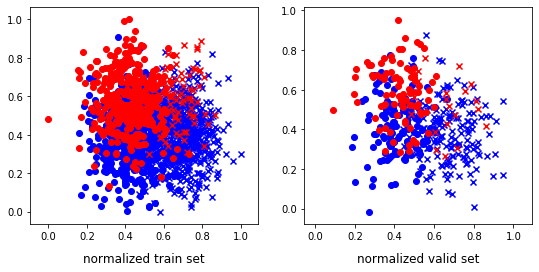

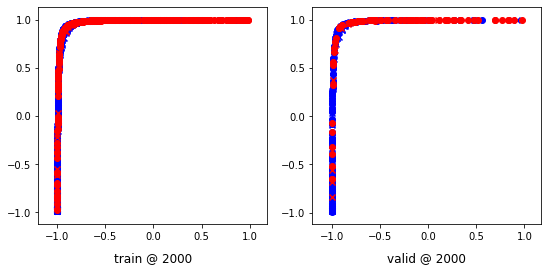

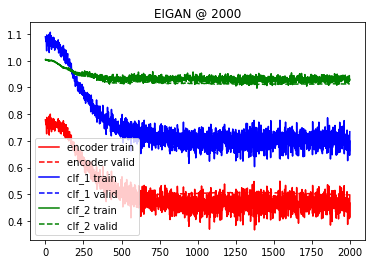

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:31, 13.18it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.06496543 	 0.06542612 	 0.03159039 	 0.03238974 	 0.01735185 	 0.01824086


 25%|██▌       | 502/2001 [00:29<01:36, 15.59it/s]

500 	 0.00335463 	 0.00133836 	 -0.04378432 	 -0.04536014 	 -0.01707683 	 -0.01609835


 50%|█████     | 1002/2001 [00:58<01:05, 15.31it/s]

1000 	 -0.07576819 	 -0.07576144 	 -0.15472275 	 -0.15490985 	 -0.08098761 	 -0.08133325


 75%|███████▌  | 1505/2001 [01:28<00:26, 18.88it/s]

1500 	 -0.13356429 	 -0.13288674 	 -0.25553536 	 -0.25619388 	 -0.14924346 	 -0.15115115


100%|██████████| 2001/2001 [01:58<00:00, 16.85it/s]


2000 	 -0.18209347 	 -0.18203229 	 -0.36948407 	 -0.36992714 	 -0.23288637 	 -0.23346840


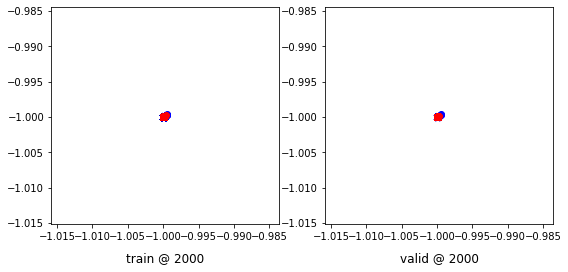

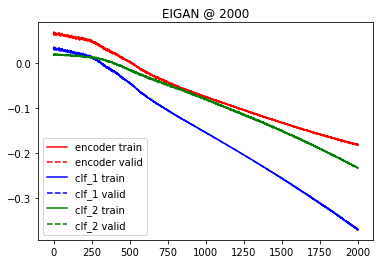

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.042721 	 1.042644 	 0.7342
200 	 0.765040 	 0.772476 	 0.7975
400 	 0.659237 	 0.704104 	 0.7848
600 	 0.658670 	 0.704226 	 0.7848
800 	 0.658529 	 0.704189 	 0.7848
1000 	 0.658391 	 0.704123 	 0.7873
Accuracy: 0.7873417721518987
Error Rate: 0.21265822784810126
F1 Score: 0.6074766355140186
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7443037974683544
Error Rate: 0.25569620253164554
F1 Score: 0.6039215686274509
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7848101265822784
Error Rate: 0.2

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.850632911392405
Error Rate: 0.14936708860759493
F1 Score: 0.834733893557423
VAR1: 0.6, VAR2: 0.2, TRIAL: 2
X, y_1, y2
(1929, 2) (1929, 1) (1929, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1543, 2) (386, 2) (1543, 1) (386, 1) (1543, 1) (386, 1)
class weights => w1, w2 [2.15804196 1.86352657] [1.73957159 2.35213415]
tensor sizes => torch.Size([1543, 2]) torch.Size([386, 2]) torch.Size([1543, 2]) torch.Size([386, 2]) torch.Size([1543, 2]) torch.Size([386, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.68339300 	 0.68060362 	 1.06548738 	 1.06564474 	 1.07650197 	 1.07818830


 25%|██▌       | 502/2001 [00:30<01:32, 16.14it/s]

500 	 0.30910793 	 0.31362361 	 0.45555261 	 0.45722604 	 0.83964688 	 0.83674961


 50%|█████     | 1003/2001 [01:02<01:00, 16.61it/s]

1000 	 0.07408004 	 0.07219395 	 0.03930180 	 0.05562427 	 0.65840715 	 0.67657751


 75%|███████▌  | 1502/2001 [01:32<00:33, 15.03it/s]

1500 	 0.02046826 	 0.04638555 	 0.01996479 	 0.02944132 	 0.69266361 	 0.67620295


100%|██████████| 2001/2001 [02:03<00:00, 16.20it/s]


2000 	 -0.00949276 	 0.04274070 	 0.01008433 	 0.02523798 	 0.71273100 	 0.67564446


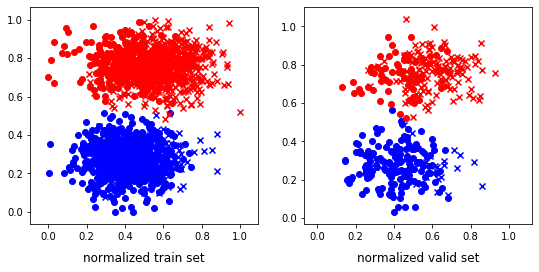

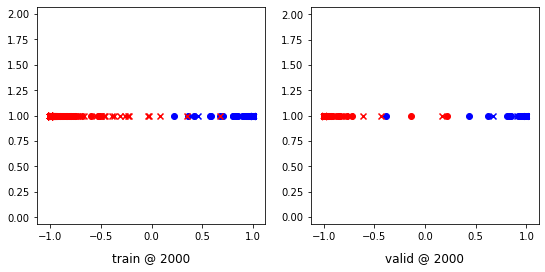

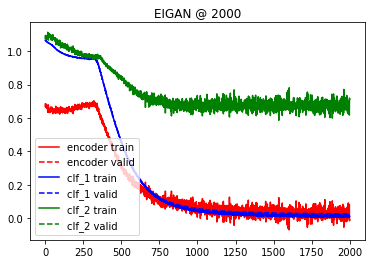

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:29, 22.44it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.02677896 	 0.02765676 	 0.01748487 	 0.01824597 	 0.10365336 	 0.10299075


 25%|██▌       | 504/2001 [00:29<01:28, 16.86it/s]

500 	 -0.06007848 	 -0.06077103 	 -0.07358585 	 -0.07396448 	 0.08397816 	 0.08513722


 50%|█████     | 1002/2001 [00:59<01:00, 16.39it/s]

1000 	 -0.13774440 	 -0.13952954 	 -0.17042376 	 -0.17212155 	 0.01931366 	 0.01946744


 75%|███████▌  | 1503/2001 [01:29<00:27, 18.25it/s]

1500 	 -0.21459043 	 -0.21095942 	 -0.27793485 	 -0.27469379 	 -0.05167437 	 -0.05245667


100%|██████████| 2001/2001 [01:58<00:00, 16.87it/s]


2000 	 -0.27095771 	 -0.26725560 	 -0.37789422 	 -0.37348202 	 -0.12700941 	 -0.12592393


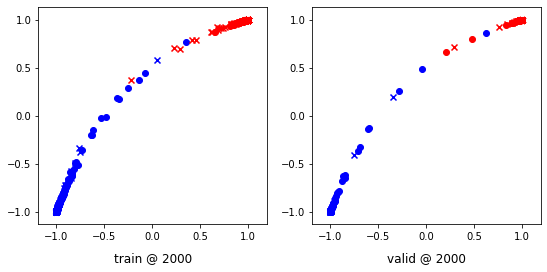

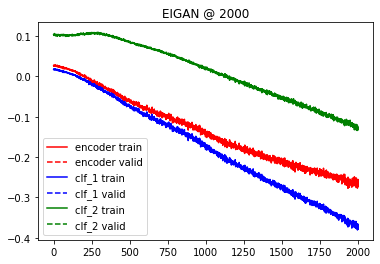

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.050690 	 1.050830 	 0.4637
200 	 0.392988 	 0.400062 	 0.9896
400 	 0.060565 	 0.069771 	 0.9974
600 	 0.025229 	 0.034373 	 0.9974
800 	 0.015958 	 0.025060 	 0.9974
1000 	 0.012076 	 0.021198 	 0.9974
Accuracy: 0.9974093264248705
Error Rate: 0.0025906735751295338
F1 Score: 0.9975903614457832
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9974093264248705
Error Rate: 0.0025906735751295338
F1 Score: 0.9975903614457832
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9948186528497409
Error Rate:

  0%|          | 0/2001 [00:00<?, ?it/s]

X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1522, 2) (381, 2) (1522, 1) (381, 1) (1522, 1) (381, 1)
class weights => w1, w2 [2.23167155 1.81190476] [2.27164179 1.78638498]
tensor sizes => torch.Size([1522, 2]) torch.Size([381, 2]) torch.Size([1522, 2]) torch.Size([381, 2]) torch.Size([1522, 2]) torch.Size([381, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.65278512 	 0.65280050 	 0.99081808 	 0.99122196 	 1.03138947 	 1.03156865


 25%|██▌       | 504/2001 [00:31<01:36, 15.51it/s]

500 	 0.24907899 	 0.24297196 	 0.49532521 	 0.50042188 	 0.93949610 	 0.95059711


 50%|█████     | 1004/2001 [01:02<00:58, 17.07it/s]

1000 	 0.15839368 	 0.11830252 	 0.41284931 	 0.37405068 	 0.94764644 	 0.94889534


 75%|███████▌  | 1502/2001 [01:32<00:31, 15.71it/s]

1500 	 0.12380764 	 0.10468882 	 0.36709538 	 0.36074197 	 0.93638831 	 0.94920033


100%|██████████| 2001/2001 [02:04<00:00, 16.13it/s]


2000 	 0.16701242 	 0.10186559 	 0.41495636 	 0.35804927 	 0.94097185 	 0.94933087


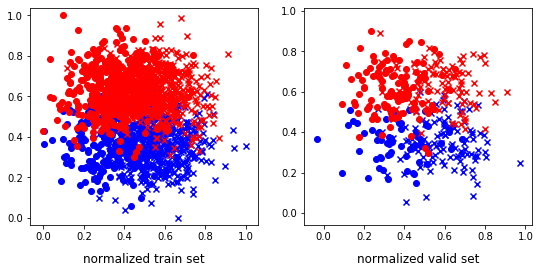

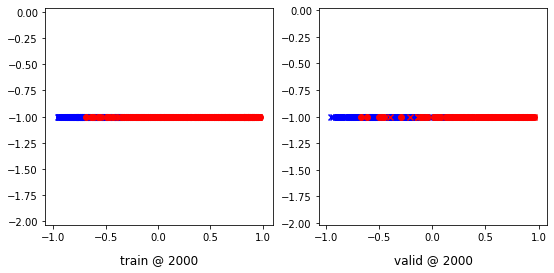

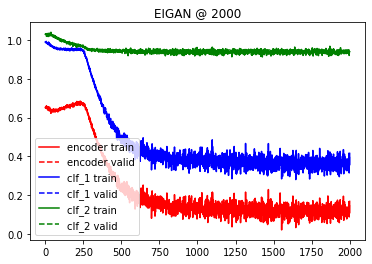

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:34, 12.91it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.12807161 	 0.13054091 	 0.07746931 	 0.08049506 	 -0.02479283 	 -0.02370930


 25%|██▌       | 503/2001 [00:30<01:38, 15.27it/s]

500 	 0.05608932 	 0.05791571 	 -0.02254382 	 -0.02089353 	 -0.08041190 	 -0.08072982


 50%|█████     | 1002/2001 [00:59<01:02, 16.10it/s]

1000 	 0.04517951 	 0.04527942 	 -0.08711243 	 -0.08714268 	 -0.16371451 	 -0.16389848


 75%|███████▌  | 1505/2001 [01:28<00:26, 18.54it/s]

1500 	 0.03940043 	 0.04436297 	 -0.09986041 	 -0.09575162 	 -0.17317067 	 -0.17431885


100%|██████████| 2001/2001 [01:57<00:00, 17.01it/s]


2000 	 0.04497717 	 0.04953348 	 -0.12437449 	 -0.12026914 	 -0.21152128 	 -0.21207114


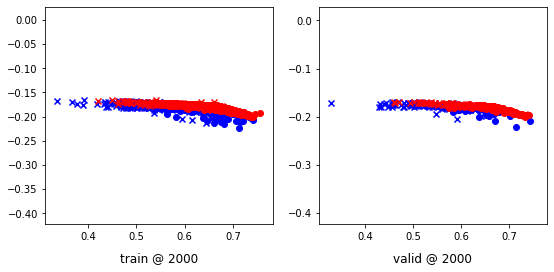

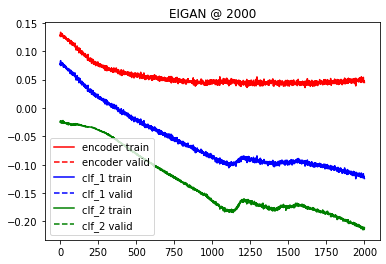

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.031270 	 1.031507 	 0.4488
200 	 0.750268 	 0.747712 	 0.8451
400 	 0.383488 	 0.377300 	 0.8845
600 	 0.360624 	 0.353084 	 0.8871
800 	 0.360063 	 0.352390 	 0.8871
1000 	 0.359969 	 0.352350 	 0.8871
Accuracy: 0.8871391076115486
Error Rate: 0.11286089238845144
F1 Score: 0.8978622327790975
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.889763779527559
Error Rate: 0.11023622047244094
F1 Score: 0.9
SVM
--------------------------------------------------------------------------------
Accuracy: 0.889763779527559
Error Rate: 0.11023622047244094


  0%|          | 5/2001 [00:00<00:46, 42.87it/s]

X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(980, 2) (245, 2) (980, 1) (245, 1) (980, 1) (245, 1)
class weights => w1, w2 [1.22194514 5.50561798] [2.44389027 1.6925734 ]
tensor sizes => torch.Size([980, 2]) torch.Size([245, 2]) torch.Size([980, 2]) torch.Size([245, 2]) torch.Size([980, 2]) torch.Size([245, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.68947637 	 0.68680704 	 1.01813293 	 1.01500773 	 1.02188742 	 1.02134788


 25%|██▌       | 505/2001 [00:18<00:57, 26.18it/s]

500 	 0.49648106 	 0.47853225 	 0.75715810 	 0.73423672 	 0.95383614 	 0.94885164


 50%|█████     | 1006/2001 [00:36<00:26, 37.37it/s]

1000 	 0.37718362 	 0.34604597 	 0.62637353 	 0.58365178 	 0.94234574 	 0.93075299


 75%|███████▌  | 1506/2001 [00:55<00:18, 26.12it/s]

1500 	 0.33693224 	 0.28748322 	 0.58303887 	 0.52202600 	 0.93922514 	 0.92768997


100%|██████████| 2001/2001 [01:12<00:00, 27.46it/s]


2000 	 0.32774603 	 0.25785550 	 0.56989521 	 0.49186519 	 0.93523532 	 0.92715687


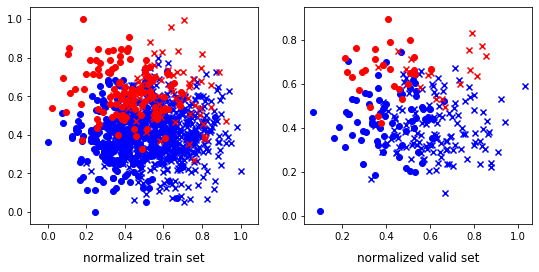

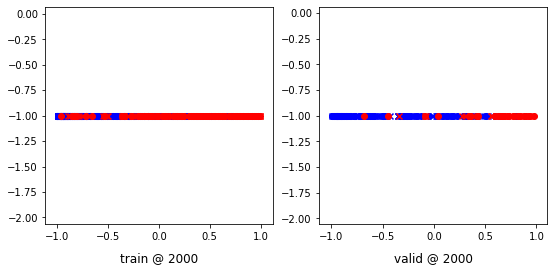

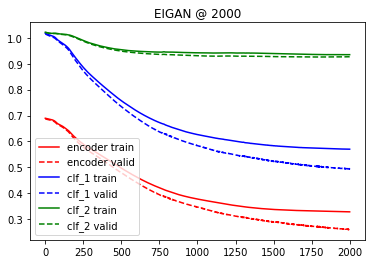

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 5/2001 [00:00<00:43, 46.04it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.10591836 	 0.10595897 	 0.02432947 	 0.02435304 	 -0.08560190 	 -0.08566751


 25%|██▌       | 505/2001 [00:17<00:53, 28.10it/s]

500 	 0.08914322 	 0.08909477 	 -0.01520808 	 -0.01528546 	 -0.12302798 	 -0.12307929


 50%|█████     | 1006/2001 [00:35<00:35, 28.10it/s]

1000 	 0.08023490 	 0.08015114 	 -0.04066737 	 -0.04072919 	 -0.14770669 	 -0.14767849


 75%|███████▌  | 1503/2001 [00:52<00:15, 32.57it/s]

1500 	 0.07583091 	 0.07577391 	 -0.06381836 	 -0.06382288 	 -0.17369612 	 -0.17362654


100%|██████████| 2001/2001 [01:10<00:00, 28.38it/s]


2000 	 0.07541590 	 0.07530893 	 -0.08815170 	 -0.08815537 	 -0.20443453 	 -0.20430718


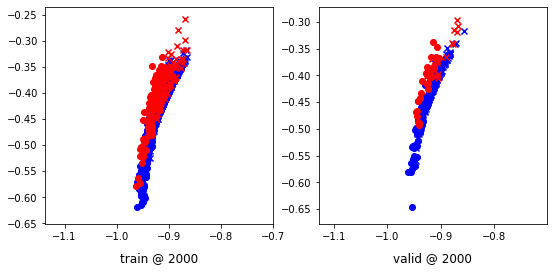

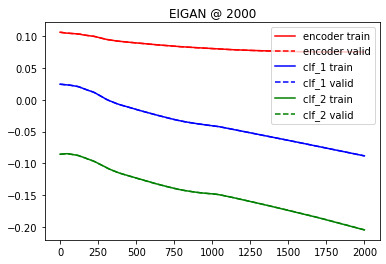

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.045060 	 1.041278 	 0.8204
200 	 0.749176 	 0.723143 	 0.8286
400 	 0.570600 	 0.473907 	 0.8653
600 	 0.564059 	 0.459788 	 0.8694
800 	 0.563762 	 0.459426 	 0.8694
1000 	 0.563584 	 0.459697 	 0.8694
Accuracy: 0.8693877551020408
Error Rate: 0.1306122448979592
F1 Score: 0.6981132075471698
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8081632653061225
Error Rate: 0.19183673469387755
F1 Score: 0.6356589147286822
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8816326530612245
Error Rate: 0.11

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.779412 	 0.794498 	 0.7020
Accuracy: 0.7020408163265306
Error Rate: 0.2979591836734694
F1 Score: 0.759075907590759
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.6857142857142857
Error Rate: 0.3142857142857143
F1 Score: 0.7389830508474577
SVM
--------------------------------------------------------------------------------
Accuracy: 0.746938775510204
Error Rate: 0.2530612244897959
F1 Score: 0.7987012987012988
VAR1: 0.6, VAR2: 0.8, TRIAL: 2
X, y_1, y2
(2333, 2) (2333, 1) (2333, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1866, 2) (467, 2) (1866, 1) (467, 1) (1866, 1) (467, 1)
class weights => w1, w2 [1.30307263 4.29953917] [1.81341108 2.22939068]
tensor sizes => torch.Size([1866, 2]) torch.Size([467, 2]) torch.Size([1866, 2]) torch.Size([467, 2]) torch.Size([1866, 2]) torch.Size([467, 2])
--------------------------------------------------------------------------------
EIGAN Training
----------

 25%|██▌       | 503/2001 [00:34<01:38, 15.21it/s]

500 	 0.47154564 	 0.46646559 	 0.73227984 	 0.72256291 	 0.95382917 	 0.94924450


 50%|█████     | 1003/2001 [01:08<01:05, 15.15it/s]

1000 	 0.45845193 	 0.45673960 	 0.71922272 	 0.71182281 	 0.95409006 	 0.94823039


 75%|███████▌  | 1502/2001 [01:42<00:37, 13.47it/s]

1500 	 0.44341385 	 0.45370495 	 0.69942480 	 0.71004355 	 0.94908857 	 0.94948578


100%|██████████| 2001/2001 [02:17<00:00, 14.52it/s]


2000 	 0.47857583 	 0.45438576 	 0.73189533 	 0.71087569 	 0.94665140 	 0.94963712


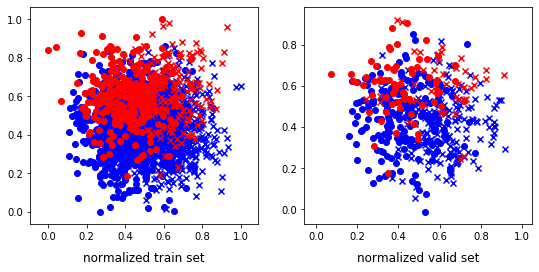

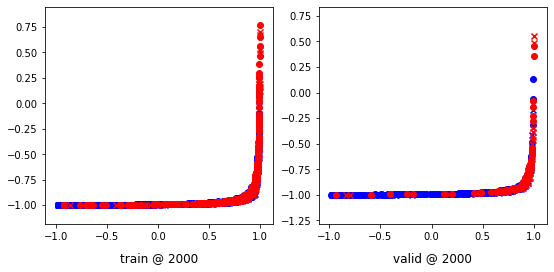

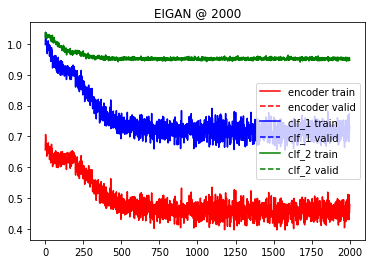

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<01:41, 19.72it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.11340192 	 0.11023095 	 0.05329475 	 0.05077697 	 -0.04511358 	 -0.04383187


 25%|██▌       | 503/2001 [00:33<01:44, 14.34it/s]

500 	 0.07314897 	 0.07340356 	 0.00086603 	 0.00088981 	 -0.06865993 	 -0.06928378


 50%|█████     | 1003/2001 [01:05<00:59, 16.71it/s]

1000 	 0.00649738 	 0.00836951 	 -0.11961317 	 -0.11871286 	 -0.15511931 	 -0.15648614


 75%|███████▌  | 1503/2001 [01:39<00:30, 16.57it/s]

1500 	 -0.03069241 	 -0.03130896 	 -0.21540913 	 -0.21641004 	 -0.22978672 	 -0.23023374


100%|██████████| 2001/2001 [02:12<00:00, 15.12it/s]


2000 	 -0.05878347 	 -0.06013954 	 -0.32511145 	 -0.32491961 	 -0.31606966 	 -0.31456786


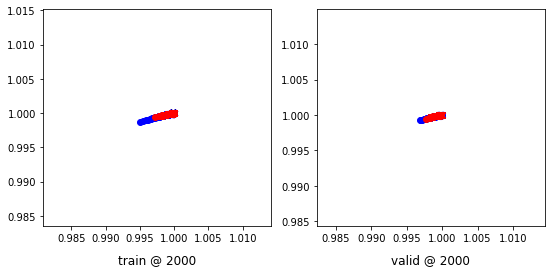

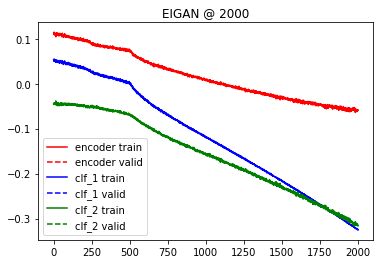

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.003805 	 1.004617 	 0.5375
200 	 0.767194 	 0.767102 	 0.7859
400 	 0.716421 	 0.712848 	 0.7794
600 	 0.714425 	 0.710841 	 0.7794
800 	 0.714035 	 0.710546 	 0.7794
1000 	 0.713749 	 0.710556 	 0.7816
Accuracy: 0.7815845824411135
Error Rate: 0.21841541755888652
F1 Score: 0.5277777777777777
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7387580299785867
Error Rate: 0.26124197002141325
F1 Score: 0.5793103448275863
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7837259100642399
Error Rate: 0.2

  0%|          | 2/2001 [00:00<01:48, 18.41it/s]

Accuracy: 0.7408993576017131
Error Rate: 0.25910064239828695
F1 Score: 0.7139479905437353
VAR1: 0.8, VAR2: 0.2, TRIAL: 2
X, y_1, y2
(1270, 2) (1270, 1) (1270, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1016, 2) (254, 2) (1016, 1) (254, 1) (1016, 1) (254, 1)
class weights => w1, w2 [2.87818697 1.53242836] [2.05668016 1.94636015]
tensor sizes => torch.Size([1016, 2]) torch.Size([254, 2]) torch.Size([1016, 2]) torch.Size([254, 2]) torch.Size([1016, 2]) torch.Size([254, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.62767899 	 0.62686515 	 1.02141011 	 1.02093625 	 1.08703852 	 1.08721828


 25%|██▌       | 505/2001 [00:18<01:03, 23.72it/s]

500 	 0.41872281 	 0.41845930 	 0.64145279 	 0.64014077 	 0.91591322 	 0.91482866


 50%|█████     | 1005/2001 [00:37<00:36, 26.97it/s]

1000 	 0.15680225 	 0.17340416 	 0.22082795 	 0.23380846 	 0.75717956 	 0.75355148


 75%|███████▌  | 1504/2001 [00:55<00:19, 24.99it/s]

1500 	 0.07457575 	 0.09884454 	 0.07835019 	 0.09903117 	 0.69692165 	 0.69333380


100%|██████████| 2001/2001 [01:14<00:00, 26.99it/s]


2000 	 0.03948430 	 0.06412224 	 0.03939311 	 0.06194947 	 0.69305384 	 0.69097441


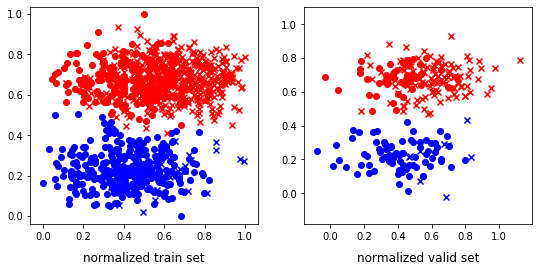

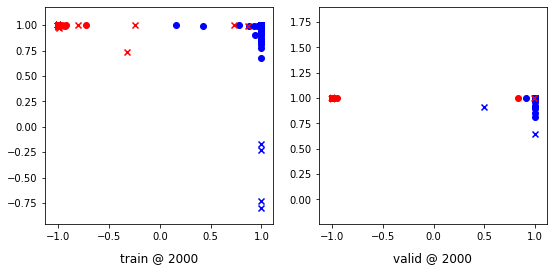

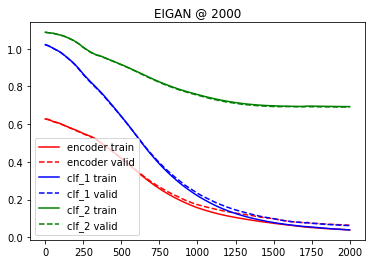

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 4/2001 [00:00<01:06, 30.07it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.03288454 	 0.03279755 	 0.01691232 	 0.01683098 	 0.07367076 	 0.07364109


 25%|██▌       | 504/2001 [00:17<00:57, 26.00it/s]

500 	 -0.00004824 	 -0.00004263 	 -0.02632555 	 -0.02619838 	 0.03811516 	 0.03827262


 50%|█████     | 1004/2001 [00:34<00:35, 28.11it/s]

1000 	 -0.06255330 	 -0.06262361 	 -0.11009811 	 -0.11007503 	 -0.01798521 	 -0.01783347


 75%|███████▌  | 1503/2001 [00:51<00:15, 31.35it/s]

1500 	 -0.09632004 	 -0.09653471 	 -0.16771674 	 -0.16788363 	 -0.06719309 	 -0.06711221


100%|██████████| 2001/2001 [01:08<00:00, 29.40it/s]


2000 	 -0.12275232 	 -0.12304415 	 -0.22028044 	 -0.22052513 	 -0.11229274 	 -0.11221943


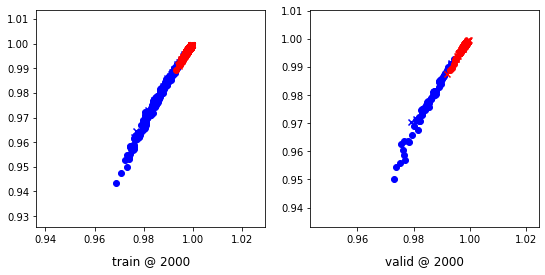

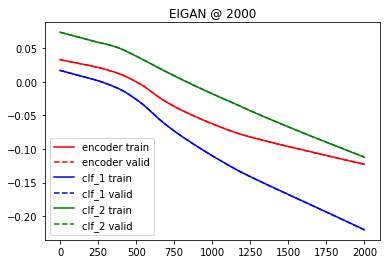

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.039205 	 1.038527 	 0.8150
200 	 0.330950 	 0.316417 	 0.9843
400 	 0.066777 	 0.059189 	 0.9961
600 	 0.036996 	 0.037359 	 0.9921
800 	 0.027361 	 0.032308 	 0.9921
1000 	 0.022744 	 0.030675 	 0.9882
Accuracy: 0.9881889763779528
Error Rate: 0.011811023622047244
F1 Score: 0.9909365558912386
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9881889763779528
Error Rate: 0.011811023622047244
F1 Score: 0.9909365558912386
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9881889763779528
Error Rate: 0

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.948676 	 0.948593 	 0.5591
Accuracy: 0.5590551181102362
Error Rate: 0.4409448818897638
F1 Score: 0.6989247311827956
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7834645669291339
Error Rate: 0.21653543307086615
F1 Score: 0.8148148148148148
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7913385826771654
Error Rate: 0.20866141732283464
F1 Score: 0.8058608058608059
VAR1: 0.8, VAR2: 0.4, TRIAL: 2
X, y_1, y2
(2933, 2) (2933, 1) (2933, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2346, 2) (587, 2) (2346, 1) (587, 1) (2346, 1) (587, 1)
class weights => w1, w2 [1.72373255 2.38172589] [1.98141892 2.01893287]
tensor sizes => torch.Size([2346, 2]) torch.Size([587, 2]) torch.Size([2346, 2]) torch.Size([587, 2]) torch.Size([2346, 2]) torch.Size([587, 2])
--------------------------------------------------------------------------------
EIGAN Training
------

  0%|          | 3/2001 [00:00<02:51, 11.65it/s]

0 	 0.70451188 	 0.70143235 	 1.03815341 	 1.03527367 	 1.02726185 	 1.02698851


 25%|██▌       | 502/2001 [00:47<02:16, 10.98it/s]

500 	 0.09076726 	 0.08186644 	 0.34679714 	 0.33352745 	 0.95013326 	 0.94480819


 50%|█████     | 1003/2001 [01:34<01:31, 10.92it/s]

1000 	 0.07003263 	 0.05942848 	 0.32198772 	 0.31081828 	 0.94552737 	 0.94453698


 75%|███████▌  | 1502/2001 [02:22<00:50,  9.88it/s]

1500 	 0.05675226 	 0.05567476 	 0.30399680 	 0.30676702 	 0.94073915 	 0.94423944


100%|██████████| 2001/2001 [03:09<00:00, 10.54it/s]


2000 	 0.17553586 	 0.05418482 	 0.43637097 	 0.30563954 	 0.95520842 	 0.94460189


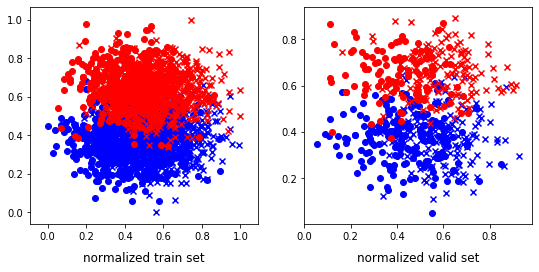

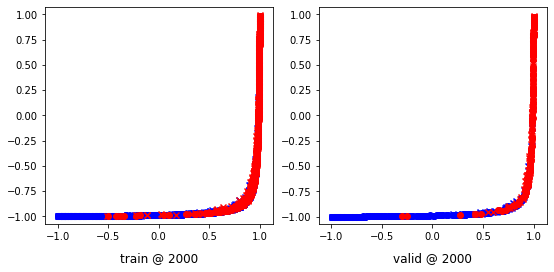

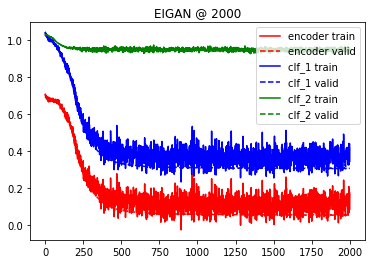

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 1/2001 [00:00<03:58,  8.38it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.00469946 	 0.00009135 	 -0.05087227 	 -0.05278743 	 -0.03562255 	 -0.02995386


 25%|██▌       | 503/2001 [00:46<02:05, 11.98it/s]

500 	 -0.11728873 	 -0.11320860 	 -0.20930855 	 -0.20999478 	 -0.10333887 	 -0.11110478


 50%|█████     | 1002/2001 [01:31<01:30, 11.07it/s]

1000 	 -0.16333751 	 -0.16280428 	 -0.34839225 	 -0.35211980 	 -0.23017658 	 -0.23510404


 75%|███████▌  | 1502/2001 [02:17<00:47, 10.58it/s]

1500 	 -0.17787430 	 -0.18775928 	 -0.49281976 	 -0.49848586 	 -0.36119944 	 -0.35742852


100%|██████████| 2001/2001 [03:03<00:00, 10.89it/s]


2000 	 -0.19608545 	 -0.16089046 	 -0.67284125 	 -0.66626567 	 -0.49046698 	 -0.51089746


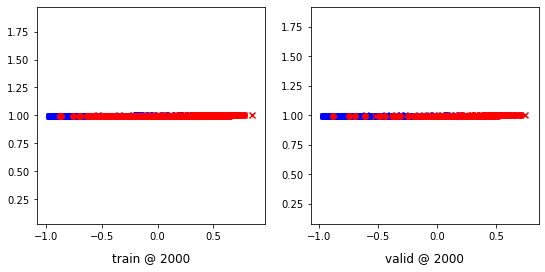

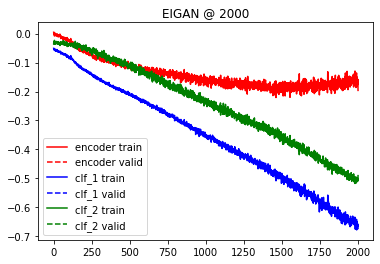

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.073279 	 1.073382 	 0.4191
200 	 0.680626 	 0.665705 	 0.9063
400 	 0.368781 	 0.318835 	 0.9046
600 	 0.360835 	 0.303829 	 0.9046
800 	 0.360522 	 0.302826 	 0.9046
1000 	 0.360438 	 0.302684 	 0.9046
Accuracy: 0.9045996592844975
Error Rate: 0.09540034071550256
F1 Score: 0.8888888888888888
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9028960817717206
Error Rate: 0.09710391822827939
F1 Score: 0.8875739644970414
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9114139693356048
Error Rate: 0.0

  0%|          | 1/2001 [00:00<03:28,  9.61it/s]

Accuracy: 0.5979557069846678
Error Rate: 0.4020442930153322
F1 Score: 0.5972696245733788
VAR1: 0.8, VAR2: 0.6, TRIAL: 2
X, y_1, y2
(2299, 2) (2299, 1) (2299, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1839, 2) (460, 2) (1839, 1) (460, 1) (1839, 1) (460, 1)
class weights => w1, w2 [1.57179487 2.74887892] [2.16863208 1.85570131]
tensor sizes => torch.Size([1839, 2]) torch.Size([460, 2]) torch.Size([1839, 2]) torch.Size([460, 2]) torch.Size([1839, 2]) torch.Size([460, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.63652766 	 0.63891113 	 0.98766267 	 0.99078155 	 1.04478836 	 1.04501760


 25%|██▌       | 502/2001 [00:34<01:49, 13.67it/s]

500 	 0.43230283 	 0.40518677 	 0.68971401 	 0.66629022 	 0.95088309 	 0.95425063


 50%|█████     | 1002/2001 [01:07<01:03, 15.76it/s]

1000 	 0.35974228 	 0.36518592 	 0.61763763 	 0.62594020 	 0.95117605 	 0.95390147


 75%|███████▌  | 1503/2001 [01:40<00:31, 15.74it/s]

1500 	 0.32712227 	 0.36172986 	 0.58918124 	 0.62180537 	 0.95535839 	 0.95322269


100%|██████████| 2001/2001 [02:13<00:00, 14.95it/s]


2000 	 0.35347110 	 0.36092770 	 0.61590511 	 0.62082386 	 0.95574164 	 0.95304334


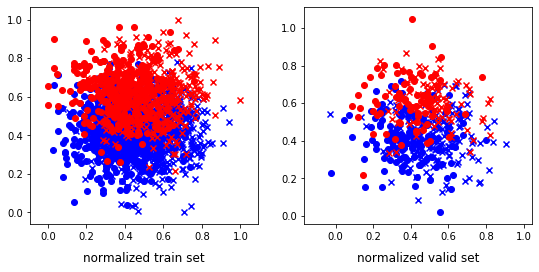

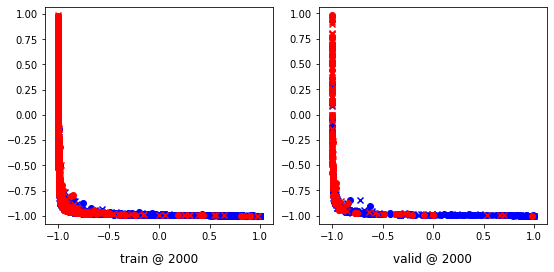

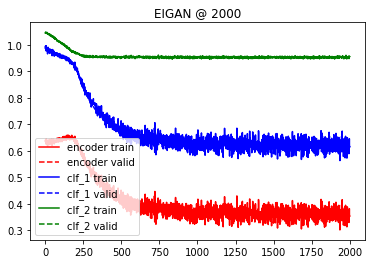

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:33, 21.35it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.08827581 	 0.08844933 	 0.07082615 	 0.07083955 	 0.06794678 	 0.06729815


 25%|██▌       | 502/2001 [00:31<01:35, 15.62it/s]

500 	 0.05976548 	 0.05993800 	 0.03708944 	 0.03691127 	 0.04941573 	 0.04825439


 50%|█████     | 1003/2001 [01:04<01:02, 16.09it/s]

1000 	 0.03386426 	 0.03382262 	 0.00147816 	 0.00147963 	 0.02003986 	 0.02015843


 75%|███████▌  | 1503/2001 [01:37<00:39, 12.59it/s]

1500 	 0.01023335 	 0.00999727 	 -0.03586762 	 -0.03577883 	 -0.01471118 	 -0.01395349


100%|██████████| 2001/2001 [02:10<00:00, 15.38it/s]


2000 	 -0.01230816 	 -0.01261809 	 -0.07708853 	 -0.07731039 	 -0.05451882 	 -0.05434680


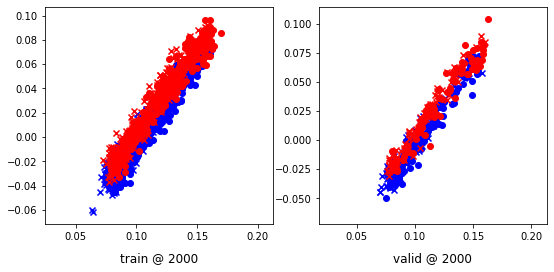

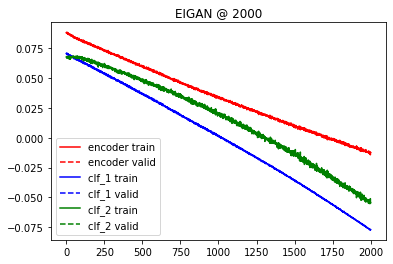

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 0.998656 	 0.998140 	 0.6370
200 	 0.744488 	 0.740846 	 0.7783
400 	 0.626377 	 0.614104 	 0.8022
600 	 0.624291 	 0.614488 	 0.8022
800 	 0.623754 	 0.615689 	 0.8000
1000 	 0.623614 	 0.616662 	 0.7957
Accuracy: 0.7956521739130434
Error Rate: 0.20434782608695654
F1 Score: 0.7251461988304092
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7869565217391304
Error Rate: 0.21304347826086956
F1 Score: 0.7307692307692308
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8
Error Rate: 0.2
F1 Score: 0.72

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.7086956521739131
Error Rate: 0.29130434782608694
F1 Score: 0.7372549019607844
VAR1: 0.8, VAR2: 0.8, TRIAL: 2
X, y_1, y2
(1368, 2) (1368, 1) (1368, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1094, 2) (274, 2) (1094, 1) (274, 1) (1094, 1) (274, 1)
class weights => w1, w2 [1.74481659 2.34261242] [2.4043956  1.71205008]
tensor sizes => torch.Size([1094, 2]) torch.Size([274, 2]) torch.Size([1094, 2]) torch.Size([274, 2]) torch.Size([1094, 2]) torch.Size([274, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.70982099 	 0.69764841 	 1.03568757 	 1.03523397 	 1.01939833 	 1.03073275


 25%|██▌       | 504/2001 [00:27<01:26, 17.35it/s]

500 	 0.52617711 	 0.52693605 	 0.67801243 	 0.73265171 	 0.84517574 	 0.89886284


 50%|█████     | 1003/2001 [00:54<00:58, 17.02it/s]

1000 	 0.55841178 	 0.47436994 	 0.73378170 	 0.67186511 	 0.86833769 	 0.89064234


 75%|███████▌  | 1504/2001 [01:22<00:28, 17.39it/s]

1500 	 0.40957659 	 0.46415186 	 0.58981740 	 0.67027205 	 0.87451273 	 0.89926738


100%|██████████| 2001/2001 [01:50<00:00, 18.16it/s]


2000 	 0.67488360 	 0.45481128 	 0.86270821 	 0.66933858 	 0.88064241 	 0.90767449


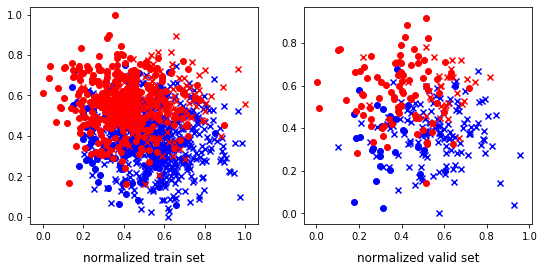

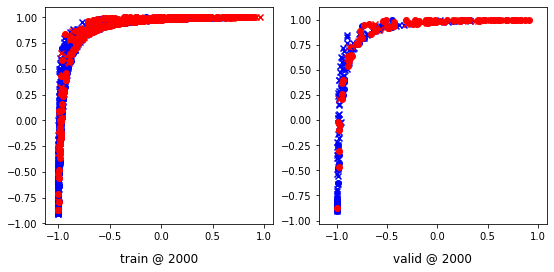

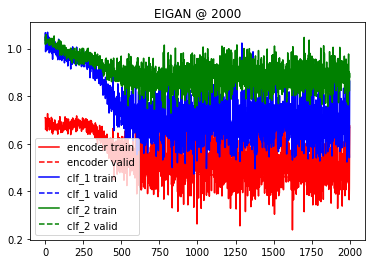

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:26, 23.03it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.19171554 	 0.18658905 	 0.09180515 	 0.09054574 	 -0.11608329 	 -0.10990854


 25%|██▌       | 504/2001 [00:26<01:16, 19.55it/s]

500 	 0.16780256 	 0.17353740 	 0.06133101 	 0.06566671 	 -0.12629329 	 -0.12843673


 50%|█████     | 1003/2001 [00:52<00:51, 19.38it/s]

1000 	 0.17514548 	 0.16546254 	 0.01947432 	 0.01359107 	 -0.19455108 	 -0.18970689


 75%|███████▌  | 1504/2001 [01:19<00:26, 19.04it/s]

1500 	 0.16198593 	 0.17300585 	 -0.04184771 	 -0.04171687 	 -0.25148070 	 -0.26338181


100%|██████████| 2001/2001 [01:46<00:00, 18.83it/s]


2000 	 0.20488518 	 0.20048554 	 -0.10628664 	 -0.10490818 	 -0.35782769 	 -0.35262442


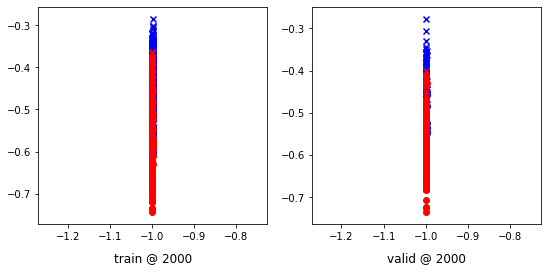

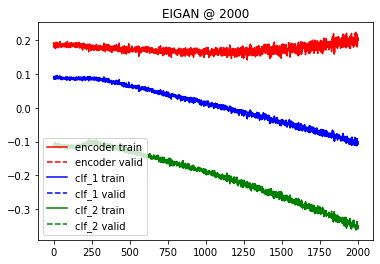

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.043040 	 1.043197 	 0.5730
200 	 0.707426 	 0.689608 	 0.7591
400 	 0.656196 	 0.614668 	 0.7774
600 	 0.655283 	 0.615432 	 0.7774
800 	 0.655087 	 0.615497 	 0.7774
1000 	 0.654876 	 0.615663 	 0.7774
Accuracy: 0.7773722627737226
Error Rate: 0.22262773722627738
F1 Score: 0.7404255319148937
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7773722627737226
Error Rate: 0.22262773722627738
F1 Score: 0.7489711934156379
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7773722627737226
Error Rate: 0.2

  0%|          | 2/2001 [00:00<01:47, 18.55it/s]

tensor sizes => torch.Size([1953, 2]) torch.Size([489, 2]) torch.Size([1953, 2]) torch.Size([489, 2]) torch.Size([1953, 2]) torch.Size([489, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.73348629 	 0.73592579 	 1.06471694 	 1.06660175 	 1.02472353 	 1.02382314


 25%|██▌       | 504/2001 [00:35<01:49, 13.73it/s]

500 	 0.00905734 	 0.02173766 	 0.26920500 	 0.27562472 	 0.95332038 	 0.94703424


 50%|█████     | 1003/2001 [01:10<01:20, 12.38it/s]

1000 	 -0.20982210 	 -0.18820900 	 0.04501978 	 0.06570400 	 0.94798040 	 0.94706017


 75%|███████▌  | 1503/2001 [01:45<00:32, 15.29it/s]

1500 	 -0.23385160 	 -0.20411766 	 0.02135705 	 0.04983938 	 0.94821113 	 0.94710422


100%|██████████| 2001/2001 [02:19<00:00, 14.30it/s]


2000 	 -0.23316246 	 -0.20351915 	 0.01458809 	 0.05045016 	 0.94116837 	 0.94711649


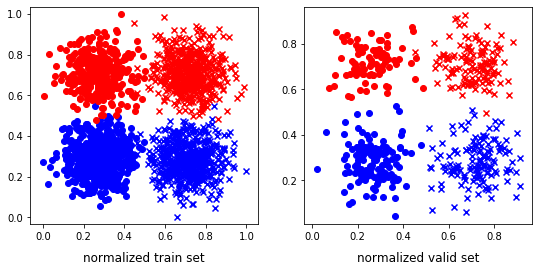

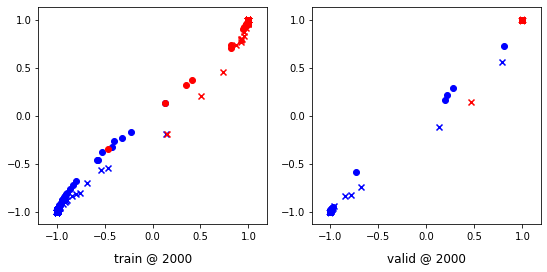

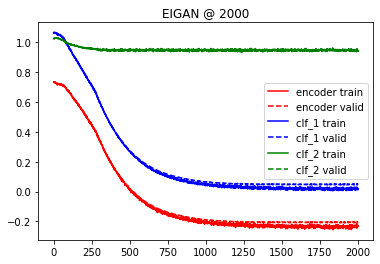

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:08, 15.58it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.02085042 	 -0.02076970 	 -0.03060955 	 -0.03098829 	 0.10150103 	 0.09891299


 25%|██▌       | 502/2001 [00:33<01:52, 13.29it/s]

500 	 -0.14112934 	 -0.13736960 	 -0.16073573 	 -0.15724534 	 0.06011254 	 0.05901870


 50%|█████     | 1003/2001 [01:07<01:09, 14.36it/s]

1000 	 -0.27229163 	 -0.27874976 	 -0.30285329 	 -0.30918032 	 0.02519257 	 0.02555640


 75%|███████▌  | 1503/2001 [01:40<00:38, 12.95it/s]

1500 	 -0.42060262 	 -0.41734627 	 -0.46495241 	 -0.46140704 	 -0.01059249 	 -0.00990658


100%|██████████| 2001/2001 [02:16<00:00, 14.69it/s]


2000 	 -0.57277274 	 -0.57415062 	 -0.63598233 	 -0.63678402 	 -0.05141469 	 -0.05026667


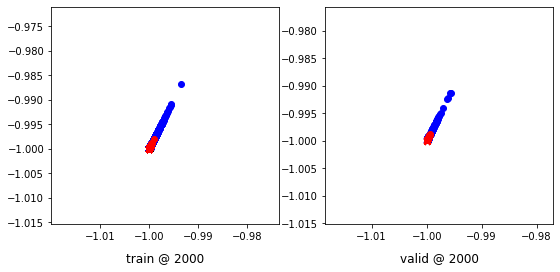

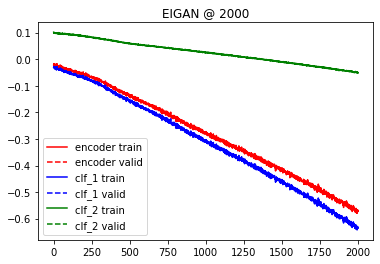

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 0.990887 	 0.990405 	 0.4438
200 	 0.260865 	 0.251322 	 0.9877
400 	 0.053960 	 0.048962 	 0.9939
600 	 0.030370 	 0.028356 	 0.9939
800 	 0.021150 	 0.021355 	 0.9939
1000 	 0.015950 	 0.018472 	 0.9939
Accuracy: 0.9938650306748467
Error Rate: 0.006134969325153374
F1 Score: 0.9931350114416476
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9938650306748467
Error Rate: 0.006134969325153374
F1 Score: 0.9931350114416476
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9918200408997955
Error Rate: 0

  0%|          | 2/2001 [00:00<01:54, 17.47it/s]

Accuracy: 0.83640081799591
Error Rate: 0.16359918200409
F1 Score: 0.8596491228070176
VAR1: 0.2, VAR2: 0.4, TRIAL: 3
X, y_1, y2
(2765, 2) (2765, 1) (2765, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2212, 2) (553, 2) (2212, 1) (553, 1) (2212, 1) (553, 1)
class weights => w1, w2 [2.22983871 1.81311475] [1.93356643 2.07116105]
tensor sizes => torch.Size([2212, 2]) torch.Size([553, 2]) torch.Size([2212, 2]) torch.Size([553, 2]) torch.Size([2212, 2]) torch.Size([553, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.68119574 	 0.68634415 	 1.00063074 	 1.00676000 	 1.01320553 	 1.01356304


 25%|██▌       | 502/2001 [00:46<02:33,  9.78it/s]

500 	 0.20840126 	 0.15651685 	 0.45719355 	 0.38951373 	 0.94318891 	 0.92614406


 50%|█████     | 1002/2001 [01:33<01:30, 11.02it/s]

1000 	 0.10553530 	 0.10788172 	 0.34507564 	 0.33903348 	 0.93348199 	 0.92429894


 75%|███████▌  | 1502/2001 [02:20<00:49, 10.01it/s]

1500 	 0.04180616 	 0.10189059 	 0.25743327 	 0.33409223 	 0.90862417 	 0.92534882


100%|██████████| 2001/2001 [03:07<00:00, 10.70it/s]


2000 	 0.25742438 	 0.10573399 	 0.47467059 	 0.33603442 	 0.91244429 	 0.92344761


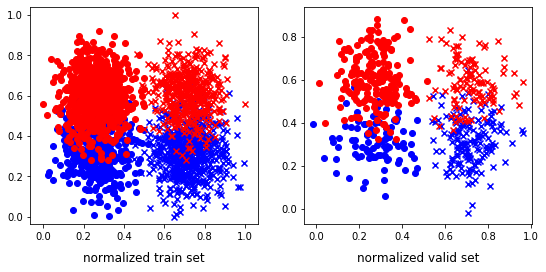

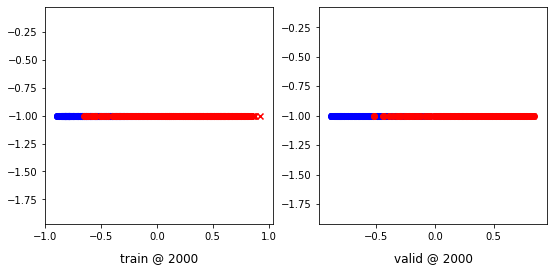

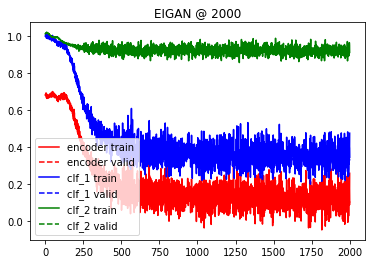

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:20, 14.22it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.03574617 	 0.03603142 	 -0.02754527 	 -0.02739649 	 -0.05149341 	 -0.05184899


 25%|██▌       | 503/2001 [00:45<02:10, 11.45it/s]

500 	 -0.01063648 	 -0.01531095 	 -0.10106684 	 -0.10583828 	 -0.10071274 	 -0.10087760


 50%|█████     | 1002/2001 [01:30<01:22, 12.10it/s]

1000 	 -0.05787823 	 -0.04688561 	 -0.18900026 	 -0.17972465 	 -0.16210537 	 -0.16447091


 75%|███████▌  | 1503/2001 [02:15<00:44, 11.30it/s]

1500 	 -0.09382762 	 -0.07956766 	 -0.27418801 	 -0.26064959 	 -0.22468725 	 -0.22553724


100%|██████████| 2001/2001 [03:00<00:00, 11.08it/s]


2000 	 -0.09193018 	 -0.10298213 	 -0.35393593 	 -0.36242345 	 -0.31186402 	 -0.30935383


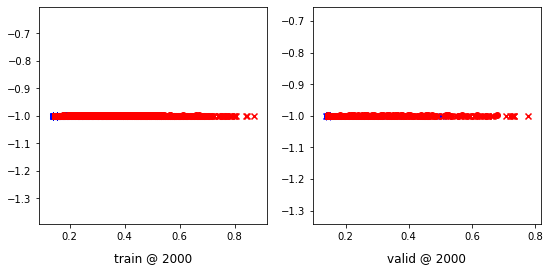

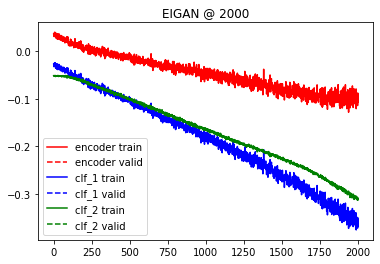

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.005926 	 1.006080 	 0.4485
200 	 0.580199 	 0.584962 	 0.8499
400 	 0.343154 	 0.328994 	 0.9078
600 	 0.337119 	 0.316949 	 0.9078
800 	 0.336930 	 0.316456 	 0.9078
1000 	 0.336862 	 0.316363 	 0.9078
Accuracy: 0.9077757685352622
Error Rate: 0.0922242314647378
F1 Score: 0.9137055837563451
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8987341772151899
Error Rate: 0.10126582278481013
F1 Score: 0.9044368600682593
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9077757685352622
Error Rate: 0.09

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.6455696202531646
Error Rate: 0.35443037974683544
F1 Score: 0.6776315789473685
VAR1: 0.2, VAR2: 0.6, TRIAL: 3
X, y_1, y2
(2282, 2) (2282, 1) (2282, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1825, 2) (457, 2) (1825, 1) (457, 1) (1825, 1) (457, 1)
class weights => w1, w2 [1.8546748  2.17003567] [1.7804878 2.28125  ]
tensor sizes => torch.Size([1825, 2]) torch.Size([457, 2]) torch.Size([1825, 2]) torch.Size([457, 2]) torch.Size([1825, 2]) torch.Size([457, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.70447338 	 0.69467676 	 1.01451766 	 1.01361895 	 1.00347435 	 1.01208937


 25%|██▌       | 504/2001 [00:33<01:43, 14.50it/s]

500 	 0.40315133 	 0.38222855 	 0.63161016 	 0.61972082 	 0.92158192 	 0.93063945


 50%|█████     | 1003/2001 [01:07<01:13, 13.62it/s]

1000 	 0.38221943 	 0.34135920 	 0.60725808 	 0.58077598 	 0.91839904 	 0.93256396


 75%|███████▌  | 1503/2001 [01:40<00:32, 15.14it/s]

1500 	 0.40238196 	 0.33484977 	 0.64337516 	 0.57050449 	 0.93422955 	 0.92880189


100%|██████████| 2001/2001 [02:14<00:00, 14.87it/s]


2000 	 0.38081717 	 0.33256662 	 0.61408216 	 0.56715780 	 0.92646617 	 0.92773837


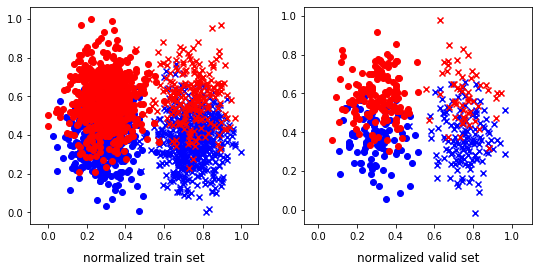

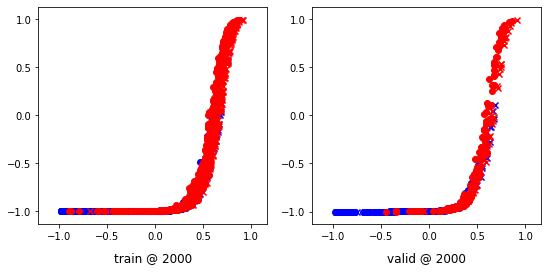

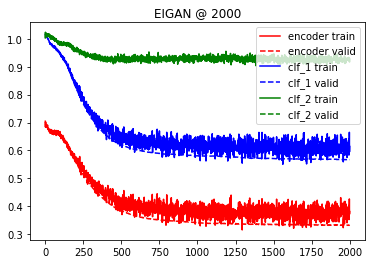

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 1/2001 [00:00<04:01,  8.28it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.11024244 	 0.11004078 	 0.09667260 	 0.09664773 	 0.08357575 	 0.08427164


 25%|██▌       | 502/2001 [00:32<01:54, 13.14it/s]

500 	 0.08488763 	 0.08467385 	 0.05648511 	 0.05626587 	 0.03150384 	 0.03145334


 50%|█████     | 1002/2001 [01:05<01:05, 15.29it/s]

1000 	 0.05123647 	 0.04819057 	 -0.00086454 	 -0.00376230 	 -0.02823546 	 -0.02793172


 75%|███████▌  | 1503/2001 [01:37<00:29, 17.07it/s]

1500 	 0.03278211 	 0.02663998 	 -0.05472560 	 -0.06212660 	 -0.09580518 	 -0.09793723


100%|██████████| 2001/2001 [02:09<00:00, 15.43it/s]


2000 	 0.01299251 	 0.01355858 	 -0.11880918 	 -0.11873695 	 -0.16303863 	 -0.16372454


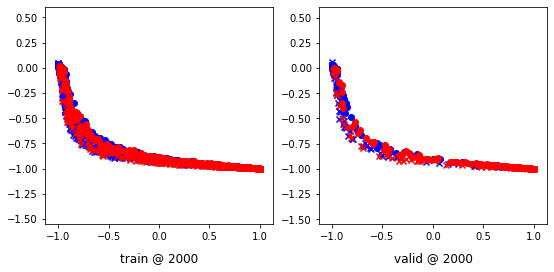

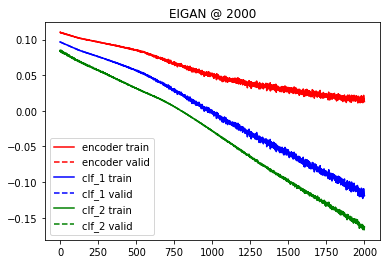

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.012214 	 1.012288 	 0.5383
200 	 0.679940 	 0.662378 	 0.8009
400 	 0.579156 	 0.535477 	 0.8249
600 	 0.578323 	 0.533610 	 0.8228
800 	 0.577984 	 0.532583 	 0.8271
1000 	 0.577846 	 0.531877 	 0.8293
Accuracy: 0.8293216630196937
Error Rate: 0.17067833698030635
F1 Score: 0.8177570093457944
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8271334792122538
Error Rate: 0.17286652078774617
F1 Score: 0.8158508158508159
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8271334792122538
Error Rate: 0.1

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.7964989059080962
Error Rate: 0.20350109409190373
F1 Score: 0.7759036144578313
VAR1: 0.2, VAR2: 0.8, TRIAL: 3
X, y_1, y2
(2292, 2) (2292, 1) (2292, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1833, 2) (459, 2) (1833, 1) (459, 1) (1833, 1) (459, 1)
class weights => w1, w2 [2.38051948 1.724365  ] [2.57805907 1.63368984]
tensor sizes => torch.Size([1833, 2]) torch.Size([459, 2]) torch.Size([1833, 2]) torch.Size([459, 2]) torch.Size([1833, 2]) torch.Size([459, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.70438194 	 0.70266354 	 1.05249476 	 1.05144083 	 1.04144096 	 1.04192448


 25%|██▌       | 504/2001 [00:33<01:39, 15.11it/s]

500 	 0.50575989 	 0.46979326 	 0.73642516 	 0.71107501 	 0.92387080 	 0.93442893


 50%|█████     | 1004/2001 [01:07<00:59, 16.64it/s]

1000 	 0.46377647 	 0.45231330 	 0.71292955 	 0.68860966 	 0.94228828 	 0.92944354


 75%|███████▌  | 1503/2001 [01:40<00:35, 13.85it/s]

1500 	 0.47523177 	 0.44600081 	 0.72071195 	 0.68345571 	 0.93917131 	 0.93060207


100%|██████████| 2001/2001 [02:13<00:00, 14.96it/s]


2000 	 0.50011051 	 0.44882464 	 0.73230606 	 0.68798310 	 0.92544925 	 0.93230563


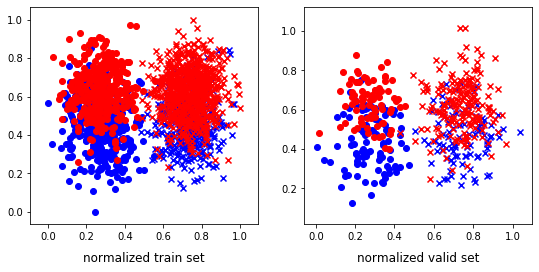

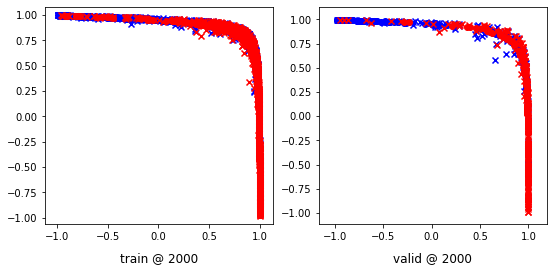

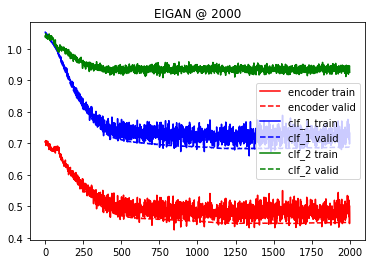

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:20, 24.77it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.02887368 	 0.02854479 	 -0.03750982 	 -0.03742438 	 -0.05753249 	 -0.05684464


 25%|██▌       | 504/2001 [00:31<01:33, 16.07it/s]

500 	 -0.01547461 	 -0.01566422 	 -0.09605923 	 -0.09622195 	 -0.08386728 	 -0.08382693


 50%|█████     | 1002/2001 [01:03<01:07, 14.71it/s]

1000 	 -0.04212637 	 -0.04277276 	 -0.15720028 	 -0.15783592 	 -0.13922100 	 -0.13920963


 75%|███████▌  | 1504/2001 [01:36<00:29, 16.86it/s]

1500 	 -0.07951193 	 -0.08044949 	 -0.24543300 	 -0.24573690 	 -0.20733374 	 -0.20655553


100%|██████████| 2001/2001 [02:09<00:00, 15.46it/s]


2000 	 -0.11587775 	 -0.11605038 	 -0.33178589 	 -0.33270362 	 -0.26465639 	 -0.26546025


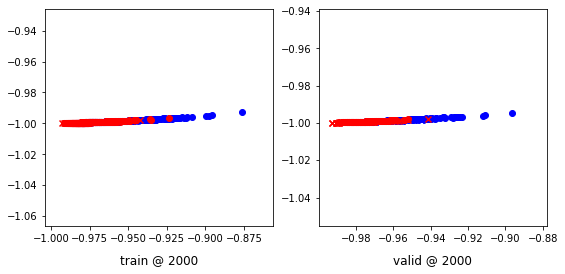

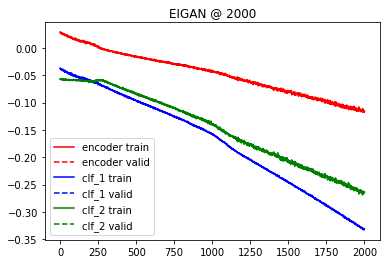

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.012737 	 1.013058 	 0.5795
200 	 0.784836 	 0.777674 	 0.7560
400 	 0.704050 	 0.675569 	 0.7364
600 	 0.703446 	 0.675142 	 0.7364
800 	 0.703142 	 0.675104 	 0.7386
1000 	 0.702847 	 0.675238 	 0.7407
Accuracy: 0.7407407407407407
Error Rate: 0.25925925925925924
F1 Score: 0.7792207792207793
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7494553376906318
Error Rate: 0.25054466230936817
F1 Score: 0.7817836812144212
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7516339869281046
Error Rate: 0.2

  0%|          | 2/2001 [00:00<01:49, 18.28it/s]

Accuracy: 0.7080610021786492
Error Rate: 0.29193899782135074
F1 Score: 0.767361111111111
VAR1: 0.4, VAR2: 0.2, TRIAL: 3
X, y_1, y2
(2163, 2) (2163, 1) (2163, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1730, 2) (433, 2) (1730, 1) (433, 1) (1730, 1) (433, 1)
class weights => w1, w2 [1.97488584 2.02576112] [1.81913775 2.22079589]
tensor sizes => torch.Size([1730, 2]) torch.Size([433, 2]) torch.Size([1730, 2]) torch.Size([433, 2]) torch.Size([1730, 2]) torch.Size([433, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.69881403 	 0.70415378 	 1.05256319 	 1.05506349 	 1.04741061 	 1.04405689


 25%|██▌       | 503/2001 [00:32<01:31, 16.29it/s]

500 	 0.13619944 	 0.15604877 	 0.29054075 	 0.29963255 	 0.84749138 	 0.83673096


 50%|█████     | 1002/2001 [01:05<01:13, 13.60it/s]

1000 	 -0.12478666 	 -0.07543715 	 0.04351652 	 0.05922846 	 0.86143845 	 0.82781279


 75%|███████▌  | 1503/2001 [01:38<00:37, 13.34it/s]

1500 	 -0.08302425 	 -0.09583250 	 0.02468030 	 0.03815696 	 0.80082083 	 0.82713664


100%|██████████| 2001/2001 [02:12<00:00, 15.13it/s]


2000 	 -0.11098713 	 -0.09762387 	 0.01459717 	 0.03571368 	 0.81875080 	 0.82648474


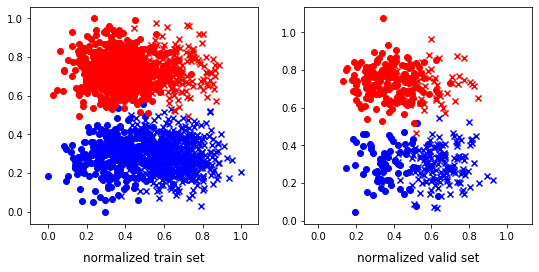

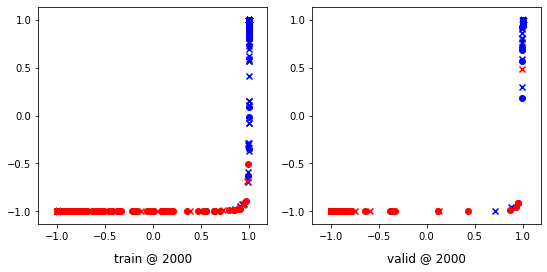

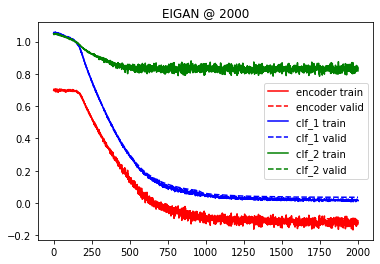

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:47, 18.66it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.00509061 	 -0.00470345 	 -0.04460195 	 -0.04403458 	 0.00128293 	 0.00167920


 25%|██▌       | 503/2001 [00:31<01:39, 15.06it/s]

500 	 -0.03810821 	 -0.03733531 	 -0.09139799 	 -0.09125345 	 -0.03081007 	 -0.03220279


 50%|█████     | 1003/2001 [01:02<01:11, 14.03it/s]

1000 	 -0.08515830 	 -0.08489890 	 -0.17353892 	 -0.17369792 	 -0.09727287 	 -0.09799164


 75%|███████▌  | 1503/2001 [01:34<00:33, 14.75it/s]

1500 	 -0.13013518 	 -0.13009560 	 -0.25784132 	 -0.26008970 	 -0.15735613 	 -0.16054696


100%|██████████| 2001/2001 [02:05<00:00, 15.93it/s]


2000 	 -0.16350992 	 -0.16457547 	 -0.35485551 	 -0.35114369 	 -0.23742941 	 -0.23193544


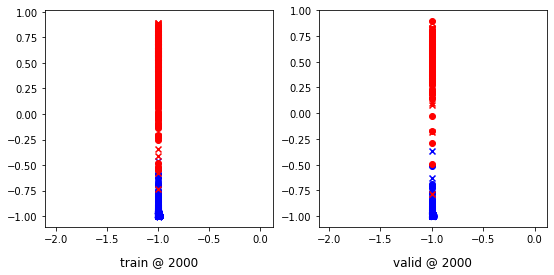

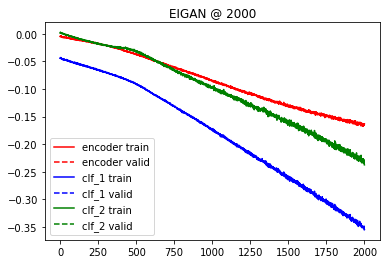

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.029050 	 1.029449 	 0.4919
200 	 0.275049 	 0.282514 	 0.9885
400 	 0.051128 	 0.059064 	 0.9954
600 	 0.028489 	 0.035961 	 0.9931
800 	 0.021404 	 0.029093 	 0.9931
1000 	 0.018179 	 0.026334 	 0.9931
Accuracy: 0.9930715935334873
Error Rate: 0.006928406466512702
F1 Score: 0.9929411764705881
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9953810623556582
Error Rate: 0.004618937644341801
F1 Score: 0.9953051643192489
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9930715935334873
Error Rate: 0

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.7136258660508084
Error Rate: 0.2863741339491917
F1 Score: 0.7004830917874396
VAR1: 0.4, VAR2: 0.4, TRIAL: 3
X, y_1, y2
(2198, 2) (2198, 1) (2198, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1758, 2) (440, 2) (1758, 1) (440, 1) (1758, 1) (440, 1)
class weights => w1, w2 [1.32980333 4.03211009] [1.96644295 2.03472222]
tensor sizes => torch.Size([1758, 2]) torch.Size([440, 2]) torch.Size([1758, 2]) torch.Size([440, 2]) torch.Size([1758, 2]) torch.Size([440, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.71254992 	 0.70126140 	 1.06898630 	 1.05760825 	 1.04983044 	 1.04949403


 25%|██▌       | 502/2001 [00:33<01:48, 13.83it/s]

500 	 0.35583258 	 0.33944899 	 0.61628574 	 0.60107470 	 0.95492452 	 0.95477289


 50%|█████     | 1003/2001 [01:05<01:08, 14.50it/s]

1000 	 0.13010389 	 0.09355870 	 0.39065087 	 0.35133222 	 0.95386392 	 0.95092070


 75%|███████▌  | 1504/2001 [01:38<00:31, 15.57it/s]

1500 	 0.07877347 	 0.06223461 	 0.33861217 	 0.31915608 	 0.95298380 	 0.95006865


100%|██████████| 2001/2001 [02:11<00:00, 15.20it/s]


2000 	 0.05691373 	 0.05681920 	 0.31695691 	 0.31348133 	 0.95317024 	 0.94980931


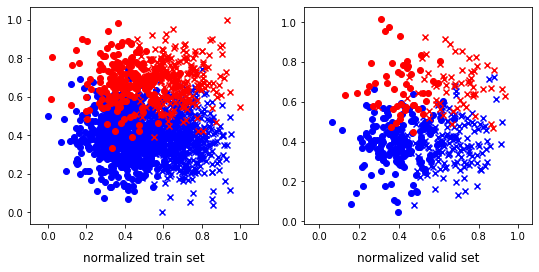

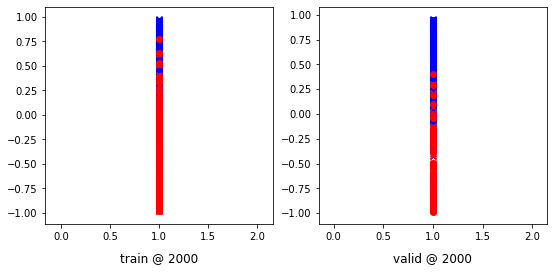

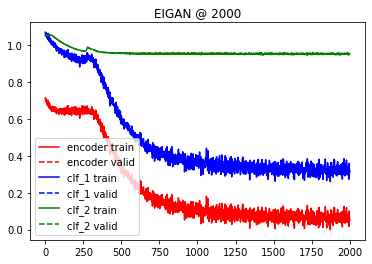

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:17, 14.58it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.03136325 	 0.03132698 	 -0.00520054 	 -0.00523669 	 0.00882409 	 0.00878372


 25%|██▌       | 503/2001 [00:30<01:27, 17.21it/s]

500 	 -0.00279862 	 -0.00360268 	 -0.05943856 	 -0.05988727 	 -0.03798842 	 -0.03724374


 50%|█████     | 1003/2001 [01:01<01:07, 14.85it/s]

1000 	 -0.07815938 	 -0.07836461 	 -0.14548074 	 -0.14648479 	 -0.05944043 	 -0.06099841


 75%|███████▌  | 1502/2001 [01:32<00:32, 15.40it/s]

1500 	 -0.17039999 	 -0.17169198 	 -0.27082622 	 -0.27189368 	 -0.11690054 	 -0.11654653


100%|██████████| 2001/2001 [02:04<00:00, 16.09it/s]


2000 	 -0.25940958 	 -0.25974852 	 -0.39977711 	 -0.39863253 	 -0.17465642 	 -0.17267144


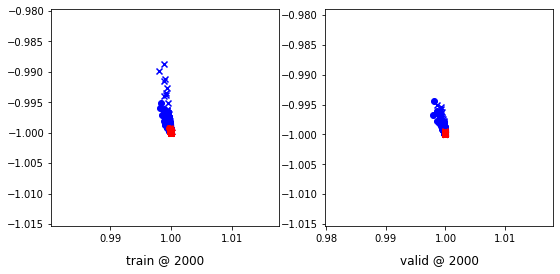

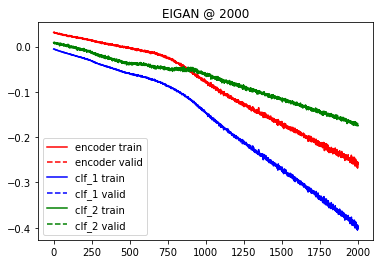

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.074045 	 1.073712 	 0.2477
200 	 0.497348 	 0.496392 	 0.9091
400 	 0.321739 	 0.312873 	 0.9205
600 	 0.316794 	 0.307603 	 0.9227
800 	 0.316243 	 0.307666 	 0.9205
1000 	 0.316019 	 0.308039 	 0.9205
Accuracy: 0.9204545454545454
Error Rate: 0.07954545454545454
F1 Score: 0.8401826484018265
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9068181818181819
Error Rate: 0.09318181818181819
F1 Score: 0.825531914893617
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9090909090909091
Error Rate: 0.09

  0%|          | 2/2001 [00:00<02:11, 15.17it/s]

Accuracy: 0.5068181818181818
Error Rate: 0.49318181818181817
F1 Score: 0.0
VAR1: 0.4, VAR2: 0.6, TRIAL: 3
X, y_1, y2
(1850, 2) (1850, 1) (1850, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1480, 2) (370, 2) (1480, 1) (370, 1) (1480, 1) (370, 1)
class weights => w1, w2 [1.82716049 2.20895522] [3.34085779 1.42719383]
tensor sizes => torch.Size([1480, 2]) torch.Size([370, 2]) torch.Size([1480, 2]) torch.Size([370, 2]) torch.Size([1480, 2]) torch.Size([370, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.73069370 	 0.72364241 	 1.03271377 	 1.03009772 	 0.99544632 	 0.99960250


 25%|██▌       | 504/2001 [00:31<01:23, 17.98it/s]

500 	 0.41203821 	 0.45306647 	 0.61194706 	 0.66591758 	 0.89287847 	 0.90599829


 50%|█████     | 1004/2001 [01:01<01:00, 16.41it/s]

1000 	 0.42768598 	 0.39090478 	 0.65550727 	 0.60161734 	 0.92127836 	 0.90385973


 75%|███████▌  | 1504/2001 [01:32<00:27, 18.17it/s]

1500 	 0.45360023 	 0.38071281 	 0.62280124 	 0.59038818 	 0.86236566 	 0.90282255


100%|██████████| 2001/2001 [02:03<00:00, 16.26it/s]

2000 	 0.38927960 	 0.37760085 	 0.60811812 	 0.59022909 	 0.91187382 	 0.90577543


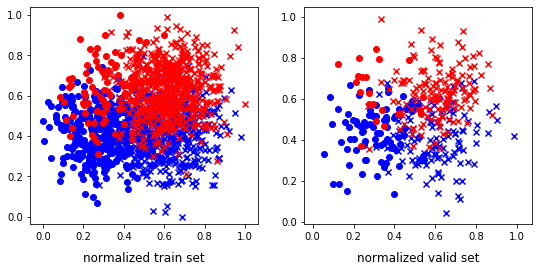

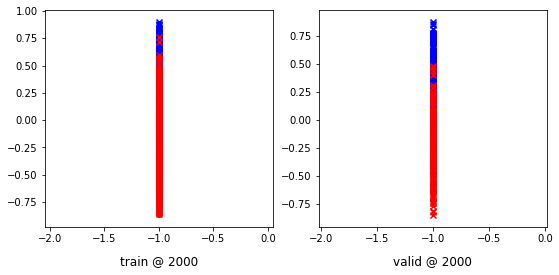

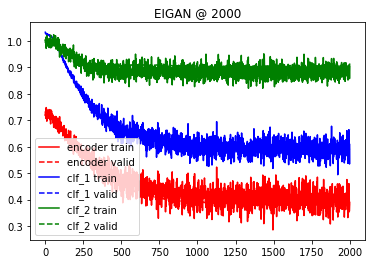

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<01:47, 18.51it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.00474416 	 -0.00476535 	 -0.03197328 	 -0.03187504 	 0.03514247 	 0.03534979


 25%|██▌       | 504/2001 [00:30<01:37, 15.38it/s]

500 	 -0.04545411 	 -0.04413979 	 -0.09629020 	 -0.09496368 	 -0.02541101 	 -0.02544154


 50%|█████     | 1003/2001 [00:59<01:01, 16.34it/s]

1000 	 -0.07353435 	 -0.07369585 	 -0.15358044 	 -0.15389794 	 -0.08292083 	 -0.08319972


 75%|███████▌  | 1504/2001 [01:28<00:27, 18.16it/s]

1500 	 -0.09718879 	 -0.09789817 	 -0.21784051 	 -0.21692233 	 -0.14734888 	 -0.14499879


100%|██████████| 2001/2001 [01:57<00:00, 17.05it/s]


2000 	 -0.11872025 	 -0.11884582 	 -0.29057261 	 -0.29010478 	 -0.21455066 	 -0.21383445


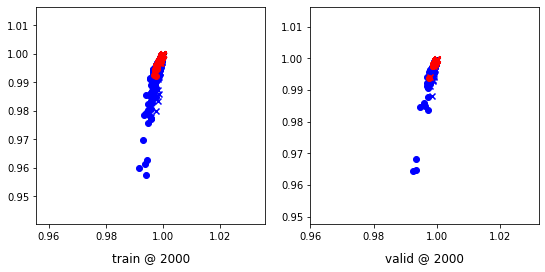

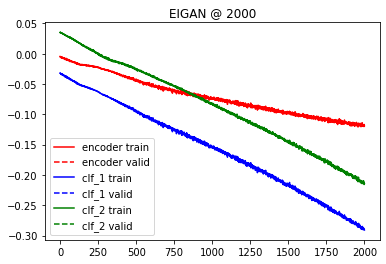

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.075602 	 1.075485 	 0.4541
200 	 0.739877 	 0.743927 	 0.8027
400 	 0.560240 	 0.559630 	 0.8108
600 	 0.556282 	 0.552079 	 0.8081
800 	 0.555202 	 0.549197 	 0.8108
1000 	 0.554680 	 0.547963 	 0.8108
Accuracy: 0.8108108108108109
Error Rate: 0.1891891891891892
F1 Score: 0.7976878612716762
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8027027027027027
Error Rate: 0.1972972972972973
F1 Score: 0.7943661971830986
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8081081081081081
Error Rate: 0.191

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.920782 	 0.922470 	 0.7000
Accuracy: 0.7
Error Rate: 0.3
F1 Score: 0.8235294117647058
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7648648648648648
Error Rate: 0.23513513513513515
F1 Score: 0.8432432432432432
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8837837837837837
Error Rate: 0.11621621621621622
F1 Score: 0.9180952380952381
VAR1: 0.4, VAR2: 0.8, TRIAL: 3
X, y_1, y2
(2045, 2) (2045, 1) (2045, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1636, 2) (409, 2) (1636, 1) (409, 1) (1636, 1) (409, 1)
class weights => w1, w2 [2.16688742 1.8569807 ] [4.36266667 1.29738303]
tensor sizes => torch.Size([1636, 2]) torch.Size([409, 2]) torch.Size([1636, 2]) torch.Size([409, 2]) torch.Size([1636, 2]) torch.Size([409, 2])
--------------------------------------------------------------------------------
EIGAN Training
------------------------------------

  0%|          | 5/2001 [00:00<01:38, 20.28it/s]

0 	 0.67739904 	 0.69561672 	 1.02553988 	 1.02395952 	 1.04137242 	 1.02148998


 25%|██▌       | 502/2001 [00:32<01:43, 14.51it/s]

500 	 0.59717870 	 0.62850165 	 0.78436559 	 0.84048665 	 0.88065213 	 0.90513217


 50%|█████     | 1003/2001 [01:04<01:06, 15.06it/s]

1000 	 0.54302353 	 0.61476392 	 0.73080355 	 0.81893730 	 0.88096184 	 0.89732057


 75%|███████▌  | 1504/2001 [01:38<00:31, 15.67it/s]

1500 	 0.55443597 	 0.61742651 	 0.72313088 	 0.81997216 	 0.86206865 	 0.89569283


100%|██████████| 2001/2001 [02:10<00:00, 15.33it/s]


2000 	 0.51406789 	 0.61142385 	 0.73138100 	 0.81552017 	 0.91074336 	 0.89724350


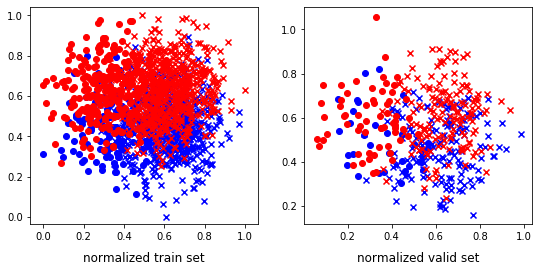

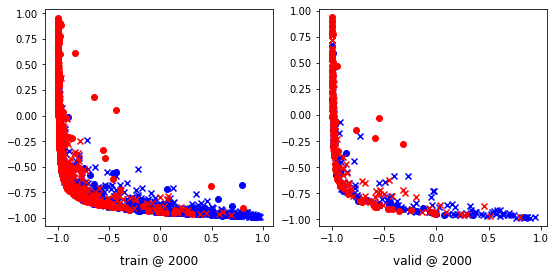

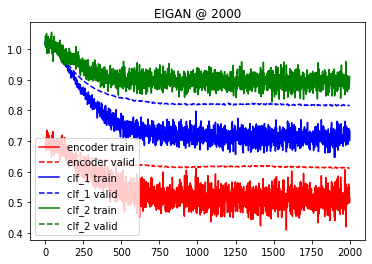

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:27, 22.84it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.01318938 	 0.01019797 	 -0.03492354 	 -0.03780514 	 -0.01924156 	 -0.01909613


 25%|██▌       | 504/2001 [00:30<01:37, 15.33it/s]

500 	 -0.05901185 	 -0.05791679 	 -0.12892362 	 -0.12766173 	 -0.06439658 	 -0.06409267


 50%|█████     | 1004/2001 [01:01<01:03, 15.74it/s]

1000 	 -0.11202563 	 -0.11171174 	 -0.20218243 	 -0.20220765 	 -0.10026042 	 -0.10082538


 75%|███████▌  | 1503/2001 [01:32<00:32, 15.44it/s]

1500 	 -0.17170040 	 -0.17109668 	 -0.28636971 	 -0.28568465 	 -0.13862838 	 -0.13850844


100%|██████████| 2001/2001 [02:03<00:00, 16.25it/s]


2000 	 -0.23305218 	 -0.23683535 	 -0.37837610 	 -0.38145408 	 -0.18121371 	 -0.18028769


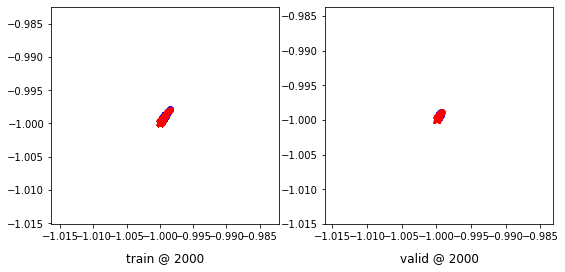

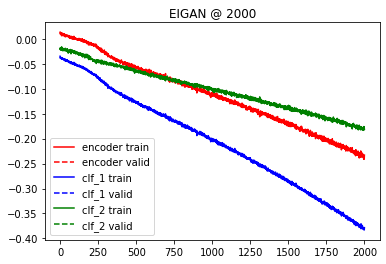

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.014199 	 1.015175 	 0.5403
200 	 0.788275 	 0.838571 	 0.6846
400 	 0.709469 	 0.811366 	 0.6846
600 	 0.707814 	 0.813171 	 0.6822
800 	 0.707361 	 0.813164 	 0.6822
1000 	 0.707164 	 0.813287 	 0.6822
Accuracy: 0.6821515892420538
Error Rate: 0.31784841075794623
F1 Score: 0.7072072072072072
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.6821515892420538
Error Rate: 0.31784841075794623
F1 Score: 0.7018348623853211
SVM
--------------------------------------------------------------------------------
Accuracy: 0.6699266503667481
Error Rate: 0.3

  0%|          | 3/2001 [00:00<01:21, 24.65it/s]

Accuracy: 0.7921760391198044
Error Rate: 0.2078239608801956
F1 Score: 0.8694316436251921
VAR1: 0.6, VAR2: 0.2, TRIAL: 3
X, y_1, y2
(1591, 2) (1591, 1) (1591, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1272, 2) (319, 2) (1272, 1) (319, 1) (1272, 1) (319, 1)
class weights => w1, w2 [1.43566591 3.29533679] [6.36       1.18656716]
tensor sizes => torch.Size([1272, 2]) torch.Size([319, 2]) torch.Size([1272, 2]) torch.Size([319, 2]) torch.Size([1272, 2]) torch.Size([319, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.71250713 	 0.67912400 	 1.04525268 	 1.04378390 	 1.02609110 	 1.05780709


 25%|██▌       | 503/2001 [00:28<01:37, 15.42it/s]

500 	 0.11695561 	 0.12956402 	 0.25430927 	 0.27674213 	 0.83056068 	 0.84032530


 50%|█████     | 1003/2001 [00:58<00:59, 16.75it/s]

1000 	 -0.04049548 	 -0.03079486 	 0.03876320 	 0.10333228 	 0.77240974 	 0.82727432


 75%|███████▌  | 1503/2001 [01:27<00:30, 16.10it/s]

1500 	 -0.07693953 	 -0.03319275 	 0.07270417 	 0.10048170 	 0.84317225 	 0.82682163


100%|██████████| 2001/2001 [01:57<00:00, 17.00it/s]


2000 	 -0.11932809 	 -0.04364485 	 0.01429557 	 0.09093404 	 0.82691151 	 0.82772607


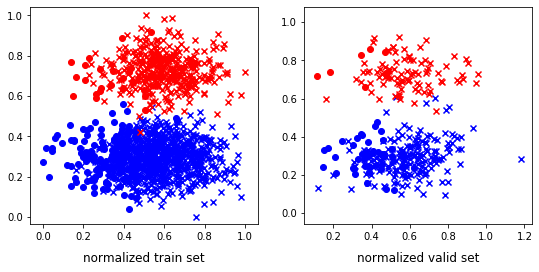

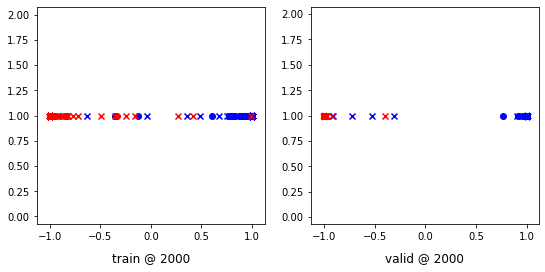

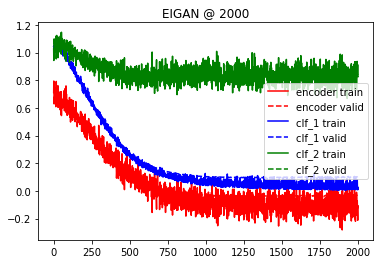

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:42, 19.42it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.10092477 	 0.10182525 	 0.07470287 	 0.07554306 	 0.03825665 	 0.03788217


 25%|██▌       | 503/2001 [00:28<01:30, 16.57it/s]

500 	 0.03579125 	 0.03443488 	 0.00646810 	 0.00523271 	 0.02908704 	 0.02911358


 50%|█████     | 1004/2001 [00:57<00:56, 17.58it/s]

1000 	 -0.05804020 	 -0.06015852 	 -0.09802501 	 -0.10051244 	 0.00005073 	 -0.00088285


 75%|███████▌  | 1504/2001 [01:25<00:27, 18.23it/s]

1500 	 -0.13367097 	 -0.13301528 	 -0.19909154 	 -0.19915445 	 -0.05577289 	 -0.05717539


100%|██████████| 2001/2001 [01:53<00:00, 17.58it/s]


2000 	 -0.20181397 	 -0.20369053 	 -0.30460566 	 -0.30500716 	 -0.12061124 	 -0.11830273


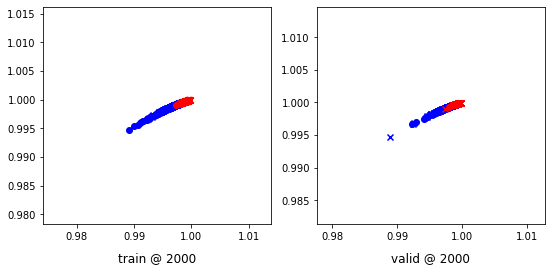

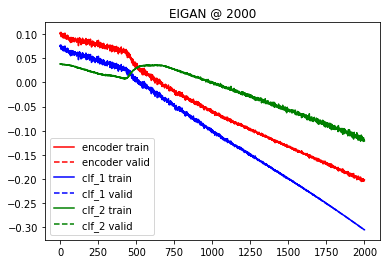

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.009724 	 1.009973 	 0.6959
200 	 0.312744 	 0.303512 	 0.9875
400 	 0.060916 	 0.068670 	 0.9812
600 	 0.037272 	 0.056335 	 0.9812
800 	 0.030522 	 0.057303 	 0.9812
1000 	 0.027768 	 0.060423 	 0.9812
Accuracy: 0.9811912225705329
Error Rate: 0.018808777429467086
F1 Score: 0.97
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9811912225705329
Error Rate: 0.018808777429467086
F1 Score: 0.97
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9811912225705329
Error Rate: 0.018808777429467086
F1 Score

  0%|          | 3/2001 [00:00<01:20, 24.94it/s]

tensor sizes => torch.Size([1166, 2]) torch.Size([292, 2]) torch.Size([1166, 2]) torch.Size([292, 2]) torch.Size([1166, 2]) torch.Size([292, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.70394146 	 0.70317113 	 1.02291310 	 1.02252746 	 1.01239705 	 1.01250350


 25%|██▌       | 504/2001 [00:29<01:29, 16.64it/s]

500 	 0.32852381 	 0.27713019 	 0.51699024 	 0.47345638 	 0.88298064 	 0.88947338


 50%|█████     | 1003/2001 [00:58<01:01, 16.35it/s]

1000 	 0.21260923 	 0.16873378 	 0.38318416 	 0.35866714 	 0.86367226 	 0.88308054


 75%|███████▌  | 1503/2001 [01:26<00:30, 16.08it/s]

1500 	 0.11314547 	 0.16339222 	 0.32309276 	 0.35308430 	 0.90319693 	 0.88283926


100%|██████████| 2001/2001 [01:55<00:00, 17.39it/s]


2000 	 0.13132897 	 0.16178483 	 0.33644176 	 0.34994036 	 0.89902014 	 0.88130271


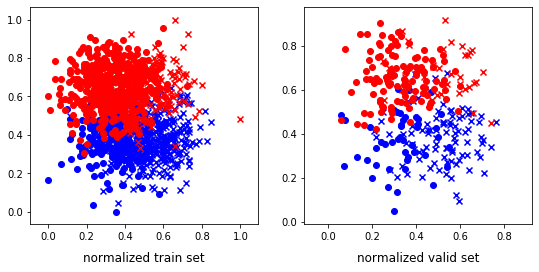

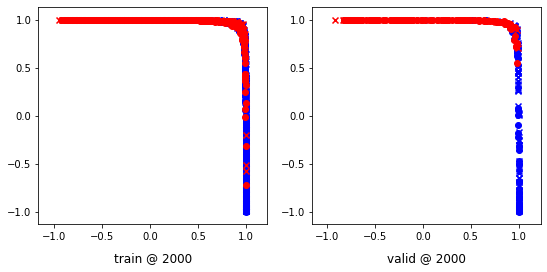

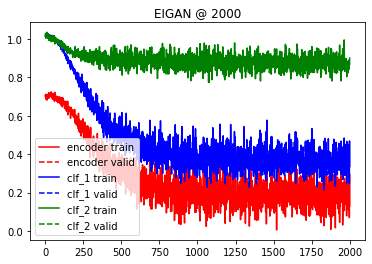

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:19, 25.25it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.00105400 	 -0.00087820 	 -0.02466608 	 -0.02331285 	 0.04639596 	 0.05021800


 25%|██▌       | 502/2001 [00:26<01:14, 20.10it/s]

500 	 -0.05354124 	 -0.05535138 	 -0.08069199 	 -0.08330422 	 0.03529485 	 0.03280896


 50%|█████     | 1005/2001 [00:54<00:46, 21.56it/s]

1000 	 -0.15660067 	 -0.16462794 	 -0.19892581 	 -0.20744272 	 -0.00572618 	 -0.00691731


 75%|███████▌  | 1505/2001 [01:21<00:24, 19.91it/s]

1500 	 -0.25052193 	 -0.25319290 	 -0.31548879 	 -0.31673780 	 -0.05488553 	 -0.05208112


100%|██████████| 2001/2001 [01:48<00:00, 18.47it/s]


2000 	 -0.34679598 	 -0.34336990 	 -0.43777224 	 -0.43488276 	 -0.10162263 	 -0.10251095


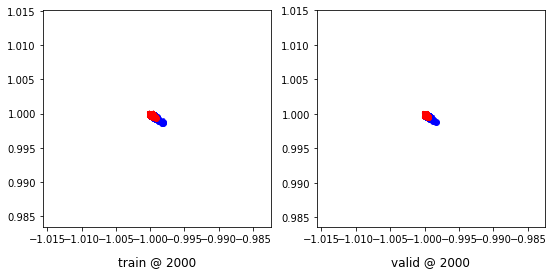

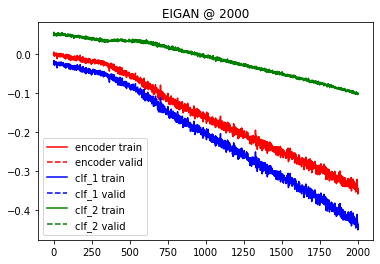

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.030172 	 1.030081 	 0.4726
200 	 0.537974 	 0.534988 	 0.9110
400 	 0.356949 	 0.337487 	 0.9212
600 	 0.349930 	 0.324726 	 0.9144
800 	 0.349511 	 0.323553 	 0.9144
1000 	 0.349305 	 0.323212 	 0.9144
Accuracy: 0.9143835616438356
Error Rate: 0.08561643835616438
F1 Score: 0.9211356466876971
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9143835616438356
Error Rate: 0.08561643835616438
F1 Score: 0.9211356466876971
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9178082191780822
Error Rate: 0.0

  0%|          | 3/2001 [00:00<01:31, 21.89it/s]

tensor sizes => torch.Size([1511, 2]) torch.Size([378, 2]) torch.Size([1511, 2]) torch.Size([378, 2]) torch.Size([1511, 2]) torch.Size([378, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.67169416 	 0.68319178 	 1.04070520 	 1.04153848 	 1.06231642 	 1.05149388


 25%|██▌       | 502/2001 [00:30<01:19, 18.93it/s]

500 	 0.37837863 	 0.41997135 	 0.57170194 	 0.59006262 	 0.88656485 	 0.86323845


 50%|█████     | 1003/2001 [01:01<01:07, 14.82it/s]

1000 	 0.33988142 	 0.38193905 	 0.52095693 	 0.55222356 	 0.87410164 	 0.86343169


 75%|███████▌  | 1503/2001 [01:32<00:30, 16.28it/s]

1500 	 0.32409120 	 0.37840146 	 0.52231711 	 0.55106407 	 0.89158899 	 0.86580980


100%|██████████| 2001/2001 [02:03<00:00, 16.18it/s]


2000 	 0.39982080 	 0.37761557 	 0.60506332 	 0.54875362 	 0.89838570 	 0.86428523


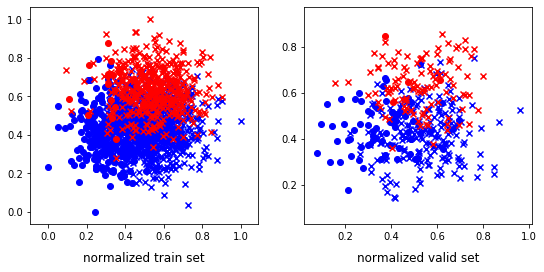

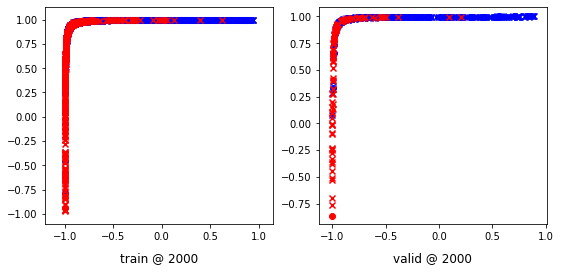

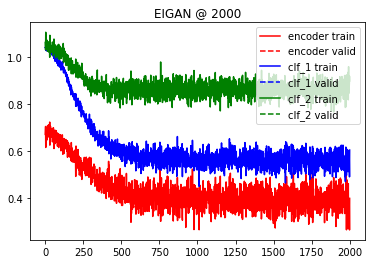

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<01:51, 17.99it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.09998557 	 0.10061792 	 -0.00076720 	 -0.00021288 	 -0.11734328 	 -0.11753865


 25%|██▌       | 504/2001 [00:29<01:33, 16.08it/s]

500 	 0.02972168 	 0.02808226 	 -0.08305431 	 -0.08485678 	 -0.13580628 	 -0.13606404


 50%|█████     | 1003/2001 [00:58<01:04, 15.56it/s]

1000 	 0.02272525 	 0.02968000 	 -0.12786973 	 -0.12087299 	 -0.18806493 	 -0.18801157


 75%|███████▌  | 1504/2001 [01:28<00:25, 19.36it/s]

1500 	 0.03501830 	 0.04070309 	 -0.16412421 	 -0.15982078 	 -0.24625374 	 -0.24779889


100%|██████████| 2001/2001 [01:57<00:00, 17.09it/s]


2000 	 0.06189340 	 0.05828947 	 -0.17649926 	 -0.17959449 	 -0.28825453 	 -0.28773350


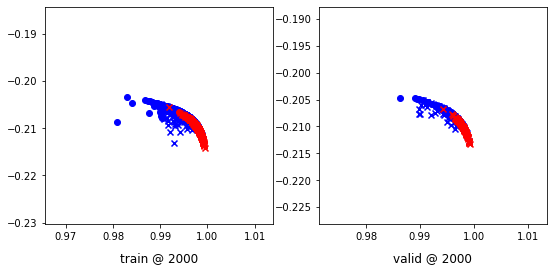

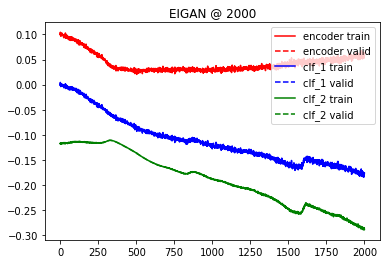

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.046708 	 1.047212 	 0.7037
200 	 0.654947 	 0.658463 	 0.8307
400 	 0.546769 	 0.536502 	 0.8280
600 	 0.545015 	 0.537100 	 0.8333
800 	 0.544884 	 0.537200 	 0.8360
1000 	 0.544701 	 0.537386 	 0.8333
Accuracy: 0.8333333333333334
Error Rate: 0.16666666666666666
F1 Score: 0.7174887892376682
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8174603174603174
Error Rate: 0.18253968253968253
F1 Score: 0.7206477732793523
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8333333333333334
Error Rate: 0.1

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.798941798941799
Error Rate: 0.20105820105820105
F1 Score: 0.888235294117647
VAR1: 0.6, VAR2: 0.8, TRIAL: 3
X, y_1, y2
(1805, 2) (1805, 1) (1805, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1444, 2) (361, 2) (1444, 1) (361, 1) (1444, 1) (361, 1)
class weights => w1, w2 [4.55520505 1.28127773] [2.10189229 1.90752972]
tensor sizes => torch.Size([1444, 2]) torch.Size([361, 2]) torch.Size([1444, 2]) torch.Size([361, 2]) torch.Size([1444, 2]) torch.Size([361, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.69190645 	 0.67971396 	 1.02217603 	 1.01487744 	 1.02374995 	 1.02831066


 25%|██▌       | 503/2001 [00:31<01:27, 17.17it/s]

500 	 0.41465729 	 0.44406301 	 0.67818576 	 0.70422137 	 0.95682812 	 0.95330554


 50%|█████     | 1004/2001 [01:01<00:57, 17.34it/s]

1000 	 0.42282838 	 0.40964472 	 0.68212950 	 0.67024791 	 0.95284760 	 0.95375037


 75%|███████▌  | 1503/2001 [01:32<00:35, 14.22it/s]

1500 	 0.45677245 	 0.41104352 	 0.72102243 	 0.67164850 	 0.95723671 	 0.95375216


100%|██████████| 2001/2001 [02:02<00:00, 16.32it/s]


2000 	 0.45545042 	 0.41246742 	 0.71453887 	 0.67314380 	 0.95378333 	 0.95382357


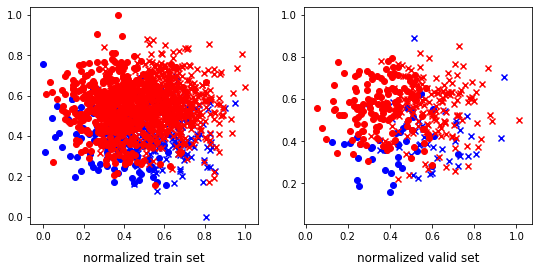

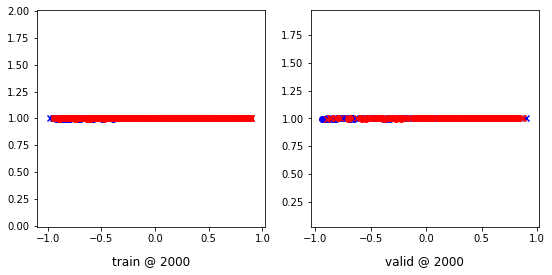

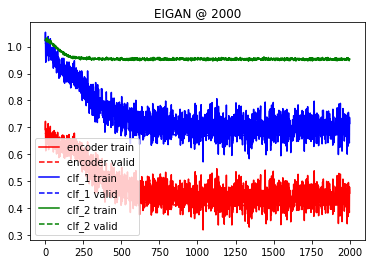

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:32, 13.15it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.02605331 	 0.02642117 	 -0.02783001 	 -0.02734385 	 -0.03200781 	 -0.03187286


 25%|██▌       | 503/2001 [00:29<01:23, 17.91it/s]

500 	 -0.00997077 	 -0.01009808 	 -0.08219658 	 -0.08219799 	 -0.06874754 	 -0.06851427


 50%|█████     | 1003/2001 [00:59<01:04, 15.41it/s]

1000 	 -0.05106058 	 -0.05218820 	 -0.12312216 	 -0.12252048 	 -0.06843853 	 -0.06520235


 75%|███████▌  | 1504/2001 [01:29<00:31, 15.69it/s]

1500 	 -0.15392803 	 -0.15378666 	 -0.25317770 	 -0.25284973 	 -0.11502240 	 -0.11474288


100%|██████████| 2001/2001 [01:58<00:00, 16.90it/s]


2000 	 -0.25370479 	 -0.25597435 	 -0.40134373 	 -0.40351170 	 -0.18423779 	 -0.18410589


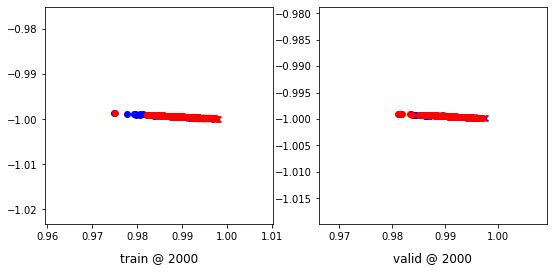

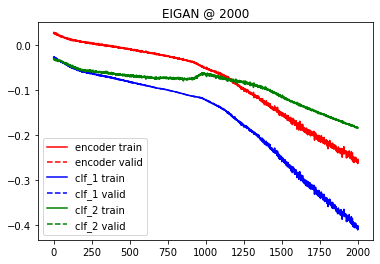

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.057796 	 1.056882 	 0.7812
200 	 0.803076 	 0.790490 	 0.7922
400 	 0.703220 	 0.676580 	 0.8199
600 	 0.700667 	 0.676085 	 0.8172
800 	 0.699842 	 0.677873 	 0.8199
1000 	 0.699269 	 0.680017 	 0.8199
Accuracy: 0.8199445983379502
Error Rate: 0.18005540166204986
F1 Score: 0.8845470692717585
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7673130193905817
Error Rate: 0.23268698060941828
F1 Score: 0.8372093023255814
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8254847645429363
Error Rate: 0.1

  0%|          | 3/2001 [00:00<01:14, 26.93it/s]

Accuracy: 0.5235457063711911
Error Rate: 0.47645429362880887
F1 Score: 0.6872727272727273
VAR1: 0.8, VAR2: 0.2, TRIAL: 3
X, y_1, y2
(1450, 2) (1450, 1) (1450, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1160, 2) (290, 2) (1160, 1) (290, 1) (1160, 1) (290, 1)
class weights => w1, w2 [4.51361868 1.28460687] [1.45       3.22222222]
tensor sizes => torch.Size([1160, 2]) torch.Size([290, 2]) torch.Size([1160, 2]) torch.Size([290, 2]) torch.Size([1160, 2]) torch.Size([290, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.64513564 	 0.63694227 	 1.01415408 	 1.01412582 	 1.06266320 	 1.07033074


 25%|██▌       | 505/2001 [00:28<01:23, 17.84it/s]

500 	 -0.04489632 	 -0.04918611 	 0.17889334 	 0.18857723 	 0.91699529 	 0.93091053


 50%|█████     | 1003/2001 [00:56<00:57, 17.46it/s]

1000 	 -0.18305629 	 -0.16700533 	 0.02367149 	 0.06918142 	 0.89989525 	 0.92933393


 75%|███████▌  | 1503/2001 [01:24<00:28, 17.72it/s]

1500 	 -0.17646763 	 -0.17511335 	 0.00653776 	 0.06165066 	 0.87610906 	 0.92991120


100%|██████████| 2001/2001 [01:52<00:00, 17.73it/s]


2000 	 -0.20402916 	 -0.16818097 	 0.00350609 	 0.06859740 	 0.90076977 	 0.92992556


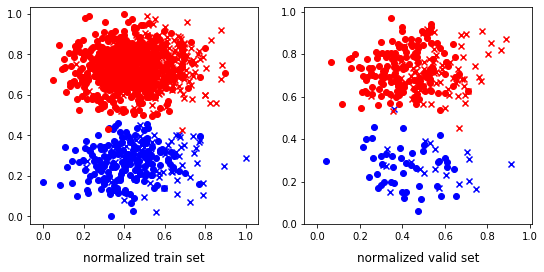

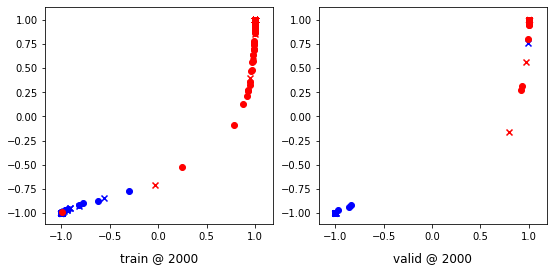

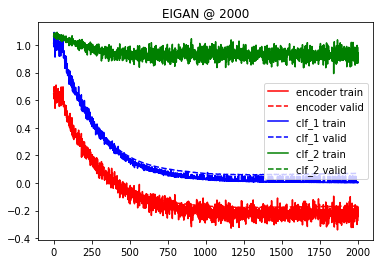

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:28, 22.60it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.11632176 	 0.11400154 	 0.05907508 	 0.05600521 	 -0.03919761 	 -0.04082428


 25%|██▌       | 503/2001 [00:27<01:18, 19.05it/s]

500 	 0.08193521 	 0.08251519 	 0.00729340 	 0.00952531 	 -0.07320207 	 -0.07016641


 50%|█████     | 1003/2001 [00:54<01:03, 15.64it/s]

1000 	 0.06974301 	 0.06324689 	 -0.02987559 	 -0.03525908 	 -0.11557954 	 -0.11385660


 75%|███████▌  | 1502/2001 [01:21<00:25, 19.87it/s]

1500 	 0.01160774 	 0.00788090 	 -0.15882240 	 -0.16127175 	 -0.21280742 	 -0.21128172


100%|██████████| 2001/2001 [01:48<00:00, 18.48it/s]


2000 	 -0.02844357 	 -0.02713726 	 -0.27631262 	 -0.27678084 	 -0.29786184 	 -0.29964343


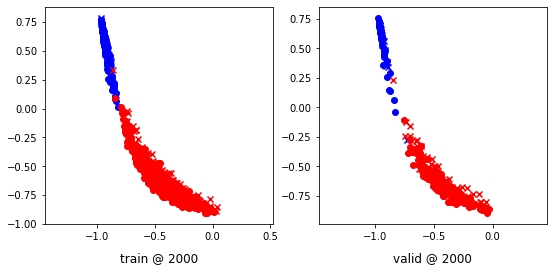

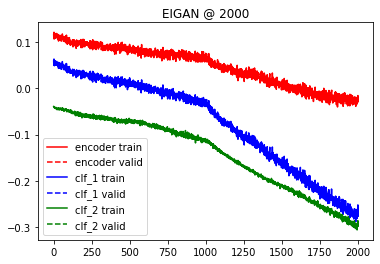

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.062167 	 1.061300 	 0.7793
200 	 0.251998 	 0.264890 	 0.9897
400 	 0.045017 	 0.062349 	 0.9931
600 	 0.024129 	 0.044600 	 0.9931
800 	 0.017426 	 0.041134 	 0.9931
1000 	 0.014224 	 0.040903 	 0.9931
Accuracy: 0.993103448275862
Error Rate: 0.006896551724137931
F1 Score: 0.995575221238938
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.993103448275862
Error Rate: 0.006896551724137931
F1 Score: 0.995575221238938
SVM
--------------------------------------------------------------------------------
Accuracy: 0.996551724137931
Error Rate: 0.0034

  0%|          | 2/2001 [00:00<02:03, 16.23it/s]

tensor sizes => torch.Size([1945, 2]) torch.Size([487, 2]) torch.Size([1945, 2]) torch.Size([487, 2]) torch.Size([1945, 2]) torch.Size([487, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.67394602 	 0.67464912 	 1.01621199 	 1.01580799 	 1.03550518 	 1.03430605


 25%|██▌       | 502/2001 [00:35<01:46, 14.01it/s]

500 	 0.14265266 	 0.12802300 	 0.40384433 	 0.38859394 	 0.95436192 	 0.95371813


 50%|█████     | 1003/2001 [01:10<01:16, 13.03it/s]

1000 	 0.07578823 	 0.04664290 	 0.33430892 	 0.30710667 	 0.95164841 	 0.95361096


 75%|███████▌  | 1503/2001 [01:46<00:33, 14.78it/s]

1500 	 0.04466006 	 0.03815851 	 0.30581388 	 0.29814640 	 0.95433462 	 0.95313507


100%|██████████| 2001/2001 [02:20<00:00, 14.20it/s]


2000 	 0.06854665 	 0.03512838 	 0.33036536 	 0.29489645 	 0.95493436 	 0.95291525


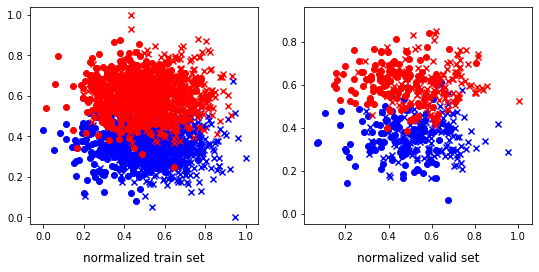

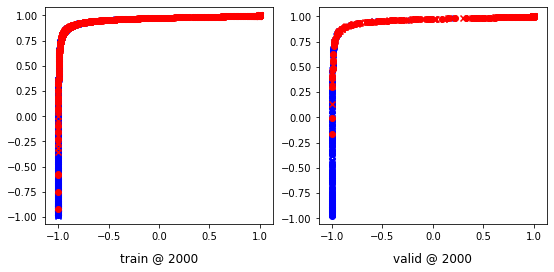

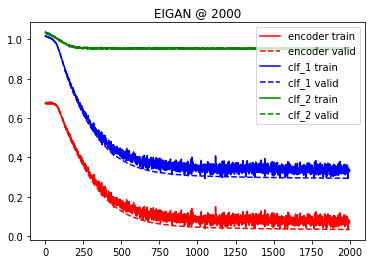

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:01, 16.48it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.09882576 	 -0.09834876 	 -0.12053276 	 -0.12005008 	 0.05271328 	 0.05268632


 25%|██▌       | 503/2001 [00:34<01:30, 16.62it/s]

500 	 -0.20067003 	 -0.19866636 	 -0.23021600 	 -0.22827978 	 0.02816683 	 0.02791448


 50%|█████     | 1003/2001 [01:08<01:14, 13.44it/s]

1000 	 -0.27365002 	 -0.27779415 	 -0.31395909 	 -0.31810623 	 -0.00076895 	 -0.00077868


 75%|███████▌  | 1503/2001 [01:41<00:30, 16.07it/s]

1500 	 -0.36645737 	 -0.36715028 	 -0.41828951 	 -0.41895059 	 -0.02766627 	 -0.02759681


100%|██████████| 2001/2001 [02:15<00:00, 14.77it/s]


2000 	 -0.46809471 	 -0.47298530 	 -0.53291100 	 -0.53783655 	 -0.05459031 	 -0.05465909


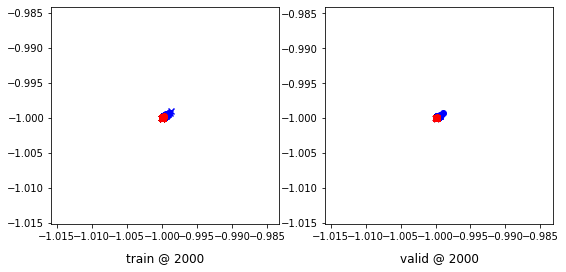

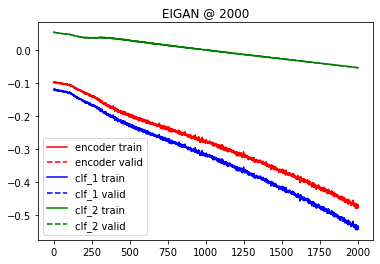

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.049173 	 1.048964 	 0.5257
200 	 0.603396 	 0.594152 	 0.8686
400 	 0.342828 	 0.302542 	 0.9158
600 	 0.336835 	 0.290014 	 0.9179
800 	 0.336671 	 0.289464 	 0.9179
1000 	 0.336569 	 0.289446 	 0.9179
Accuracy: 0.917864476386037
Error Rate: 0.08213552361396304
F1 Score: 0.9221789883268482
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.919917864476386
Error Rate: 0.08008213552361396
F1 Score: 0.9236790606653621
SVM
--------------------------------------------------------------------------------
Accuracy: 0.917864476386037
Error Rate: 0.0821

  0%|          | 2/2001 [00:00<01:42, 19.52it/s]

Accuracy: 0.5626283367556468
Error Rate: 0.43737166324435317
F1 Score: 0.5958254269449715
VAR1: 0.8, VAR2: 0.6, TRIAL: 3
X, y_1, y2
(2116, 2) (2116, 1) (2116, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1692, 2) (424, 2) (1692, 1) (424, 1) (1692, 1) (424, 1)
class weights => w1, w2 [3.670282   1.37449228] [2.10972569 1.9011236 ]
tensor sizes => torch.Size([1692, 2]) torch.Size([424, 2]) torch.Size([1692, 2]) torch.Size([424, 2]) torch.Size([1692, 2]) torch.Size([424, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.70453012 	 0.70888638 	 1.02008772 	 1.02495682 	 1.00907576 	 1.00921762


 25%|██▌       | 501/2001 [00:32<01:35, 15.67it/s]

500 	 0.37887543 	 0.39876562 	 0.64099604 	 0.65890276 	 0.95524681 	 0.95328432


 50%|█████     | 1002/2001 [01:06<01:03, 15.62it/s]

1000 	 0.30886793 	 0.33199179 	 0.56872743 	 0.59339875 	 0.95298517 	 0.95455414


 75%|███████▌  | 1504/2001 [01:38<00:30, 16.49it/s]

1500 	 0.35800993 	 0.32104099 	 0.61818415 	 0.58296692 	 0.95352441 	 0.95507312


100%|██████████| 2001/2001 [02:11<00:00, 15.21it/s]


2000 	 0.35164189 	 0.31838930 	 0.61006182 	 0.57903427 	 0.95181286 	 0.95379215


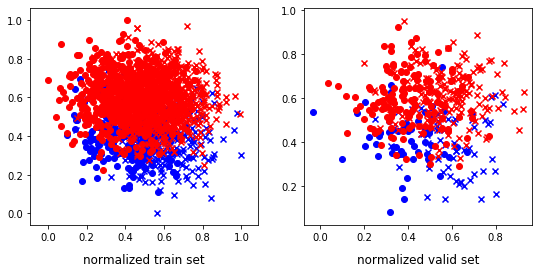

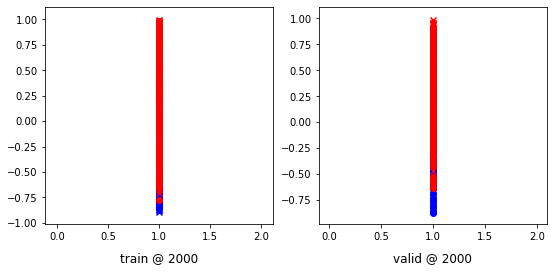

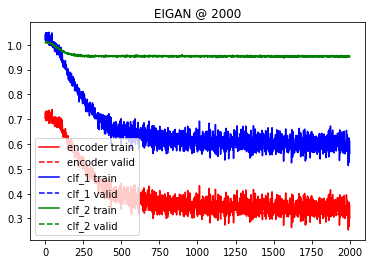

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:30, 22.15it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.02551396 	 -0.02951936 	 -0.07823950 	 -0.08332569 	 -0.02924293 	 -0.03196192


 25%|██▌       | 502/2001 [00:30<01:41, 14.79it/s]

500 	 -0.16907586 	 -0.16677073 	 -0.24422529 	 -0.24238695 	 -0.07408272 	 -0.07498402


 50%|█████     | 1004/2001 [01:02<00:55, 18.04it/s]

1000 	 -0.22976266 	 -0.22971153 	 -0.35058331 	 -0.34960687 	 -0.14759064 	 -0.14625905


 75%|███████▌  | 1504/2001 [01:32<00:27, 17.97it/s]

1500 	 -0.27674654 	 -0.27778408 	 -0.45668069 	 -0.45841947 	 -0.22418630 	 -0.22501223


100%|██████████| 2001/2001 [02:03<00:00, 16.17it/s]


2000 	 -0.29764658 	 -0.30941463 	 -0.56966603 	 -0.57962358 	 -0.32155481 	 -0.31981626


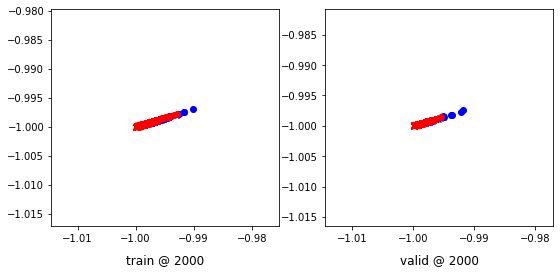

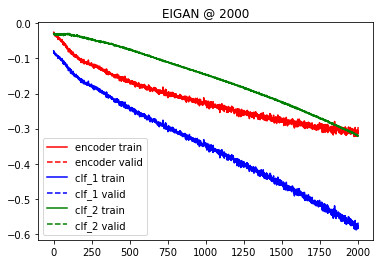

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.019269 	 1.018371 	 0.7288
200 	 0.695970 	 0.682481 	 0.8302
400 	 0.602208 	 0.571198 	 0.8255
600 	 0.600696 	 0.569598 	 0.8255
800 	 0.600528 	 0.569615 	 0.8255
1000 	 0.600396 	 0.569824 	 0.8255
Accuracy: 0.8254716981132075
Error Rate: 0.17452830188679244
F1 Score: 0.8794788273615635
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8066037735849056
Error Rate: 0.19339622641509435
F1 Score: 0.8600682593856654
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8301886792452831
Error Rate: 0.1

  0%|          | 4/2001 [00:00<00:52, 38.04it/s]

Accuracy: 0.6627358490566038
Error Rate: 0.33726415094339623
F1 Score: 0.6727688787185355
VAR1: 0.8, VAR2: 0.8, TRIAL: 3
X, y_1, y2
(1036, 2) (1036, 1) (1036, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(828, 2) (208, 2) (828, 1) (208, 1) (828, 1) (208, 1)
class weights => w1, w2 [1.844098   2.18469657] [1.84821429 2.17894737]
tensor sizes => torch.Size([828, 2]) torch.Size([208, 2]) torch.Size([828, 2]) torch.Size([208, 2]) torch.Size([828, 2]) torch.Size([208, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.71571541 	 0.71471584 	 1.09042478 	 1.09017730 	 1.06811905 	 1.06860864


 25%|██▌       | 505/2001 [00:16<00:45, 32.89it/s]

500 	 0.69236213 	 0.69206303 	 0.97964859 	 0.97917044 	 0.98045063 	 0.98025459


 50%|█████     | 1009/2001 [00:33<00:30, 32.14it/s]

1000 	 0.54446781 	 0.54609233 	 0.77933931 	 0.76915890 	 0.92802507 	 0.91621375


 75%|███████▌  | 1506/2001 [00:51<00:17, 27.75it/s]

1500 	 0.49568623 	 0.51208693 	 0.72323835 	 0.73128903 	 0.92075926 	 0.91234928


100%|██████████| 2001/2001 [01:08<00:00, 29.25it/s]


2000 	 0.48358637 	 0.51897448 	 0.71512723 	 0.73886871 	 0.92471939 	 0.91304141


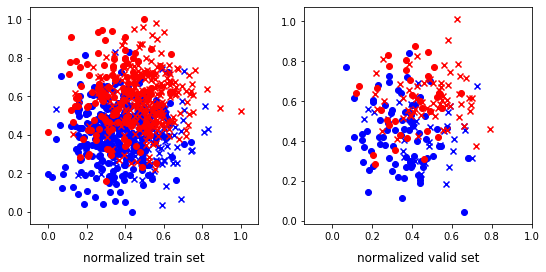

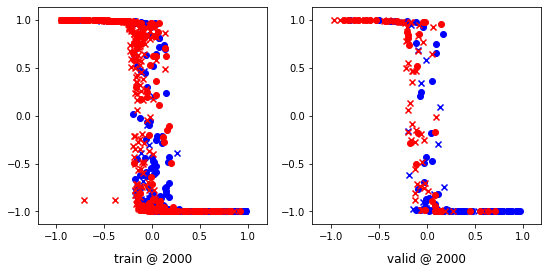

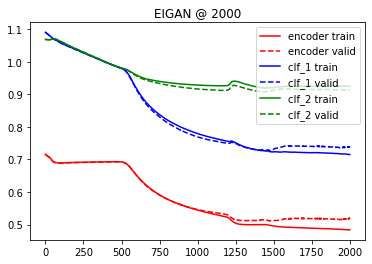

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:10, 28.28it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.10016640 	 0.10031770 	 0.04850132 	 0.04852594 	 -0.02718344 	 -0.02757801


 25%|██▌       | 504/2001 [00:15<00:51, 28.80it/s]

500 	 0.06689078 	 0.06693578 	 0.00755613 	 0.00744811 	 -0.04354228 	 -0.04390094


 50%|█████     | 1005/2001 [00:31<00:32, 30.47it/s]

1000 	 0.03664737 	 0.03668645 	 -0.03210932 	 -0.03224931 	 -0.06220926 	 -0.06255621


 75%|███████▌  | 1503/2001 [00:47<00:17, 29.01it/s]

1500 	 0.01536240 	 0.01539623 	 -0.06465418 	 -0.06479759 	 -0.08287063 	 -0.08318511


100%|██████████| 2001/2001 [01:03<00:00, 31.28it/s]


2000 	 -0.01668192 	 -0.01673149 	 -0.10647087 	 -0.10667709 	 -0.09961973 	 -0.09990933


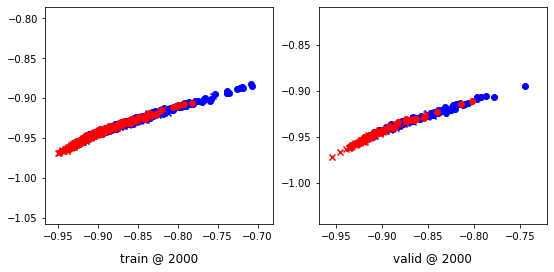

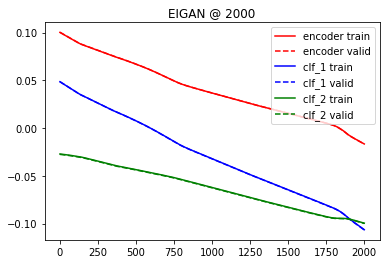

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.036393 	 1.036335 	 0.4567
200 	 0.779448 	 0.779839 	 0.7644
400 	 0.708648 	 0.702724 	 0.7500
600 	 0.706639 	 0.702150 	 0.7500
800 	 0.704911 	 0.701958 	 0.7548
1000 	 0.703549 	 0.700730 	 0.7596
Accuracy: 0.7596153846153846
Error Rate: 0.2403846153846154
F1 Score: 0.7500000000000001
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7644230769230769
Error Rate: 0.23557692307692307
F1 Score: 0.7655502392344496
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7644230769230769
Error Rate: 0.23

  0%|          | 2/2001 [00:00<01:53, 17.56it/s]

tensor sizes => torch.Size([1785, 2]) torch.Size([447, 2]) torch.Size([1785, 2]) torch.Size([447, 2]) torch.Size([1785, 2]) torch.Size([447, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.74092376 	 0.73524010 	 1.07525074 	 1.07788849 	 1.02761877 	 1.03579557


 25%|██▌       | 504/2001 [00:33<01:42, 14.57it/s]

500 	 0.16382295 	 0.15851113 	 0.35731384 	 0.35678378 	 0.88663018 	 0.89141983


 50%|█████     | 1004/2001 [01:06<01:07, 14.69it/s]

1000 	 -0.08015144 	 -0.09513463 	 0.10049779 	 0.09317605 	 0.87382400 	 0.88145787


 75%|███████▌  | 1502/2001 [01:39<00:35, 14.16it/s]

1500 	 -0.11956815 	 -0.15730481 	 0.05443765 	 0.03135492 	 0.86719549 	 0.88180691


100%|██████████| 2001/2001 [02:12<00:00, 15.09it/s]


2000 	 -0.13044544 	 -0.17222221 	 0.04090751 	 0.01620137 	 0.86449438 	 0.88157076


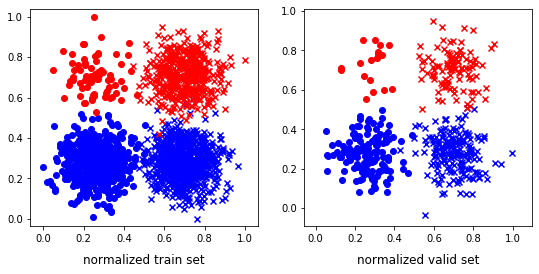

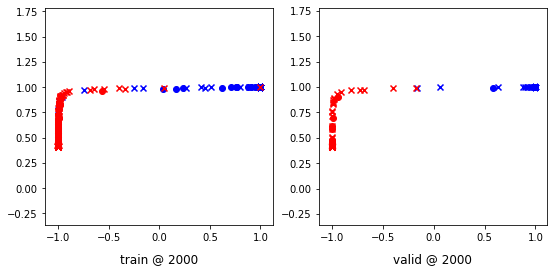

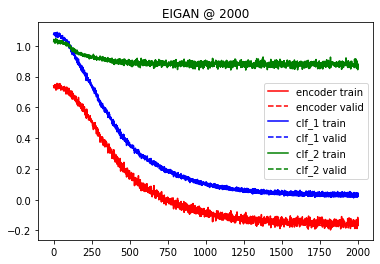

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 1/2001 [00:00<03:39,  9.13it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.03215612 	 0.03202379 	 -0.02203825 	 -0.02221361 	 -0.03265891 	 -0.03288924


 25%|██▌       | 503/2001 [00:31<01:28, 16.84it/s]

500 	 -0.04412816 	 -0.04351119 	 -0.09202211 	 -0.09142609 	 -0.01884052 	 -0.01889474


 50%|█████     | 1003/2001 [01:02<00:56, 17.80it/s]

1000 	 -0.08904365 	 -0.08986153 	 -0.16585314 	 -0.16657686 	 -0.07714150 	 -0.07697532


 75%|███████▌  | 1504/2001 [01:34<00:26, 18.83it/s]

1500 	 -0.13652039 	 -0.13610585 	 -0.25461900 	 -0.25547412 	 -0.14365447 	 -0.14549711


100%|██████████| 2001/2001 [02:05<00:00, 15.93it/s]


2000 	 -0.18634763 	 -0.18624036 	 -0.30711699 	 -0.30922848 	 -0.14749691 	 -0.15069662


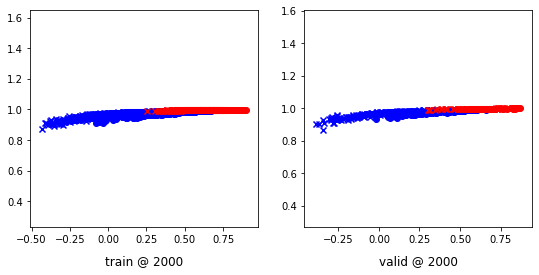

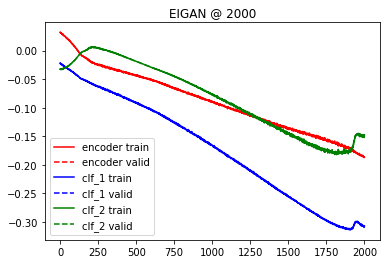

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.071567 	 1.072096 	 0.2796
200 	 0.377827 	 0.381423 	 0.9933
400 	 0.072697 	 0.076205 	 0.9933
600 	 0.040537 	 0.041992 	 0.9933
800 	 0.031763 	 0.031358 	 0.9933
1000 	 0.028307 	 0.026433 	 0.9933
Accuracy: 0.9932885906040269
Error Rate: 0.006711409395973154
F1 Score: 0.9880478087649401
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9955257270693513
Error Rate: 0.0044742729306487695
F1 Score: 0.9920634920634921
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9932885906040269
Error Rate: 

  0%|          | 2/2001 [00:00<01:57, 16.96it/s]

Accuracy: 0.8523489932885906
Error Rate: 0.1476510067114094
F1 Score: 0.8907284768211919
VAR1: 0.2, VAR2: 0.4, TRIAL: 4
X, y_1, y2
(1570, 2) (1570, 1) (1570, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1256, 2) (314, 2) (1256, 1) (314, 1) (1256, 1) (314, 1)
class weights => w1, w2 [2.71861472 1.58186398] [1.89441931 2.11804384]
tensor sizes => torch.Size([1256, 2]) torch.Size([314, 2]) torch.Size([1256, 2]) torch.Size([314, 2]) torch.Size([1256, 2]) torch.Size([314, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.73158729 	 0.72501612 	 1.05592620 	 1.05075133 	 1.01777923 	 1.01888239


 25%|██▌       | 504/2001 [00:29<01:30, 16.47it/s]

500 	 0.67421365 	 0.68070322 	 0.93725181 	 0.94212645 	 0.95618534 	 0.95457041


 50%|█████     | 1003/2001 [00:58<00:58, 17.12it/s]

1000 	 0.69690186 	 0.68054330 	 0.95771712 	 0.94196016 	 0.95396245 	 0.95456403


 75%|███████▌  | 1504/2001 [01:28<00:30, 16.31it/s]

1500 	 0.69728535 	 0.68058074 	 0.96014512 	 0.94196683 	 0.95600694 	 0.95453328


100%|██████████| 2001/2001 [01:57<00:00, 17.06it/s]


2000 	 0.24161974 	 0.23990270 	 0.38562074 	 0.38913730 	 0.83770764 	 0.84238178


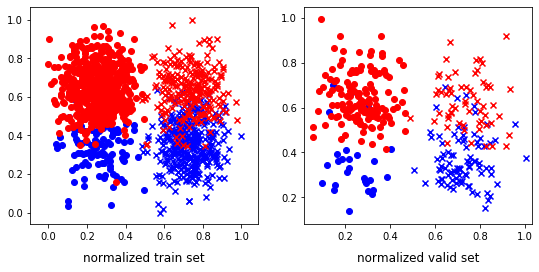

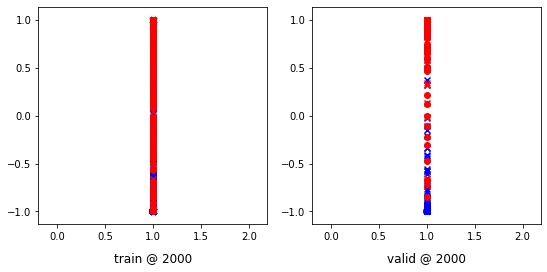

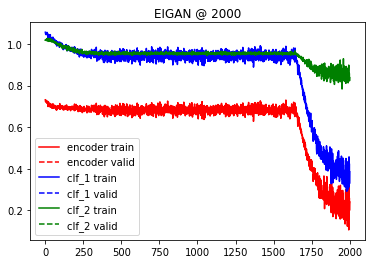

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:33, 21.27it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.01411751 	 0.01484423 	 -0.00779639 	 -0.00704131 	 0.05209895 	 0.05206239


 25%|██▌       | 503/2001 [00:28<01:27, 17.13it/s]

500 	 -0.08853294 	 -0.08915341 	 -0.12076197 	 -0.12176514 	 0.02050871 	 0.01941281


 50%|█████     | 1004/2001 [00:57<00:57, 17.21it/s]

1000 	 -0.17401600 	 -0.17365594 	 -0.22513327 	 -0.22424971 	 -0.02608526 	 -0.02493057


 75%|███████▌  | 1503/2001 [01:26<00:27, 18.36it/s]

1500 	 -0.26811883 	 -0.26788157 	 -0.34468433 	 -0.34306350 	 -0.07670397 	 -0.07419321


100%|██████████| 2001/2001 [01:54<00:00, 17.45it/s]


2000 	 -0.37128592 	 -0.37801325 	 -0.47842109 	 -0.48616868 	 -0.12731488 	 -0.12886992


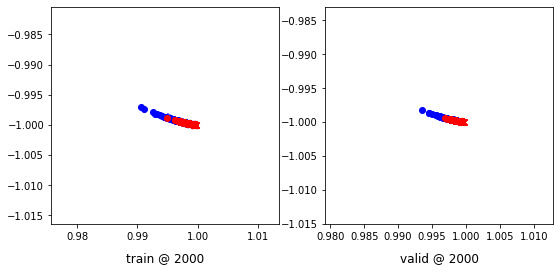

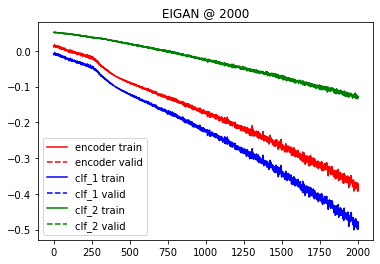

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.034336 	 1.034656 	 0.3662
200 	 0.540959 	 0.568367 	 0.8885
400 	 0.289547 	 0.367794 	 0.9236
600 	 0.282478 	 0.376626 	 0.9236
800 	 0.281544 	 0.377944 	 0.9236
1000 	 0.280666 	 0.379052 	 0.9236
Accuracy: 0.9235668789808917
Error Rate: 0.07643312101910828
F1 Score: 0.9390862944162437
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.910828025477707
Error Rate: 0.08917197452229299
F1 Score: 0.9282051282051282
SVM
--------------------------------------------------------------------------------
Accuracy: 0.910828025477707
Error Rate: 0.089

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.5254777070063694
Error Rate: 0.4745222929936306
F1 Score: 0.0
VAR1: 0.2, VAR2: 0.6, TRIAL: 4
X, y_1, y2
(2049, 2) (2049, 1) (2049, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1639, 2) (410, 2) (1639, 1) (410, 1) (1639, 1) (410, 1)
class weights => w1, w2 [1.33905229 3.94939759] [2.03349876 1.96758703]
tensor sizes => torch.Size([1639, 2]) torch.Size([410, 2]) torch.Size([1639, 2]) torch.Size([410, 2]) torch.Size([1639, 2]) torch.Size([410, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.68842912 	 0.67751634 	 1.04543757 	 1.03857744 	 1.05036819 	 1.05420828


 25%|██▌       | 503/2001 [00:32<01:48, 13.80it/s]

500 	 0.43893903 	 0.39836723 	 0.70146304 	 0.65960234 	 0.95612317 	 0.95438230


 50%|█████     | 1003/2001 [01:05<01:08, 14.53it/s]

1000 	 0.36574352 	 0.31615931 	 0.62596464 	 0.57594419 	 0.95337617 	 0.95293206


 75%|███████▌  | 1504/2001 [01:37<00:31, 15.79it/s]

1500 	 0.33271140 	 0.30131447 	 0.59457767 	 0.56084168 	 0.95502412 	 0.95267439


100%|██████████| 2001/2001 [02:08<00:00, 15.53it/s]


2000 	 0.36122751 	 0.29562438 	 0.62164658 	 0.55520028 	 0.95509773 	 0.95272309


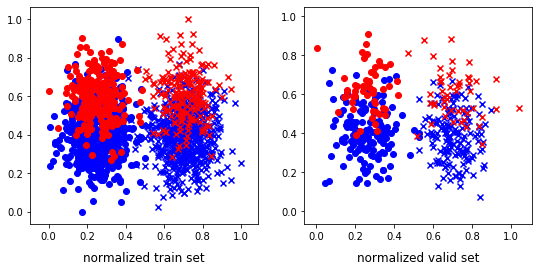

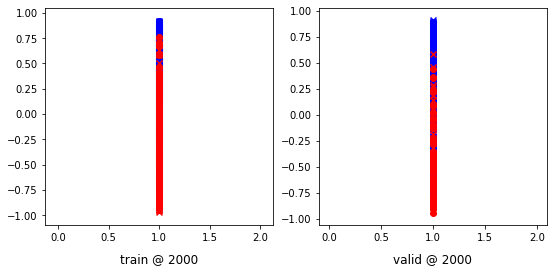

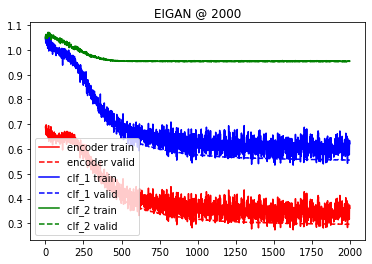

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:29, 22.37it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.09916396 	 -0.09994806 	 -0.13573961 	 -0.13722484 	 0.00877383 	 0.00692806


 25%|██▌       | 504/2001 [00:31<01:22, 18.15it/s]

500 	 -0.21220133 	 -0.21251221 	 -0.25561419 	 -0.25581962 	 -0.00780327 	 -0.00810431


 50%|█████     | 1004/2001 [01:02<00:54, 18.36it/s]

1000 	 -0.39197820 	 -0.38675678 	 -0.46621767 	 -0.46026656 	 -0.07246532 	 -0.07112690


 75%|███████▌  | 1503/2001 [01:33<00:33, 15.06it/s]

1500 	 -0.55247545 	 -0.54809666 	 -0.65552253 	 -0.65168911 	 -0.12100883 	 -0.12185778


100%|██████████| 2001/2001 [02:03<00:00, 16.17it/s]


2000 	 -0.73216772 	 -0.72903335 	 -0.87420601 	 -0.86980367 	 -0.17687944 	 -0.17519368


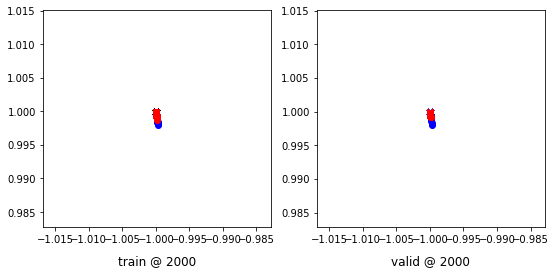

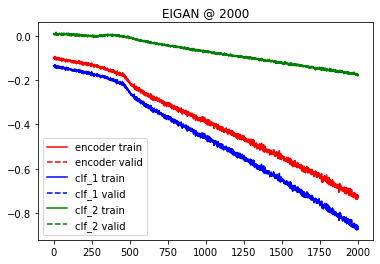

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.008634 	 1.009068 	 0.7415
200 	 0.784921 	 0.768820 	 0.8000
400 	 0.610502 	 0.559124 	 0.8195
600 	 0.605593 	 0.552273 	 0.8171
800 	 0.605169 	 0.551736 	 0.8171
1000 	 0.604983 	 0.551556 	 0.8171
Accuracy: 0.8170731707317073
Error Rate: 0.18292682926829268
F1 Score: 0.6575342465753424
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.802439024390244
Error Rate: 0.1975609756097561
F1 Score: 0.6798418972332017
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8219512195121951
Error Rate: 0.178

  0%|          | 3/2001 [00:00<01:18, 25.38it/s]

Accuracy: 0.5073170731707317
Error Rate: 0.4926829268292683
F1 Score: 0.6731391585760518
VAR1: 0.2, VAR2: 0.8, TRIAL: 4
X, y_1, y2
(1483, 2) (1483, 1) (1483, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1186, 2) (297, 2) (1186, 1) (297, 1) (1186, 1) (297, 1)
class weights => w1, w2 [2.05545927 1.94745484] [2.04835924 1.9538715 ]
tensor sizes => torch.Size([1186, 2]) torch.Size([297, 2]) torch.Size([1186, 2]) torch.Size([297, 2]) torch.Size([1186, 2]) torch.Size([297, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.72704637 	 0.73495936 	 1.06833267 	 1.07702661 	 1.03468752 	 1.03521442


 25%|██▌       | 503/2001 [00:28<01:28, 16.94it/s]

500 	 0.53786922 	 0.51672047 	 0.78724933 	 0.76366562 	 0.94424099 	 0.94009233


 50%|█████     | 1003/2001 [00:57<00:56, 17.53it/s]

1000 	 0.49332654 	 0.47658354 	 0.74699908 	 0.72363418 	 0.94689190 	 0.94019783


 75%|███████▌  | 1504/2001 [01:26<00:24, 20.61it/s]

1500 	 0.49039042 	 0.47136450 	 0.75522202 	 0.71810114 	 0.95942539 	 0.93988383


100%|██████████| 2001/2001 [01:55<00:00, 17.34it/s]


2000 	 0.48601717 	 0.46508139 	 0.71607333 	 0.71103638 	 0.92317230 	 0.93910217


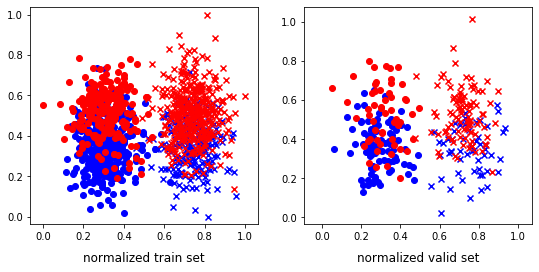

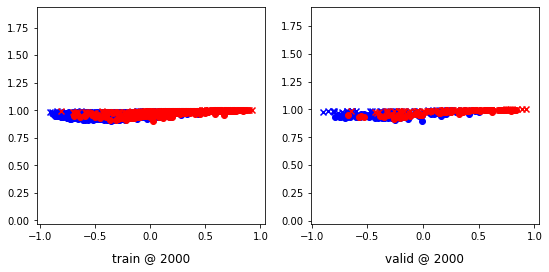

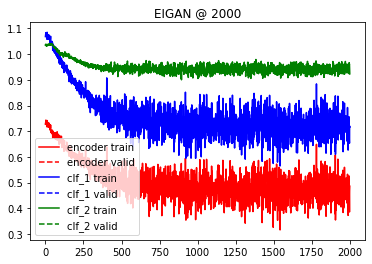

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:33, 21.29it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.10281014 	 0.08861445 	 0.04375783 	 0.03088582 	 -0.04297898 	 -0.04026782


 25%|██▌       | 504/2001 [00:27<01:24, 17.68it/s]

500 	 0.03580170 	 0.02948386 	 -0.02378383 	 -0.02996484 	 -0.04407069 	 -0.04382103


 50%|█████     | 1001/2001 [00:55<00:48, 20.75it/s]

1000 	 0.01095333 	 0.00543641 	 -0.07391523 	 -0.07691361 	 -0.09131562 	 -0.08696692


 75%|███████▌  | 1504/2001 [01:22<00:26, 18.99it/s]

1500 	 -0.03662321 	 -0.04118263 	 -0.16113032 	 -0.16188207 	 -0.15284856 	 -0.14741825


100%|██████████| 2001/2001 [01:50<00:00, 18.10it/s]


2000 	 -0.07747774 	 -0.07807806 	 -0.24581641 	 -0.24276964 	 -0.21028811 	 -0.20582210


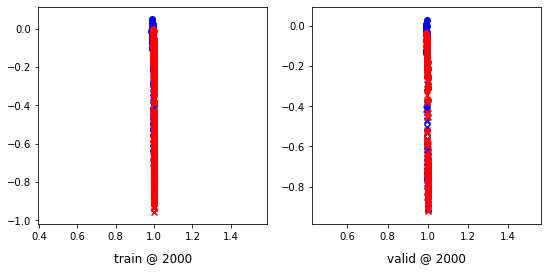

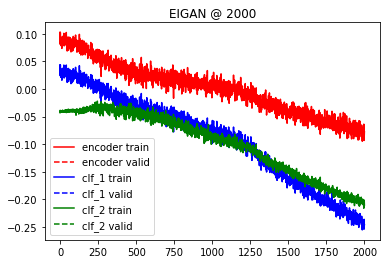

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.007833 	 1.007884 	 0.4848
200 	 0.730747 	 0.725125 	 0.7744
400 	 0.682658 	 0.678720 	 0.7609
600 	 0.682125 	 0.678003 	 0.7609
800 	 0.681850 	 0.677604 	 0.7609
1000 	 0.681144 	 0.676101 	 0.7643
Accuracy: 0.7643097643097643
Error Rate: 0.2356902356902357
F1 Score: 0.7741935483870966
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7676767676767676
Error Rate: 0.23232323232323232
F1 Score: 0.7737704918032787
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7744107744107744
Error Rate: 0.22

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.054326 	 0.059403 	 0.9865
Accuracy: 0.9865319865319865
Error Rate: 0.013468013468013467
F1 Score: 0.9867549668874172
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.98989898989899
Error Rate: 0.010101010101010102
F1 Score: 0.9900332225913622
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9865319865319865
Error Rate: 0.013468013468013467
F1 Score: 0.9867549668874172
VAR1: 0.4, VAR2: 0.2, TRIAL: 4
X, y_1, y2
(2191, 2) (2191, 1) (2191, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1752, 2) (439, 2) (1752, 1) (439, 1) (1752, 1) (439, 1)
class weights => w1, w2 [1.56989247 2.75471698] [2.76340694 1.56708408]
tensor sizes => torch.Size([1752, 2]) torch.Size([439, 2]) torch.Size([1752, 2]) torch.Size([439, 2]) torch.Size([1752, 2]) torch.Size([439, 2])
--------------------------------------------------------------------------------
EIGAN Training
----

 25%|██▌       | 503/2001 [00:32<01:33, 16.05it/s]

500 	 0.12172601 	 0.10969335 	 0.32802761 	 0.31558383 	 0.89952862 	 0.89903766


 50%|█████     | 1002/2001 [01:05<01:15, 13.23it/s]

1000 	 -0.10650528 	 -0.12504296 	 0.07677923 	 0.05647232 	 0.87645185 	 0.87466246


 75%|███████▌  | 1503/2001 [01:38<00:34, 14.63it/s]

1500 	 -0.13774350 	 -0.15312360 	 0.04588049 	 0.02995058 	 0.87674379 	 0.87622136


100%|██████████| 2001/2001 [02:12<00:00, 15.12it/s]


2000 	 -0.15846479 	 -0.16109672 	 0.01637726 	 0.02244993 	 0.86804521 	 0.87669384


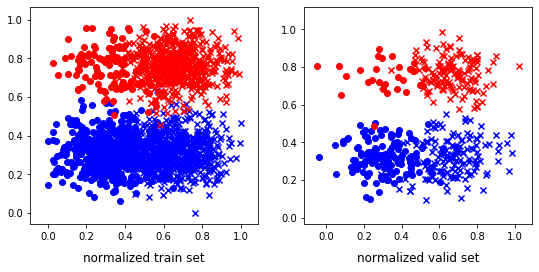

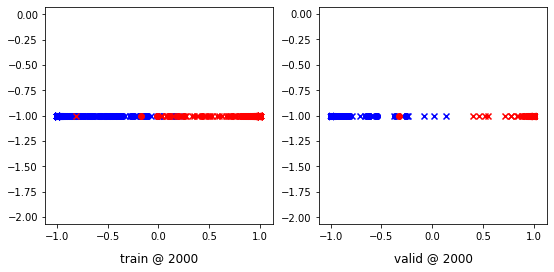

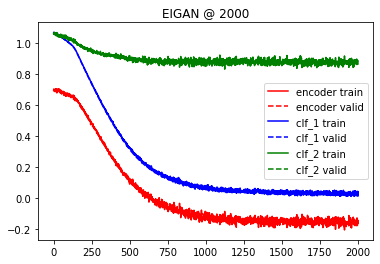

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:41, 19.78it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.00913875 	 0.00789638 	 -0.03123394 	 -0.03247708 	 -0.00088275 	 -0.00093149


 25%|██▌       | 503/2001 [00:31<01:38, 15.17it/s]

500 	 -0.07662305 	 -0.07677177 	 -0.14415704 	 -0.14426014 	 -0.05985104 	 -0.05978524


 50%|█████     | 1002/2001 [01:02<01:01, 16.36it/s]

1000 	 -0.15380639 	 -0.15518770 	 -0.24665006 	 -0.24696821 	 -0.10470147 	 -0.10295302


 75%|███████▌  | 1502/2001 [01:34<00:32, 15.43it/s]

1500 	 -0.24525546 	 -0.24435140 	 -0.36728963 	 -0.36700380 	 -0.14933363 	 -0.15021764


100%|██████████| 2001/2001 [02:05<00:00, 15.94it/s]


2000 	 -0.35032579 	 -0.34786636 	 -0.51196235 	 -0.51164758 	 -0.20204046 	 -0.20469892


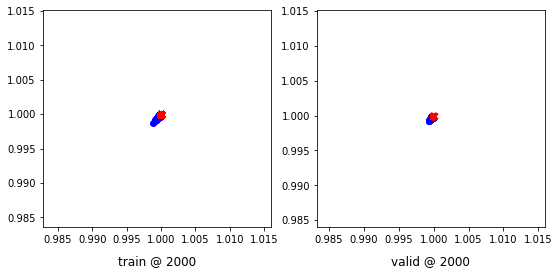

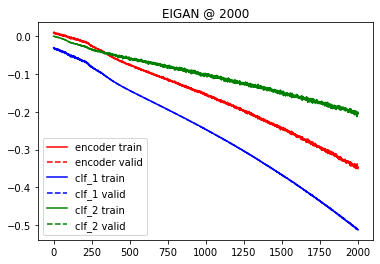

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.049675 	 1.050329 	 0.6355
200 	 0.317588 	 0.314020 	 0.9977
400 	 0.070110 	 0.061489 	 0.9954
600 	 0.045434 	 0.036401 	 0.9954
800 	 0.036850 	 0.028337 	 0.9954
1000 	 0.034433 	 0.026336 	 0.9954
Accuracy: 0.9954441913439636
Error Rate: 0.004555808656036446
F1 Score: 0.99375
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9931662870159453
Error Rate: 0.00683371298405467
F1 Score: 0.9906542056074766
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9954441913439636
Error Rate: 0.00455580865

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.8200455580865603
Error Rate: 0.17995444191343962
F1 Score: 0.8626086956521738
VAR1: 0.4, VAR2: 0.4, TRIAL: 4
X, y_1, y2
(1695, 2) (1695, 1) (1695, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1356, 2) (339, 2) (1356, 1) (339, 1) (1356, 1) (339, 1)
class weights => w1, w2 [1.1884312  6.30697674] [2.46545455 1.68238213]
tensor sizes => torch.Size([1356, 2]) torch.Size([339, 2]) torch.Size([1356, 2]) torch.Size([339, 2]) torch.Size([1356, 2]) torch.Size([339, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.74396771 	 0.73961902 	 1.04960978 	 1.05385697 	 0.99912983 	 1.00738513


 25%|██▌       | 503/2001 [00:30<01:35, 15.68it/s]

500 	 0.35140640 	 0.34960055 	 0.58801734 	 0.56646711 	 0.93016839 	 0.91001374


 50%|█████     | 1003/2001 [01:00<01:01, 16.22it/s]

1000 	 0.10332534 	 0.14265296 	 0.29926735 	 0.33796278 	 0.88921213 	 0.88845700


 75%|███████▌  | 1503/2001 [01:30<00:32, 15.24it/s]

1500 	 0.05124769 	 0.08966696 	 0.27716598 	 0.27414107 	 0.91970932 	 0.87762129


100%|██████████| 2001/2001 [01:59<00:00, 16.72it/s]


2000 	 -0.02620140 	 0.08415279 	 0.19064875 	 0.26430807 	 0.91048676 	 0.87330246


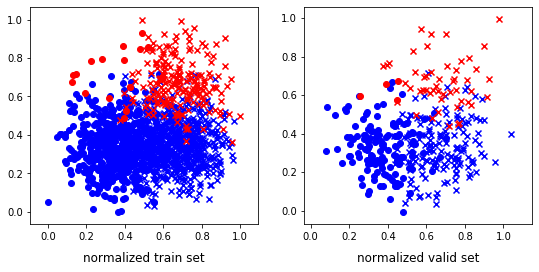

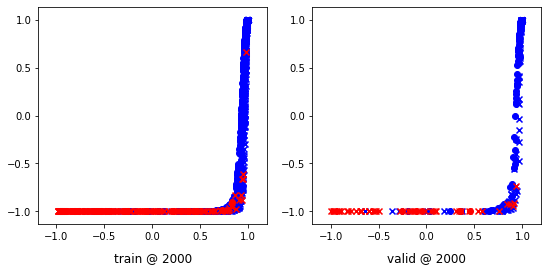

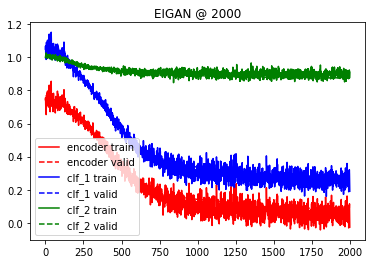

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:26, 23.02it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.07171169 	 0.07052456 	 0.04437859 	 0.04435425 	 0.03482899 	 0.03822759


 25%|██▌       | 503/2001 [00:28<01:26, 17.36it/s]

500 	 0.01670972 	 0.01468326 	 -0.02419999 	 -0.02516794 	 -0.00224334 	 0.00037234


 50%|█████     | 1004/2001 [00:57<00:56, 17.54it/s]

1000 	 -0.01813694 	 -0.01657763 	 -0.07724585 	 -0.07613411 	 -0.04311682 	 -0.04404195


 75%|███████▌  | 1504/2001 [01:26<00:31, 15.62it/s]

1500 	 -0.04205976 	 -0.04115819 	 -0.13024449 	 -0.13333762 	 -0.09695793 	 -0.10361064


100%|██████████| 2001/2001 [01:54<00:00, 17.44it/s]


2000 	 -0.05733889 	 -0.05735348 	 -0.18455479 	 -0.18750933 	 -0.15667200 	 -0.16077119


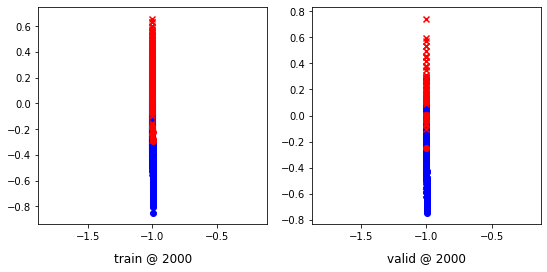

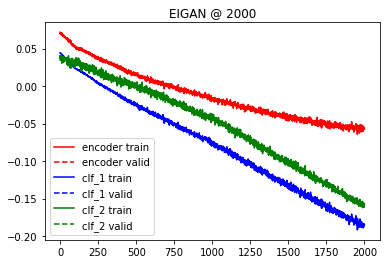

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.107699 	 1.109180 	 0.1593
200 	 0.755302 	 0.754363 	 0.8407
400 	 0.326487 	 0.327908 	 0.9351
600 	 0.251120 	 0.261755 	 0.9322
800 	 0.245972 	 0.259369 	 0.9322
1000 	 0.244980 	 0.259369 	 0.9322
Accuracy: 0.9321533923303835
Error Rate: 0.06784660766961652
F1 Score: 0.7964601769911505
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9085545722713865
Error Rate: 0.09144542772861357
F1 Score: 0.7596899224806202
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9380530973451328
Error Rate: 0.0

  0%|          | 2/2001 [00:00<02:07, 15.68it/s]

X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2119, 2) (530, 2) (2119, 1) (530, 1) (2119, 1) (530, 1)
class weights => w1, w2 [1.58607784 2.70625798] [2.96778711 1.50818505]
tensor sizes => torch.Size([2119, 2]) torch.Size([530, 2]) torch.Size([2119, 2]) torch.Size([530, 2]) torch.Size([2119, 2]) torch.Size([530, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.70299220 	 0.68935990 	 1.01003027 	 1.03981829 	 1.00034773 	 1.04360557


 25%|██▌       | 501/2001 [00:46<02:21, 10.61it/s]

500 	 0.76759535 	 0.70082814 	 0.95802432 	 0.94340867 	 0.88357615 	 0.93572772


 50%|█████     | 1001/2001 [01:30<01:35, 10.51it/s]

1000 	 0.69952321 	 0.70082712 	 0.93279976 	 0.94341189 	 0.92642373 	 0.93573195


 75%|███████▌  | 1503/2001 [02:15<00:44, 11.31it/s]

1500 	 0.77072835 	 0.70069194 	 0.93287927 	 0.94340605 	 0.85529810 	 0.93586129


100%|██████████| 2001/2001 [03:01<00:00, 11.00it/s]

2000 	 0.68647391 	 0.70079041 	 0.94123751 	 0.94341928 	 0.94791079 	 0.93577605


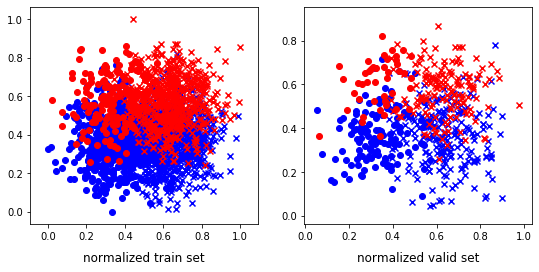

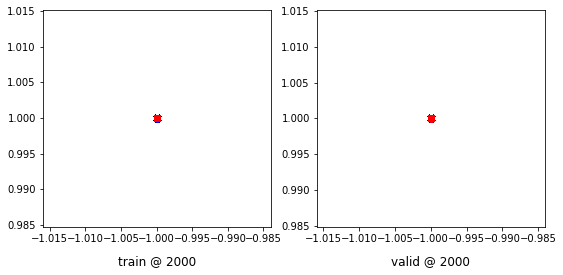

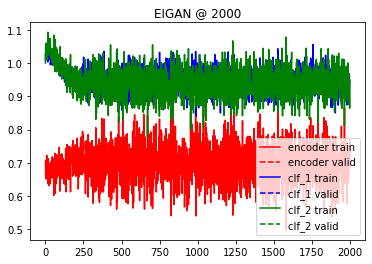

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:29, 13.35it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.05285370 	 0.04640511 	 0.01073949 	 0.00985474 	 -0.00514572 	 0.00881848


 25%|██▌       | 503/2001 [00:44<02:08, 11.68it/s]

500 	 -0.10576606 	 -0.11616676 	 -0.19072358 	 -0.20149265 	 -0.09146781 	 -0.09210598


 50%|█████     | 1002/2001 [01:28<01:38, 10.11it/s]

1000 	 -0.23675601 	 -0.23503479 	 -0.38815761 	 -0.38016272 	 -0.18910341 	 -0.18095660


 75%|███████▌  | 1502/2001 [02:13<00:39, 12.53it/s]

1500 	 -0.34727246 	 -0.35408714 	 -0.55701232 	 -0.59409493 	 -0.25797370 	 -0.28990588


100%|██████████| 2001/2001 [02:58<00:00, 11.23it/s]


2000 	 -0.40881655 	 -0.45600906 	 -0.81625926 	 -0.84960562 	 -0.43831238 	 -0.42737272


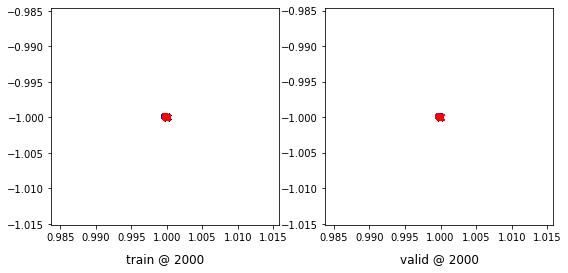

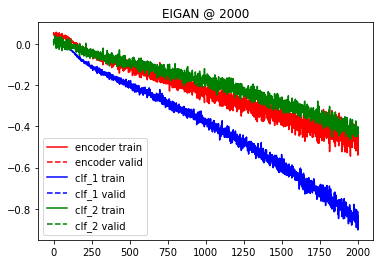

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.037561 	 1.037528 	 0.5302
200 	 0.693440 	 0.670461 	 0.8453
400 	 0.597981 	 0.547463 	 0.8302
600 	 0.596248 	 0.544681 	 0.8321
800 	 0.595911 	 0.544215 	 0.8321
1000 	 0.595833 	 0.544073 	 0.8302
Accuracy: 0.8301886792452831
Error Rate: 0.16981132075471697
F1 Score: 0.7761194029850746
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8207547169811321
Error Rate: 0.1792452830188679
F1 Score: 0.7732696897374702
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8358490566037736
Error Rate: 0.16

  0%|          | 2/2001 [00:00<02:03, 16.17it/s]

Accuracy: 0.6641509433962264
Error Rate: 0.33584905660377357
F1 Score: 0.7981859410430839
VAR1: 0.4, VAR2: 0.8, TRIAL: 4
X, y_1, y2
(2718, 2) (2718, 1) (2718, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2174, 2) (544, 2) (2174, 1) (544, 1) (2174, 1) (544, 1)
class weights => w1, w2 [2.02420857 1.97636364] [2.13346418 1.88225108]
tensor sizes => torch.Size([2174, 2]) torch.Size([544, 2]) torch.Size([2174, 2]) torch.Size([544, 2]) torch.Size([2174, 2]) torch.Size([544, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.68766749 	 0.70183372 	 1.03111827 	 1.03041279 	 1.03706300 	 1.02172625


 25%|██▌       | 502/2001 [00:44<02:07, 11.74it/s]

500 	 0.46540350 	 0.53266025 	 0.66695404 	 0.75272244 	 0.89493811 	 0.91320938


 50%|█████     | 1003/2001 [01:31<01:31, 10.95it/s]

1000 	 0.56759459 	 0.51943034 	 0.80354702 	 0.73630410 	 0.93051171 	 0.91002095


 75%|███████▌  | 1503/2001 [02:19<00:49,  9.99it/s]

1500 	 0.44593227 	 0.51699829 	 0.66349781 	 0.73698002 	 0.91028249 	 0.91312891


100%|██████████| 2001/2001 [03:05<00:00, 10.81it/s]


2000 	 0.45223296 	 0.51767546 	 0.68948752 	 0.73614734 	 0.93065542 	 0.91161907


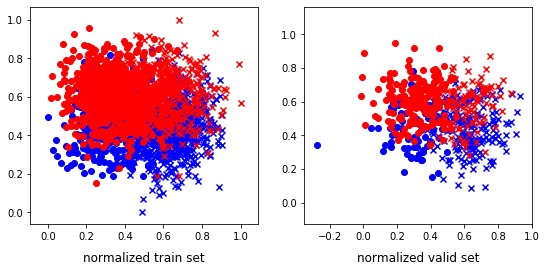

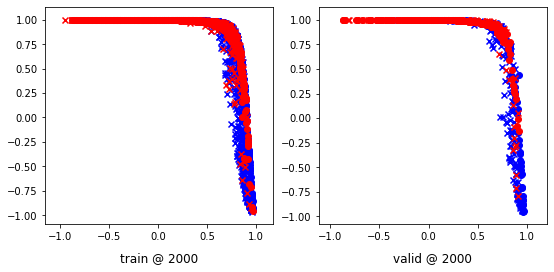

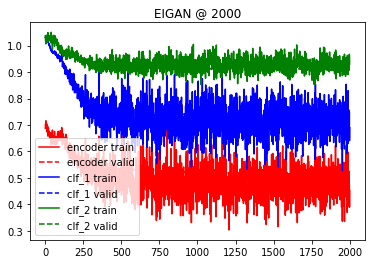

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:34, 12.94it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.05035629 	 0.05093760 	 -0.01892478 	 -0.01918887 	 -0.06316923 	 -0.06481401


 25%|██▌       | 501/2001 [00:45<02:03, 12.15it/s]

500 	 -0.04993051 	 -0.04788259 	 -0.19114591 	 -0.18401471 	 -0.17570879 	 -0.16896085


 50%|█████     | 1003/2001 [01:31<01:23, 11.95it/s]

1000 	 -0.13630646 	 -0.13655990 	 -0.39288530 	 -0.38995284 	 -0.30653572 	 -0.30338147


 75%|███████▌  | 1501/2001 [02:15<00:49, 10.05it/s]

1500 	 -0.20988977 	 -0.20492283 	 -0.67092800 	 -0.66365099 	 -0.47899798 	 -0.47729471


100%|██████████| 2001/2001 [03:01<00:00, 11.03it/s]


2000 	 -0.20569962 	 -0.20000619 	 -0.96660489 	 -0.96154249 	 -0.67229867 	 -0.67266047


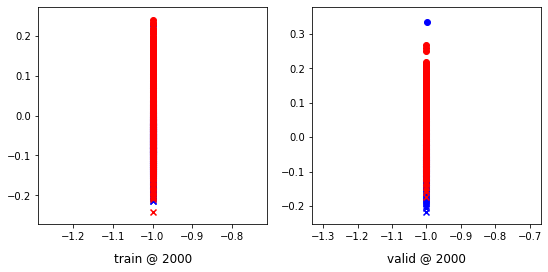

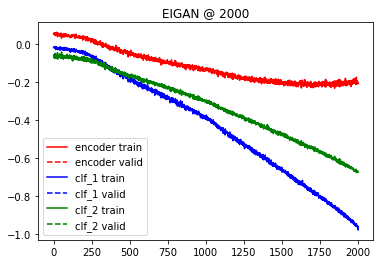

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.083426 	 1.083185 	 0.4945
200 	 0.753117 	 0.763940 	 0.7316
400 	 0.684156 	 0.708577 	 0.7371
600 	 0.683502 	 0.709674 	 0.7371
800 	 0.683272 	 0.710109 	 0.7371
1000 	 0.683038 	 0.710602 	 0.7353
Accuracy: 0.7352941176470589
Error Rate: 0.2647058823529412
F1 Score: 0.7428571428571429
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7389705882352942
Error Rate: 0.2610294117647059
F1 Score: 0.7464285714285716
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7426470588235294
Error Rate: 0.257

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.9117647058823529
Error Rate: 0.08823529411764706
F1 Score: 0.9163763066202091
VAR1: 0.6, VAR2: 0.2, TRIAL: 4
X, y_1, y2
(2214, 2) (2214, 1) (2214, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1771, 2) (443, 2) (1771, 1) (443, 1) (1771, 1) (443, 1)
class weights => w1, w2 [2.11336516 1.89817792] [2.15450122 1.86617492]
tensor sizes => torch.Size([1771, 2]) torch.Size([443, 2]) torch.Size([1771, 2]) torch.Size([443, 2]) torch.Size([1771, 2]) torch.Size([443, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.75863230 	 0.75691497 	 1.07258773 	 1.06957626 	 1.00735319 	 1.00580847


 25%|██▌       | 503/2001 [00:33<01:43, 14.47it/s]

500 	 0.06839523 	 0.06627126 	 0.25270253 	 0.24333932 	 0.87741786 	 0.87021524


 50%|█████     | 1003/2001 [01:07<01:06, 14.98it/s]

1000 	 -0.12348510 	 -0.12533858 	 0.07045824 	 0.05168209 	 0.88709706 	 0.87016785


 75%|███████▌  | 1503/2001 [01:40<00:33, 14.74it/s]

1500 	 -0.14539595 	 -0.14250909 	 0.03571481 	 0.03222842 	 0.87427670 	 0.86788470


100%|██████████| 2001/2001 [02:13<00:00, 14.98it/s]


2000 	 -0.10797890 	 -0.15178066 	 0.04345832 	 0.03208632 	 0.84454924 	 0.87701416


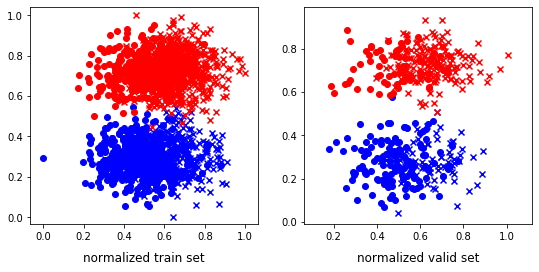

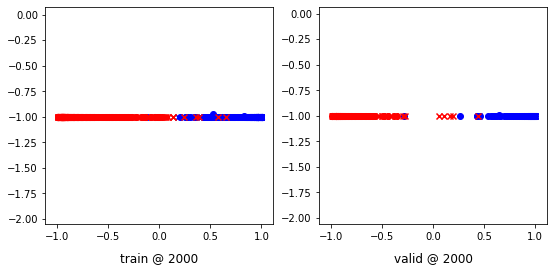

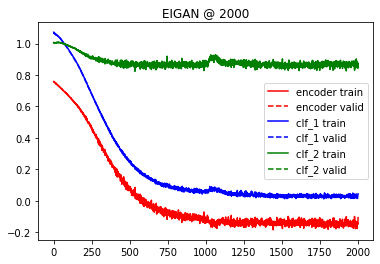

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:23, 23.93it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.08290738 	 0.08285174 	 0.01560101 	 0.01603722 	 -0.05935763 	 -0.05848504


 25%|██▌       | 503/2001 [00:31<01:31, 16.36it/s]

500 	 0.04446383 	 0.04764864 	 -0.04458842 	 -0.04145870 	 -0.09839171 	 -0.09850853


 50%|█████     | 1004/2001 [01:02<01:05, 15.14it/s]

1000 	 0.00400851 	 0.00100429 	 -0.12392580 	 -0.12743585 	 -0.15766071 	 -0.15838547


 75%|███████▌  | 1504/2001 [01:35<00:31, 15.89it/s]

1500 	 -0.03253148 	 -0.03094511 	 -0.20929579 	 -0.20906894 	 -0.22043104 	 -0.22204721


100%|██████████| 2001/2001 [02:07<00:00, 15.73it/s]


2000 	 -0.05139893 	 -0.05402523 	 -0.27166420 	 -0.27627093 	 -0.26932317 	 -0.27142942


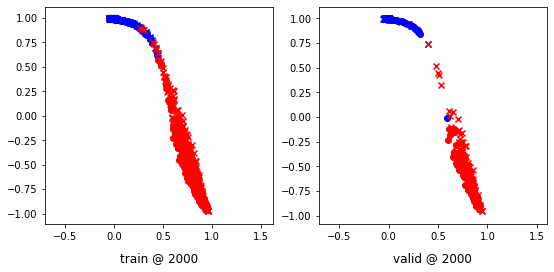

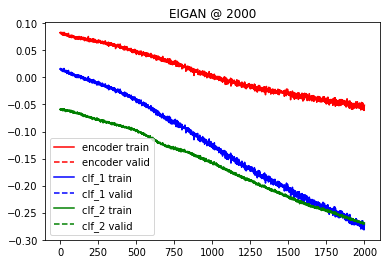

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.071064 	 1.071360 	 0.4718
200 	 0.589291 	 0.579088 	 0.9819
400 	 0.112617 	 0.099726 	 0.9955
600 	 0.050523 	 0.041276 	 0.9955
800 	 0.034938 	 0.027432 	 0.9955
1000 	 0.029549 	 0.022905 	 0.9955
Accuracy: 0.9954853273137697
Error Rate: 0.004514672686230248
F1 Score: 0.9957264957264957
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9954853273137697
Error Rate: 0.004514672686230248
F1 Score: 0.9957446808510638
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9954853273137697
Error Rate: 0

  0%|          | 4/2001 [00:00<00:50, 39.33it/s]

Accuracy: 0.6997742663656885
Error Rate: 0.3002257336343115
F1 Score: 0.7139784946236559
VAR1: 0.6, VAR2: 0.4, TRIAL: 4
X, y_1, y2
(1003, 2) (1003, 1) (1003, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(802, 2) (201, 2) (802, 1) (201, 1) (802, 1) (201, 1)
class weights => w1, w2 [2.84397163 1.54230769] [1.94660194 2.05641026]
tensor sizes => torch.Size([802, 2]) torch.Size([201, 2]) torch.Size([802, 2]) torch.Size([201, 2]) torch.Size([802, 2]) torch.Size([201, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.72806156 	 0.72855580 	 1.05918241 	 1.05947888 	 1.02447152 	 1.02407026


 25%|██▌       | 505/2001 [00:17<00:53, 27.91it/s]

500 	 0.53204411 	 0.51821071 	 0.79806149 	 0.78394967 	 0.95918691 	 0.95888615


 50%|█████     | 1004/2001 [00:33<00:38, 25.61it/s]

1000 	 0.26775366 	 0.21851575 	 0.52733582 	 0.47865659 	 0.95273137 	 0.95328802


 75%|███████▌  | 1506/2001 [00:49<00:16, 30.24it/s]

1500 	 0.17655021 	 0.09761176 	 0.43579870 	 0.35774192 	 0.95240313 	 0.95327735


100%|██████████| 2001/2001 [01:06<00:00, 30.26it/s]


2000 	 0.11823103 	 0.06638616 	 0.37827948 	 0.32613027 	 0.95319849 	 0.95289129


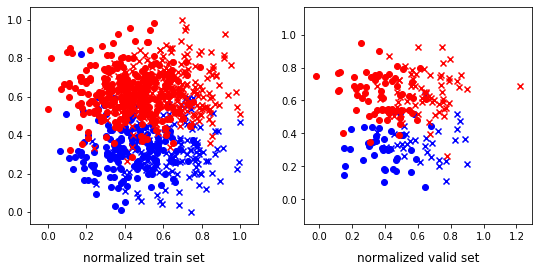

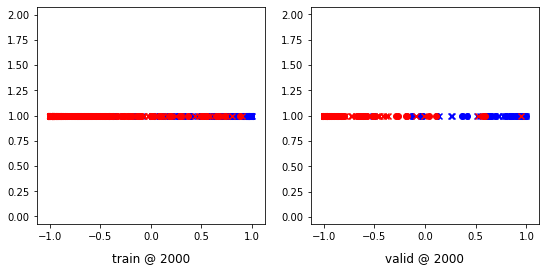

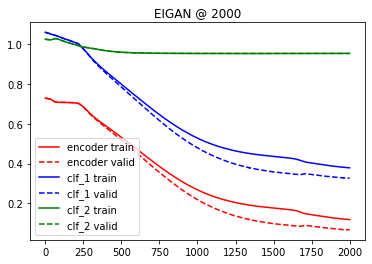

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 5/2001 [00:00<00:47, 42.35it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.06264723 	 0.06265888 	 -0.00296153 	 -0.00289703 	 -0.05603175 	 -0.05603888


 25%|██▌       | 506/2001 [00:15<00:45, 33.00it/s]

500 	 0.01850180 	 0.01866269 	 -0.05514887 	 -0.05507026 	 -0.07134467 	 -0.07153814


 50%|█████     | 1004/2001 [00:31<00:32, 30.94it/s]

1000 	 -0.00008833 	 0.00021523 	 -0.08778153 	 -0.08764116 	 -0.09612830 	 -0.09640579


 75%|███████▌  | 1505/2001 [00:47<00:16, 29.19it/s]

1500 	 -0.00966558 	 -0.00928932 	 -0.11719673 	 -0.11705080 	 -0.12791818 	 -0.12827045


100%|██████████| 2001/2001 [01:02<00:00, 31.88it/s]


2000 	 -0.01671088 	 -0.01638032 	 -0.14247428 	 -0.14247034 	 -0.15462624 	 -0.15509158


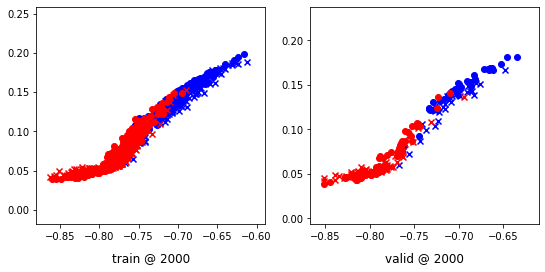

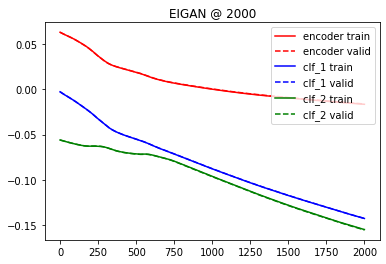

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.039110 	 1.041021 	 0.6468
200 	 0.550216 	 0.534405 	 0.9104
400 	 0.349909 	 0.299780 	 0.9453
600 	 0.346730 	 0.296763 	 0.9403
800 	 0.345859 	 0.297039 	 0.9403
1000 	 0.345132 	 0.297787 	 0.9403
Accuracy: 0.9402985074626866
Error Rate: 0.05970149253731343
F1 Score: 0.9538461538461539
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9353233830845771
Error Rate: 0.06467661691542288
F1 Score: 0.9494163424124514
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9353233830845771
Error Rate: 0.0

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.906831 	 0.907831 	 0.5920
Accuracy: 0.5920398009950248
Error Rate: 0.4079601990049751
F1 Score: 0.6203703703703703
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.5472636815920398
Error Rate: 0.4527363184079602
F1 Score: 0.5844748858447489
SVM
--------------------------------------------------------------------------------
Accuracy: 0.5920398009950248
Error Rate: 0.4079601990049751
F1 Score: 0.6019417475728156
VAR1: 0.6, VAR2: 0.6, TRIAL: 4
X, y_1, y2
(2568, 2) (2568, 1) (2568, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2054, 2) (514, 2) (2054, 1) (514, 1) (2054, 1) (514, 1)
class weights => w1, w2 [1.79859895 2.25219298] [2.69553806 1.58978328]
tensor sizes => torch.Size([2054, 2]) torch.Size([514, 2]) torch.Size([2054, 2]) torch.Size([514, 2]) torch.Size([2054, 2]) torch.Size([514, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------

  0%|          | 2/2001 [00:00<02:40, 12.44it/s]

0 	 0.72994101 	 0.62976575 	 1.08705091 	 0.99487257 	 1.05015445 	 1.05825400


 25%|██▌       | 503/2001 [00:46<02:17, 10.88it/s]

500 	 0.19049135 	 0.42283046 	 0.42133904 	 0.67112631 	 0.92251682 	 0.94144303


 50%|█████     | 1003/2001 [01:32<01:22, 12.03it/s]

1000 	 1.03050756 	 0.40299219 	 1.24136329 	 0.65330672 	 0.90847433 	 0.94346172


 75%|███████▌  | 1502/2001 [02:18<00:43, 11.55it/s]

1500 	 0.53023660 	 0.39274579 	 0.86873376 	 0.64447457 	 1.03402710 	 0.94487596


100%|██████████| 2001/2001 [03:03<00:00, 10.91it/s]


2000 	 0.21521378 	 0.38650197 	 0.40163550 	 0.63596934 	 0.88000524 	 0.94261456


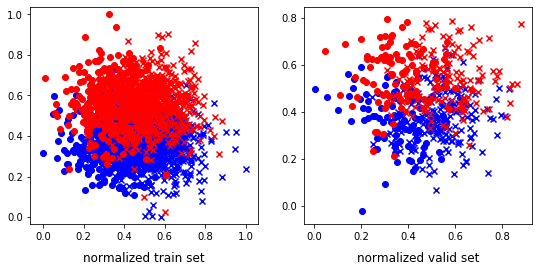

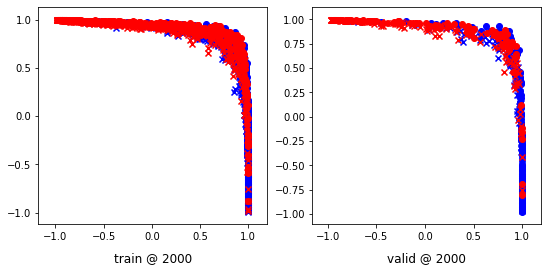

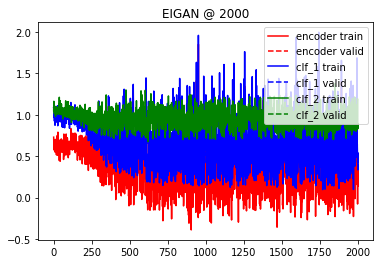

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:33, 13.05it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.01044480 	 -0.01188824 	 -0.02308267 	 -0.02396544 	 0.08758603 	 0.09010369


 25%|██▌       | 502/2001 [00:45<01:52, 13.33it/s]

500 	 -0.08686961 	 -0.09316379 	 -0.11828047 	 -0.12389718 	 0.02278319 	 0.02469059


 50%|█████     | 1002/2001 [01:30<01:26, 11.57it/s]

1000 	 -0.13422683 	 -0.14340624 	 -0.20216680 	 -0.20313931 	 -0.06064740 	 -0.04440347


 75%|███████▌  | 1502/2001 [02:15<00:46, 10.83it/s]

1500 	 -0.22618887 	 -0.23082541 	 -0.33162826 	 -0.33165970 	 -0.12471305 	 -0.11754417


100%|██████████| 2001/2001 [02:59<00:00, 11.12it/s]


2000 	 -0.30936286 	 -0.32786971 	 -0.49965829 	 -0.50700337 	 -0.23622856 	 -0.22324184


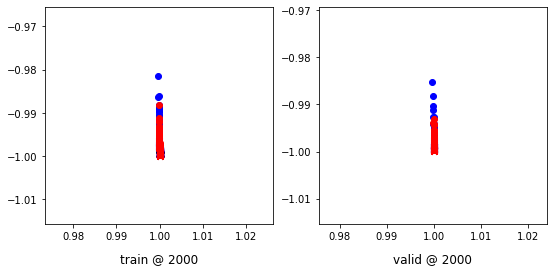

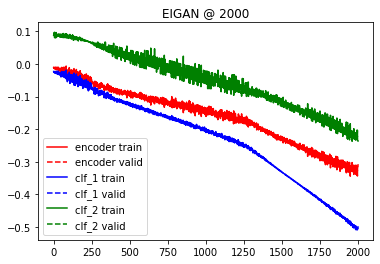

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.042182 	 1.042120 	 0.5564
200 	 0.700917 	 0.723487 	 0.7626
400 	 0.596103 	 0.638068 	 0.7665
600 	 0.595313 	 0.637984 	 0.7626
800 	 0.595022 	 0.637785 	 0.7626
1000 	 0.594874 	 0.637694 	 0.7626
Accuracy: 0.7626459143968871
Error Rate: 0.23735408560311283
F1 Score: 0.7288888888888888
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7587548638132295
Error Rate: 0.24124513618677043
F1 Score: 0.7292576419213973
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7568093385214008
Error Rate: 0.2

  0%|          | 3/2001 [00:00<01:28, 22.57it/s]

Accuracy: 0.6284046692607004
Error Rate: 0.3715953307392996
F1 Score: 0.7718040621266428
VAR1: 0.6, VAR2: 0.8, TRIAL: 4
X, y_1, y2
(1971, 2) (1971, 1) (1971, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1576, 2) (395, 2) (1576, 1) (395, 1) (1576, 1) (395, 1)
class weights => w1, w2 [2.08465608 1.92195122] [1.6147541  2.62666667]
tensor sizes => torch.Size([1576, 2]) torch.Size([395, 2]) torch.Size([1576, 2]) torch.Size([395, 2]) torch.Size([1576, 2]) torch.Size([395, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.73876214 	 0.74156153 	 1.06171501 	 1.06357574 	 1.01641583 	 1.01516140


 25%|██▌       | 505/2001 [00:31<01:25, 17.60it/s]

500 	 0.49966997 	 0.49042380 	 0.74466199 	 0.74389124 	 0.93808627 	 0.94661462


 50%|█████     | 1003/2001 [01:02<01:00, 16.59it/s]

1000 	 0.50268161 	 0.47270203 	 0.74598289 	 0.72560573 	 0.93637526 	 0.94605088


 75%|███████▌  | 1503/2001 [01:33<00:32, 15.49it/s]

1500 	 0.49639952 	 0.47048277 	 0.73750132 	 0.72294116 	 0.93424600 	 0.94560558


100%|██████████| 2001/2001 [02:04<00:00, 16.02it/s]


2000 	 0.51590157 	 0.47002733 	 0.76184368 	 0.72255892 	 0.93900889 	 0.94567877


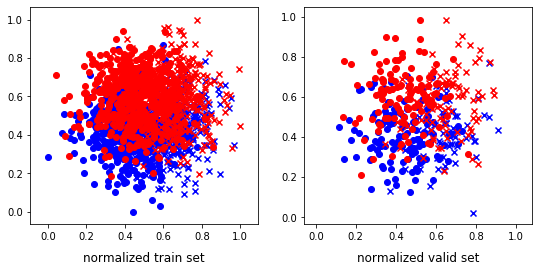

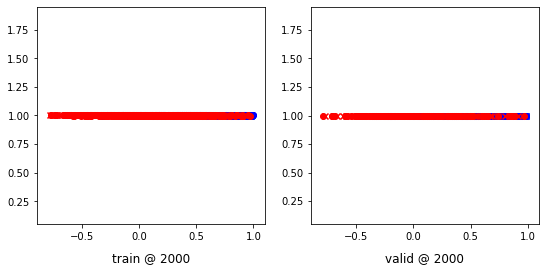

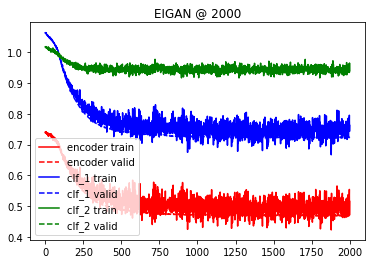

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<01:45, 18.89it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.00218298 	 0.00129074 	 -0.01253270 	 -0.01360026 	 0.07877044 	 0.07797132


 25%|██▌       | 504/2001 [00:30<01:34, 15.90it/s]

500 	 -0.09820849 	 -0.10222701 	 -0.13480897 	 -0.13835689 	 0.00877668 	 0.00992137


 50%|█████     | 1003/2001 [01:00<01:05, 15.26it/s]

1000 	 -0.16404134 	 -0.16341318 	 -0.24805495 	 -0.24787675 	 -0.08984817 	 -0.09062615


 75%|███████▌  | 1504/2001 [01:30<00:32, 15.49it/s]

1500 	 -0.20099759 	 -0.20087011 	 -0.35397539 	 -0.35453394 	 -0.19112340 	 -0.19199978


100%|██████████| 2001/2001 [02:00<00:00, 16.59it/s]


2000 	 -0.21506894 	 -0.21528342 	 -0.46883488 	 -0.46915585 	 -0.30375180 	 -0.30385756


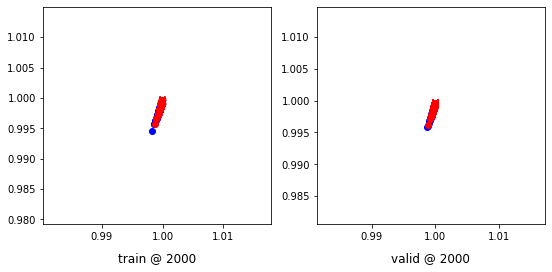

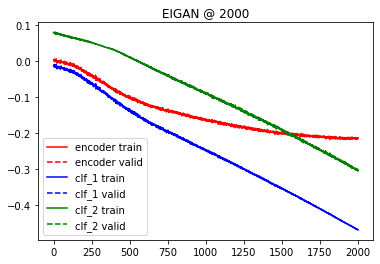

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.062516 	 1.062370 	 0.5063
200 	 0.818663 	 0.807571 	 0.7418
400 	 0.746025 	 0.722235 	 0.7544
600 	 0.744327 	 0.720859 	 0.7544
800 	 0.743278 	 0.719938 	 0.7570
1000 	 0.742787 	 0.719092 	 0.7570
Accuracy: 0.7569620253164557
Error Rate: 0.2430379746835443
F1 Score: 0.7486910994764397
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.759493670886076
Error Rate: 0.24050632911392406
F1 Score: 0.755784061696658
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7468354430379747
Error Rate: 0.2531

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.6962025316455697
Error Rate: 0.3037974683544304
F1 Score: 0.5774647887323943
VAR1: 0.8, VAR2: 0.2, TRIAL: 4
X, y_1, y2
(3020, 2) (3020, 1) (3020, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2416, 2) (604, 2) (2416, 1) (604, 1) (2416, 1) (604, 1)
class weights => w1, w2 [1.86419753 2.15714286] [1.73438622 2.36168133]
tensor sizes => torch.Size([2416, 2]) torch.Size([604, 2]) torch.Size([2416, 2]) torch.Size([604, 2]) torch.Size([2416, 2]) torch.Size([604, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.76502192 	 0.76001191 	 1.06842601 	 1.06787276 	 0.99727648 	 1.00100803


 25%|██▌       | 503/2001 [00:47<02:04, 11.98it/s]

500 	 -0.14405084 	 -0.14645971 	 0.07798542 	 0.07939200 	 0.91517615 	 0.91899890


 50%|█████     | 1001/2001 [01:35<01:29, 11.11it/s]

1000 	 -0.22678328 	 -0.19708972 	 0.03023647 	 0.03143873 	 0.95087004 	 0.92167562


 75%|███████▌  | 1502/2001 [02:23<00:45, 11.09it/s]

1500 	 -0.19687778 	 -0.19717988 	 0.03371807 	 0.03467307 	 0.92396915 	 0.92500013


100%|██████████| 2001/2001 [03:11<00:00, 10.43it/s]

2000 	 -0.21164006 	 -0.20024057 	 0.01921752 	 0.03366916 	 0.92394871 	 0.92705691


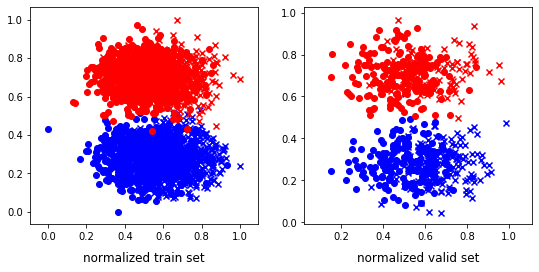

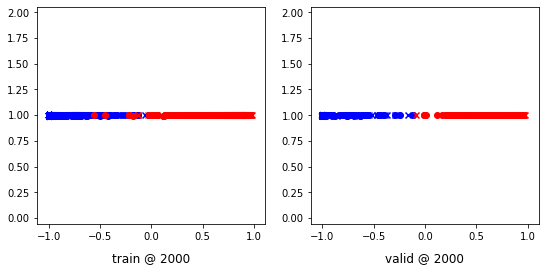

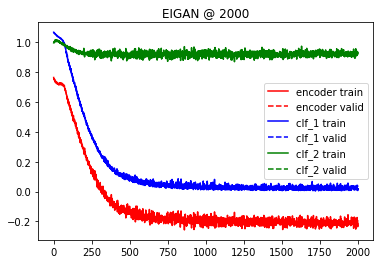

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:48, 11.88it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.08536206 	 -0.08331114 	 -0.11904775 	 -0.11684982 	 0.01657114 	 0.01686431


 25%|██▌       | 503/2001 [00:46<02:18, 10.82it/s]

500 	 -0.19984910 	 -0.20060349 	 -0.25465643 	 -0.25538075 	 -0.03410314 	 -0.03404544


 50%|█████     | 1001/2001 [01:32<01:25, 11.68it/s]

1000 	 -0.26846090 	 -0.26770148 	 -0.36902872 	 -0.36826858 	 -0.11712418 	 -0.11712316


 75%|███████▌  | 1504/2001 [02:17<00:38, 12.78it/s]

1500 	 -0.33564514 	 -0.33393040 	 -0.50860375 	 -0.50711834 	 -0.21588293 	 -0.21615854


100%|██████████| 2001/2001 [03:01<00:00, 11.03it/s]


2000 	 -0.42032430 	 -0.42057025 	 -0.61386007 	 -0.61402518 	 -0.23992798 	 -0.23983511


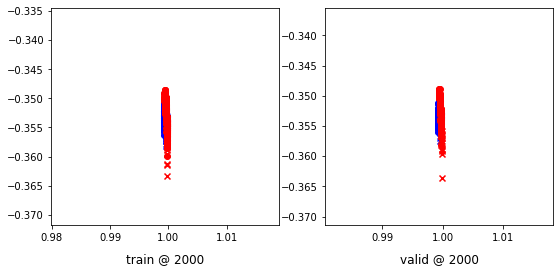

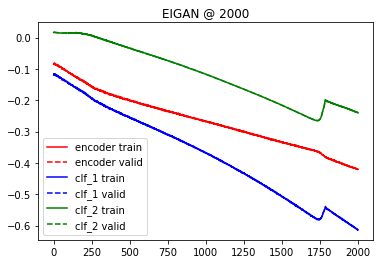

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.032662 	 1.032724 	 0.4636
200 	 0.342823 	 0.340971 	 0.9901
400 	 0.068998 	 0.070250 	 0.9934
600 	 0.038644 	 0.042510 	 0.9934
800 	 0.029892 	 0.034810 	 0.9950
1000 	 0.026259 	 0.031707 	 0.9950
Accuracy: 0.9950331125827815
Error Rate: 0.004966887417218543
F1 Score: 0.9946714031971582
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9983443708609272
Error Rate: 0.0016556291390728477
F1 Score: 0.9982174688057042
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9966887417218543
Error Rate: 

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.5778145695364238
Error Rate: 0.42218543046357615
F1 Score: 0.0
VAR1: 0.8, VAR2: 0.4, TRIAL: 4
X, y_1, y2
(1957, 2) (1957, 1) (1957, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1565, 2) (392, 2) (1565, 1) (392, 1) (1565, 1) (392, 1)
class weights => w1, w2 [1.93688119 2.0673712 ] [1.93209877 2.07284768]
tensor sizes => torch.Size([1565, 2]) torch.Size([392, 2]) torch.Size([1565, 2]) torch.Size([392, 2]) torch.Size([1565, 2]) torch.Size([392, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.69276607 	 0.69874859 	 1.03805161 	 1.03835750 	 1.03853166 	 1.03275609


 25%|██▌       | 503/2001 [00:30<01:34, 15.81it/s]

500 	 0.36232108 	 0.38501206 	 0.43403727 	 0.48544303 	 0.76474482 	 0.79357815


 50%|█████     | 1003/2001 [01:01<01:01, 16.33it/s]

1000 	 0.32169631 	 0.32070389 	 0.35346961 	 0.40141085 	 0.72509867 	 0.77385414


 75%|███████▌  | 1504/2001 [01:32<00:23, 21.03it/s]

1500 	 0.30073982 	 0.28922051 	 0.39846835 	 0.39829761 	 0.79108316 	 0.80222428


100%|██████████| 2001/2001 [02:03<00:00, 16.14it/s]


2000 	 0.26592594 	 0.28235090 	 0.35060489 	 0.39702219 	 0.77787262 	 0.80781847


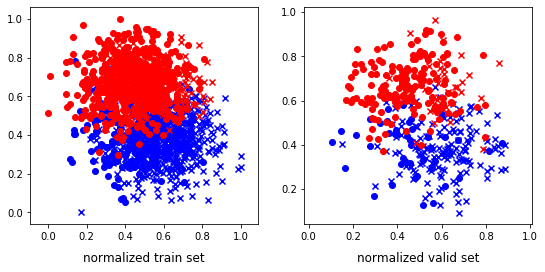

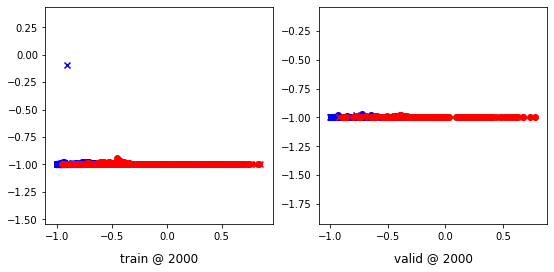

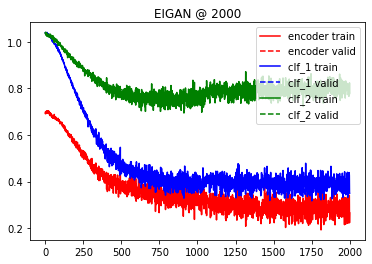

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:20, 24.89it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.00383351 	 0.00280614 	 -0.01382306 	 -0.01518483 	 0.06724812 	 0.06586957


 25%|██▌       | 502/2001 [00:30<01:32, 16.20it/s]

500 	 -0.07738811 	 -0.07682040 	 -0.10827733 	 -0.10715218 	 0.02428648 	 0.02583980


 50%|█████     | 1004/2001 [01:00<01:03, 15.69it/s]

1000 	 -0.12738024 	 -0.12754056 	 -0.18249659 	 -0.18184471 	 -0.03476666 	 -0.03303253


 75%|███████▌  | 1505/2001 [01:30<00:25, 19.39it/s]

1500 	 -0.17188525 	 -0.17016041 	 -0.25869679 	 -0.25850523 	 -0.09463760 	 -0.09722853


100%|██████████| 2001/2001 [01:59<00:00, 16.71it/s]


2000 	 -0.21989122 	 -0.21933052 	 -0.31549862 	 -0.31525794 	 -0.10919593 	 -0.10972150


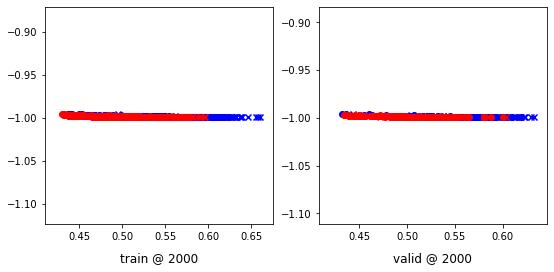

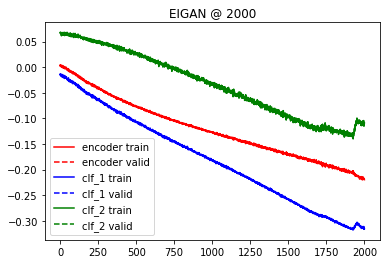

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.037383 	 1.037447 	 0.5153
200 	 0.597102 	 0.605724 	 0.8827
400 	 0.352712 	 0.367943 	 0.8954
600 	 0.342072 	 0.359587 	 0.8903
800 	 0.341082 	 0.359756 	 0.8903
1000 	 0.340774 	 0.359826 	 0.8903
Accuracy: 0.8903061224489796
Error Rate: 0.1096938775510204
F1 Score: 0.8883116883116884
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8928571428571429
Error Rate: 0.10714285714285714
F1 Score: 0.890625
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8877551020408163
Error Rate: 0.112244897959

  0%|          | 2/2001 [00:00<01:51, 17.93it/s]

Accuracy: 0.798469387755102
Error Rate: 0.20153061224489796
F1 Score: 0.7958656330749354
VAR1: 0.8, VAR2: 0.6, TRIAL: 4
X, y_1, y2
(2367, 2) (2367, 1) (2367, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1893, 2) (474, 2) (1893, 1) (474, 1) (1893, 1) (474, 1)
class weights => w1, w2 [2.12696629 1.88733799] [2.20116279 1.83252662]
tensor sizes => torch.Size([1893, 2]) torch.Size([474, 2]) torch.Size([1893, 2]) torch.Size([474, 2]) torch.Size([1893, 2]) torch.Size([474, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.72434962 	 0.71955431 	 1.06020761 	 1.05542588 	 1.02928424 	 1.02901876


 25%|██▌       | 504/2001 [00:34<01:37, 15.41it/s]

500 	 0.38141662 	 0.38472843 	 0.63716871 	 0.63761032 	 0.94893402 	 0.94602907


 50%|█████     | 1003/2001 [01:09<01:08, 14.55it/s]

1000 	 0.35484129 	 0.35330987 	 0.61398530 	 0.61176747 	 0.95247567 	 0.95160478


 75%|███████▌  | 1503/2001 [01:43<00:35, 13.86it/s]

1500 	 0.36245775 	 0.34688967 	 0.61941415 	 0.60373217 	 0.95010275 	 0.94998968


100%|██████████| 2001/2001 [02:17<00:00, 14.55it/s]


2000 	 0.35600334 	 0.34931779 	 0.61064166 	 0.60402042 	 0.94781458 	 0.94784981


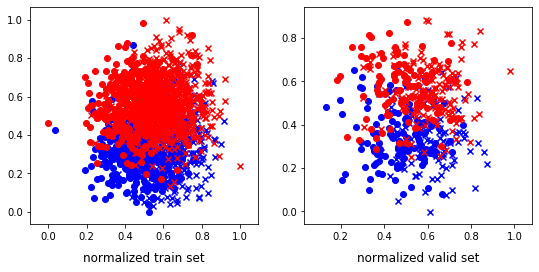

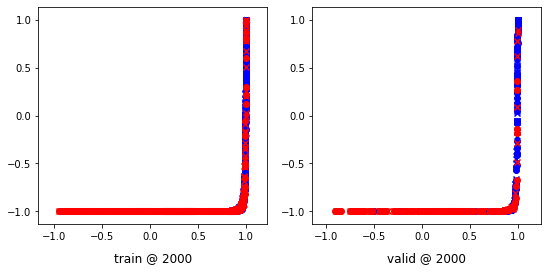

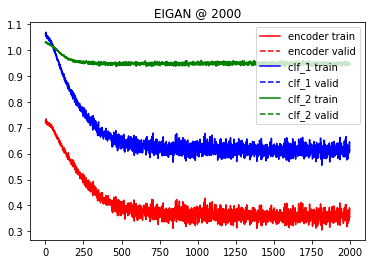

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<01:52, 17.73it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.03315517 	 -0.02975812 	 -0.07429273 	 -0.07109780 	 -0.00276871 	 -0.00332160


 25%|██▌       | 501/2001 [00:33<01:49, 13.75it/s]

500 	 -0.12135243 	 -0.12226860 	 -0.19776313 	 -0.19905080 	 -0.07640719 	 -0.07709601


 50%|█████     | 1003/2001 [01:07<00:55, 18.02it/s]

1000 	 -0.19857925 	 -0.20038764 	 -0.33182812 	 -0.33330357 	 -0.16503210 	 -0.16457637


 75%|███████▌  | 1501/2001 [01:41<00:29, 16.80it/s]

1500 	 -0.26127592 	 -0.26389843 	 -0.47282830 	 -0.47386837 	 -0.25994810 	 -0.25822476


100%|██████████| 2001/2001 [02:14<00:00, 14.91it/s]


2000 	 -0.31899825 	 -0.32527635 	 -0.57267916 	 -0.57637733 	 -0.30366349 	 -0.30109978


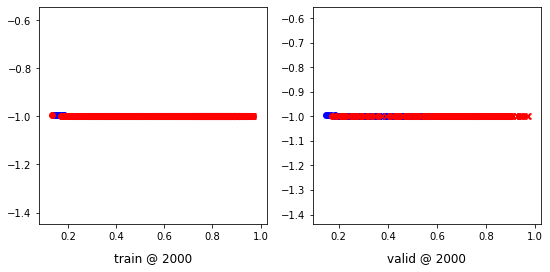

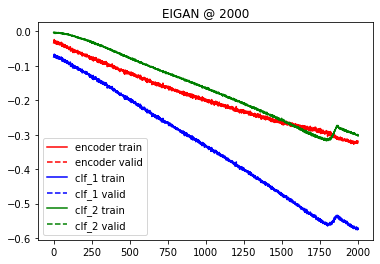

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.026237 	 1.025730 	 0.5316
200 	 0.803912 	 0.794210 	 0.7996
400 	 0.618205 	 0.589667 	 0.8059
600 	 0.616503 	 0.586748 	 0.8059
800 	 0.616162 	 0.586350 	 0.8059
1000 	 0.616025 	 0.586209 	 0.8059
Accuracy: 0.8059071729957806
Error Rate: 0.1940928270042194
F1 Score: 0.8152610441767069
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.810126582278481
Error Rate: 0.189873417721519
F1 Score: 0.8185483870967741
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8248945147679325
Error Rate: 0.17510

  0%|          | 1/2001 [00:00<03:51,  8.65it/s]

Accuracy: 0.6708860759493671
Error Rate: 0.3291139240506329
F1 Score: 0.7078651685393259
VAR1: 0.8, VAR2: 0.8, TRIAL: 4
X, y_1, y2
(1812, 2) (1812, 1) (1812, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1449, 2) (363, 2) (1449, 1) (363, 1) (1449, 1) (363, 1)
class weights => w1, w2 [1.99312242 2.00692521] [2.30732484 1.76492083]
tensor sizes => torch.Size([1449, 2]) torch.Size([363, 2]) torch.Size([1449, 2]) torch.Size([363, 2]) torch.Size([1449, 2]) torch.Size([363, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.73412061 	 0.73469257 	 1.05705392 	 1.05945599 	 1.01630294 	 1.01791060


 25%|██▌       | 503/2001 [00:31<01:39, 15.00it/s]

500 	 0.50912666 	 0.49325687 	 0.75984639 	 0.75510931 	 0.94395119 	 0.95499963


 50%|█████     | 1003/2001 [01:01<01:04, 15.58it/s]

1000 	 0.47342306 	 0.47477084 	 0.73535067 	 0.73593920 	 0.95505625 	 0.95431554


 75%|███████▌  | 1504/2001 [01:31<00:30, 16.24it/s]

1500 	 0.49467593 	 0.47371495 	 0.73839396 	 0.73527008 	 0.93802804 	 0.95470232


100%|██████████| 2001/2001 [02:01<00:00, 16.49it/s]


2000 	 0.51021022 	 0.47485840 	 0.76233542 	 0.73764151 	 0.94528401 	 0.95593029


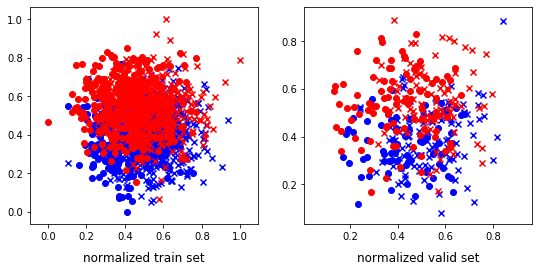

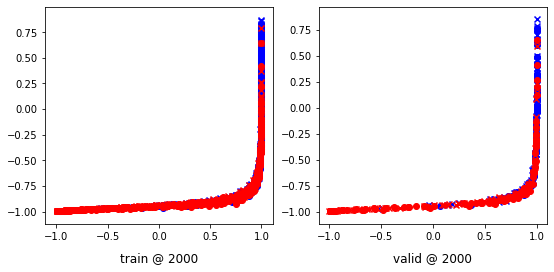

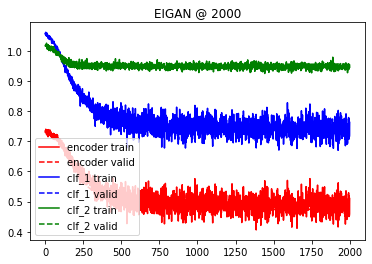

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<01:49, 18.29it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.10173047 	 0.09719476 	 0.04267732 	 0.04267164 	 -0.04293720 	 -0.03350188


 25%|██▌       | 504/2001 [00:28<01:24, 17.78it/s]

500 	 0.07837038 	 0.07319805 	 0.00519243 	 0.00506412 	 -0.07051255 	 -0.06102477


 50%|█████     | 1004/2001 [00:57<01:02, 16.07it/s]

1000 	 0.02990398 	 0.03028780 	 -0.05470766 	 -0.05349881 	 -0.09087781 	 -0.08945918


 75%|███████▌  | 1503/2001 [01:27<00:27, 18.24it/s]

1500 	 0.00104263 	 0.00044610 	 -0.11611940 	 -0.11397099 	 -0.14228919 	 -0.13825594


100%|██████████| 2001/2001 [01:55<00:00, 17.32it/s]


2000 	 -0.02459018 	 -0.02415997 	 -0.17417771 	 -0.17889287 	 -0.18676542 	 -0.19336101


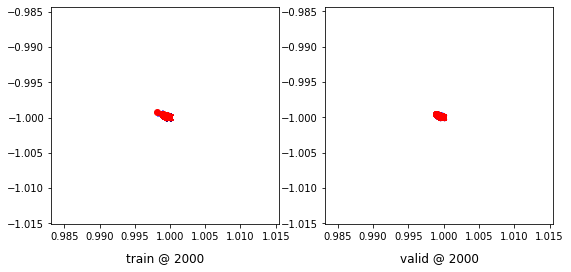

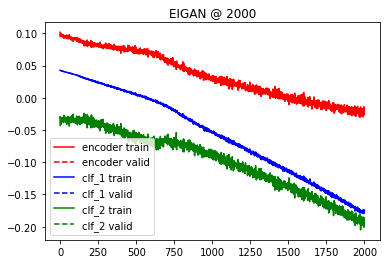

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.052035 	 1.052076 	 0.5014
200 	 0.871262 	 0.864380 	 0.7466
400 	 0.747615 	 0.733184 	 0.7410
600 	 0.746750 	 0.733543 	 0.7410
800 	 0.746692 	 0.733520 	 0.7410
1000 	 0.746663 	 0.733553 	 0.7410
Accuracy: 0.7410468319559229
Error Rate: 0.25895316804407714
F1 Score: 0.7374301675977653
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.743801652892562
Error Rate: 0.256198347107438
F1 Score: 0.7409470752089137
SVM
--------------------------------------------------------------------------------
Accuracy: 0.743801652892562
Error Rate: 0.25619

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.5647382920110193
Error Rate: 0.43526170798898073
F1 Score: 0.721830985915493
Writing trial 4 ...
VAR1: 0.2, VAR2: 0.2, TRIAL: 5
X, y_1, y2
(2261, 2) (2261, 1) (2261, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1808, 2) (453, 2) (1808, 1) (453, 1) (1808, 1) (453, 1)
class weights => w1, w2 [1.97164667 2.0291807 ] [1.88529718 2.12956419]
tensor sizes => torch.Size([1808, 2]) torch.Size([453, 2]) torch.Size([1808, 2]) torch.Size([453, 2]) torch.Size([1808, 2]) torch.Size([453, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.69500160 	 0.69093955 	 1.02667868 	 1.02367544 	 1.02517641 	 1.02588308


 25%|██▌       | 504/2001 [00:33<01:38, 15.23it/s]

500 	 0.16996974 	 0.18449868 	 0.18933925 	 0.18956287 	 0.71250039 	 0.69821137


 50%|█████     | 1003/2001 [01:06<01:01, 16.34it/s]

1000 	 0.00599813 	 -0.01987785 	 0.12832981 	 0.11666495 	 0.81578016 	 0.82968998


 75%|███████▌  | 1502/2001 [01:40<00:30, 16.12it/s]

1500 	 0.02101475 	 0.01938472 	 0.11894789 	 0.10988650 	 0.79115945 	 0.78364897


100%|██████████| 2001/2001 [02:13<00:00, 14.96it/s]


2000 	 -0.00853039 	 0.01061952 	 0.09038248 	 0.08627820 	 0.79260701 	 0.76880586


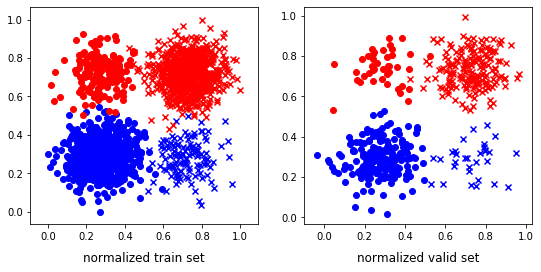

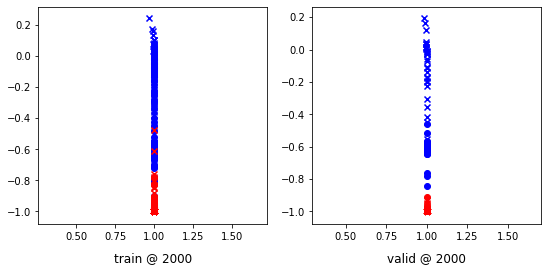

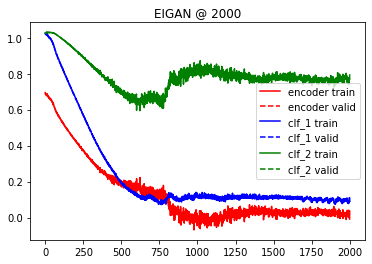

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<01:45, 18.93it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.07404236 	 -0.07384261 	 -0.10069986 	 -0.10050976 	 0.03683435 	 0.03669922


 25%|██▌       | 504/2001 [00:31<01:39, 15.08it/s]

500 	 -0.21137227 	 -0.21139410 	 -0.26841420 	 -0.26863009 	 -0.03871400 	 -0.03924044


 50%|█████     | 1003/2001 [01:04<01:06, 15.00it/s]

1000 	 -0.33853641 	 -0.33877677 	 -0.46608078 	 -0.46614137 	 -0.15712960 	 -0.15688179


 75%|███████▌  | 1503/2001 [01:36<00:36, 13.55it/s]

1500 	 -0.45872241 	 -0.45834884 	 -0.66369939 	 -0.66428876 	 -0.25274339 	 -0.25380605


100%|██████████| 2001/2001 [02:08<00:00, 15.55it/s]


2000 	 -0.57641888 	 -0.57573438 	 -0.89084774 	 -0.89112139 	 -0.36073950 	 -0.36159328


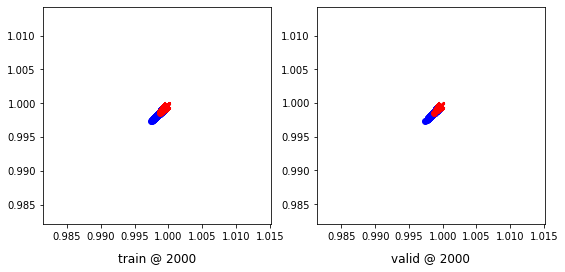

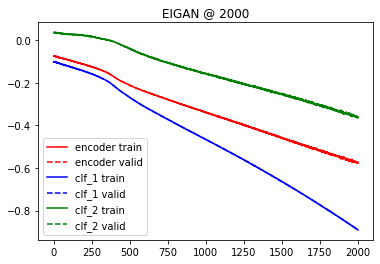

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.055566 	 1.055628 	 0.4923
200 	 0.405797 	 0.395576 	 0.9912
400 	 0.065696 	 0.059071 	 0.9956
600 	 0.035278 	 0.030299 	 0.9934
800 	 0.026296 	 0.021918 	 0.9956
1000 	 0.021808 	 0.017697 	 0.9956
Accuracy: 0.9955849889624724
Error Rate: 0.004415011037527594
F1 Score: 0.9955156950672646
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9955849889624724
Error Rate: 0.004415011037527594
F1 Score: 0.9955156950672646
SVM
--------------------------------------------------------------------------------
Accuracy: 1.0
Error Rate: 0.0
F1 Score: 1.

  0%|          | 3/2001 [00:00<01:37, 20.54it/s]

tensor sizes => torch.Size([1249, 2]) torch.Size([313, 2]) torch.Size([1249, 2]) torch.Size([313, 2]) torch.Size([1249, 2]) torch.Size([313, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.68832314 	 0.66958261 	 1.05302083 	 1.02765119 	 1.05809855 	 1.05121577


 25%|██▌       | 504/2001 [00:29<01:31, 16.34it/s]

500 	 0.15266699 	 0.26987782 	 0.40805745 	 0.49860182 	 0.94871300 	 0.92187119


 50%|█████     | 1003/2001 [00:58<00:52, 18.93it/s]

1000 	 0.13591331 	 0.22052291 	 0.31613472 	 0.45118454 	 0.87341189 	 0.92380881


 75%|███████▌  | 1503/2001 [01:28<00:31, 15.60it/s]

1500 	 0.13939261 	 0.21840787 	 0.36417386 	 0.42829627 	 0.92028403 	 0.90303558


100%|██████████| 2001/2001 [01:57<00:00, 17.02it/s]


2000 	 0.18532950 	 0.19180229 	 0.39020622 	 0.40944138 	 0.89769894 	 0.91078627


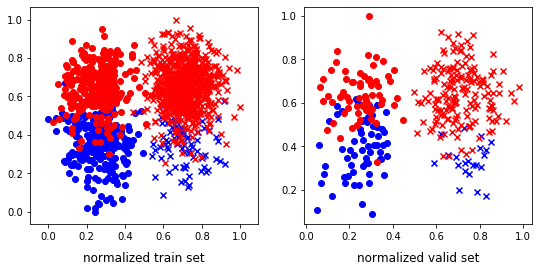

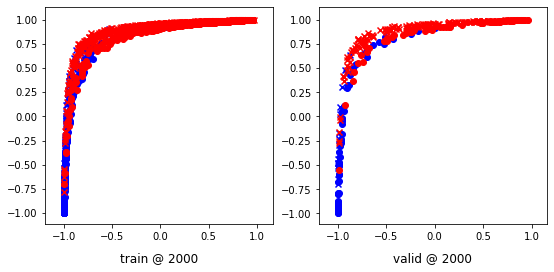

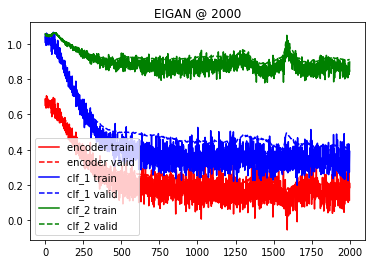

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:22, 24.32it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.06589092 	 0.06545632 	 0.02259583 	 0.02215340 	 -0.00804935 	 -0.00809351


 25%|██▌       | 503/2001 [00:28<01:29, 16.82it/s]

500 	 0.00832648 	 0.00980324 	 -0.04286441 	 -0.04136026 	 -0.02623626 	 -0.02619351


 50%|█████     | 1004/2001 [00:57<01:03, 15.82it/s]

1000 	 -0.03932761 	 -0.03744431 	 -0.11243971 	 -0.11045326 	 -0.07039176 	 -0.07020169


 75%|███████▌  | 1502/2001 [01:25<00:24, 20.01it/s]

1500 	 -0.08789299 	 -0.08335230 	 -0.19014551 	 -0.18537503 	 -0.11976939 	 -0.11940997


100%|██████████| 2001/2001 [01:54<00:00, 17.44it/s]


2000 	 -0.13349561 	 -0.12746543 	 -0.27646703 	 -0.27059653 	 -0.17811558 	 -0.17832671


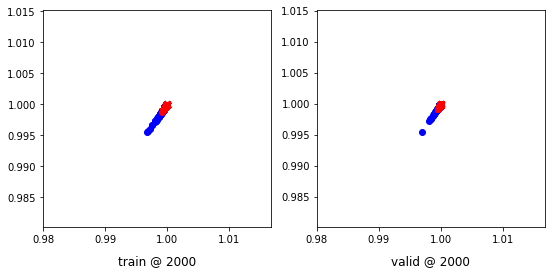

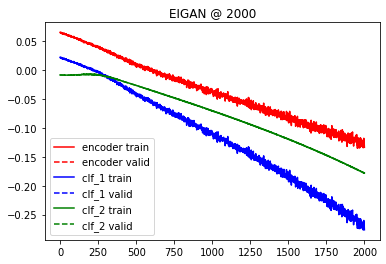

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.010962 	 1.009989 	 0.4569
200 	 0.584422 	 0.609785 	 0.8530
400 	 0.321623 	 0.347095 	 0.9105
600 	 0.305470 	 0.326860 	 0.9105
800 	 0.304197 	 0.325778 	 0.9105
1000 	 0.303644 	 0.326465 	 0.9073
Accuracy: 0.9073482428115016
Error Rate: 0.0926517571884984
F1 Score: 0.9376344086021506
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9009584664536742
Error Rate: 0.09904153354632587
F1 Score: 0.9309576837416481
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9073482428115016
Error Rate: 0.09

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.948915 	 0.948514 	 0.5942
Accuracy: 0.5942492012779552
Error Rate: 0.4057507987220447
F1 Score: 0.7454909819639278
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7507987220447284
Error Rate: 0.24920127795527156
F1 Score: 0.8251121076233183
SVM
--------------------------------------------------------------------------------
Accuracy: 0.853035143769968
Error Rate: 0.14696485623003194
F1 Score: 0.8729281767955801
VAR1: 0.2, VAR2: 0.6, TRIAL: 5
X, y_1, y2
(2128, 2) (2128, 1) (2128, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1702, 2) (426, 2) (1702, 1) (426, 1) (1702, 1) (426, 1)
class weights => w1, w2 [1.73496432 2.36061026] [1.53057554 2.88474576]
tensor sizes => torch.Size([1702, 2]) torch.Size([426, 2]) torch.Size([1702, 2]) torch.Size([426, 2]) torch.Size([1702, 2]) torch.Size([426, 2])
--------------------------------------------------------------------------------
EIGAN Training
-------

  0%|          | 2/2001 [00:00<02:32, 13.07it/s]

0 	 0.68399584 	 0.69446981 	 1.01909173 	 1.02729523 	 1.02866280 	 1.02597260


 25%|██▌       | 502/2001 [00:32<01:45, 14.25it/s]

500 	 0.50640255 	 0.48142135 	 0.66743255 	 0.66278702 	 0.85422337 	 0.87451285


 50%|█████     | 1002/2001 [01:07<01:13, 13.62it/s]

1000 	 0.48610389 	 0.47602922 	 0.64581668 	 0.64194292 	 0.85303664 	 0.85906088


 75%|███████▌  | 1504/2001 [01:40<00:35, 13.87it/s]

1500 	 0.52420104 	 0.47436428 	 0.67802757 	 0.63929361 	 0.84702504 	 0.85807651


100%|██████████| 2001/2001 [02:12<00:00, 15.06it/s]


2000 	 0.45388252 	 0.47224224 	 0.59945852 	 0.62929934 	 0.83931297 	 0.85020429


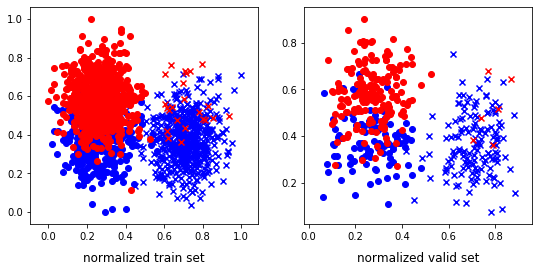

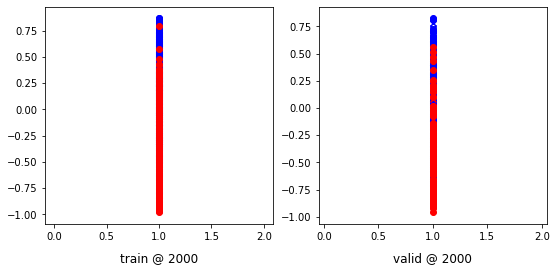

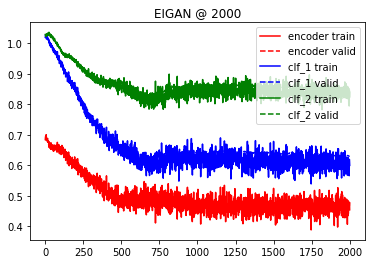

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<01:54, 17.49it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.06851994 	 0.06799792 	 0.03073788 	 0.03077541 	 0.00570889 	 0.00706864


 25%|██▌       | 502/2001 [00:31<01:30, 16.52it/s]

500 	 0.02293548 	 0.02371806 	 -0.02437576 	 -0.02407756 	 -0.01750053 	 -0.01862209


 50%|█████     | 1003/2001 [01:03<01:02, 15.92it/s]

1000 	 -0.01976960 	 -0.01895319 	 -0.09269234 	 -0.09191549 	 -0.07003603 	 -0.07011534


 75%|███████▌  | 1505/2001 [01:34<00:23, 20.76it/s]

1500 	 -0.05593755 	 -0.05514988 	 -0.15736482 	 -0.15695775 	 -0.11847612 	 -0.11907343


100%|██████████| 2001/2001 [02:03<00:00, 16.26it/s]


2000 	 -0.08375537 	 -0.08475441 	 -0.22311427 	 -0.22369038 	 -0.17330787 	 -0.17274117


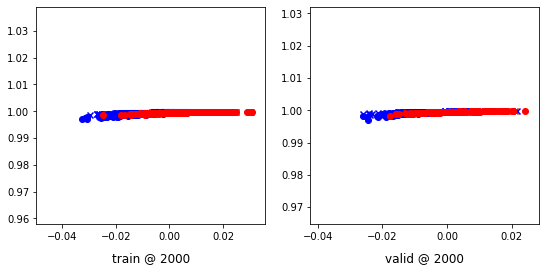

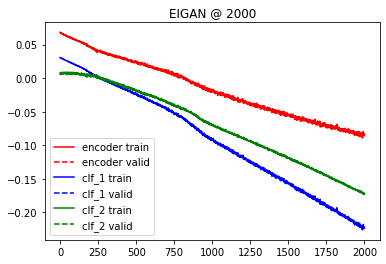

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.035762 	 1.035671 	 0.4225
200 	 0.654627 	 0.660100 	 0.8404
400 	 0.465301 	 0.480141 	 0.8685
600 	 0.449957 	 0.470313 	 0.8638
800 	 0.442100 	 0.464446 	 0.8662
1000 	 0.437981 	 0.461937 	 0.8685
Accuracy: 0.8685446009389671
Error Rate: 0.13145539906103287
F1 Score: 0.8435754189944135
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8661971830985915
Error Rate: 0.13380281690140844
F1 Score: 0.8471849865951743
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8615023474178404
Error Rate: 0.1

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.6525821596244131
Error Rate: 0.3474178403755869
F1 Score: 0.0
VAR1: 0.2, VAR2: 0.8, TRIAL: 5
X, y_1, y2
(1649, 2) (1649, 1) (1649, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1319, 2) (330, 2) (1319, 1) (330, 1) (1319, 1) (330, 1)
class weights => w1, w2 [1.39429175 3.53619303] [1.50056883 2.99772727]
tensor sizes => torch.Size([1319, 2]) torch.Size([330, 2]) torch.Size([1319, 2]) torch.Size([330, 2]) torch.Size([1319, 2]) torch.Size([330, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.67047870 	 0.66223562 	 1.03867662 	 1.02453685 	 1.06160498 	 1.05544841


 25%|██▌       | 503/2001 [00:29<01:32, 16.20it/s]

500 	 0.58674490 	 0.59370267 	 0.79867607 	 0.84072596 	 0.90539861 	 0.94017047


 50%|█████     | 1002/2001 [00:59<00:58, 16.96it/s]

1000 	 0.46540487 	 0.50798303 	 0.71062285 	 0.75245142 	 0.93840975 	 0.93761557


 75%|███████▌  | 1503/2001 [01:27<00:31, 15.60it/s]

1500 	 0.46617591 	 0.50487465 	 0.70872784 	 0.74748635 	 0.93581563 	 0.93575889


100%|██████████| 2001/2001 [01:56<00:00, 17.11it/s]


2000 	 0.48069525 	 0.50331086 	 0.72988784 	 0.74369508 	 0.94306910 	 0.93353140


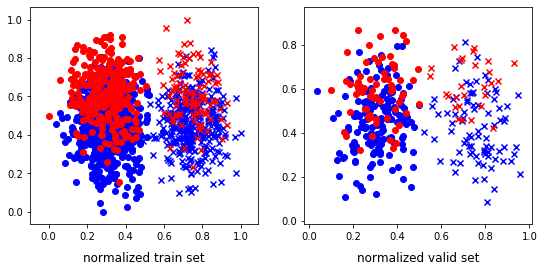

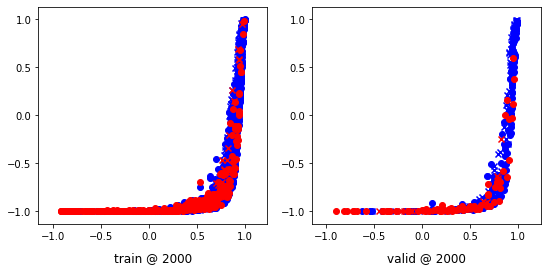

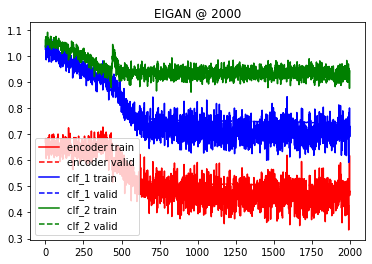

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:29, 22.21it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.02039921 	 -0.01791429 	 -0.07150934 	 -0.06851927 	 -0.02606074 	 -0.02495551


 25%|██▌       | 503/2001 [00:29<01:42, 14.66it/s]

500 	 -0.07003684 	 -0.07162047 	 -0.14894938 	 -0.15045732 	 -0.08088075 	 -0.08077901


 50%|█████     | 1002/2001 [00:57<00:49, 20.23it/s]

1000 	 -0.11865294 	 -0.11517130 	 -0.24515727 	 -0.24254987 	 -0.15567353 	 -0.15690134


 75%|███████▌  | 1503/2001 [01:25<00:27, 18.25it/s]

1500 	 -0.15395191 	 -0.15268604 	 -0.33553073 	 -0.33519840 	 -0.22612031 	 -0.22721465


100%|██████████| 2001/2001 [01:53<00:00, 17.61it/s]


2000 	 -0.18960163 	 -0.19059895 	 -0.42693648 	 -0.42804018 	 -0.28716803 	 -0.28727943


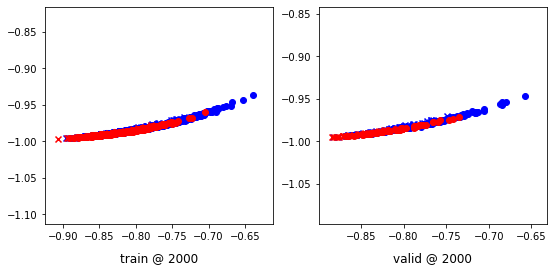

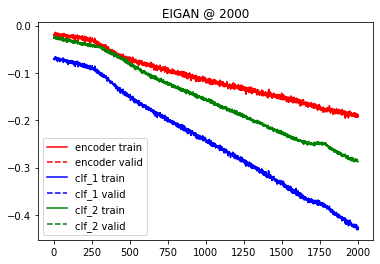

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.018622 	 1.020309 	 0.7030
200 	 0.805828 	 0.816227 	 0.7394
400 	 0.707021 	 0.735919 	 0.7636
600 	 0.704273 	 0.736989 	 0.7697
800 	 0.703639 	 0.737712 	 0.7697
1000 	 0.703275 	 0.738416 	 0.7697
Accuracy: 0.7696969696969697
Error Rate: 0.23030303030303031
F1 Score: 0.5957446808510638
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7242424242424242
Error Rate: 0.27575757575757576
F1 Score: 0.5919282511210763
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7575757575757576
Error Rate: 0.2

  0%|          | 2/2001 [00:00<02:23, 13.96it/s]

tensor sizes => torch.Size([1508, 2]) torch.Size([377, 2]) torch.Size([1508, 2]) torch.Size([377, 2]) torch.Size([1508, 2]) torch.Size([377, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.70198119 	 0.68836057 	 1.02888727 	 1.01519036 	 1.02024138 	 1.01997697


 25%|██▌       | 503/2001 [00:31<01:41, 14.81it/s]

500 	 -0.02210522 	 -0.01633009 	 0.19304501 	 0.19704744 	 0.90826887 	 0.90652472


 50%|█████     | 1004/2001 [01:01<00:55, 17.85it/s]

1000 	 -0.15195581 	 -0.16633439 	 0.03507650 	 0.03415316 	 0.88030756 	 0.89363474


 75%|███████▌  | 1504/2001 [01:32<00:30, 16.09it/s]

1500 	 -0.14526516 	 -0.17322838 	 0.01994319 	 0.01506507 	 0.85840040 	 0.88144064


100%|██████████| 2001/2001 [02:02<00:00, 16.38it/s]

2000 	 -0.17797004 	 -0.17207286 	 0.02087254 	 0.01390264 	 0.89205223 	 0.87912267


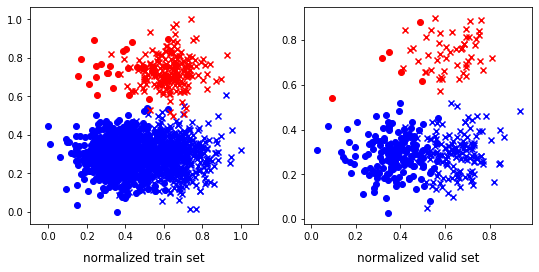

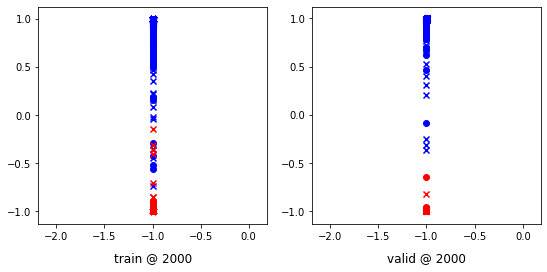

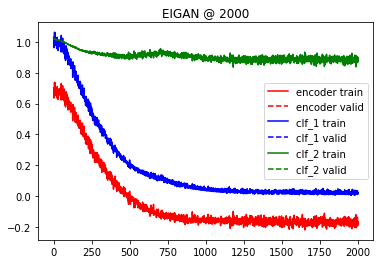

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<01:47, 18.65it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.10351658 	 0.10335257 	 0.01894326 	 0.01874967 	 -0.09078799 	 -0.09086576


 25%|██▌       | 504/2001 [00:30<01:15, 19.84it/s]

500 	 0.05392117 	 0.05410373 	 -0.04439538 	 -0.04472056 	 -0.11349341 	 -0.11436330


 50%|█████     | 1004/2001 [00:59<00:50, 19.75it/s]

1000 	 0.01405452 	 0.01371072 	 -0.12669295 	 -0.12691902 	 -0.17516115 	 -0.17500633


 75%|███████▌  | 1503/2001 [01:28<00:26, 19.13it/s]

1500 	 -0.00597762 	 -0.00561725 	 -0.20179783 	 -0.20111445 	 -0.24251549 	 -0.24215065


100%|██████████| 2001/2001 [01:57<00:00, 16.97it/s]


2000 	 -0.01722917 	 -0.01336068 	 -0.28152362 	 -0.28022560 	 -0.31409562 	 -0.31658968


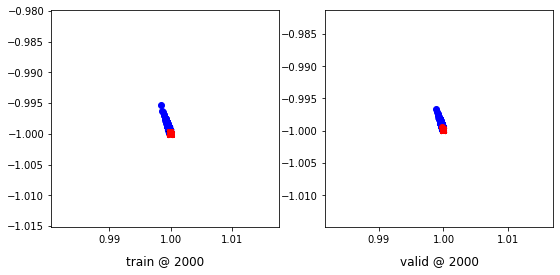

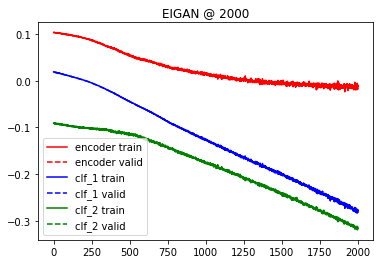

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.053504 	 1.052111 	 0.9549
200 	 0.279720 	 0.274605 	 0.9947
400 	 0.056491 	 0.058542 	 0.9973
600 	 0.030376 	 0.033659 	 0.9973
800 	 0.023252 	 0.026867 	 0.9973
1000 	 0.020321 	 0.024345 	 0.9973
Accuracy: 0.9973474801061007
Error Rate: 0.002652519893899204
F1 Score: 0.9909909909909909
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9893899204244032
Error Rate: 0.010610079575596816
F1 Score: 0.9649122807017544
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9920424403183024
Error Rate: 0

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.5384615384615384
Error Rate: 0.46153846153846156
F1 Score: 0.7000000000000001
VAR1: 0.4, VAR2: 0.4, TRIAL: 5
X, y_1, y2
(1387, 2) (1387, 1) (1387, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1109, 2) (278, 2) (1109, 1) (278, 1) (1109, 1) (278, 1)
class weights => w1, w2 [1.76311606 2.31041667] [2.54357798 1.64784547]
tensor sizes => torch.Size([1109, 2]) torch.Size([278, 2]) torch.Size([1109, 2]) torch.Size([278, 2]) torch.Size([1109, 2]) torch.Size([278, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.70247400 	 0.71157730 	 1.03576291 	 1.03546178 	 1.02676558 	 1.01703167


 25%|██▌       | 504/2001 [00:28<01:21, 18.39it/s]

500 	 0.41143179 	 0.33938915 	 0.46099603 	 0.39932990 	 0.74454796 	 0.75308794


 50%|█████     | 1005/2001 [00:55<00:51, 19.16it/s]

1000 	 0.49450913 	 0.31079015 	 0.43422431 	 0.36269066 	 0.63306779 	 0.74504769


 75%|███████▌  | 1503/2001 [01:23<00:24, 20.64it/s]

1500 	 0.39492282 	 0.30237427 	 0.44003767 	 0.34698626 	 0.73886669 	 0.73775917


100%|██████████| 2001/2001 [01:51<00:00, 17.98it/s]


2000 	 0.34577826 	 0.28840101 	 0.44055235 	 0.32922232 	 0.78824121 	 0.73396850


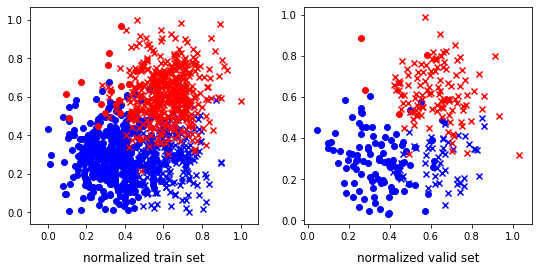

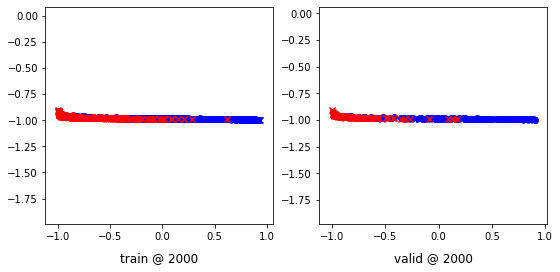

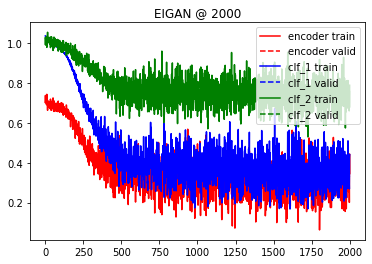

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:32, 21.71it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.09426890 	 0.08968230 	 0.02541112 	 0.01904695 	 -0.06237482 	 -0.06577311


 25%|██▌       | 504/2001 [00:26<01:27, 17.15it/s]

500 	 0.04502914 	 0.04469926 	 -0.04853237 	 -0.05460557 	 -0.10586568 	 -0.11512668


 50%|█████     | 1005/2001 [00:54<00:52, 18.89it/s]

1000 	 0.02282711 	 0.02124149 	 -0.10323109 	 -0.10524289 	 -0.15504450 	 -0.15564643


 75%|███████▌  | 1503/2001 [01:20<00:26, 18.50it/s]

1500 	 -0.00167482 	 0.00734314 	 -0.15699740 	 -0.14176436 	 -0.19410746 	 -0.18614441


100%|██████████| 2001/2001 [01:47<00:00, 18.63it/s]


2000 	 -0.00334007 	 -0.00182591 	 -0.17219661 	 -0.17290697 	 -0.21091944 	 -0.21361947


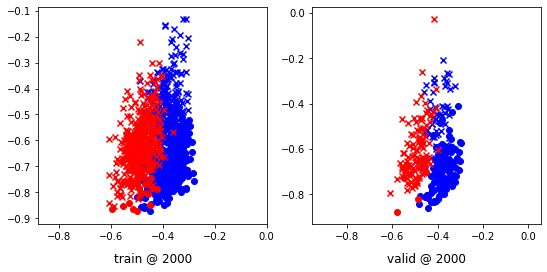

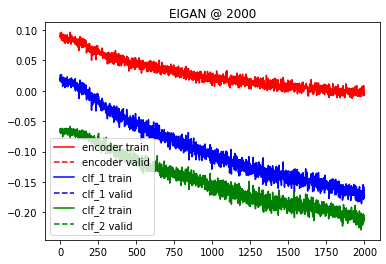

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.000733 	 1.000510 	 0.4317
200 	 0.508049 	 0.495690 	 0.9281
400 	 0.283785 	 0.248672 	 0.9388
600 	 0.279173 	 0.240290 	 0.9388
800 	 0.279012 	 0.240006 	 0.9388
1000 	 0.278945 	 0.239952 	 0.9388
Accuracy: 0.9388489208633094
Error Rate: 0.06115107913669065
F1 Score: 0.9311740890688259
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9280575539568345
Error Rate: 0.07194244604316546
F1 Score: 0.9199999999999999
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9424460431654677
Error Rate: 0.0

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.289295 	 0.323495 	 0.9245
Accuracy: 0.9244604316546763
Error Rate: 0.07553956834532374
F1 Score: 0.9384164222873901
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8848920863309353
Error Rate: 0.11510791366906475
F1 Score: 0.903030303030303
SVM
--------------------------------------------------------------------------------
Accuracy: 0.920863309352518
Error Rate: 0.07913669064748201
F1 Score: 0.935672514619883
VAR1: 0.4, VAR2: 0.6, TRIAL: 5
X, y_1, y2
(2304, 2) (2304, 1) (2304, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1843, 2) (461, 2) (1843, 1) (461, 1) (1843, 1) (461, 1)
class weights => w1, w2 [1.55658784 2.79666161] [2.28094059 1.78067633]
tensor sizes => torch.Size([1843, 2]) torch.Size([461, 2]) torch.Size([1843, 2]) torch.Size([461, 2]) torch.Size([1843, 2]) torch.Size([461, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------

 25%|██▌       | 503/2001 [00:34<01:43, 14.48it/s]

500 	 0.46686345 	 0.41547734 	 0.72150177 	 0.66869193 	 0.94788128 	 0.94636178


 50%|█████     | 1003/2001 [01:08<01:13, 13.52it/s]

1000 	 0.38637322 	 0.31476367 	 0.63479000 	 0.56816041 	 0.94204783 	 0.94654393


 75%|███████▌  | 1503/2001 [01:42<00:32, 15.40it/s]

1500 	 0.32323861 	 0.30163503 	 0.56924254 	 0.55528766 	 0.93947208 	 0.94679981


100%|██████████| 2001/2001 [02:16<00:00, 14.70it/s]


2000 	 0.37488788 	 0.29846740 	 0.63289642 	 0.55113178 	 0.95107025 	 0.94581157


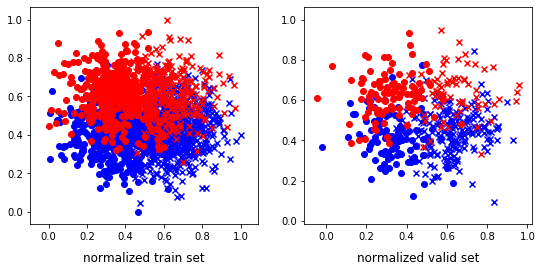

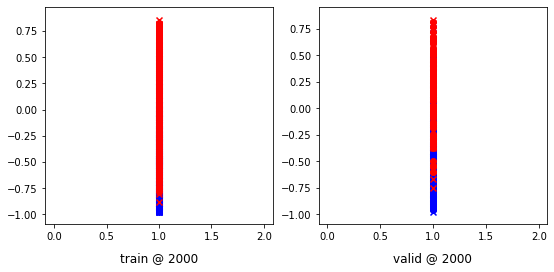

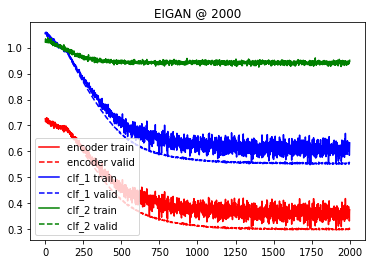

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:05, 15.97it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.14508404 	 0.14576928 	 0.10967974 	 0.11040959 	 0.01195664 	 0.01195827


 25%|██▌       | 503/2001 [00:32<01:36, 15.60it/s]

500 	 0.05132202 	 0.05069335 	 -0.01758730 	 -0.01824835 	 -0.06248142 	 -0.06256752


 50%|█████     | 1005/2001 [01:05<00:58, 17.17it/s]

1000 	 -0.03938782 	 -0.03872386 	 -0.14722748 	 -0.14657247 	 -0.12838885 	 -0.12840313


 75%|███████▌  | 1504/2001 [01:38<00:34, 14.59it/s]

1500 	 -0.11562750 	 -0.11439542 	 -0.28033301 	 -0.27918082 	 -0.20583919 	 -0.20593768


100%|██████████| 2001/2001 [02:10<00:00, 15.33it/s]

2000 	 -0.17464927 	 -0.17441207 	 -0.42516667 	 -0.42490214 	 -0.30051714 	 -0.30048984


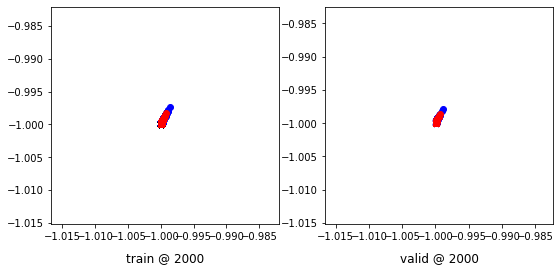

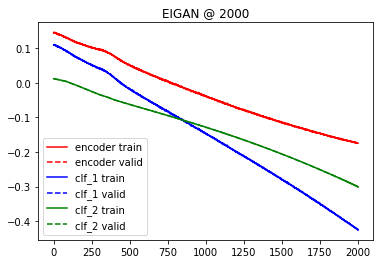

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.088941 	 1.087438 	 0.6443
200 	 0.779694 	 0.767955 	 0.8395
400 	 0.600486 	 0.543440 	 0.8503
600 	 0.598664 	 0.539363 	 0.8503
800 	 0.598474 	 0.539010 	 0.8482
1000 	 0.598411 	 0.538893 	 0.8482
Accuracy: 0.8481561822125814
Error Rate: 0.15184381778741865
F1 Score: 0.7976878612716763
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8112798264642083
Error Rate: 0.18872017353579176
F1 Score: 0.7667560321715818
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8503253796095445
Error Rate: 0.1

  0%|          | 3/2001 [00:00<01:32, 21.71it/s]

Accuracy: 0.7700650759219089
Error Rate: 0.2299349240780911
F1 Score: 0.8
VAR1: 0.4, VAR2: 0.8, TRIAL: 5
X, y_1, y2
(1450, 2) (1450, 1) (1450, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1160, 2) (290, 2) (1160, 1) (290, 1) (1160, 1) (290, 1)
class weights => w1, w2 [3.51515152 1.39759036] [1.9205298  2.08633094]
tensor sizes => torch.Size([1160, 2]) torch.Size([290, 2]) torch.Size([1160, 2]) torch.Size([290, 2]) torch.Size([1160, 2]) torch.Size([290, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.70745540 	 0.70167875 	 1.06483459 	 1.06275773 	 1.05079341 	 1.05422616


 25%|██▌       | 504/2001 [00:29<01:28, 16.93it/s]

500 	 0.44930261 	 0.45929718 	 0.67419118 	 0.71082193 	 0.91800588 	 0.94467193


 50%|█████     | 1002/2001 [00:57<00:55, 17.85it/s]

1000 	 0.31074476 	 0.43374610 	 0.57979506 	 0.68445206 	 0.96331173 	 0.94385314


 75%|███████▌  | 1504/2001 [01:26<00:28, 17.62it/s]

1500 	 0.43012482 	 0.43752837 	 0.67242205 	 0.69376892 	 0.93563557 	 0.94938773


100%|██████████| 2001/2001 [01:55<00:00, 17.38it/s]


2000 	 0.35923702 	 0.43605953 	 0.64511353 	 0.69124252 	 0.97966653 	 0.94833016


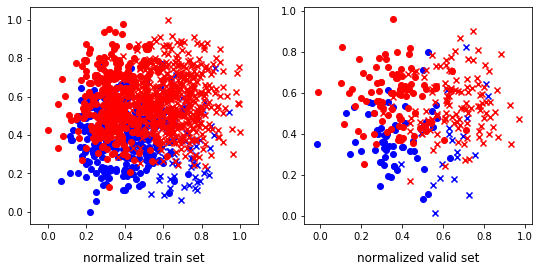

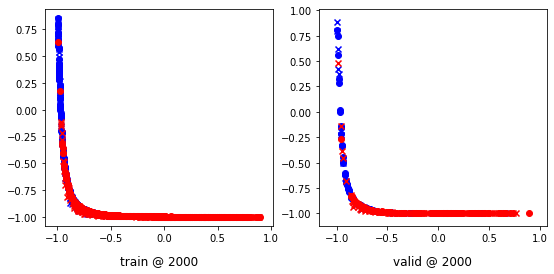

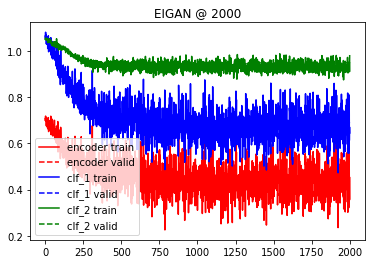

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<01:49, 18.30it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.03834362 	 0.03711531 	 -0.03650404 	 -0.03746554 	 -0.07346109 	 -0.07309496


 25%|██▌       | 504/2001 [00:27<01:19, 18.92it/s]

500 	 0.01115016 	 0.01333469 	 -0.10213362 	 -0.09899089 	 -0.13657536 	 -0.13515009


 50%|█████     | 1002/2001 [00:54<00:50, 19.84it/s]

1000 	 0.01805373 	 0.01688869 	 -0.13291501 	 -0.13323046 	 -0.18853533 	 -0.18745212


 75%|███████▌  | 1504/2001 [01:21<00:29, 16.66it/s]

1500 	 0.01510195 	 0.00987892 	 -0.17661044 	 -0.18240663 	 -0.23784885 	 -0.23850377


100%|██████████| 2001/2001 [01:48<00:00, 18.52it/s]


2000 	 0.00583956 	 0.01028620 	 -0.25488055 	 -0.24919029 	 -0.31060696 	 -0.30938834


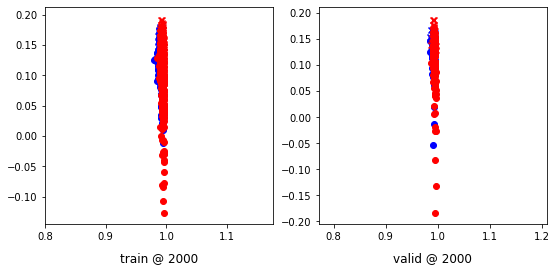

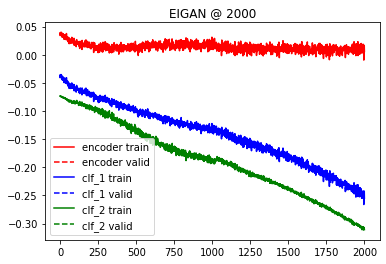

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.074364 	 1.073393 	 0.2828
200 	 0.711842 	 0.722854 	 0.8207
400 	 0.645725 	 0.667836 	 0.8069
600 	 0.643349 	 0.663181 	 0.8103
800 	 0.641161 	 0.663283 	 0.8034
1000 	 0.640203 	 0.663236 	 0.7966
Accuracy: 0.7965517241379311
Error Rate: 0.20344827586206896
F1 Score: 0.856447688564477
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7689655172413793
Error Rate: 0.23103448275862068
F1 Score: 0.8259740259740259
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8068965517241379
Error Rate: 0.19

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.536772 	 0.502964 	 0.8483
Accuracy: 0.8482758620689655
Error Rate: 0.15172413793103448
F1 Score: 0.846153846153846
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8310344827586207
Error Rate: 0.16896551724137931
F1 Score: 0.8372093023255814
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8482758620689655
Error Rate: 0.15172413793103448
F1 Score: 0.8439716312056738
VAR1: 0.6, VAR2: 0.2, TRIAL: 5
X, y_1, y2
(1651, 2) (1651, 1) (1651, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1320, 2) (331, 2) (1320, 1) (331, 1) (1320, 1) (331, 1)
class weights => w1, w2 [2.44897959 1.69014085] [2.01834862 1.98198198]
tensor sizes => torch.Size([1320, 2]) torch.Size([331, 2]) torch.Size([1320, 2]) torch.Size([331, 2]) torch.Size([1320, 2]) torch.Size([331, 2])
--------------------------------------------------------------------------------
EIGAN Training
------

  0%|          | 3/2001 [00:00<01:32, 21.70it/s]

0 	 0.66995430 	 0.66761363 	 1.02165592 	 1.01930511 	 1.04502082 	 1.04483867


 25%|██▌       | 503/2001 [00:29<01:27, 17.21it/s]

500 	 0.07314664 	 0.06347564 	 0.30000407 	 0.30223480 	 0.91999727 	 0.93190634


 50%|█████     | 1003/2001 [00:59<00:51, 19.21it/s]

1000 	 -0.19185987 	 -0.18575275 	 0.03815182 	 0.04961658 	 0.92315346 	 0.92851651


 75%|███████▌  | 1504/2001 [01:29<00:27, 18.28it/s]

1500 	 -0.20368621 	 -0.20767668 	 0.03826118 	 0.02775892 	 0.93512779 	 0.92858279


100%|██████████| 2001/2001 [01:58<00:00, 16.87it/s]


2000 	 -0.23758648 	 -0.21130966 	 0.02603425 	 0.02413405 	 0.95688003 	 0.92859089


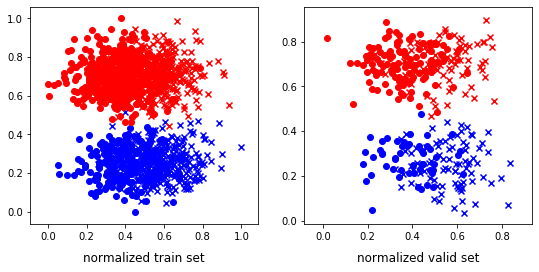

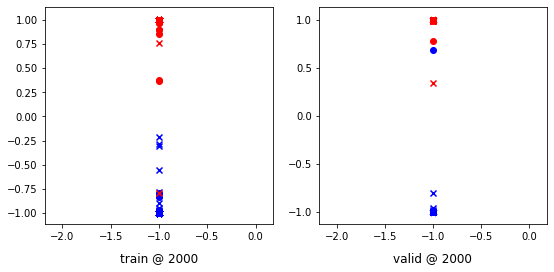

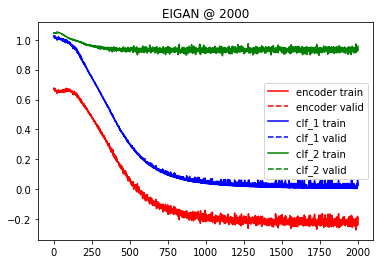

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:25, 23.38it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.03723087 	 0.03749846 	 -0.03586939 	 -0.03505164 	 -0.07035499 	 -0.06935126


 25%|██▌       | 503/2001 [00:28<01:27, 17.14it/s]

500 	 0.01149198 	 0.01469655 	 -0.08741503 	 -0.08650364 	 -0.11446422 	 -0.11811976


 50%|█████     | 1004/2001 [00:57<00:50, 19.75it/s]

1000 	 -0.00905246 	 -0.01060040 	 -0.16338919 	 -0.16561052 	 -0.19284981 	 -0.19371323


 75%|███████▌  | 1502/2001 [01:26<00:29, 16.81it/s]

1500 	 0.01420824 	 0.00648297 	 -0.23999828 	 -0.24450757 	 -0.30418637 	 -0.30098954


100%|██████████| 2001/2001 [01:55<00:00, 17.36it/s]


2000 	 0.05632433 	 0.05157191 	 -0.32863557 	 -0.33992380 	 -0.42045042 	 -0.42569619


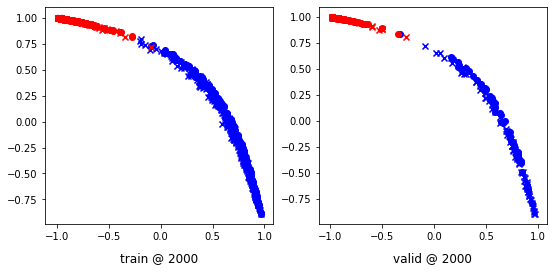

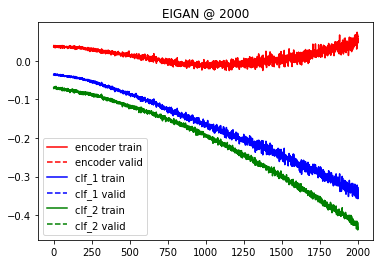

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.050929 	 1.051017 	 0.4079
200 	 0.404418 	 0.408923 	 0.9909
400 	 0.071364 	 0.076119 	 0.9940
600 	 0.034141 	 0.037260 	 0.9940
800 	 0.023386 	 0.025436 	 0.9940
1000 	 0.018703 	 0.020016 	 0.9940
Accuracy: 0.9939577039274925
Error Rate: 0.006042296072507553
F1 Score: 0.9948979591836735
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9939577039274925
Error Rate: 0.006042296072507553
F1 Score: 0.9948979591836735
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9969788519637462
Error Rate: 0

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.5981873111782477
Error Rate: 0.40181268882175225
F1 Score: 0.561056105610561
VAR1: 0.6, VAR2: 0.4, TRIAL: 5
X, y_1, y2
(2707, 2) (2707, 1) (2707, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2165, 2) (542, 2) (2165, 1) (542, 1) (2165, 1) (542, 1)
class weights => w1, w2 [1.52679831 2.89825971] [2.42170022 1.70338316]
tensor sizes => torch.Size([2165, 2]) torch.Size([542, 2]) torch.Size([2165, 2]) torch.Size([542, 2]) torch.Size([2165, 2]) torch.Size([542, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.77443683 	 0.73702550 	 1.10556686 	 1.06900740 	 1.02454793 	 1.02512908


 25%|██▌       | 503/2001 [00:46<02:17, 10.86it/s]

500 	 0.13346016 	 0.13739079 	 0.36963978 	 0.36906171 	 0.92951030 	 0.92481810


 50%|█████     | 1002/2001 [01:32<01:27, 11.43it/s]

1000 	 0.24075326 	 0.08988246 	 0.47751093 	 0.31363764 	 0.93121874 	 0.91690236


 75%|███████▌  | 1502/2001 [02:18<00:45, 10.97it/s]

1500 	 0.11497471 	 0.07954198 	 0.38598362 	 0.30442822 	 0.96591306 	 0.91803342


100%|██████████| 2001/2001 [03:05<00:00, 10.76it/s]


2000 	 0.13347745 	 0.07710978 	 0.42584842 	 0.30342671 	 0.98634475 	 0.91946411


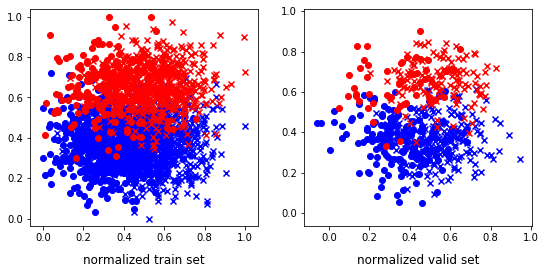

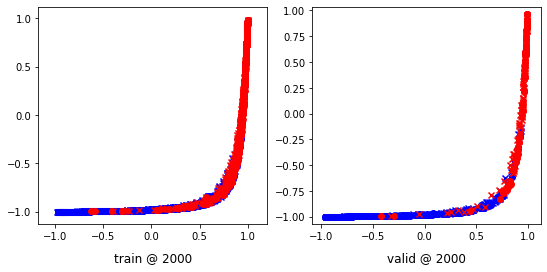

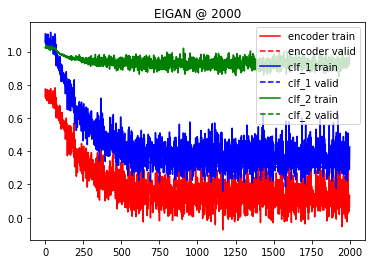

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 1/2001 [00:00<04:04,  8.19it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.00222774 	 -0.00365166 	 -0.03105011 	 -0.03269116 	 0.03041395 	 0.02959018


 25%|██▌       | 503/2001 [00:44<02:16, 10.98it/s]

500 	 -0.16896805 	 -0.16773781 	 -0.21964327 	 -0.22071870 	 -0.02508430 	 -0.03017578


 50%|█████     | 1003/2001 [01:28<01:32, 10.83it/s]

1000 	 -0.26929581 	 -0.26742822 	 -0.37081987 	 -0.36985660 	 -0.11862434 	 -0.12004430


 75%|███████▌  | 1503/2001 [02:13<00:46, 10.77it/s]

1500 	 -0.36581326 	 -0.37936616 	 -0.54809999 	 -0.56010711 	 -0.22695014 	 -0.22513638


100%|██████████| 2001/2001 [02:58<00:00, 11.23it/s]


2000 	 -0.46961218 	 -0.48781189 	 -0.77199227 	 -0.79029447 	 -0.34989098 	 -0.34998414


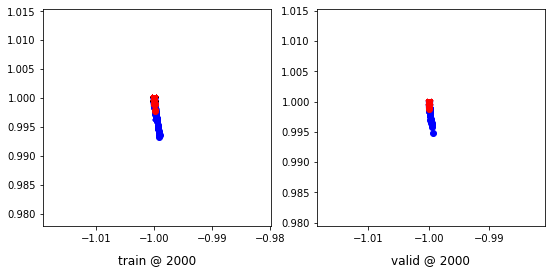

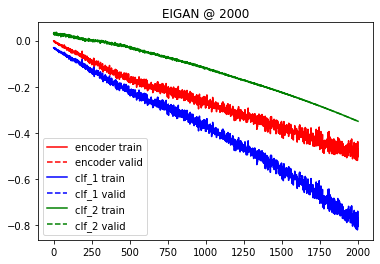

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.017267 	 1.017182 	 0.6550
200 	 0.746690 	 0.741770 	 0.8727
400 	 0.366554 	 0.323083 	 0.9317
600 	 0.356361 	 0.304755 	 0.9317
800 	 0.355919 	 0.303731 	 0.9336
1000 	 0.355708 	 0.303554 	 0.9336
Accuracy: 0.933579335793358
Error Rate: 0.06642066420664207
F1 Score: 0.9037433155080212
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9188191881918819
Error Rate: 0.08118081180811808
F1 Score: 0.8865979381443299
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9261992619926199
Error Rate: 0.07

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.5885608856088561
Error Rate: 0.4114391143911439
F1 Score: 0.7409988385598142
VAR1: 0.6, VAR2: 0.6, TRIAL: 5
X, y_1, y2
(2496, 2) (2496, 1) (2496, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1996, 2) (500, 2) (1996, 1) (500, 1) (1996, 1) (500, 1)
class weights => w1, w2 [1.61358124 2.62977602] [1.44637681 3.24025974]
tensor sizes => torch.Size([1996, 2]) torch.Size([500, 2]) torch.Size([1996, 2]) torch.Size([500, 2]) torch.Size([1996, 2]) torch.Size([500, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid


  0%|          | 3/2001 [00:00<03:35,  9.29it/s]

0 	 0.65413344 	 0.65555251 	 1.03011942 	 1.02922130 	 1.06936574 	 1.06681597


 25%|██▌       | 503/2001 [00:36<01:58, 12.66it/s]

500 	 0.59632343 	 0.58068824 	 0.83430064 	 0.81514728 	 0.93116045 	 0.92760623


 50%|█████     | 1002/2001 [01:11<01:04, 15.43it/s]

1000 	 0.40463221 	 0.37443417 	 0.63530833 	 0.60433292 	 0.92382145 	 0.92304593


 75%|███████▌  | 1502/2001 [01:47<00:38, 12.81it/s]

1500 	 0.40959054 	 0.35491943 	 0.63783997 	 0.58598304 	 0.92136687 	 0.92421079


100%|██████████| 2001/2001 [02:23<00:00, 13.94it/s]


2000 	 0.41945946 	 0.34946728 	 0.65297920 	 0.58130217 	 0.92668355 	 0.92498207


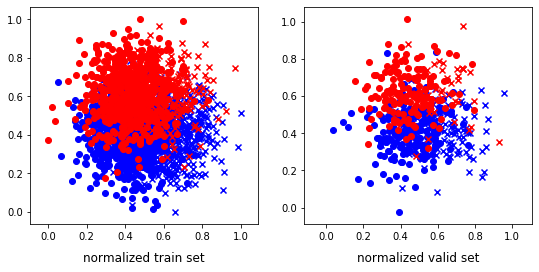

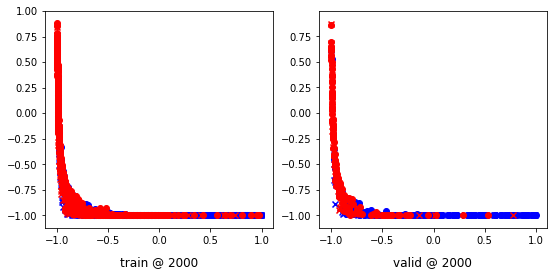

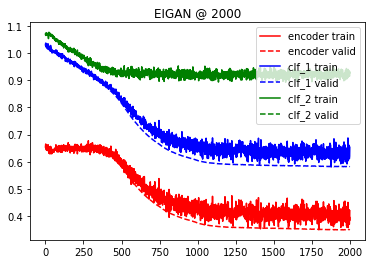

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<01:50, 18.16it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.00734603 	 0.00866925 	 -0.03601047 	 -0.03466128 	 -0.00806812 	 -0.00815988


 25%|██▌       | 503/2001 [00:34<01:35, 15.74it/s]

500 	 -0.07900058 	 -0.07856555 	 -0.15726268 	 -0.15722468 	 -0.07971735 	 -0.08046234


 50%|█████     | 1003/2001 [01:08<00:57, 17.32it/s]

1000 	 -0.11112449 	 -0.11089046 	 -0.24916679 	 -0.24945834 	 -0.17153993 	 -0.17224707


 75%|███████▌  | 1503/2001 [01:42<00:34, 14.56it/s]

1500 	 -0.13104364 	 -0.12977171 	 -0.31013799 	 -0.31007585 	 -0.22317033 	 -0.22462235


100%|██████████| 2001/2001 [02:17<00:00, 14.60it/s]


2000 	 -0.17038648 	 -0.17045878 	 -0.35149485 	 -0.35016444 	 -0.22556609 	 -0.22391704


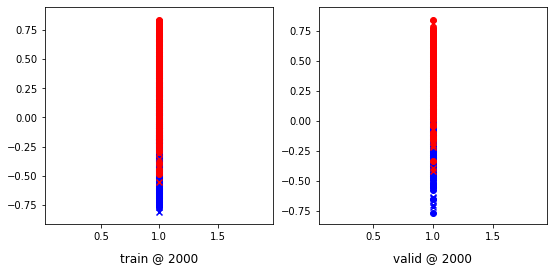

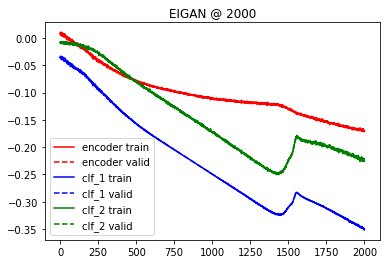

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 0.997102 	 0.997999 	 0.6180
200 	 0.698731 	 0.677607 	 0.8200
400 	 0.627476 	 0.575449 	 0.8280
600 	 0.626619 	 0.573714 	 0.8300
800 	 0.626533 	 0.573693 	 0.8300
1000 	 0.626476 	 0.573722 	 0.8300
Accuracy: 0.83
Error Rate: 0.17
F1 Score: 0.7769028871391077
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.814
Error Rate: 0.186
F1 Score: 0.7726161369193154
SVM
--------------------------------------------------------------------------------
Accuracy: 0.826
Error Rate: 0.174
F1 Score: 0.7716535433070866
-------------------------------------

  0%|          | 2/2001 [00:00<02:00, 16.54it/s]

Accuracy: 0.692
Error Rate: 0.308
F1 Score: 0.0
VAR1: 0.6, VAR2: 0.8, TRIAL: 5
X, y_1, y2
(3356, 2) (3356, 1) (3356, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2684, 2) (672, 2) (2684, 1) (672, 1) (2684, 1) (672, 1)
class weights => w1, w2 [1.87038328 2.14891914] [1.90625    2.10344828]
tensor sizes => torch.Size([2684, 2]) torch.Size([672, 2]) torch.Size([2684, 2]) torch.Size([672, 2]) torch.Size([2684, 2]) torch.Size([672, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.69357169 	 0.70487034 	 1.02717602 	 1.03942001 	 1.02675998 	 1.02769685


 25%|██▌       | 502/2001 [00:49<02:14, 11.13it/s]

500 	 0.49417418 	 0.47614920 	 0.75622535 	 0.73799515 	 0.95547408 	 0.95499313


 50%|█████     | 1002/2001 [01:40<01:42,  9.73it/s]

1000 	 0.44923925 	 0.46779531 	 0.70861113 	 0.72963637 	 0.95264167 	 0.95498824


 75%|███████▌  | 1501/2001 [02:30<00:47, 10.53it/s]

1500 	 0.49680471 	 0.46580350 	 0.75468373 	 0.72770107 	 0.95320481 	 0.95504475


100%|██████████| 2001/2001 [03:21<00:00,  9.92it/s]


2000 	 0.48613089 	 0.46567547 	 0.74925518 	 0.72742081 	 0.95735335 	 0.95489252


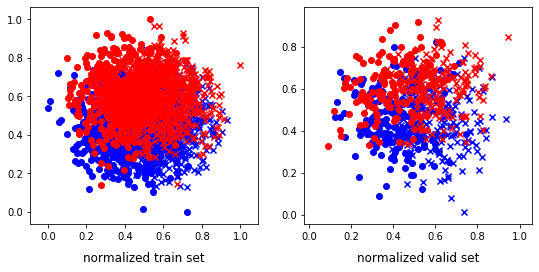

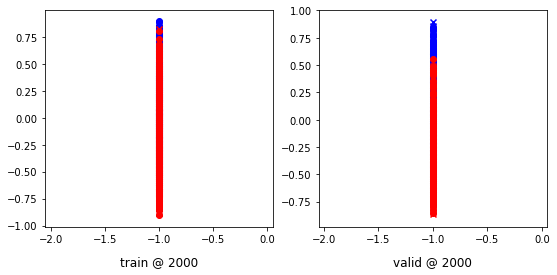

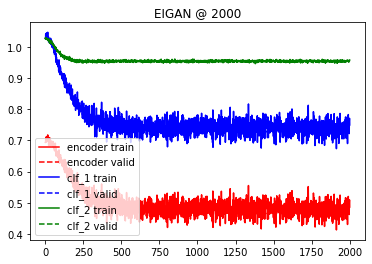

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:22, 14.08it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.04134982 	 0.04091360 	 -0.04939388 	 -0.04948689 	 -0.10114126 	 -0.10066673


 25%|██▌       | 501/2001 [00:48<02:15, 11.10it/s]

500 	 0.02090906 	 0.02004115 	 -0.12648578 	 -0.12657854 	 -0.18391941 	 -0.18290950


 50%|█████     | 1003/2001 [01:37<01:36, 10.38it/s]

1000 	 -0.10666364 	 -0.10460418 	 -0.42317596 	 -0.42082632 	 -0.36259320 	 -0.36233631


 75%|███████▌  | 1501/2001 [02:26<00:45, 10.89it/s]

1500 	 -0.14121825 	 -0.14074945 	 -0.57996762 	 -0.58285147 	 -0.46237743 	 -0.46490753


100%|██████████| 2001/2001 [03:15<00:00, 10.21it/s]


2000 	 -0.15049797 	 -0.13941967 	 -0.82847553 	 -0.82182050 	 -0.62339354 	 -0.62607557


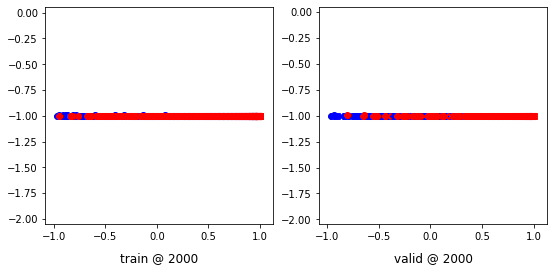

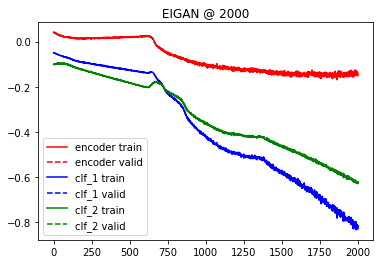

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 0.997105 	 0.996914 	 0.5357
200 	 0.853204 	 0.845313 	 0.7336
400 	 0.740381 	 0.724835 	 0.7396
600 	 0.739679 	 0.725706 	 0.7396
800 	 0.739335 	 0.726783 	 0.7396
1000 	 0.739021 	 0.728025 	 0.7396
Accuracy: 0.7395833333333334
Error Rate: 0.2604166666666667
F1 Score: 0.7252747252747254
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7276785714285714
Error Rate: 0.27232142857142855
F1 Score: 0.7180277349768875
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7336309523809523
Error Rate: 0.26

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.5699404761904762
Error Rate: 0.43005952380952384
F1 Score: 0.5654135338345864
VAR1: 0.8, VAR2: 0.2, TRIAL: 5
X, y_1, y2
(2849, 2) (2849, 1) (2849, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2279, 2) (570, 2) (2279, 1) (570, 1) (2279, 1) (570, 1)
class weights => w1, w2 [2.31370558 1.76120556] [1.57280883 2.74578313]
tensor sizes => torch.Size([2279, 2]) torch.Size([570, 2]) torch.Size([2279, 2]) torch.Size([570, 2]) torch.Size([2279, 2]) torch.Size([570, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.72400093 	 0.71896589 	 1.05335128 	 1.04503536 	 1.02286398 	 1.01921666


 25%|██▌       | 503/2001 [00:47<02:13, 11.22it/s]

500 	 -0.04905806 	 -0.11158313 	 0.07570183 	 0.07838695 	 0.81849265 	 0.88311726


 50%|█████     | 1002/2001 [01:34<01:35, 10.41it/s]

1000 	 -0.18961164 	 -0.15816915 	 0.01404029 	 0.03139151 	 0.89682567 	 0.88270783


 75%|███████▌  | 1503/2001 [02:22<00:46, 10.76it/s]

1500 	 -0.15360171 	 -0.16636749 	 0.02723755 	 0.02372043 	 0.87388355 	 0.88323510


100%|██████████| 2001/2001 [03:09<00:00, 10.59it/s]


2000 	 -0.19383524 	 -0.17843835 	 0.00844557 	 0.01665665 	 0.89583063 	 0.88824219


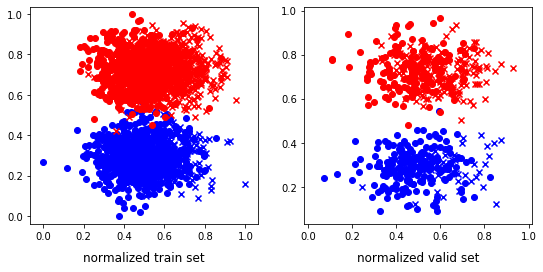

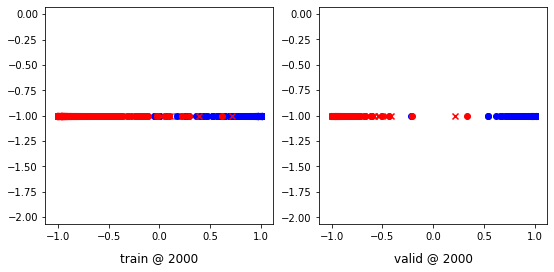

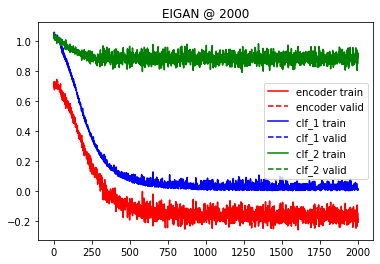

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:53, 11.53it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.06594950 	 0.06486813 	 0.00920343 	 0.00806204 	 -0.03818772 	 -0.03834029


 25%|██▌       | 502/2001 [00:45<01:51, 13.43it/s]

500 	 -0.05967809 	 -0.06652296 	 -0.15556431 	 -0.15983833 	 -0.10955467 	 -0.10547564


 50%|█████     | 1003/2001 [01:31<01:31, 10.88it/s]

1000 	 -0.23064274 	 -0.23355693 	 -0.37731716 	 -0.38261130 	 -0.18296961 	 -0.18607563


 75%|███████▌  | 1502/2001 [02:16<00:48, 10.37it/s]

1500 	 -0.34040743 	 -0.35025397 	 -0.58992833 	 -0.59505421 	 -0.29951808 	 -0.29477289


100%|██████████| 2001/2001 [03:01<00:00, 11.00it/s]

2000 	 -0.44296566 	 -0.44113874 	 -0.82958704 	 -0.82982075 	 -0.42178875 	 -0.42344365


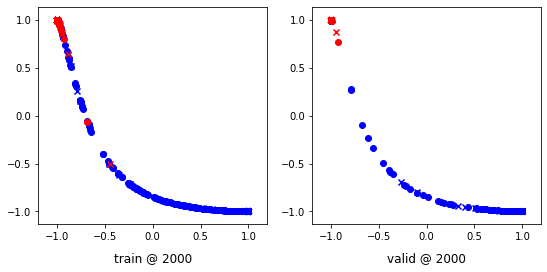

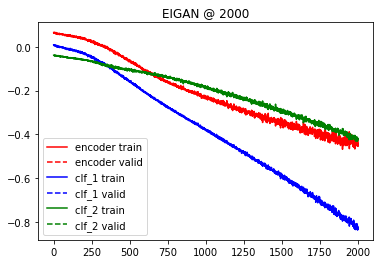

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.052428 	 1.052341 	 0.5684
200 	 0.423142 	 0.418390 	 0.9930
400 	 0.071437 	 0.058162 	 0.9965
600 	 0.039819 	 0.027355 	 0.9965
800 	 0.029080 	 0.017665 	 0.9965
1000 	 0.025327 	 0.014635 	 0.9965
Accuracy: 0.9964912280701754
Error Rate: 0.0035087719298245615
F1 Score: 0.9969135802469136
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9964912280701754
Error Rate: 0.0035087719298245615
F1 Score: 0.9969135802469136
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9964912280701754
Error Rate:

  0%|          | 3/2001 [00:00<01:14, 26.89it/s]

Accuracy: 0.6368421052631579
Error Rate: 0.3631578947368421
F1 Score: 0.0
VAR1: 0.8, VAR2: 0.4, TRIAL: 5
X, y_1, y2
(1691, 2) (1691, 1) (1691, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1352, 2) (339, 2) (1352, 1) (339, 1) (1352, 1) (339, 1)
class weights => w1, w2 [1.95942029 2.04229607] [1.71573604 2.39716312]
tensor sizes => torch.Size([1352, 2]) torch.Size([339, 2]) torch.Size([1352, 2]) torch.Size([339, 2]) torch.Size([1352, 2]) torch.Size([339, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.69318116 	 0.69975495 	 1.05975723 	 1.06177104 	 1.05989838 	 1.05516326


 25%|██▌       | 502/2001 [00:29<01:30, 16.62it/s]

500 	 0.23717204 	 0.19107056 	 0.46699437 	 0.42946315 	 0.92335057 	 0.93153977


 50%|█████     | 1003/2001 [00:59<00:56, 17.76it/s]

1000 	 0.07700980 	 0.09783202 	 0.29560137 	 0.33617342 	 0.91177887 	 0.93148857


 75%|███████▌  | 1504/2001 [01:29<00:30, 16.41it/s]

1500 	 0.10337511 	 0.07954109 	 0.33719724 	 0.31748664 	 0.92689359 	 0.93109274


100%|██████████| 2001/2001 [01:59<00:00, 16.78it/s]


2000 	 0.07471919 	 0.07457283 	 0.29274777 	 0.31618366 	 0.91401052 	 0.93475801


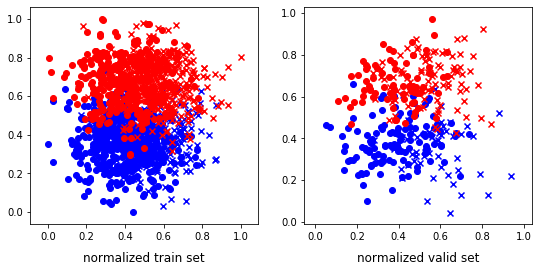

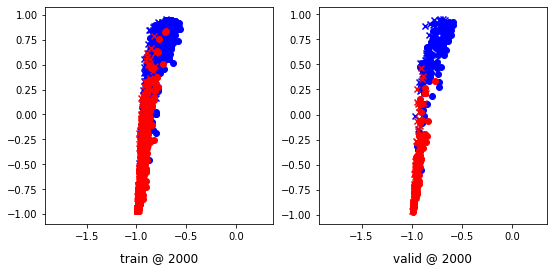

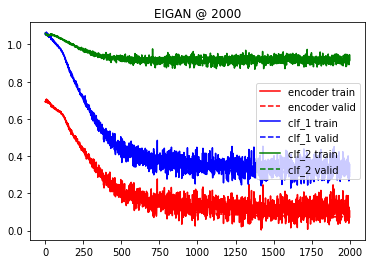

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:39, 20.04it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.00247755 	 0.01177491 	 -0.05738454 	 -0.05099430 	 -0.04461763 	 -0.05053785


 25%|██▌       | 503/2001 [00:29<01:25, 17.60it/s]

500 	 -0.03149935 	 -0.04233750 	 -0.12907353 	 -0.13597295 	 -0.11231631 	 -0.10599910


 50%|█████     | 1004/2001 [00:57<00:55, 17.90it/s]

1000 	 -0.08648925 	 -0.09692559 	 -0.24490039 	 -0.25510868 	 -0.19800378 	 -0.19772239


 75%|███████▌  | 1503/2001 [01:26<00:30, 16.50it/s]

1500 	 -0.13332422 	 -0.13229381 	 -0.38097221 	 -0.37749121 	 -0.29764205 	 -0.29517409


100%|██████████| 2001/2001 [01:53<00:00, 17.57it/s]


2000 	 -0.14979926 	 -0.15201223 	 -0.51705062 	 -0.51507044 	 -0.40601262 	 -0.40254310


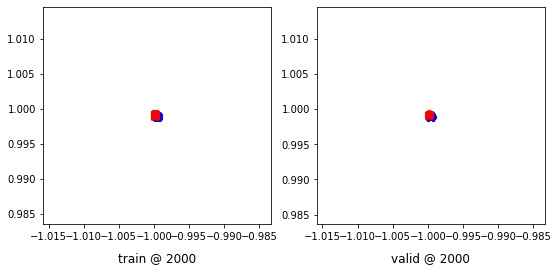

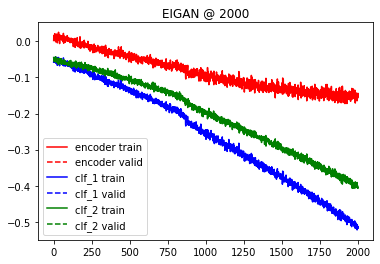

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.027965 	 1.027777 	 0.4897
200 	 0.818791 	 0.820501 	 0.8201
400 	 0.362903 	 0.349360 	 0.9056
600 	 0.330272 	 0.308309 	 0.9086
800 	 0.329391 	 0.305887 	 0.9086
1000 	 0.329297 	 0.305511 	 0.9086
Accuracy: 0.9085545722713865
Error Rate: 0.09144542772861357
F1 Score: 0.9080118694362017
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.911504424778761
Error Rate: 0.08849557522123894
F1 Score: 0.9112426035502958
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9174041297935103
Error Rate: 0.08

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.584070796460177
Error Rate: 0.415929203539823
F1 Score: 0.0
VAR1: 0.8, VAR2: 0.6, TRIAL: 5
X, y_1, y2
(1617, 2) (1617, 1) (1617, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1293, 2) (324, 2) (1293, 1) (324, 1) (1293, 1) (324, 1)
class weights => w1, w2 [4.07886435 1.32479508] [1.93853073 2.06549521]
tensor sizes => torch.Size([1293, 2]) torch.Size([324, 2]) torch.Size([1293, 2]) torch.Size([324, 2]) torch.Size([1293, 2]) torch.Size([324, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.70452952 	 0.71893680 	 1.01807046 	 1.03186417 	 1.00676548 	 1.00607455


 25%|██▌       | 504/2001 [00:29<01:29, 16.78it/s]

500 	 0.59140062 	 0.60413945 	 0.85138571 	 0.85059214 	 0.95329154 	 0.93959987


 50%|█████     | 1003/2001 [00:58<01:00, 16.58it/s]

1000 	 0.41041613 	 0.42545092 	 0.60210943 	 0.60175520 	 0.88462991 	 0.86945146


 75%|███████▌  | 1502/2001 [01:28<00:33, 15.00it/s]

1500 	 0.33094138 	 0.41486251 	 0.51255745 	 0.58468121 	 0.87631112 	 0.86296588


100%|██████████| 2001/2001 [01:58<00:00, 16.95it/s]


2000 	 0.34452397 	 0.40724283 	 0.53651601 	 0.58810025 	 0.88493747 	 0.87400460


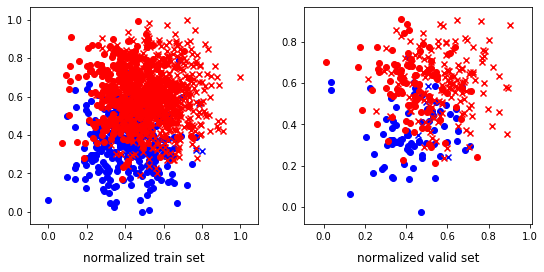

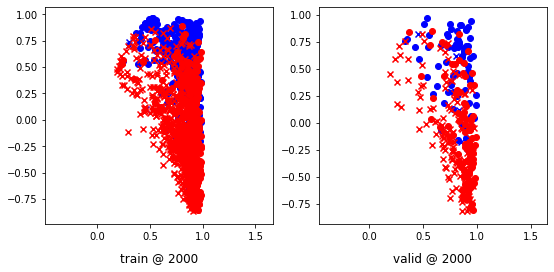

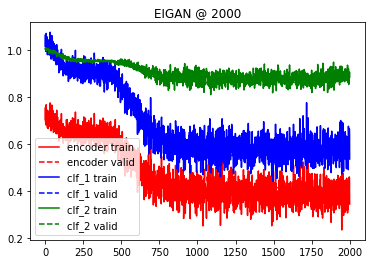

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:35, 20.92it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.03825422 	 0.03956506 	 -0.00488802 	 -0.00378290 	 -0.00765448 	 -0.00820174


 25%|██▌       | 504/2001 [00:28<01:21, 18.38it/s]

500 	 -0.07179555 	 -0.07279548 	 -0.11363795 	 -0.11458249 	 -0.00448537 	 -0.00441870


 50%|█████     | 1004/2001 [00:57<00:59, 16.82it/s]

1000 	 -0.12530594 	 -0.12857026 	 -0.18727706 	 -0.18985884 	 -0.04893731 	 -0.04756531


 75%|███████▌  | 1503/2001 [01:25<00:29, 16.94it/s]

1500 	 -0.18464024 	 -0.18162894 	 -0.27278250 	 -0.26940835 	 -0.09688712 	 -0.09627588


100%|██████████| 2001/2001 [01:53<00:00, 17.57it/s]


2000 	 -0.23620784 	 -0.24076396 	 -0.35760140 	 -0.36214375 	 -0.14841561 	 -0.14839603


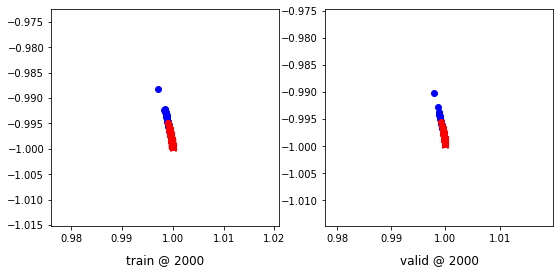

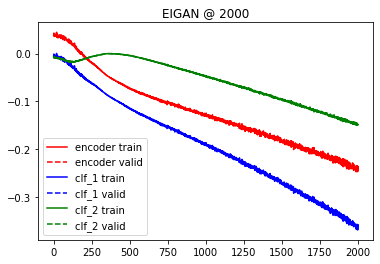

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.049325 	 1.051676 	 0.7531
200 	 0.790822 	 0.793747 	 0.7531
400 	 0.549567 	 0.554348 	 0.8333
600 	 0.542263 	 0.551151 	 0.8426
800 	 0.541576 	 0.551308 	 0.8395
1000 	 0.541410 	 0.551377 	 0.8395
Accuracy: 0.8395061728395061
Error Rate: 0.16049382716049382
F1 Score: 0.8925619834710743
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.808641975308642
Error Rate: 0.19135802469135801
F1 Score: 0.8652173913043477
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8302469135802469
Error Rate: 0.16

  0%|          | 2/2001 [00:00<01:41, 19.71it/s]

Accuracy: 0.5154320987654321
Error Rate: 0.4845679012345679
F1 Score: 0.0
VAR1: 0.8, VAR2: 0.8, TRIAL: 5
X, y_1, y2
(1558, 2) (1558, 1) (1558, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1246, 2) (312, 2) (1246, 1) (312, 1) (1246, 1) (312, 1)
class weights => w1, w2 [2.66239316 1.60154242] [1.25858586 4.8671875 ]
tensor sizes => torch.Size([1246, 2]) torch.Size([312, 2]) torch.Size([1246, 2]) torch.Size([312, 2]) torch.Size([1246, 2]) torch.Size([312, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.65636802 	 0.63524961 	 1.01666701 	 1.01761115 	 1.05368578 	 1.07550871


 25%|██▌       | 503/2001 [00:29<01:35, 15.68it/s]

500 	 0.50911689 	 0.54036838 	 0.71116585 	 0.74722511 	 0.89530587 	 0.90000391


 50%|█████     | 1004/2001 [00:58<00:54, 18.37it/s]

1000 	 0.58193570 	 0.53270817 	 0.77372825 	 0.72127426 	 0.88607091 	 0.88171327


 75%|███████▌  | 1504/2001 [01:27<00:28, 17.19it/s]

1500 	 0.51705861 	 0.53942841 	 0.78079760 	 0.71804607 	 0.95898426 	 0.87176484


100%|██████████| 2001/2001 [01:57<00:00, 17.03it/s]


2000 	 0.48213339 	 0.53613156 	 0.70916885 	 0.71597433 	 0.92016101 	 0.87298995


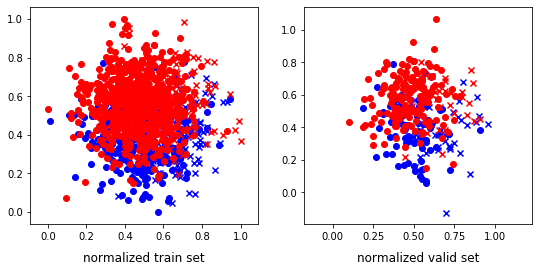

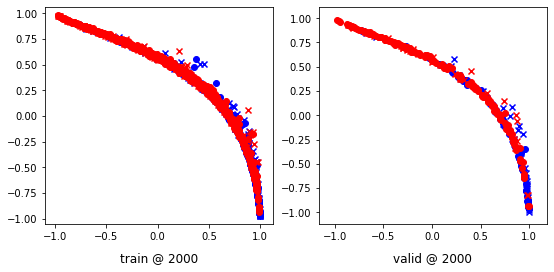

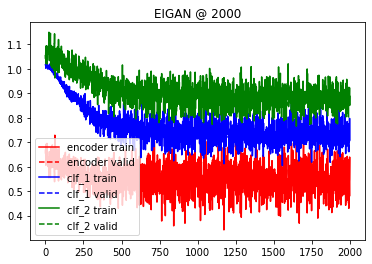

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:34, 21.26it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.11658621 	 0.10726942 	 0.04491586 	 0.03665587 	 -0.06769092 	 -0.06573210


 25%|██▌       | 504/2001 [00:28<01:17, 19.25it/s]

500 	 0.08096287 	 0.07732687 	 -0.01148043 	 -0.01469296 	 -0.10402482 	 -0.10334770


 50%|█████     | 1004/2001 [00:57<00:57, 17.36it/s]

1000 	 0.02131281 	 0.01937927 	 -0.10182960 	 -0.10427970 	 -0.15089519 	 -0.15165177


 75%|███████▌  | 1503/2001 [01:24<00:30, 16.09it/s]

1500 	 -0.04033083 	 -0.03964397 	 -0.21658935 	 -0.21626453 	 -0.21982755 	 -0.22026248


100%|██████████| 2001/2001 [01:53<00:00, 17.67it/s]


2000 	 -0.08466859 	 -0.09999891 	 -0.32229987 	 -0.33803365 	 -0.28747404 	 -0.28788802


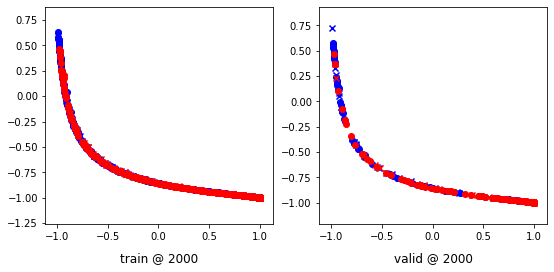

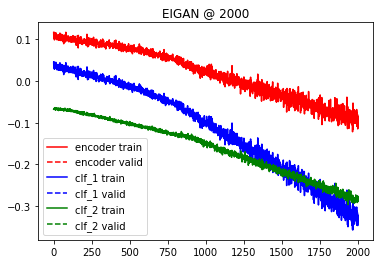

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.065296 	 1.063759 	 0.6250
200 	 0.780779 	 0.754332 	 0.7660
400 	 0.735954 	 0.712681 	 0.7500
600 	 0.733892 	 0.711664 	 0.7468
800 	 0.732685 	 0.712145 	 0.7436
1000 	 0.731742 	 0.713017 	 0.7436
Accuracy: 0.7435897435897436
Error Rate: 0.2564102564102564
F1 Score: 0.7938144329896906
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7467948717948718
Error Rate: 0.2532051282051282
F1 Score: 0.7882037533512064
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7532051282051282
Error Rate: 0.246

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.7948717948717948
Error Rate: 0.20512820512820512
F1 Score: 0.0
Writing trial 5 ...
VAR1: 0.2, VAR2: 0.2, TRIAL: 6
X, y_1, y2
(2492, 2) (2492, 1) (2492, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1993, 2) (499, 2) (1993, 1) (499, 1) (1993, 1) (499, 1)
class weights => w1, w2 [2.58831169 1.62959935] [1.56313725 2.77576602]
tensor sizes => torch.Size([1993, 2]) torch.Size([499, 2]) torch.Size([1993, 2]) torch.Size([499, 2]) torch.Size([1993, 2]) torch.Size([499, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.64962864 	 0.64671111 	 1.02717888 	 1.02762854 	 1.07109535 	 1.07406461


 25%|██▌       | 503/2001 [00:36<01:47, 13.95it/s]

500 	 -0.07778148 	 -0.05053185 	 0.18748964 	 0.19700773 	 0.95843637 	 0.94068676


 50%|█████     | 1002/2001 [01:12<01:10, 14.25it/s]

1000 	 -0.18894447 	 -0.18721044 	 0.05305295 	 0.05966330 	 0.93511093 	 0.94002092


 75%|███████▌  | 1504/2001 [01:47<00:27, 18.40it/s]

1500 	 -0.22687793 	 -0.19989812 	 0.02361604 	 0.04748093 	 0.94365185 	 0.94052625


100%|██████████| 2001/2001 [02:23<00:00, 13.97it/s]


2000 	 -0.21271038 	 -0.20208573 	 0.03284012 	 0.04455703 	 0.93871301 	 0.93978995


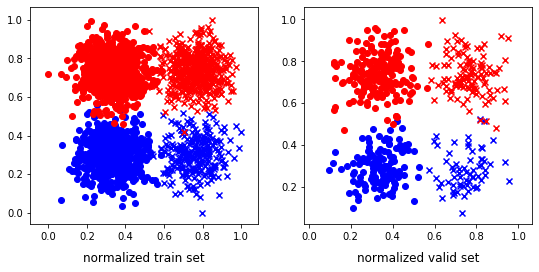

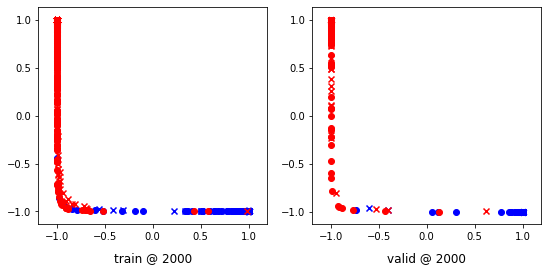

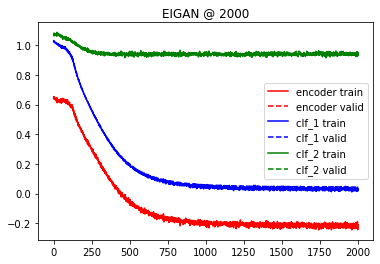

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<01:49, 18.24it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.02241711 	 0.02253273 	 -0.00682481 	 -0.00649364 	 0.02909411 	 0.02962872


 25%|██▌       | 503/2001 [00:34<01:45, 14.18it/s]

500 	 -0.03896086 	 -0.04154371 	 -0.07731292 	 -0.07985097 	 0.00423463 	 0.00427759


 50%|█████     | 1002/2001 [01:07<01:10, 14.25it/s]

1000 	 -0.11399288 	 -0.11271551 	 -0.17414981 	 -0.17319228 	 -0.04521028 	 -0.04592024


 75%|███████▌  | 1502/2001 [01:40<00:28, 17.77it/s]

1500 	 -0.19598952 	 -0.20019653 	 -0.28700709 	 -0.29044834 	 -0.10167266 	 -0.10041940


100%|██████████| 2001/2001 [02:14<00:00, 14.88it/s]


2000 	 -0.27956790 	 -0.27990365 	 -0.40978074 	 -0.40951866 	 -0.16084546 	 -0.16002081


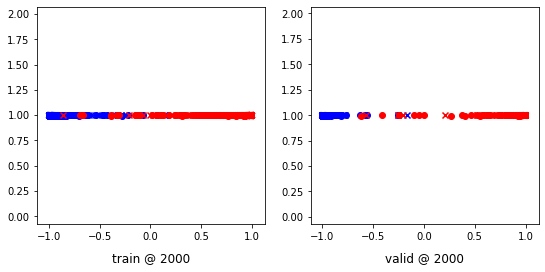

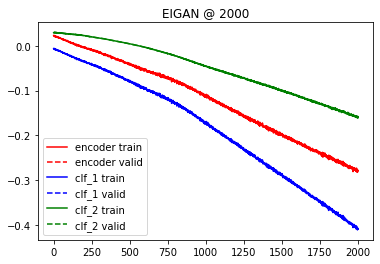

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.036147 	 1.036285 	 0.3868
200 	 0.276518 	 0.268628 	 0.9880
400 	 0.055218 	 0.055045 	 0.9880
600 	 0.036076 	 0.038152 	 0.9880
800 	 0.031088 	 0.033971 	 0.9880
1000 	 0.029211 	 0.032509 	 0.9880
Accuracy: 0.9879759519038076
Error Rate: 0.012024048096192385
F1 Score: 0.9901960784313726
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9879759519038076
Error Rate: 0.012024048096192385
F1 Score: 0.9901315789473684
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9879759519038076
Error Rate: 0

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.6392785571142284
Error Rate: 0.36072144288577157
F1 Score: 0.0
VAR1: 0.2, VAR2: 0.4, TRIAL: 6
X, y_1, y2
(2428, 2) (2428, 1) (2428, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1942, 2) (486, 2) (1942, 1) (486, 1) (1942, 1) (486, 1)
class weights => w1, w2 [1.73703041 2.35679612] [1.72163121 2.38574939]
tensor sizes => torch.Size([1942, 2]) torch.Size([486, 2]) torch.Size([1942, 2]) torch.Size([486, 2]) torch.Size([1942, 2]) torch.Size([486, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.74515486 	 0.74124002 	 1.05746698 	 1.05131257 	 1.00580680 	 1.00321972


 25%|██▌       | 503/2001 [00:35<01:37, 15.42it/s]

500 	 0.24891633 	 0.28891450 	 0.50363642 	 0.54490715 	 0.94796371 	 0.94913983


 50%|█████     | 1004/2001 [01:10<01:00, 16.57it/s]

1000 	 0.10303727 	 0.12910300 	 0.35518405 	 0.38728464 	 0.94570422 	 0.95132881


 75%|███████▌  | 1505/2001 [01:45<00:30, 16.39it/s]

1500 	 0.06413880 	 0.10848284 	 0.31913626 	 0.36734480 	 0.94810843 	 0.95200914


100%|██████████| 2001/2001 [02:20<00:00, 14.21it/s]


2000 	 0.06489480 	 0.10686412 	 0.31725228 	 0.36575523 	 0.94550323 	 0.95203829


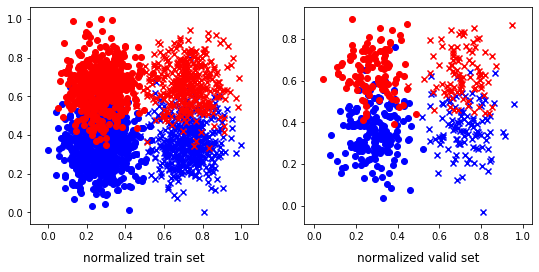

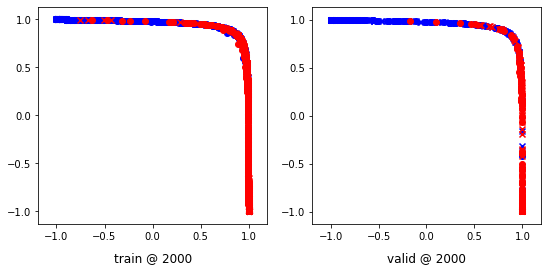

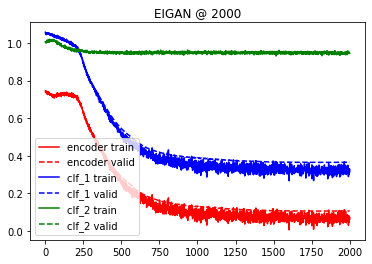

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:01, 16.40it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.00813845 	 0.00964021 	 -0.01338094 	 -0.01196960 	 0.05343601 	 0.05299725


 25%|██▌       | 502/2001 [00:32<01:47, 13.89it/s]

500 	 -0.05442531 	 -0.05373834 	 -0.08782931 	 -0.08725642 	 0.01734488 	 0.01692056


 50%|█████     | 1002/2001 [01:06<01:15, 13.22it/s]

1000 	 -0.10249799 	 -0.10158111 	 -0.17399769 	 -0.17347275 	 -0.06739175 	 -0.06812616


 75%|███████▌  | 1503/2001 [01:39<00:34, 14.54it/s]

1500 	 -0.13012934 	 -0.13093950 	 -0.26565066 	 -0.26638052 	 -0.16813201 	 -0.16802312


100%|██████████| 2001/2001 [02:14<00:00, 14.92it/s]


2000 	 -0.13971055 	 -0.13956952 	 -0.37364346 	 -0.37375176 	 -0.28366613 	 -0.28392377


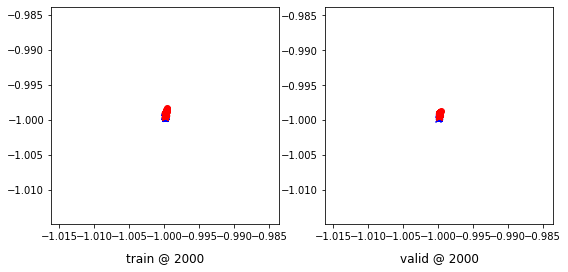

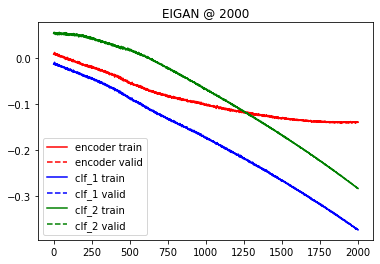

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.039303 	 1.038974 	 0.4239
200 	 0.681732 	 0.696160 	 0.8951
400 	 0.343623 	 0.379228 	 0.8909
600 	 0.320948 	 0.361317 	 0.8889
800 	 0.320522 	 0.361592 	 0.8889
1000 	 0.320412 	 0.361554 	 0.8889
Accuracy: 0.8888888888888888
Error Rate: 0.1111111111111111
F1 Score: 0.8701923076923077
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8806584362139918
Error Rate: 0.11934156378600823
F1 Score: 0.8625592417061612
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8868312757201646
Error Rate: 0.11

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.9917695473251029
Error Rate: 0.00823045267489712
F1 Score: 0.9902439024390244
VAR1: 0.2, VAR2: 0.6, TRIAL: 6
X, y_1, y2
(2934, 2) (2934, 1) (2934, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2347, 2) (587, 2) (2347, 1) (587, 1) (2347, 1) (587, 1)
class weights => w1, w2 [2.2964775  1.77132075] [2.71643519 1.58260283]
tensor sizes => torch.Size([2347, 2]) torch.Size([587, 2]) torch.Size([2347, 2]) torch.Size([587, 2]) torch.Size([2347, 2]) torch.Size([587, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.75721228 	 0.74524224 	 1.07494283 	 1.06869566 	 1.01104403 	 1.01660061


 25%|██▌       | 502/2001 [00:47<02:29, 10.01it/s]

500 	 0.38552690 	 0.35979337 	 0.62332332 	 0.60547268 	 0.93297613 	 0.93882650


 50%|█████     | 1002/2001 [01:35<01:33, 10.73it/s]

1000 	 0.38249034 	 0.33993393 	 0.63557428 	 0.59104675 	 0.94610155 	 0.94426000


 75%|███████▌  | 1503/2001 [02:21<00:42, 11.67it/s]

1500 	 0.39074564 	 0.33548683 	 0.62829012 	 0.58581054 	 0.93151283 	 0.94347090


100%|██████████| 2001/2001 [03:09<00:00, 10.58it/s]


2000 	 0.35669780 	 0.33457232 	 0.57639724 	 0.58544141 	 0.91297853 	 0.94401628


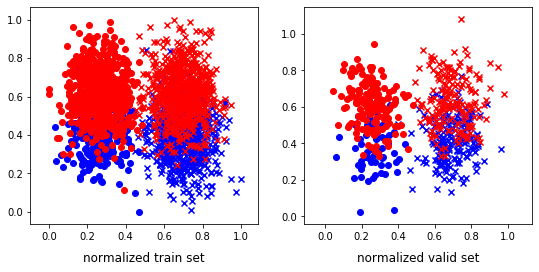

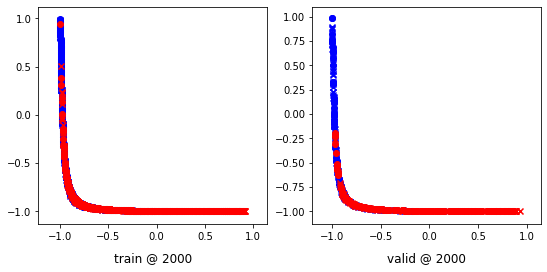

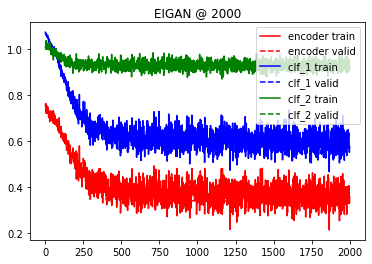

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:52, 11.58it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.00487103 	 0.00455269 	 -0.03921637 	 -0.03872220 	 -0.00981792 	 -0.00802618


 25%|██▌       | 502/2001 [00:45<02:09, 11.57it/s]

500 	 -0.09139719 	 -0.09051757 	 -0.17355645 	 -0.17335789 	 -0.08661986 	 -0.08781994


 50%|█████     | 1002/2001 [01:32<01:30, 11.02it/s]

1000 	 -0.16769066 	 -0.18811247 	 -0.30969566 	 -0.32344717 	 -0.17683519 	 -0.16787864


 75%|███████▌  | 1502/2001 [02:18<00:44, 11.15it/s]

1500 	 -0.29112124 	 -0.28838801 	 -0.50112230 	 -0.49671459 	 -0.25825864 	 -0.25642803


100%|██████████| 2001/2001 [03:04<00:00, 10.86it/s]

2000 	 -0.36076289 	 -0.39112386 	 -0.68627131 	 -0.70817959 	 -0.37053347 	 -0.36307701


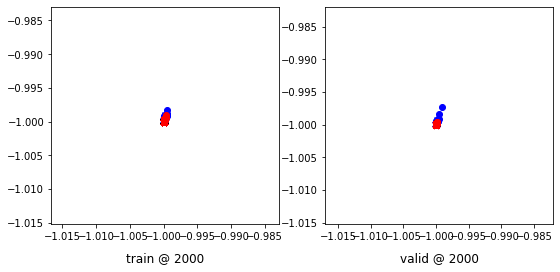

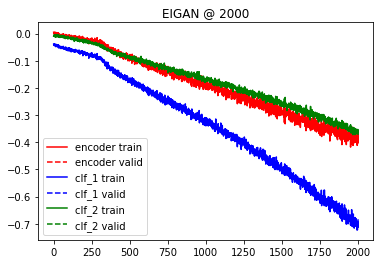

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.088474 	 1.088642 	 0.5639
200 	 0.663185 	 0.648969 	 0.8041
400 	 0.590449 	 0.567925 	 0.8007
600 	 0.588937 	 0.566488 	 0.8041
800 	 0.587862 	 0.565272 	 0.8024
1000 	 0.587286 	 0.564057 	 0.8058
Accuracy: 0.8057921635434412
Error Rate: 0.19420783645655879
F1 Score: 0.8256880733944953
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8040885860306644
Error Rate: 0.19591141396933562
F1 Score: 0.8217054263565892
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8109028960817717
Error Rate: 0.1

  0%|          | 3/2001 [00:00<01:20, 24.87it/s]

Accuracy: 0.9710391822827938
Error Rate: 0.028960817717206135
F1 Score: 0.9771197846567968
VAR1: 0.2, VAR2: 0.8, TRIAL: 6
X, y_1, y2
(1838, 2) (1838, 1) (1838, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1470, 2) (368, 2) (1470, 1) (368, 1) (1470, 1) (368, 1)
class weights => w1, w2 [2.09700428 1.91157347] [2.05882353 1.94444444]
tensor sizes => torch.Size([1470, 2]) torch.Size([368, 2]) torch.Size([1470, 2]) torch.Size([368, 2]) torch.Size([1470, 2]) torch.Size([368, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.71842861 	 0.71661556 	 1.06668544 	 1.06375921 	 1.04179978 	 1.04029083


 25%|██▌       | 502/2001 [00:30<01:48, 13.76it/s]

500 	 0.69214696 	 0.69292510 	 0.95380813 	 0.95428550 	 0.95480835 	 0.95450759


 50%|█████     | 1003/2001 [01:00<01:02, 16.09it/s]

1000 	 0.69776607 	 0.69293565 	 0.95838279 	 0.95428824 	 0.95376402 	 0.95449978


 75%|███████▌  | 1504/2001 [01:29<00:29, 16.58it/s]

1500 	 0.69372582 	 0.69291568 	 0.95402521 	 0.95427889 	 0.95344657 	 0.95451039


100%|██████████| 2001/2001 [01:59<00:00, 16.70it/s]


2000 	 0.69507933 	 0.69292223 	 0.95508152 	 0.95430917 	 0.95314938 	 0.95453411


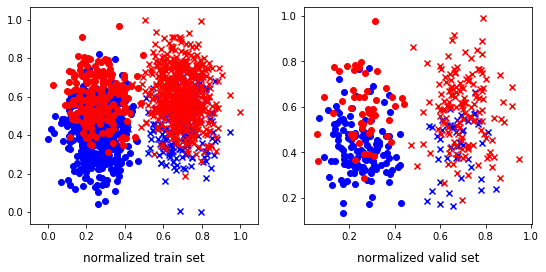

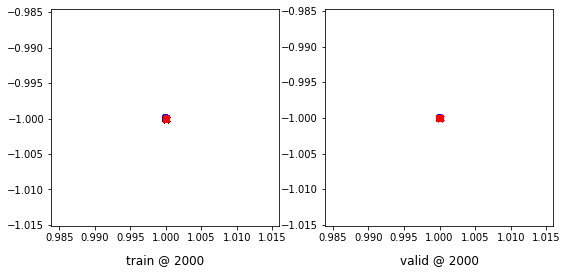

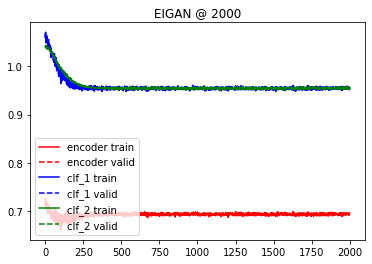

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:37, 20.56it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.07099000 	 0.07118413 	 0.03896804 	 0.03915507 	 0.02115433 	 0.02103336


 25%|██▌       | 504/2001 [00:29<01:38, 15.20it/s]

500 	 -0.00601120 	 -0.00579032 	 -0.04689610 	 -0.04684489 	 -0.00216550 	 -0.00261928


 50%|█████     | 1004/2001 [00:58<00:53, 18.80it/s]

1000 	 -0.03446174 	 -0.03473726 	 -0.11538289 	 -0.11558603 	 -0.08446548 	 -0.08433919


 75%|███████▌  | 1504/2001 [01:27<00:24, 19.93it/s]

1500 	 -0.05203138 	 -0.05124570 	 -0.17682362 	 -0.17699723 	 -0.15325840 	 -0.15461460


100%|██████████| 2001/2001 [01:56<00:00, 17.22it/s]


2000 	 -0.07534254 	 -0.07457850 	 -0.18946142 	 -0.19226414 	 -0.13780856 	 -0.14305341


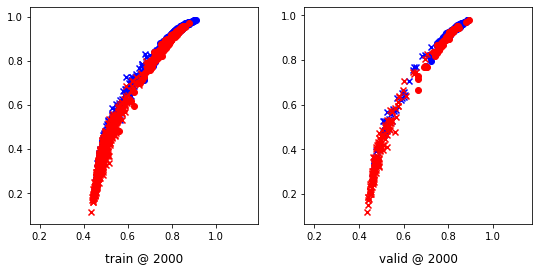

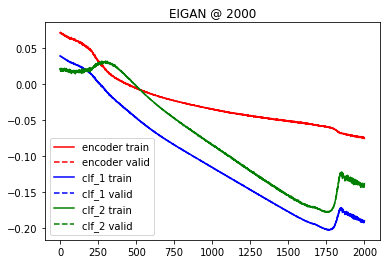

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.032661 	 1.032545 	 0.5245
200 	 0.913176 	 0.911188 	 0.6766
400 	 0.647726 	 0.649583 	 0.7582
600 	 0.629254 	 0.651072 	 0.7527
800 	 0.627951 	 0.651483 	 0.7473
1000 	 0.626684 	 0.652725 	 0.7446
Accuracy: 0.7445652173913043
Error Rate: 0.2554347826086957
F1 Score: 0.7473118279569892
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7527173913043478
Error Rate: 0.24728260869565216
F1 Score: 0.7533875338753386
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7635869565217391
Error Rate: 0.23

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.063443 	 0.084308 	 0.9728
Accuracy: 0.9728260869565217
Error Rate: 0.02717391304347826
F1 Score: 0.9734042553191489
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.967391304347826
Error Rate: 0.03260869565217391
F1 Score: 0.9675675675675677
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9782608695652174
Error Rate: 0.021739130434782608
F1 Score: 0.9788359788359788
VAR1: 0.4, VAR2: 0.2, TRIAL: 6
X, y_1, y2
(2425, 2) (2425, 1) (2425, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1940, 2) (485, 2) (1940, 1) (485, 1) (1940, 1) (485, 1)
class weights => w1, w2 [1.23252859 5.30054645] [1.84060721 2.18961625]
tensor sizes => torch.Size([1940, 2]) torch.Size([485, 2]) torch.Size([1940, 2]) torch.Size([485, 2]) torch.Size([1940, 2]) torch.Size([485, 2])
--------------------------------------------------------------------------------
EIGAN Training
-----

  0%|          | 3/2001 [00:00<03:06, 10.71it/s]

0 	 0.71895921 	 0.71739590 	 1.04635620 	 1.03973985 	 1.02069402 	 1.01549113


 25%|██▌       | 503/2001 [00:34<01:55, 12.92it/s]

500 	 -0.04763404 	 -0.04645921 	 0.19909066 	 0.20052503 	 0.93993741 	 0.94013143


 50%|█████     | 1004/2001 [01:10<01:07, 14.68it/s]

1000 	 -0.19193156 	 -0.18220626 	 0.04439886 	 0.06471421 	 0.92943716 	 0.94006765


 75%|███████▌  | 1503/2001 [01:45<00:37, 13.34it/s]

1500 	 -0.22849843 	 -0.19216499 	 0.01960549 	 0.05480216 	 0.94125181 	 0.94011432


100%|██████████| 2001/2001 [02:19<00:00, 14.33it/s]


2000 	 -0.20496057 	 -0.18415979 	 0.03507796 	 0.06295940 	 0.93318200 	 0.94026637


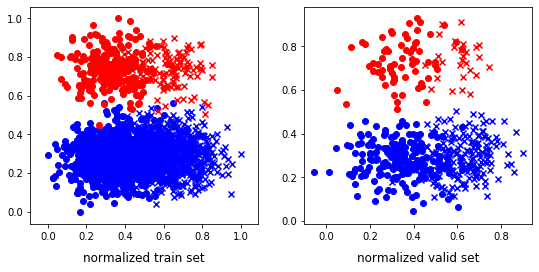

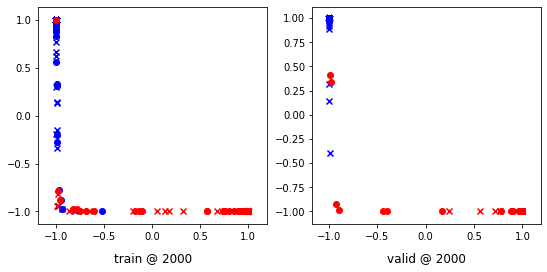

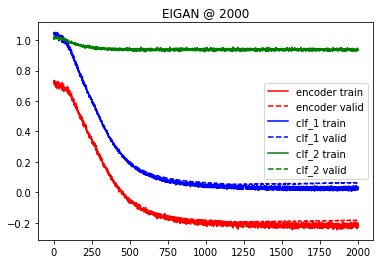

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:27, 22.88it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.01254709 	 -0.01353284 	 -0.04907849 	 -0.04931102 	 0.00888546 	 0.01084880


 25%|██▌       | 502/2001 [00:33<01:21, 18.33it/s]

500 	 -0.08154038 	 -0.08309467 	 -0.13551244 	 -0.13617055 	 -0.03230407 	 -0.03038203


 50%|█████     | 1002/2001 [01:06<01:11, 13.91it/s]

1000 	 -0.13553029 	 -0.13086292 	 -0.21290307 	 -0.21302062 	 -0.07815885 	 -0.08663163


 75%|███████▌  | 1502/2001 [01:40<00:36, 13.58it/s]

1500 	 -0.17277761 	 -0.17162982 	 -0.29751280 	 -0.29661903 	 -0.15317863 	 -0.15353812


100%|██████████| 2001/2001 [02:14<00:00, 14.84it/s]


2000 	 -0.21195182 	 -0.21067843 	 -0.39483020 	 -0.39169902 	 -0.22764243 	 -0.22546513


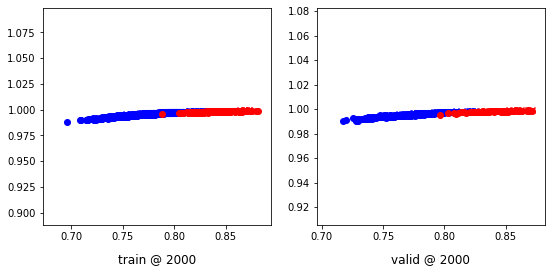

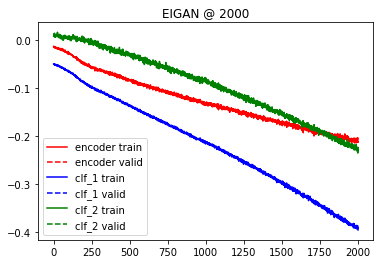

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 0.989829 	 0.988267 	 0.8124
200 	 0.216658 	 0.214933 	 0.9897
400 	 0.053800 	 0.049371 	 0.9979
600 	 0.033379 	 0.028197 	 0.9979
800 	 0.027325 	 0.021352 	 0.9979
1000 	 0.024821 	 0.018067 	 0.9979
Accuracy: 0.9979381443298969
Error Rate: 0.002061855670103093
F1 Score: 0.994475138121547
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 1.0
Error Rate: 0.0
F1 Score: 1.0
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9958762886597938
Error Rate: 0.004123711340206186
F1 Score: 0.9888888888888888

  0%|          | 2/2001 [00:00<01:51, 17.97it/s]

Accuracy: 0.7195876288659794
Error Rate: 0.2804123711340206
F1 Score: 0.7017543859649122
VAR1: 0.4, VAR2: 0.4, TRIAL: 6
X, y_1, y2
(1951, 2) (1951, 1) (1951, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1560, 2) (391, 2) (1560, 1) (391, 1) (1560, 1) (391, 1)
class weights => w1, w2 [1.88861985 2.1253406 ] [2.74647887 1.57258065]
tensor sizes => torch.Size([1560, 2]) torch.Size([391, 2]) torch.Size([1560, 2]) torch.Size([391, 2]) torch.Size([1560, 2]) torch.Size([391, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.69432795 	 0.70534933 	 1.03325248 	 1.03492963 	 1.03213143 	 1.02272749


 25%|██▌       | 504/2001 [00:31<01:38, 15.23it/s]

500 	 0.19083565 	 0.23075560 	 0.41651011 	 0.45036420 	 0.91857475 	 0.91275579


 50%|█████     | 1002/2001 [01:03<01:03, 15.77it/s]

1000 	 0.09558922 	 0.12239707 	 0.31962681 	 0.34226775 	 0.91725850 	 0.91301787


 75%|███████▌  | 1503/2001 [01:34<00:31, 15.94it/s]

1500 	 0.05601647 	 0.10589054 	 0.29283968 	 0.32758036 	 0.93047535 	 0.91483700


100%|██████████| 2001/2001 [02:05<00:00, 15.89it/s]


2000 	 0.07966208 	 0.10445485 	 0.28804246 	 0.32586029 	 0.90188509 	 0.91455263


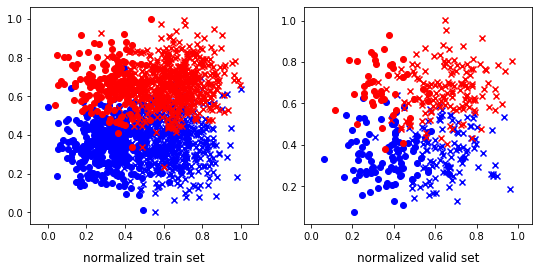

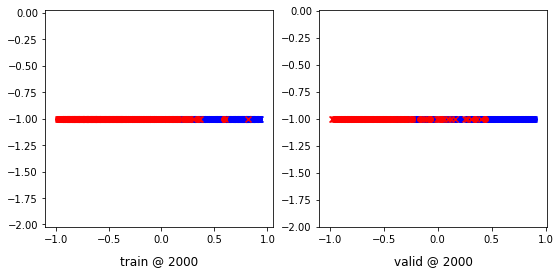

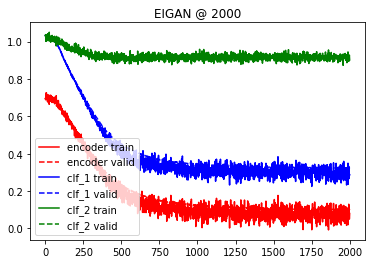

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:11, 15.23it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.00055061 	 -0.00039648 	 -0.04995129 	 -0.05017005 	 -0.02459216 	 -0.02309991


 25%|██▌       | 503/2001 [00:29<01:29, 16.83it/s]

500 	 -0.09530023 	 -0.09582525 	 -0.16680571 	 -0.16869216 	 -0.06737443 	 -0.06993869


 50%|█████     | 1002/2001 [00:59<01:04, 15.39it/s]

1000 	 -0.12631363 	 -0.12091013 	 -0.23978147 	 -0.23758782 	 -0.13683638 	 -0.14158118


 75%|███████▌  | 1503/2001 [01:29<00:28, 17.60it/s]

1500 	 -0.14671291 	 -0.14152880 	 -0.30822766 	 -0.30543110 	 -0.20187357 	 -0.20484848


100%|██████████| 2001/2001 [01:59<00:00, 16.81it/s]


2000 	 -0.13345143 	 -0.13719615 	 -0.38688022 	 -0.39356726 	 -0.30341449 	 -0.30633104


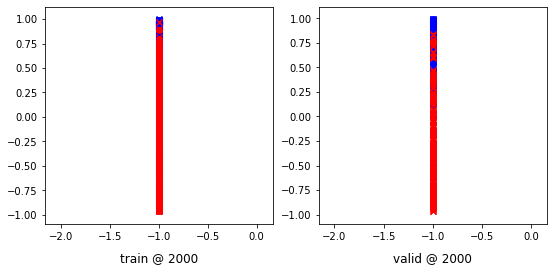

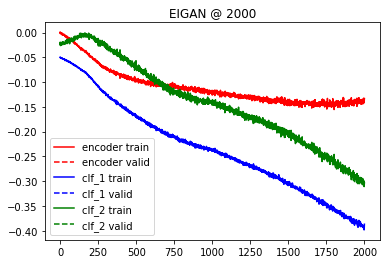

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.014487 	 1.014428 	 0.6368
200 	 0.458627 	 0.457861 	 0.8824
400 	 0.296066 	 0.312361 	 0.8849
600 	 0.291608 	 0.314130 	 0.8875
800 	 0.291256 	 0.314709 	 0.8849
1000 	 0.291076 	 0.314919 	 0.8849
Accuracy: 0.8849104859335039
Error Rate: 0.11508951406649616
F1 Score: 0.8780487804878049
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8900255754475703
Error Rate: 0.10997442455242967
F1 Score: 0.8840970350404312
SVM
--------------------------------------------------------------------------------
Accuracy: 0.887468030690537
Error Rate: 0.11

  0%|          | 3/2001 [00:00<01:33, 21.36it/s]

Accuracy: 0.6368286445012787
Error Rate: 0.3631713554987212
F1 Score: 0.778125
VAR1: 0.4, VAR2: 0.6, TRIAL: 6
X, y_1, y2
(1213, 2) (1213, 1) (1213, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(970, 2) (243, 2) (970, 1) (243, 1) (970, 1) (243, 1)
class weights => w1, w2 [2.43718593 1.6958042 ] [2.59358289 1.62751678]
tensor sizes => torch.Size([970, 2]) torch.Size([243, 2]) torch.Size([970, 2]) torch.Size([243, 2]) torch.Size([970, 2]) torch.Size([243, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.69215024 	 0.69060993 	 1.05172002 	 1.05138004 	 1.05331159 	 1.05391729


 25%|██▌       | 507/2001 [00:17<00:39, 37.82it/s]

500 	 0.66484874 	 0.66352642 	 0.95490301 	 0.95418555 	 0.98320138 	 0.98380631


 50%|█████     | 1006/2001 [00:35<00:35, 28.22it/s]

1000 	 0.68181413 	 0.68044537 	 0.94729483 	 0.94680876 	 0.95866060 	 0.95951056


 75%|███████▌  | 1506/2001 [00:52<00:18, 26.27it/s]

1500 	 0.55803287 	 0.53904295 	 0.63254672 	 0.64896321 	 0.76770675 	 0.80306745


100%|██████████| 2001/2001 [01:10<00:00, 28.43it/s]


2000 	 0.53764600 	 0.52067822 	 0.61859465 	 0.63908595 	 0.77410734 	 0.81155491


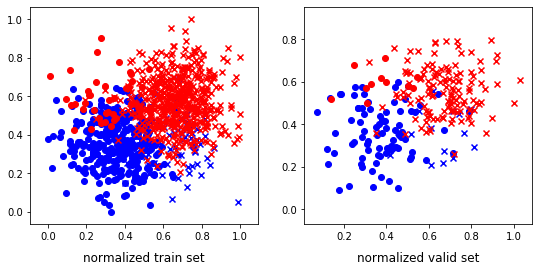

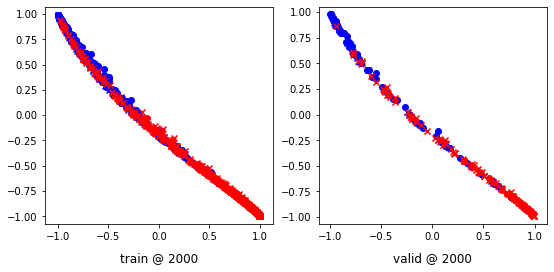

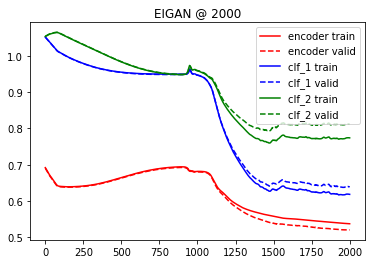

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 4/2001 [00:00<01:00, 33.15it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.06013391 	 0.06004575 	 -0.00210190 	 -0.00215637 	 -0.04942502 	 -0.04940351


 25%|██▌       | 504/2001 [00:17<00:51, 28.85it/s]

500 	 0.03708785 	 0.03696777 	 -0.03552907 	 -0.03564658 	 -0.06946854 	 -0.06947050


 50%|█████     | 1006/2001 [00:32<00:35, 27.89it/s]

1000 	 0.00804178 	 0.00771593 	 -0.07703355 	 -0.07724933 	 -0.09163997 	 -0.09148797


 75%|███████▌  | 1504/2001 [00:46<00:16, 29.45it/s]

1500 	 -0.02986620 	 -0.03035138 	 -0.13764504 	 -0.13801900 	 -0.12828827 	 -0.12812743


100%|██████████| 2001/2001 [01:01<00:00, 32.42it/s]


2000 	 -0.06537229 	 -0.06636056 	 -0.19740187 	 -0.19832993 	 -0.16335525 	 -0.16327588


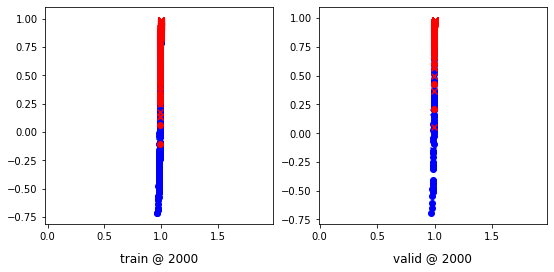

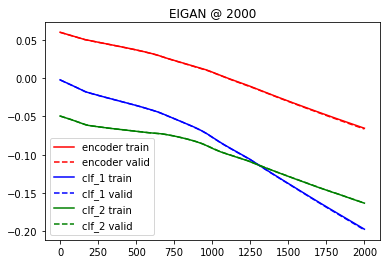

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.045437 	 1.045399 	 0.4074
200 	 0.537240 	 0.543997 	 0.8807
400 	 0.411507 	 0.409479 	 0.8765
600 	 0.408375 	 0.405429 	 0.8765
800 	 0.407549 	 0.405237 	 0.8765
1000 	 0.406707 	 0.405384 	 0.8765
Accuracy: 0.8765432098765432
Error Rate: 0.12345679012345678
F1 Score: 0.8972602739726027
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8806584362139918
Error Rate: 0.11934156378600823
F1 Score: 0.9003436426116839
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9012345679012346
Error Rate: 0.0

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.393452 	 0.493199 	 0.8642
Accuracy: 0.8641975308641975
Error Rate: 0.13580246913580246
F1 Score: 0.8910891089108911
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8518518518518519
Error Rate: 0.14814814814814814
F1 Score: 0.8823529411764707
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8641975308641975
Error Rate: 0.13580246913580246
F1 Score: 0.8910891089108911
VAR1: 0.4, VAR2: 0.8, TRIAL: 6
X, y_1, y2
(1804, 2) (1804, 1) (1804, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1443, 2) (361, 2) (1443, 1) (361, 1) (1443, 1) (361, 1)
class weights => w1, w2 [2.93292683 1.51735016] [2.08827786 1.91888298]
tensor sizes => torch.Size([1443, 2]) torch.Size([361, 2]) torch.Size([1443, 2]) torch.Size([361, 2]) torch.Size([1443, 2]) torch.Size([361, 2])
--------------------------------------------------------------------------------
EIGAN Training
-----

 25%|██▌       | 505/2001 [00:30<01:22, 18.09it/s]

500 	 0.51361191 	 0.53057319 	 0.72826755 	 0.73159778 	 0.90850949 	 0.89417177


 50%|█████     | 1003/2001 [01:00<00:58, 17.13it/s]

1000 	 0.46420676 	 0.49481302 	 0.67854053 	 0.69926876 	 0.90772158 	 0.89760292


 75%|███████▌  | 1503/2001 [01:30<00:33, 14.79it/s]

1500 	 0.53078550 	 0.49134910 	 0.75431705 	 0.69549429 	 0.91715521 	 0.89729238


100%|██████████| 2001/2001 [02:01<00:00, 16.51it/s]


2000 	 0.50507390 	 0.49215394 	 0.74585009 	 0.69456732 	 0.93397969 	 0.89556056


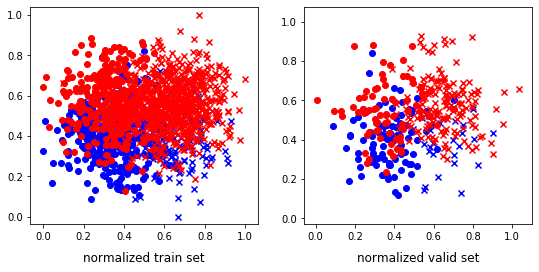

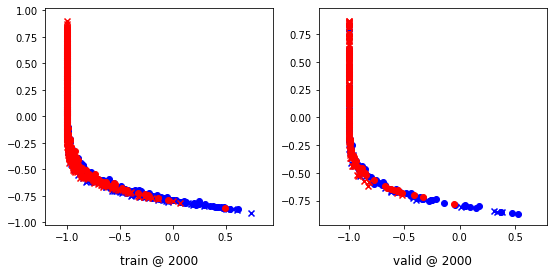

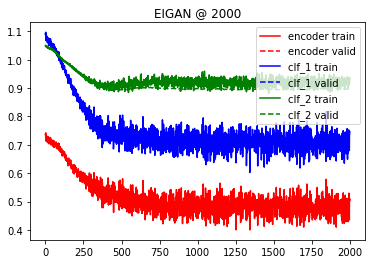

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:23, 13.97it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.01896555 	 0.02724294 	 -0.01025862 	 -0.00149837 	 0.02908248 	 0.03046737


 25%|██▌       | 503/2001 [00:29<01:29, 16.67it/s]

500 	 -0.03126748 	 -0.03356798 	 -0.08282241 	 -0.08517807 	 -0.02704572 	 -0.02717854


 50%|█████     | 1002/2001 [00:58<00:58, 16.99it/s]

1000 	 -0.09227411 	 -0.09455501 	 -0.18589088 	 -0.18807049 	 -0.10596787 	 -0.10580298


 75%|███████▌  | 1503/2001 [01:27<00:32, 15.23it/s]

1500 	 -0.14580923 	 -0.13894655 	 -0.28903168 	 -0.28234589 	 -0.17844732 	 -0.17868108


100%|██████████| 2001/2001 [01:57<00:00, 17.03it/s]


2000 	 -0.17185730 	 -0.17264205 	 -0.37773603 	 -0.37685260 	 -0.25371194 	 -0.25189662


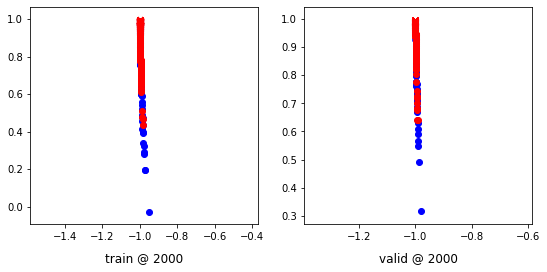

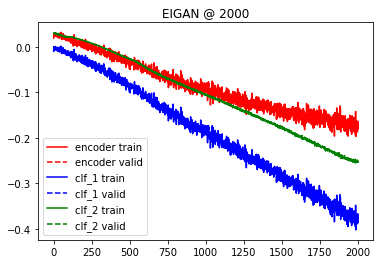

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.018771 	 1.020414 	 0.6565
200 	 0.765609 	 0.766253 	 0.7729
400 	 0.661442 	 0.664414 	 0.7812
600 	 0.659185 	 0.662889 	 0.7867
800 	 0.657601 	 0.662710 	 0.7978
1000 	 0.656160 	 0.662710 	 0.7978
Accuracy: 0.7977839335180056
Error Rate: 0.20221606648199447
F1 Score: 0.8450106157112527
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7534626038781164
Error Rate: 0.24653739612188366
F1 Score: 0.799097065462754
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7811634349030471
Error Rate: 0.21

  0%|          | 0/2001 [00:00<?, ?it/s]

X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1544, 2) (386, 2) (1544, 1) (386, 1) (1544, 1) (386, 1)
class weights => w1, w2 [2.96353167 1.50928641] [2.24092888 1.80584795]
tensor sizes => torch.Size([1544, 2]) torch.Size([386, 2]) torch.Size([1544, 2]) torch.Size([386, 2]) torch.Size([1544, 2]) torch.Size([386, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.70872772 	 0.71775341 	 1.03591025 	 1.04431403 	 1.02065074 	 1.01970780


 25%|██▌       | 503/2001 [00:31<01:40, 14.91it/s]

500 	 0.29068112 	 0.30466813 	 0.35678369 	 0.35448503 	 0.75949615 	 0.74296409


 50%|█████     | 1002/2001 [01:03<01:09, 14.31it/s]

1000 	 0.05835292 	 0.08056740 	 0.10497443 	 0.11893824 	 0.73978871 	 0.73151803


 75%|███████▌  | 1504/2001 [01:34<00:30, 16.33it/s]

1500 	 -0.03080229 	 0.05295764 	 0.02755149 	 0.05781494 	 0.75162262 	 0.69800448


100%|██████████| 2001/2001 [02:06<00:00, 15.86it/s]


2000 	 0.00626041 	 0.04168035 	 0.00948782 	 0.04363205 	 0.69638705 	 0.69509888


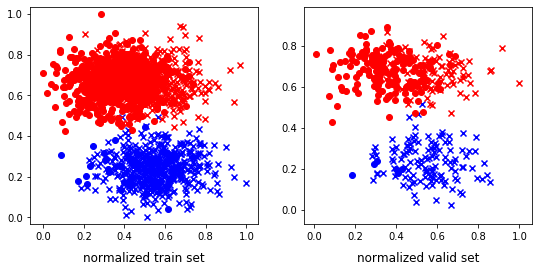

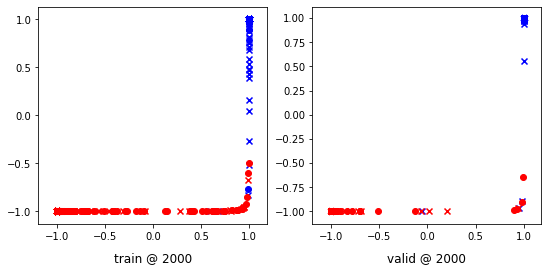

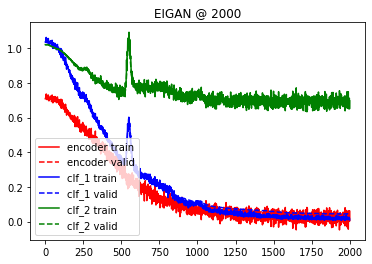

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 4/2001 [00:00<01:08, 29.12it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.05866753 	 -0.05875557 	 -0.08377064 	 -0.08335658 	 0.04167187 	 0.04315290


 25%|██▌       | 503/2001 [00:29<01:33, 15.99it/s]

500 	 -0.18917321 	 -0.18713778 	 -0.23300543 	 -0.23048349 	 -0.00929597 	 -0.00819631


 50%|█████     | 1002/2001 [00:58<01:09, 14.46it/s]

1000 	 -0.27905795 	 -0.27642614 	 -0.35886404 	 -0.35373616 	 -0.08249582 	 -0.07804678


 75%|███████▌  | 1503/2001 [01:29<00:30, 16.19it/s]

1500 	 -0.34715852 	 -0.36484542 	 -0.45872259 	 -0.48169196 	 -0.13401146 	 -0.14182822


100%|██████████| 2001/2001 [01:59<00:00, 16.80it/s]


2000 	 -0.45928583 	 -0.46196178 	 -0.62661248 	 -0.63051540 	 -0.20905562 	 -0.21055283


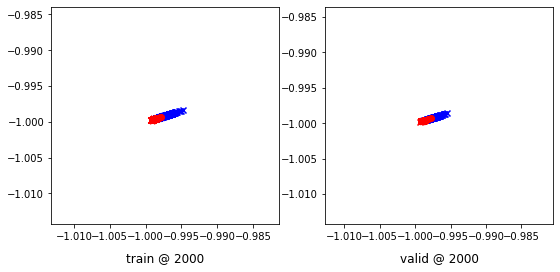

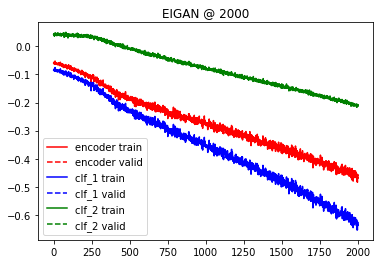

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.042271 	 1.041762 	 0.6632
200 	 0.525680 	 0.519875 	 0.9819
400 	 0.088445 	 0.090643 	 0.9896
600 	 0.041082 	 0.046831 	 0.9896
800 	 0.027224 	 0.036123 	 0.9922
1000 	 0.020922 	 0.032798 	 0.9922
Accuracy: 0.9922279792746114
Error Rate: 0.007772020725388601
F1 Score: 0.9941747572815534
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9896373056994818
Error Rate: 0.010362694300518135
F1 Score: 0.9922178988326849
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9922279792746114
Error Rate: 0

  0%|          | 2/2001 [00:00<01:43, 19.27it/s]

Accuracy: 0.8290155440414507
Error Rate: 0.17098445595854922
F1 Score: 0.8421052631578947
VAR1: 0.6, VAR2: 0.4, TRIAL: 6
X, y_1, y2
(1765, 2) (1765, 1) (1765, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1412, 2) (353, 2) (1412, 1) (353, 1) (1412, 1) (353, 1)
class weights => w1, w2 [2.91134021 1.5231931 ] [1.55506608 2.8015873 ]
tensor sizes => torch.Size([1412, 2]) torch.Size([353, 2]) torch.Size([1412, 2]) torch.Size([353, 2]) torch.Size([1412, 2]) torch.Size([353, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.62637824 	 0.62276542 	 0.99108696 	 0.99221826 	 1.05806565 	 1.06260002


 25%|██▌       | 503/2001 [00:30<01:32, 16.28it/s]

500 	 0.34603962 	 0.32863933 	 0.46467903 	 0.48634273 	 0.81187725 	 0.85085058


 50%|█████     | 1004/2001 [01:01<00:55, 18.12it/s]

1000 	 0.22926447 	 0.25652194 	 0.35147563 	 0.39750445 	 0.81549996 	 0.83412969


 75%|███████▌  | 1504/2001 [01:31<00:28, 17.61it/s]

1500 	 0.26527455 	 0.25894946 	 0.36857644 	 0.38340569 	 0.79644710 	 0.81760341


100%|██████████| 2001/2001 [02:01<00:00, 16.46it/s]


2000 	 0.31739080 	 0.25785634 	 0.41236159 	 0.38494852 	 0.78870809 	 0.82023937


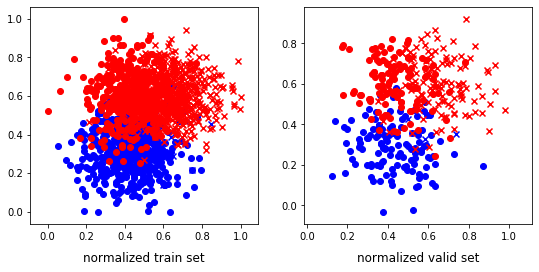

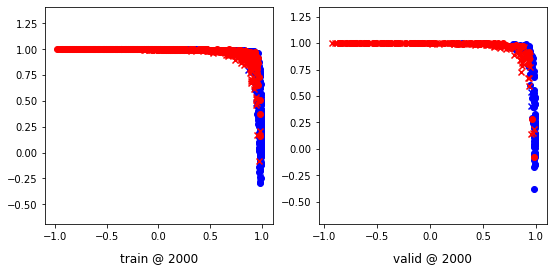

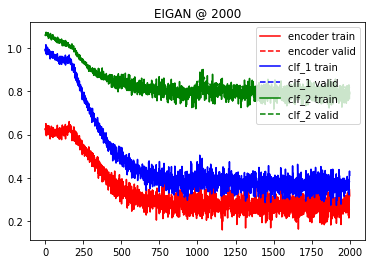

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<01:57, 16.99it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.01313736 	 -0.01396518 	 -0.06697816 	 -0.06697013 	 -0.03196481 	 -0.03022803


 25%|██▌       | 503/2001 [00:29<01:27, 17.17it/s]

500 	 -0.07713592 	 -0.07829340 	 -0.14516239 	 -0.14538954 	 -0.06080330 	 -0.05902924


 50%|█████     | 1005/2001 [00:58<00:56, 17.63it/s]

1000 	 -0.11516314 	 -0.11423055 	 -0.21828972 	 -0.21812318 	 -0.12113187 	 -0.12232379


 75%|███████▌  | 1505/2001 [01:28<00:29, 16.66it/s]

1500 	 -0.13831671 	 -0.13869306 	 -0.29480088 	 -0.29519165 	 -0.19558071 	 -0.19559902


100%|██████████| 2001/2001 [01:57<00:00, 17.07it/s]


2000 	 -0.14475416 	 -0.14326951 	 -0.38395989 	 -0.38349962 	 -0.28908661 	 -0.29013276


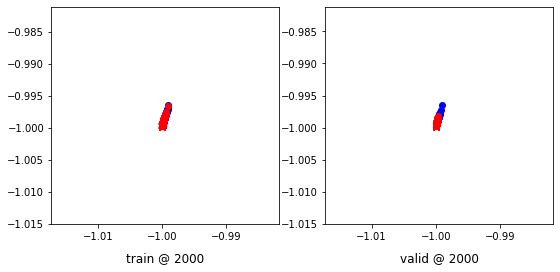

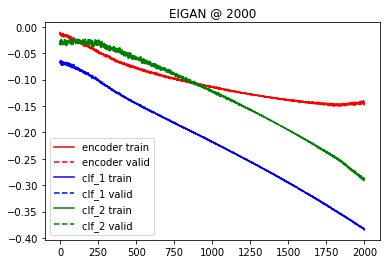

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.054199 	 1.055175 	 0.3456
200 	 0.636018 	 0.617819 	 0.8924
400 	 0.324817 	 0.304265 	 0.9037
600 	 0.316381 	 0.302040 	 0.9065
800 	 0.315444 	 0.301084 	 0.9065
1000 	 0.314814 	 0.300169 	 0.9065
Accuracy: 0.9065155807365439
Error Rate: 0.09348441926345609
F1 Score: 0.9268292682926829
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9065155807365439
Error Rate: 0.09348441926345609
F1 Score: 0.9261744966442952
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9121813031161473
Error Rate: 0.0

  0%|          | 4/2001 [00:00<00:52, 38.22it/s]

tensor sizes => torch.Size([744, 2]) torch.Size([187, 2]) torch.Size([744, 2]) torch.Size([187, 2]) torch.Size([744, 2]) torch.Size([187, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.68708432 	 0.68793905 	 1.04882812 	 1.04864132 	 1.05526125 	 1.05384946


 25%|██▌       | 505/2001 [00:16<00:51, 29.02it/s]

500 	 0.66154706 	 0.66198206 	 0.93365395 	 0.93313813 	 0.96532398 	 0.96430326


 50%|█████     | 1006/2001 [00:32<00:33, 29.54it/s]

1000 	 0.48123962 	 0.43411535 	 0.73418659 	 0.68239915 	 0.94610208 	 0.94143099


 75%|███████▌  | 1507/2001 [00:49<00:16, 30.13it/s]

1500 	 0.37459397 	 0.30575043 	 0.62777674 	 0.55582362 	 0.94634223 	 0.94322038


100%|██████████| 2001/2001 [01:05<00:00, 30.60it/s]


2000 	 0.34247106 	 0.26947504 	 0.59585196 	 0.52218032 	 0.94653946 	 0.94585246


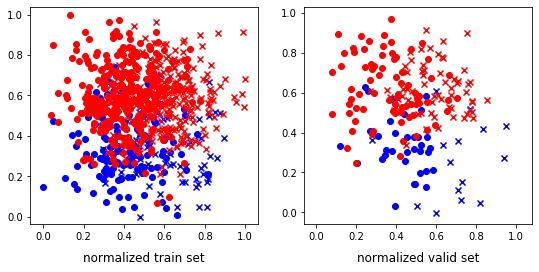

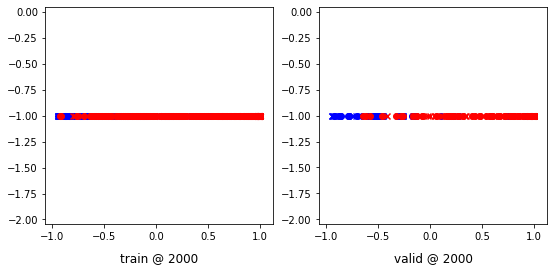

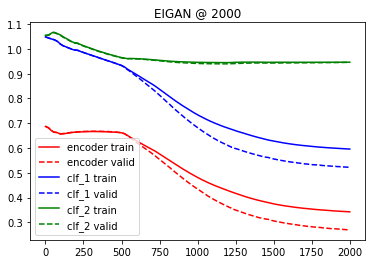

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 5/2001 [00:00<00:42, 47.40it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.07929489 	 0.07946245 	 0.04993632 	 0.04997553 	 0.02888708 	 0.02828242


 25%|██▌       | 505/2001 [00:15<00:47, 31.48it/s]

500 	 0.01433333 	 0.01414862 	 -0.01762547 	 -0.01783854 	 0.02145935 	 0.02115045


 50%|█████     | 1006/2001 [00:30<00:28, 34.32it/s]

1000 	 -0.03070943 	 -0.03077121 	 -0.07426149 	 -0.07443583 	 -0.00866694 	 -0.00896080


 75%|███████▌  | 1505/2001 [00:46<00:13, 36.40it/s]

1500 	 -0.05595393 	 -0.05596744 	 -0.11511538 	 -0.11527318 	 -0.04322676 	 -0.04352769


100%|██████████| 2001/2001 [01:01<00:00, 32.52it/s]


2000 	 -0.08000850 	 -0.08021791 	 -0.16044399 	 -0.16086784 	 -0.08360467 	 -0.08398931


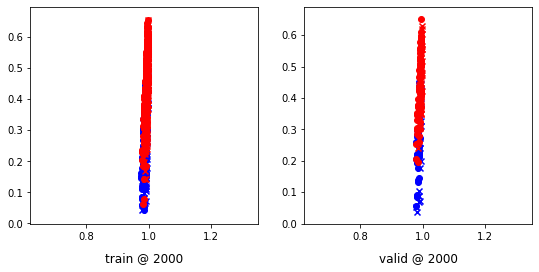

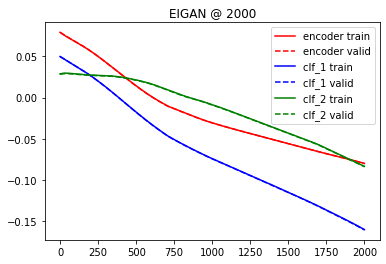

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.036985 	 1.034749 	 0.7380
200 	 0.712107 	 0.659517 	 0.8556
400 	 0.580865 	 0.491584 	 0.8930
600 	 0.579000 	 0.487524 	 0.8930
800 	 0.578227 	 0.487102 	 0.8930
1000 	 0.577322 	 0.486298 	 0.8930
Accuracy: 0.893048128342246
Error Rate: 0.10695187165775401
F1 Score: 0.9280575539568345
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8663101604278075
Error Rate: 0.13368983957219252
F1 Score: 0.9070631970260224
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8983957219251337
Error Rate: 0.10

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.942006 	 0.939223 	 0.6150
Accuracy: 0.6149732620320856
Error Rate: 0.3850267379679144
F1 Score: 0.4
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.5561497326203209
Error Rate: 0.44385026737967914
F1 Score: 0.5561497326203209
SVM
--------------------------------------------------------------------------------
Accuracy: 0.5828877005347594
Error Rate: 0.41711229946524064
F1 Score: 0.0
VAR1: 0.6, VAR2: 0.8, TRIAL: 6
X, y_1, y2
(2600, 2) (2600, 1) (2600, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2080, 2) (520, 2) (2080, 1) (520, 1) (2080, 1) (520, 1)
class weights => w1, w2 [1.54074074 2.84931507] [1.50943396 2.96296296]
tensor sizes => torch.Size([2080, 2]) torch.Size([520, 2]) torch.Size([2080, 2]) torch.Size([520, 2]) torch.Size([2080, 2]) torch.Size([520, 2])
--------------------------------------------------------------------------------
EIGAN Training
------------------------------------

  0%|          | 2/2001 [00:00<02:08, 15.59it/s]

0 	 0.63870454 	 0.62402737 	 1.01642144 	 1.01886952 	 1.07124901 	 1.08798933


 25%|██▌       | 503/2001 [00:46<02:25, 10.32it/s]

500 	 0.82850027 	 0.52427560 	 1.03187430 	 0.72302961 	 0.91153246 	 0.89190120


 50%|█████     | 1003/2001 [01:33<01:34, 10.61it/s]

1000 	 0.76611793 	 0.52053964 	 0.93484193 	 0.72565758 	 0.86292517 	 0.89826512


 75%|███████▌  | 1502/2001 [02:19<00:46, 10.70it/s]

1500 	 0.41736114 	 0.51555443 	 0.68726099 	 0.72242689 	 0.96314418 	 0.90001965


100%|██████████| 2001/2001 [03:03<00:00, 10.90it/s]


2000 	 0.53837436 	 0.51442164 	 0.55655855 	 0.71696746 	 0.71191573 	 0.89569300


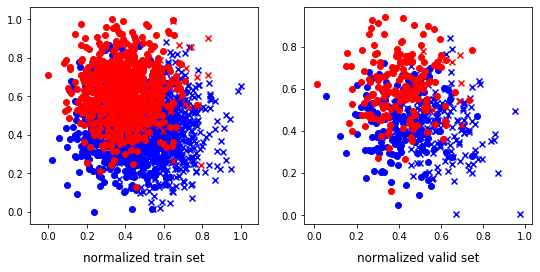

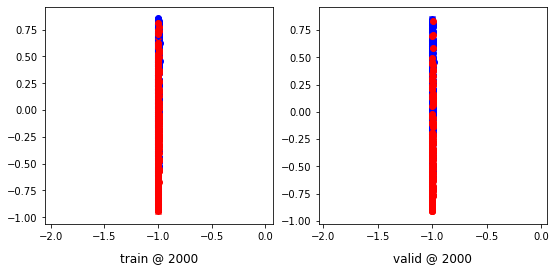

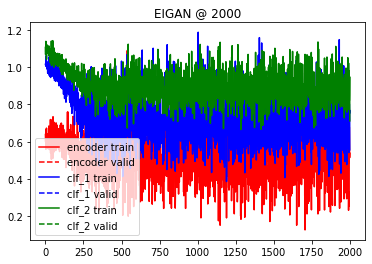

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:38, 12.61it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.05343096 	 0.04937474 	 -0.00835701 	 -0.00852687 	 -0.04845960 	 -0.04062752


 25%|██▌       | 503/2001 [00:44<02:01, 12.28it/s]

500 	 -0.00069627 	 -0.00829946 	 -0.08776446 	 -0.08751898 	 -0.09507116 	 -0.08145963


 50%|█████     | 1003/2001 [01:29<01:34, 10.61it/s]

1000 	 -0.07495335 	 -0.05763146 	 -0.19393370 	 -0.18628965 	 -0.14493287 	 -0.15868956


 75%|███████▌  | 1502/2001 [02:14<00:43, 11.35it/s]

1500 	 -0.11731122 	 -0.10025002 	 -0.31212398 	 -0.28715843 	 -0.24137580 	 -0.23232906


100%|██████████| 2001/2001 [02:59<00:00, 11.16it/s]


2000 	 -0.15448880 	 -0.12422389 	 -0.42535371 	 -0.40518135 	 -0.32044679 	 -0.33005419


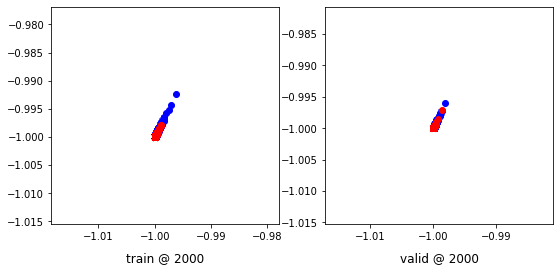

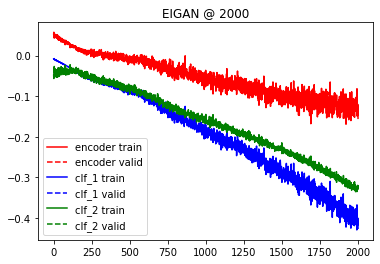

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.052506 	 1.053067 	 0.5519
200 	 0.764225 	 0.772279 	 0.7615
400 	 0.665766 	 0.671930 	 0.7750
600 	 0.664432 	 0.670518 	 0.7731
800 	 0.663456 	 0.669801 	 0.7712
1000 	 0.662753 	 0.669314 	 0.7769
Accuracy: 0.7769230769230769
Error Rate: 0.2230769230769231
F1 Score: 0.6864864864864865
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7692307692307693
Error Rate: 0.23076923076923078
F1 Score: 0.6954314720812182
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7788461538461539
Error Rate: 0.22

  0%|          | 3/2001 [00:00<01:08, 28.99it/s]

Accuracy: 0.7673076923076924
Error Rate: 0.2326923076923077
F1 Score: 0.6230529595015576
VAR1: 0.8, VAR2: 0.2, TRIAL: 6
X, y_1, y2
(2044, 2) (2044, 1) (2044, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1635, 2) (409, 2) (1635, 1) (409, 1) (1635, 1) (409, 1)
class weights => w1, w2 [3.66591928 1.37510513] [2.13446475 1.88147296]
tensor sizes => torch.Size([1635, 2]) torch.Size([409, 2]) torch.Size([1635, 2]) torch.Size([409, 2]) torch.Size([1635, 2]) torch.Size([409, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.68691468 	 0.69079411 	 1.03218198 	 1.03619504 	 1.03871346 	 1.03854811


 25%|██▌       | 502/2001 [00:32<01:37, 15.31it/s]

500 	 -0.11634402 	 -0.12666509 	 0.13958761 	 0.13424918 	 0.94909430 	 0.95406145


 50%|█████     | 1004/2001 [01:05<01:05, 15.27it/s]

1000 	 -0.21975423 	 -0.23755167 	 0.03414234 	 0.02326753 	 0.94704825 	 0.95396638


 75%|███████▌  | 1504/2001 [01:37<00:30, 16.36it/s]

1500 	 -0.24968368 	 -0.24715164 	 0.01226118 	 0.01320049 	 0.95504481 	 0.95349932


100%|██████████| 2001/2001 [02:09<00:00, 15.49it/s]


2000 	 -0.25135288 	 -0.25002232 	 0.00926038 	 0.00971481 	 0.95376134 	 0.95288432


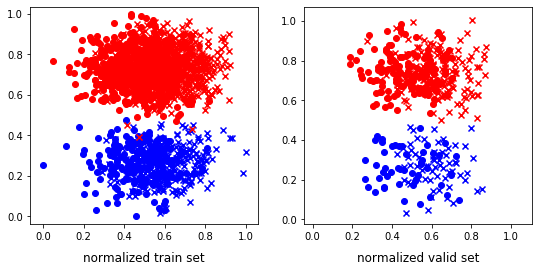

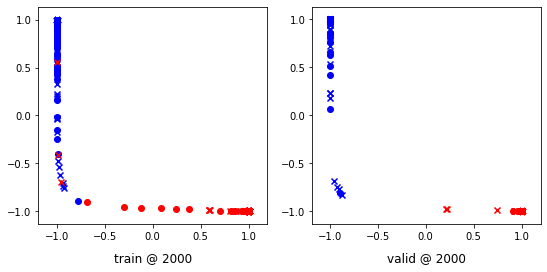

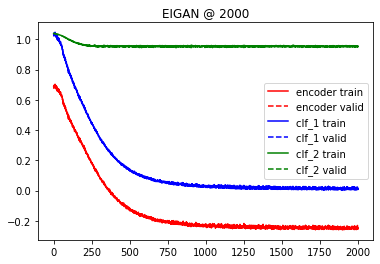

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:20, 14.23it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.00625220 	 0.00674251 	 -0.03109884 	 -0.03210512 	 0.00686477 	 0.00290199


 25%|██▌       | 503/2001 [00:31<01:39, 15.05it/s]

500 	 -0.12897235 	 -0.13012725 	 -0.19471909 	 -0.19592647 	 -0.05633845 	 -0.05651360


 50%|█████     | 1003/2001 [01:02<01:06, 15.11it/s]

1000 	 -0.20372540 	 -0.20062542 	 -0.31874496 	 -0.31768110 	 -0.13914314 	 -0.14213403


 75%|███████▌  | 1504/2001 [01:33<00:32, 15.16it/s]

1500 	 -0.24578361 	 -0.24194631 	 -0.43202242 	 -0.42980292 	 -0.23155211 	 -0.23342431


100%|██████████| 2001/2001 [02:04<00:00, 16.11it/s]


2000 	 -0.29733020 	 -0.30436391 	 -0.46718237 	 -0.47580442 	 -0.21212760 	 -0.21405374


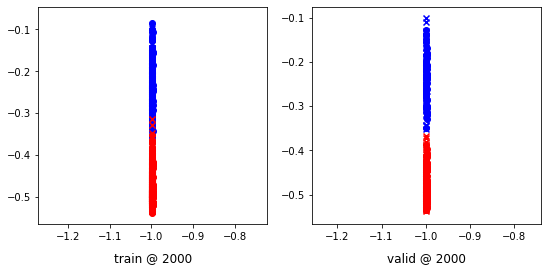

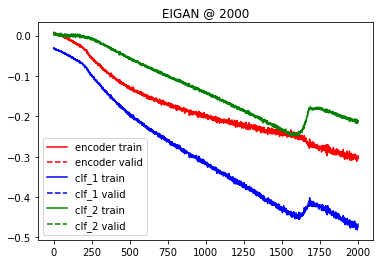

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.081957 	 1.080745 	 0.5232
200 	 0.384592 	 0.388918 	 0.9804
400 	 0.064582 	 0.072001 	 1.0000
600 	 0.027525 	 0.032260 	 1.0000
800 	 0.018416 	 0.021616 	 1.0000
1000 	 0.014939 	 0.017285 	 1.0000
Accuracy: 1.0
Error Rate: 0.0
F1 Score: 1.0
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 1.0
Error Rate: 0.0
F1 Score: 1.0
SVM
--------------------------------------------------------------------------------
Accuracy: 1.0
Error Rate: 0.0
F1 Score: 1.0
--------------------------------------------------------------------------------
ALLY: EIGAN

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.530562347188264
Error Rate: 0.46943765281173594
F1 Score: 0.693290734824281
VAR1: 0.8, VAR2: 0.4, TRIAL: 6
X, y_1, y2
(1769, 2) (1769, 1) (1769, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1415, 2) (354, 2) (1415, 1) (354, 1) (1415, 1) (354, 1)
class weights => w1, w2 [1.63394919 2.57741348] [1.82816537 2.2074883 ]
tensor sizes => torch.Size([1415, 2]) torch.Size([354, 2]) torch.Size([1415, 2]) torch.Size([354, 2]) torch.Size([1415, 2]) torch.Size([354, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.66590834 	 0.68086171 	 1.03103197 	 1.03798091 	 1.05838001 	 1.05026639


 25%|██▌       | 503/2001 [00:30<01:31, 16.41it/s]

500 	 0.45899922 	 0.48563266 	 0.55871439 	 0.60432303 	 0.79288131 	 0.81183755


 50%|█████     | 1002/2001 [01:00<01:04, 15.56it/s]

1000 	 0.37321118 	 0.39915946 	 0.43894729 	 0.47605363 	 0.75899011 	 0.77004135


 75%|███████▌  | 1502/2001 [01:30<00:31, 15.64it/s]

1500 	 0.28331611 	 0.36431426 	 0.38548586 	 0.41886383 	 0.79553270 	 0.74769676


100%|██████████| 2001/2001 [02:01<00:00, 16.52it/s]


2000 	 0.27970597 	 0.35902718 	 0.31621814 	 0.40481547 	 0.72963393 	 0.73893547


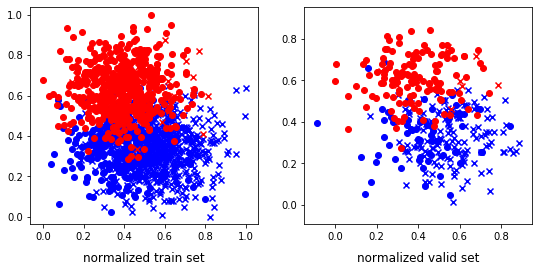

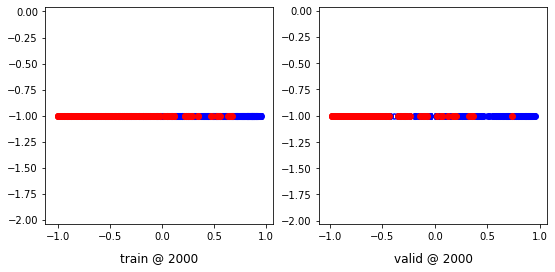

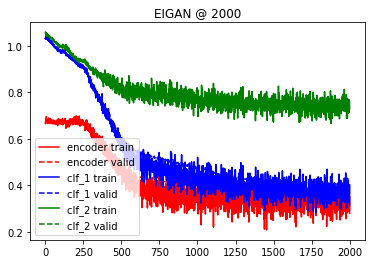

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:35, 20.84it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.05761684 	 0.05477698 	 0.00061642 	 -0.00206199 	 -0.03873675 	 -0.03840925


 25%|██▌       | 503/2001 [00:29<01:27, 17.17it/s]

500 	 -0.00495090 	 -0.00838983 	 -0.07620057 	 -0.07983256 	 -0.06688417 	 -0.06728773


 50%|█████     | 1004/2001 [00:58<00:57, 17.36it/s]

1000 	 -0.09553167 	 -0.09262457 	 -0.18273950 	 -0.17962666 	 -0.09530783 	 -0.09496116


 75%|███████▌  | 1503/2001 [01:27<00:29, 16.66it/s]

1500 	 -0.15042886 	 -0.14723858 	 -0.26609215 	 -0.26240978 	 -0.14009178 	 -0.13936882


100%|██████████| 2001/2001 [01:56<00:00, 17.11it/s]


2000 	 -0.19321378 	 -0.19915180 	 -0.35203803 	 -0.35736501 	 -0.19852743 	 -0.19776024


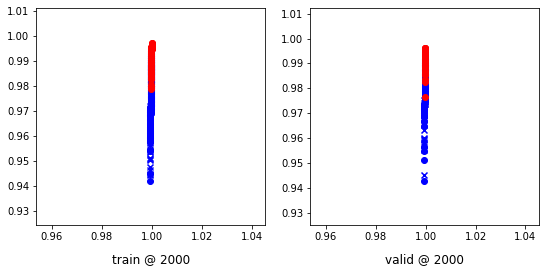

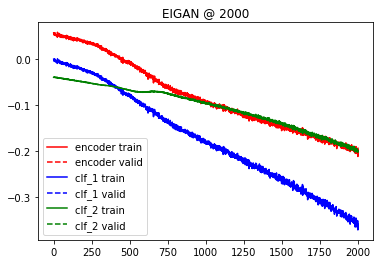

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.070584 	 1.071527 	 0.6102
200 	 0.510083 	 0.532838 	 0.8898
400 	 0.339399 	 0.370757 	 0.8927
600 	 0.335116 	 0.367994 	 0.8927
800 	 0.334822 	 0.367810 	 0.8927
1000 	 0.334710 	 0.367666 	 0.8927
Accuracy: 0.8926553672316384
Error Rate: 0.10734463276836158
F1 Score: 0.8602941176470588
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8870056497175142
Error Rate: 0.11299435028248588
F1 Score: 0.8561151079136692
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8954802259887006
Error Rate: 0.1

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.711864406779661
Error Rate: 0.288135593220339
F1 Score: 0.7150837988826817
VAR1: 0.8, VAR2: 0.6, TRIAL: 6
X, y_1, y2
(2197, 2) (2197, 1) (2197, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1757, 2) (440, 2) (1757, 1) (440, 1) (1757, 1) (440, 1)
class weights => w1, w2 [5.99658703 1.20013661] [2.1505508  1.86914894]
tensor sizes => torch.Size([1757, 2]) torch.Size([440, 2]) torch.Size([1757, 2]) torch.Size([440, 2]) torch.Size([1757, 2]) torch.Size([440, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.72086978 	 0.70628536 	 1.05492687 	 1.04149926 	 1.02747846 	 1.02836108


 25%|██▌       | 503/2001 [00:33<01:48, 13.85it/s]

500 	 0.38606024 	 0.42168540 	 0.64554614 	 0.68216234 	 0.95284671 	 0.95362413


 50%|█████     | 1004/2001 [01:08<01:02, 15.99it/s]

1000 	 0.28211838 	 0.34923875 	 0.54017377 	 0.60889560 	 0.95115340 	 0.95280403


 75%|███████▌  | 1503/2001 [01:41<00:29, 16.92it/s]

1500 	 0.28469616 	 0.33890224 	 0.53981692 	 0.59831911 	 0.94842947 	 0.95256406


100%|██████████| 2001/2001 [02:15<00:00, 14.80it/s]


2000 	 0.31055850 	 0.33602256 	 0.57171494 	 0.59554398 	 0.95432931 	 0.95266861


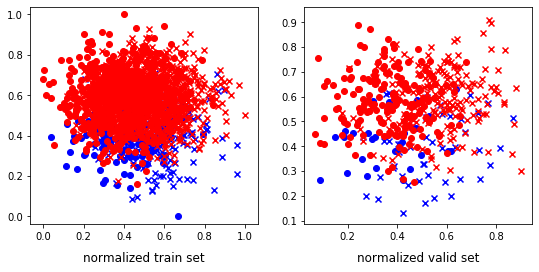

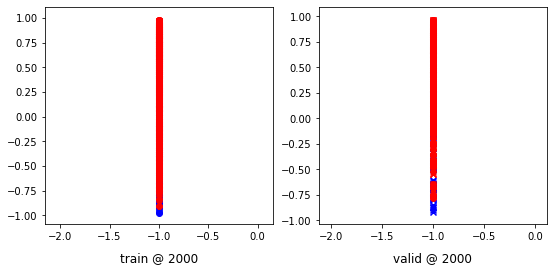

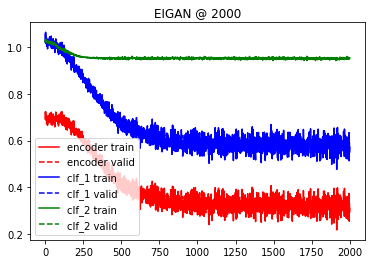

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:40, 19.87it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.06436682 	 0.06373028 	 -0.00254981 	 -0.00261717 	 -0.05867730 	 -0.05757998


 25%|██▌       | 503/2001 [00:30<01:12, 20.62it/s]

500 	 0.02777366 	 0.02783715 	 -0.05956743 	 -0.05971609 	 -0.09553104 	 -0.09589396


 50%|█████     | 1003/2001 [01:01<01:00, 16.37it/s]

1000 	 -0.00925964 	 -0.00907318 	 -0.11002218 	 -0.10991718 	 -0.11742777 	 -0.11755944


 75%|███████▌  | 1504/2001 [01:33<00:34, 14.40it/s]

1500 	 -0.05636270 	 -0.05884962 	 -0.22034608 	 -0.22044238 	 -0.20494765 	 -0.20198603


100%|██████████| 2001/2001 [02:05<00:00, 15.98it/s]


2000 	 -0.08542867 	 -0.08684921 	 -0.31946820 	 -0.31807148 	 -0.28375086 	 -0.28085575


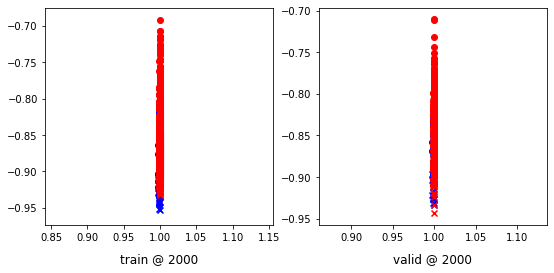

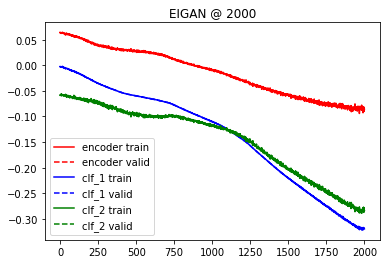

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.012605 	 1.010923 	 0.8341
200 	 0.652758 	 0.651957 	 0.8727
400 	 0.579411 	 0.584249 	 0.8591
600 	 0.576635 	 0.582679 	 0.8568
800 	 0.576344 	 0.582481 	 0.8568
1000 	 0.576205 	 0.582503 	 0.8591
Accuracy: 0.8590909090909091
Error Rate: 0.1409090909090909
F1 Score: 0.9153005464480874
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8
Error Rate: 0.2
F1 Score: 0.8702064896755162
SVM
--------------------------------------------------------------------------------
Accuracy: 0.85
Error Rate: 0.15
F1 Score: 0.9115281501340482
---------------

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.6659090909090909
Error Rate: 0.3340909090909091
F1 Score: 0.7018255578093306
VAR1: 0.8, VAR2: 0.8, TRIAL: 6
X, y_1, y2
(2443, 2) (2443, 1) (2443, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1954, 2) (489, 2) (1954, 1) (489, 1) (1954, 1) (489, 1)
class weights => w1, w2 [2.00410256 1.9959142 ] [1.98375635 2.01651187]
tensor sizes => torch.Size([1954, 2]) torch.Size([489, 2]) torch.Size([1954, 2]) torch.Size([489, 2]) torch.Size([1954, 2]) torch.Size([489, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.67643809 	 0.67562485 	 1.03962827 	 1.03873587 	 1.05662572 	 1.05625820


 25%|██▌       | 502/2001 [00:35<01:48, 13.80it/s]

500 	 0.56484008 	 0.57250017 	 0.74141037 	 0.77238792 	 0.86971146 	 0.89303493


 50%|█████     | 1004/2001 [01:11<01:04, 15.42it/s]

1000 	 0.54300034 	 0.55146462 	 0.72775775 	 0.75212437 	 0.87790084 	 0.89380693


 75%|███████▌  | 1505/2001 [01:46<00:31, 15.87it/s]

1500 	 0.55065876 	 0.55150259 	 0.74390811 	 0.75444156 	 0.88637716 	 0.89608616


100%|██████████| 2001/2001 [02:22<00:00, 14.06it/s]


2000 	 0.52815688 	 0.55193031 	 0.71093893 	 0.75822240 	 0.87559110 	 0.89943928


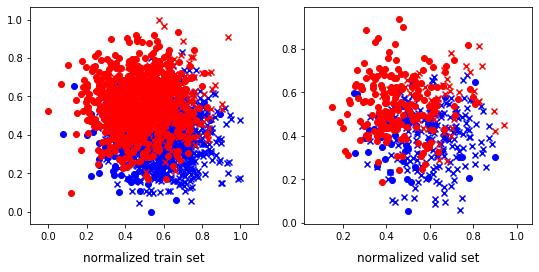

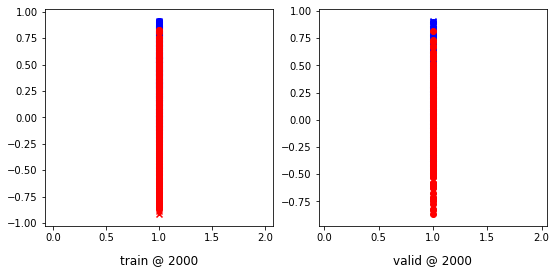

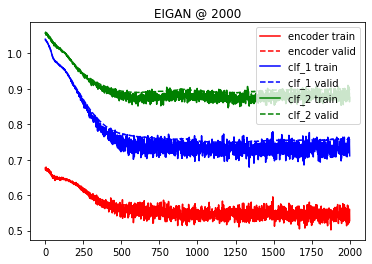

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:50, 18.02it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.00348540 	 0.00322764 	 -0.04002415 	 -0.04026680 	 -0.00843755 	 -0.00855322


 25%|██▌       | 502/2001 [00:33<02:00, 12.43it/s]

500 	 -0.04414859 	 -0.04361650 	 -0.11211407 	 -0.11142366 	 -0.06067990 	 -0.06039808


 50%|█████     | 1003/2001 [01:07<01:05, 15.12it/s]

1000 	 -0.07991864 	 -0.07906833 	 -0.17776194 	 -0.17696719 	 -0.11279844 	 -0.11288793


 75%|███████▌  | 1504/2001 [01:40<00:33, 14.84it/s]

1500 	 -0.10519066 	 -0.10549615 	 -0.23817973 	 -0.23855215 	 -0.16467299 	 -0.16476841


100%|██████████| 2001/2001 [02:13<00:00, 15.04it/s]


2000 	 -0.13265774 	 -0.13147940 	 -0.31839415 	 -0.31746393 	 -0.23097108 	 -0.23125924


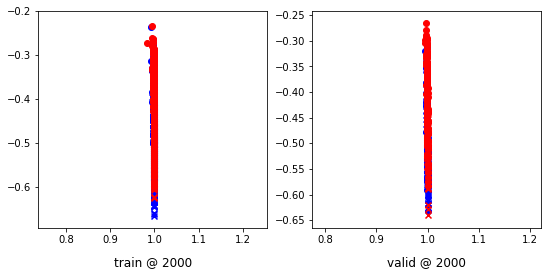

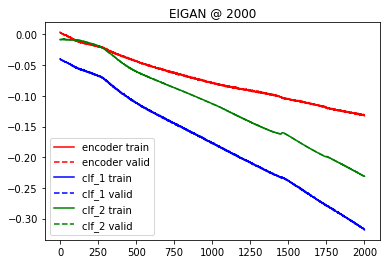

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.019772 	 1.020159 	 0.4990
200 	 0.769973 	 0.778328 	 0.7628
400 	 0.682108 	 0.687564 	 0.7607
600 	 0.681717 	 0.687213 	 0.7607
800 	 0.681550 	 0.687155 	 0.7607
1000 	 0.681428 	 0.687140 	 0.7607
Accuracy: 0.7607361963190185
Error Rate: 0.2392638036809816
F1 Score: 0.7673956262425446
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7627811860940695
Error Rate: 0.23721881390593047
F1 Score: 0.7689243027888446
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7586912065439673
Error Rate: 0.24

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.7607361963190185
Error Rate: 0.2392638036809816
F1 Score: 0.753684210526316
Writing trial 6 ...
VAR1: 0.2, VAR2: 0.2, TRIAL: 7
X, y_1, y2
(1955, 2) (1955, 1) (1955, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1564, 2) (391, 2) (1564, 1) (391, 1) (1564, 1) (391, 1)
class weights => w1, w2 [1.84433962 2.18435754] [2.78787879 1.55932203]
tensor sizes => torch.Size([1564, 2]) torch.Size([391, 2]) torch.Size([1564, 2]) torch.Size([391, 2]) torch.Size([1564, 2]) torch.Size([391, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.65024292 	 0.66261387 	 1.03529525 	 1.03539217 	 1.07853150 	 1.06592548


 25%|██▌       | 503/2001 [00:30<01:34, 15.80it/s]

500 	 -0.05249183 	 -0.04021835 	 0.15145557 	 0.15247047 	 0.89709878 	 0.88583601


 50%|█████     | 1003/2001 [01:00<01:03, 15.66it/s]

1000 	 -0.15439041 	 -0.14101502 	 0.04031265 	 0.04106686 	 0.88791049 	 0.87522906


 75%|███████▌  | 1503/2001 [01:32<00:33, 14.73it/s]

1500 	 -0.16924256 	 -0.15255326 	 0.01916219 	 0.02954144 	 0.88158077 	 0.87524188


100%|██████████| 2001/2001 [02:03<00:00, 16.20it/s]


2000 	 -0.14596474 	 -0.15285155 	 0.02176439 	 0.02806309 	 0.86105841 	 0.87406182


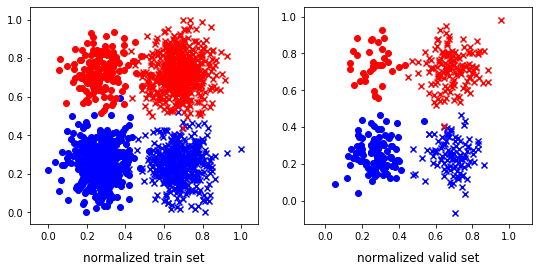

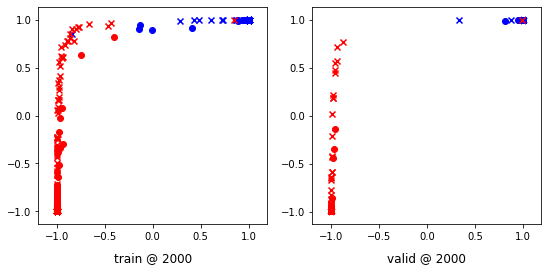

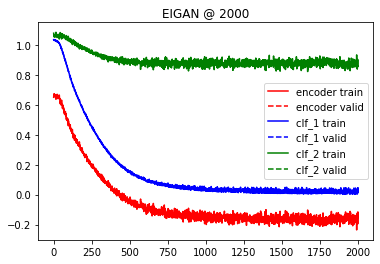

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:42, 19.49it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.02608218 	 0.02548455 	 0.00924543 	 0.00869274 	 0.07030033 	 0.07041679


 25%|██▌       | 503/2001 [00:30<01:49, 13.73it/s]

500 	 -0.03441586 	 -0.03652719 	 -0.09125134 	 -0.09131877 	 -0.03837077 	 -0.03407602


 50%|█████     | 1003/2001 [01:00<00:59, 16.67it/s]

1000 	 -0.05659270 	 -0.05353653 	 -0.16093342 	 -0.16027036 	 -0.12299919 	 -0.12670143


 75%|███████▌  | 1504/2001 [01:29<00:29, 16.82it/s]

1500 	 -0.05455549 	 -0.05718462 	 -0.24966954 	 -0.25009146 	 -0.24171337 	 -0.23921162


100%|██████████| 2001/2001 [01:59<00:00, 16.73it/s]


2000 	 -0.09703510 	 -0.09196818 	 -0.25493032 	 -0.25265172 	 -0.19731958 	 -0.20085351


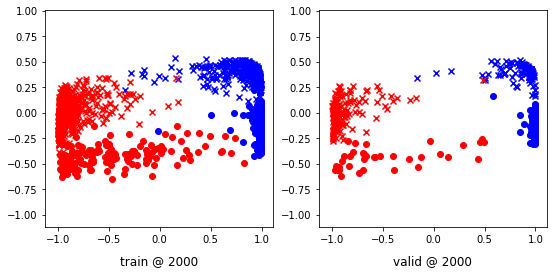

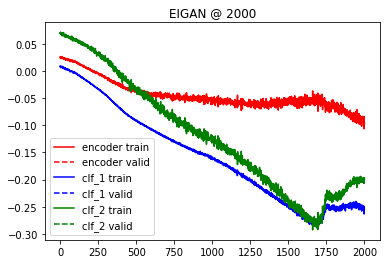

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.076573 	 1.076469 	 0.4578
200 	 0.745933 	 0.747407 	 0.9693
400 	 0.121713 	 0.122080 	 0.9949
600 	 0.042411 	 0.043556 	 0.9974
800 	 0.028205 	 0.029919 	 0.9974
1000 	 0.022830 	 0.025186 	 0.9974
Accuracy: 0.9974424552429667
Error Rate: 0.0025575447570332483
F1 Score: 0.9971988795518207
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9974424552429667
Error Rate: 0.0025575447570332483
F1 Score: 0.9971988795518207
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9974424552429667
Error Rate:

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.039315 	 0.029479 	 0.9949
Accuracy: 0.9948849104859335
Error Rate: 0.005115089514066497
F1 Score: 0.996031746031746
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.989769820971867
Error Rate: 0.010230179028132993
F1 Score: 0.99203187250996
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9948849104859335
Error Rate: 0.005115089514066497
F1 Score: 0.996031746031746
VAR1: 0.2, VAR2: 0.4, TRIAL: 7
X, y_1, y2
(2224, 2) (2224, 1) (2224, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1779, 2) (445, 2) (1779, 1) (445, 1) (1779, 1) (445, 1)
class weights => w1, w2 [1.89255319 2.12038141] [1.98327759 2.0170068 ]
tensor sizes => torch.Size([1779, 2]) torch.Size([445, 2]) torch.Size([1779, 2]) torch.Size([445, 2]) torch.Size([1779, 2]) torch.Size([445, 2])
--------------------------------------------------------------------------------
EIGAN Training
-------

  0%|          | 5/2001 [00:00<01:35, 20.92it/s]

0 	 0.66399217 	 0.67027473 	 1.01927805 	 1.02080655 	 1.04886031 	 1.04367900


 25%|██▌       | 504/2001 [00:33<01:26, 17.28it/s]

500 	 0.36042076 	 0.34072295 	 0.51061559 	 0.47681436 	 0.84334373 	 0.82923859


 50%|█████     | 1003/2001 [01:06<01:06, 14.95it/s]

1000 	 0.23155299 	 0.19069332 	 0.33941868 	 0.31415337 	 0.80101794 	 0.81660724


 75%|███████▌  | 1503/2001 [01:40<00:32, 15.17it/s]

1500 	 0.22534248 	 0.17746535 	 0.33979169 	 0.29455039 	 0.80857641 	 0.81023222


100%|██████████| 2001/2001 [02:12<00:00, 15.05it/s]


2000 	 0.20013070 	 0.17685914 	 0.29773617 	 0.28711194 	 0.79078460 	 0.80339998


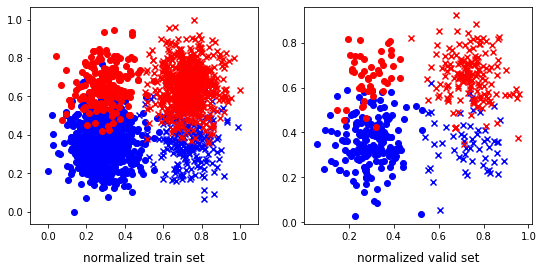

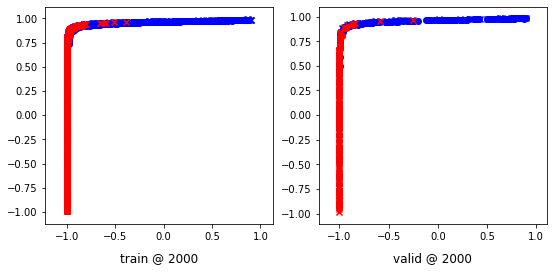

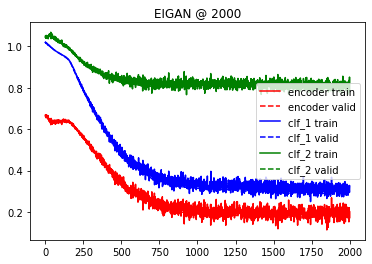

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:34, 12.93it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.06794222 	 0.06777589 	 0.03429604 	 0.03383714 	 0.01664163 	 0.01577529


 25%|██▌       | 502/2001 [00:31<01:36, 15.54it/s]

500 	 0.02544119 	 0.02604025 	 -0.02133266 	 -0.02082359 	 -0.01626881 	 -0.01648057


 50%|█████     | 1003/2001 [01:04<01:13, 13.51it/s]

1000 	 -0.00539077 	 -0.00450202 	 -0.06566972 	 -0.06536734 	 -0.04551465 	 -0.04670897


 75%|███████▌  | 1505/2001 [01:37<00:26, 18.57it/s]

1500 	 -0.03307173 	 -0.03042602 	 -0.12818663 	 -0.12645447 	 -0.10840636 	 -0.10988458


100%|██████████| 2001/2001 [02:08<00:00, 15.55it/s]


2000 	 -0.05562155 	 -0.05539523 	 -0.19596083 	 -0.19539370 	 -0.17461744 	 -0.17416368


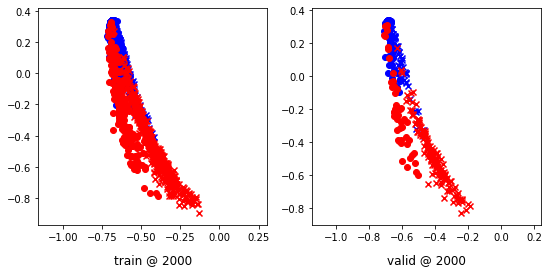

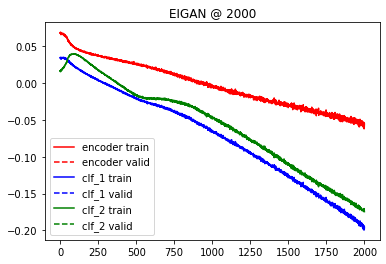

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.061625 	 1.061754 	 0.4719
200 	 0.602566 	 0.593307 	 0.9011
400 	 0.284970 	 0.268416 	 0.9371
600 	 0.263783 	 0.248144 	 0.9348
800 	 0.262225 	 0.246989 	 0.9348
1000 	 0.261643 	 0.246587 	 0.9348
Accuracy: 0.9348314606741573
Error Rate: 0.0651685393258427
F1 Score: 0.9307875894988067
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9348314606741573
Error Rate: 0.0651685393258427
F1 Score: 0.9307875894988067
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9213483146067416
Error Rate: 0.078

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.186906 	 0.181951 	 0.9528
Accuracy: 0.952808988764045
Error Rate: 0.04719101123595506
F1 Score: 0.9505882352941176
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8764044943820225
Error Rate: 0.12359550561797752
F1 Score: 0.8655256723716382
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9685393258426966
Error Rate: 0.03146067415730337
F1 Score: 0.9678899082568807
VAR1: 0.2, VAR2: 0.6, TRIAL: 7
X, y_1, y2
(2765, 2) (2765, 1) (2765, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2212, 2) (553, 2) (2212, 1) (553, 1) (2212, 1) (553, 1)
class weights => w1, w2 [1.9909991  2.00908265] [1.64094955 2.56018519]
tensor sizes => torch.Size([2212, 2]) torch.Size([553, 2]) torch.Size([2212, 2]) torch.Size([553, 2]) torch.Size([2212, 2]) torch.Size([553, 2])
--------------------------------------------------------------------------------
EIGAN Training
------

  0%|          | 2/2001 [00:00<02:21, 14.18it/s]

0 	 0.71259952 	 0.70670724 	 1.04651010 	 1.04796553 	 1.02728784 	 1.03440547


 25%|██▌       | 502/2001 [00:47<02:16, 10.98it/s]

500 	 0.37476188 	 0.41616511 	 0.60597736 	 0.66893649 	 0.93055928 	 0.94591856


 50%|█████     | 1001/2001 [01:34<01:35, 10.51it/s]

1000 	 0.28323090 	 0.39556211 	 0.55033576 	 0.64711887 	 0.96054482 	 0.94470394


 75%|███████▌  | 1503/2001 [02:21<00:44, 11.17it/s]

1500 	 0.34461647 	 0.38511437 	 0.58125222 	 0.64027363 	 0.93003732 	 0.94830644


100%|██████████| 2001/2001 [03:07<00:00, 10.67it/s]


2000 	 0.39953750 	 0.39166760 	 0.65607226 	 0.64406872 	 0.94907057 	 0.94554830


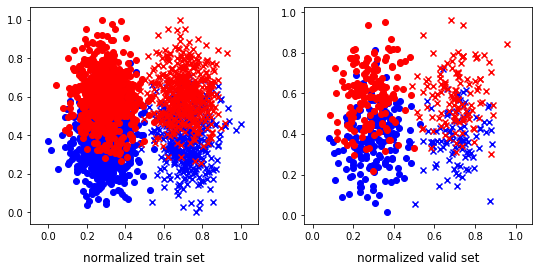

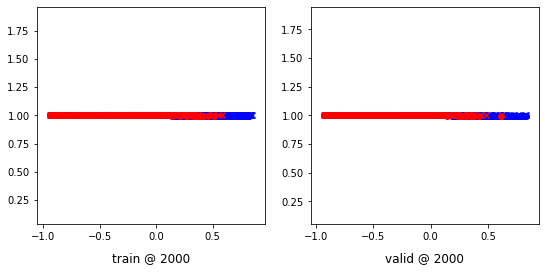

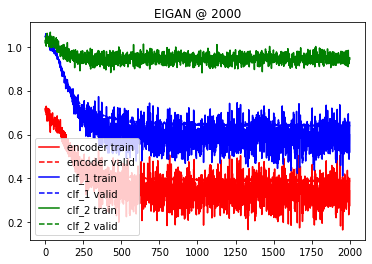

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:32, 13.08it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.11596087 	 0.11528410 	 0.05928115 	 0.05904260 	 -0.03793966 	 -0.03715289


 25%|██▌       | 501/2001 [00:44<02:09, 11.56it/s]

500 	 0.05618178 	 0.05848036 	 -0.01765128 	 -0.01521154 	 -0.07171790 	 -0.07146253


 50%|█████     | 1002/2001 [01:30<01:29, 11.20it/s]

1000 	 0.03804307 	 0.03800889 	 -0.09539641 	 -0.09404894 	 -0.16529343 	 -0.16339763


 75%|███████▌  | 1502/2001 [02:16<00:47, 10.56it/s]

1500 	 0.00811358 	 0.00250672 	 -0.15946771 	 -0.16409150 	 -0.20936663 	 -0.20816444


100%|██████████| 2001/2001 [03:01<00:00, 11.04it/s]


2000 	 -0.00553596 	 0.00988320 	 -0.28630930 	 -0.27625728 	 -0.32987976 	 -0.33492100


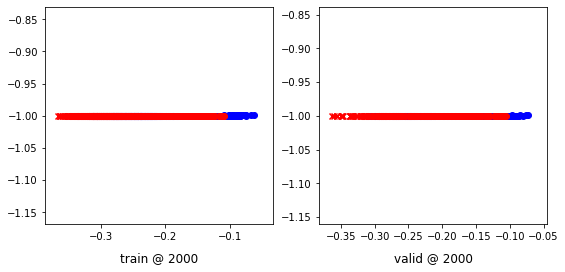

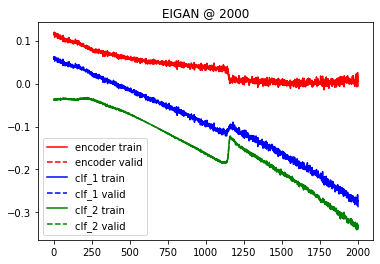

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.015743 	 1.015725 	 0.4973
200 	 0.732994 	 0.748758 	 0.7613
400 	 0.582163 	 0.641477 	 0.7758
600 	 0.581269 	 0.642479 	 0.7776
800 	 0.581087 	 0.642443 	 0.7776
1000 	 0.580999 	 0.642409 	 0.7758
Accuracy: 0.7757685352622061
Error Rate: 0.22423146473779385
F1 Score: 0.7642585551330798
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7757685352622061
Error Rate: 0.22423146473779385
F1 Score: 0.7633587786259542
SVM
--------------------------------------------------------------------------------
Accuracy: 0.783001808318264
Error Rate: 0.21

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.8933092224231465
Error Rate: 0.10669077757685352
F1 Score: 0.8591885441527448
VAR1: 0.2, VAR2: 0.8, TRIAL: 7
X, y_1, y2
(2003, 2) (2003, 1) (2003, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1602, 2) (401, 2) (1602, 1) (401, 1) (1602, 1) (401, 1)
class weights => w1, w2 [1.87149533 2.14745308] [1.6970339  2.43465046]
tensor sizes => torch.Size([1602, 2]) torch.Size([401, 2]) torch.Size([1602, 2]) torch.Size([401, 2]) torch.Size([1602, 2]) torch.Size([401, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.68897796 	 0.68998539 	 1.02571213 	 1.02471483 	 1.03026021 	 1.02787662


 25%|██▌       | 504/2001 [00:31<01:35, 15.69it/s]

500 	 0.57623845 	 0.55862993 	 0.74448258 	 0.71322519 	 0.86146069 	 0.84774244


 50%|█████     | 1004/2001 [01:04<01:04, 15.44it/s]

1000 	 0.52797878 	 0.51870835 	 0.74874133 	 0.72372931 	 0.91399544 	 0.89816815


 75%|███████▌  | 1502/2001 [01:36<00:32, 15.22it/s]

1500 	 0.44188100 	 0.47132307 	 0.60472792 	 0.62662196 	 0.85554028 	 0.84844607


100%|██████████| 2001/2001 [02:08<00:00, 15.54it/s]


2000 	 0.54309869 	 0.55656409 	 0.64191973 	 0.65048212 	 0.79237401 	 0.78706521


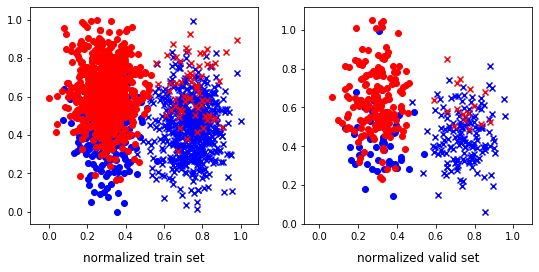

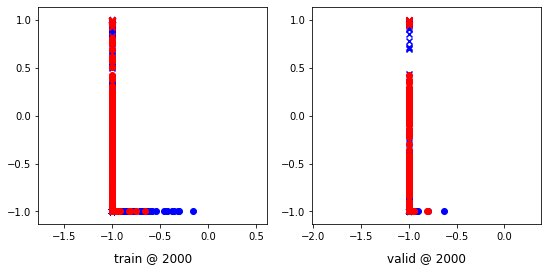

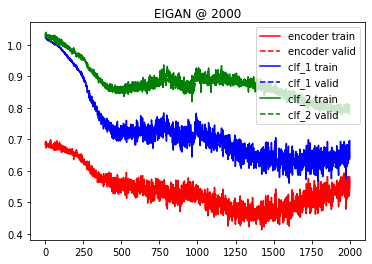

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:19, 25.04it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.02146153 	 0.02105590 	 -0.00325676 	 -0.00411424 	 0.04286462 	 0.04134899


 25%|██▌       | 503/2001 [00:30<01:30, 16.64it/s]

500 	 -0.04815842 	 -0.04487611 	 -0.10346331 	 -0.10255107 	 -0.03508634 	 -0.04015610


 50%|█████     | 1003/2001 [01:01<01:04, 15.57it/s]

1000 	 -0.06227526 	 -0.06956324 	 -0.19158241 	 -0.19627005 	 -0.15959153 	 -0.15595898


 75%|███████▌  | 1502/2001 [01:32<00:29, 16.92it/s]

1500 	 -0.05178964 	 -0.05539726 	 -0.27414444 	 -0.27640605 	 -0.27154499 	 -0.27011570


100%|██████████| 2001/2001 [02:03<00:00, 16.25it/s]


2000 	 -0.01530805 	 -0.00545409 	 -0.36635605 	 -0.36250526 	 -0.39249128 	 -0.39753759


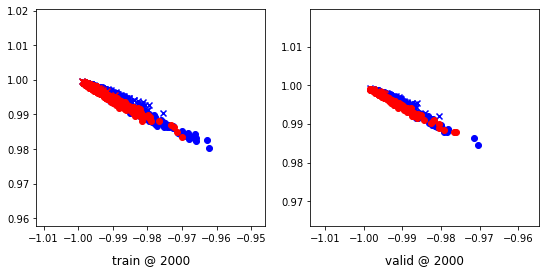

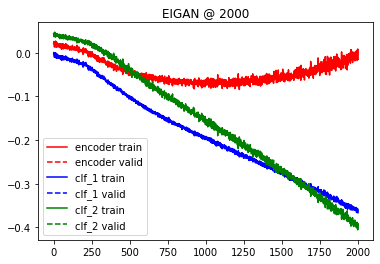

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.063079 	 1.063357 	 0.5337
200 	 0.619944 	 0.618603 	 0.8180
400 	 0.535321 	 0.539590 	 0.8254
600 	 0.532751 	 0.538297 	 0.8329
800 	 0.531645 	 0.538118 	 0.8329
1000 	 0.530418 	 0.537913 	 0.8279
Accuracy: 0.827930174563591
Error Rate: 0.17206982543640897
F1 Score: 0.8198433420365535
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.827930174563591
Error Rate: 0.17206982543640897
F1 Score: 0.821705426356589
SVM
--------------------------------------------------------------------------------
Accuracy: 0.830423940149626
Error Rate: 0.16957

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.5885286783042394
Error Rate: 0.4114713216957606
F1 Score: 0.0
VAR1: 0.4, VAR2: 0.2, TRIAL: 7
X, y_1, y2
(2089, 2) (2089, 1) (2089, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1671, 2) (418, 2) (1671, 1) (418, 1) (1671, 1) (418, 1)
class weights => w1, w2 [1.42576792 3.34869739] [2.17295189 1.85254989]
tensor sizes => torch.Size([1671, 2]) torch.Size([418, 2]) torch.Size([1671, 2]) torch.Size([418, 2]) torch.Size([1671, 2]) torch.Size([418, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.70803070 	 0.71676254 	 1.07551324 	 1.08416677 	 1.06114912 	 1.06055140


 25%|██▌       | 502/2001 [00:33<01:45, 14.25it/s]

500 	 -0.03165668 	 -0.01562150 	 0.22984967 	 0.24460189 	 0.95466262 	 0.95337057


 50%|█████     | 1002/2001 [01:05<01:06, 14.93it/s]

1000 	 -0.20782977 	 -0.19877213 	 0.05050185 	 0.06152165 	 0.95145494 	 0.95344096


 75%|███████▌  | 1503/2001 [01:38<00:36, 13.47it/s]

1500 	 -0.19730881 	 -0.21662016 	 0.06168997 	 0.04362862 	 0.95229012 	 0.95339596


100%|██████████| 2001/2001 [02:11<00:00, 15.27it/s]


2000 	 -0.21431749 	 -0.22826004 	 0.04751173 	 0.03185547 	 0.95517284 	 0.95326269


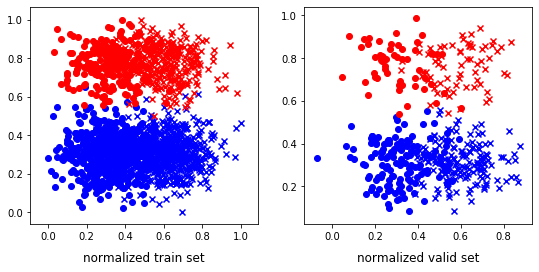

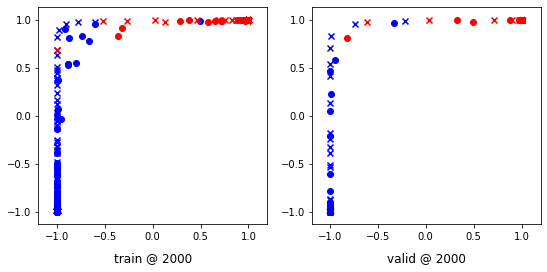

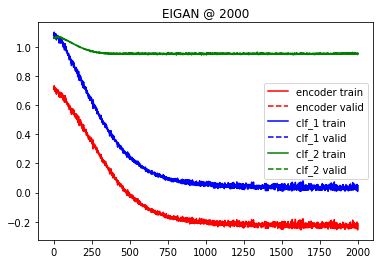

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:45, 18.85it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.07266230 	 0.07344857 	 0.00843395 	 0.00921289 	 -0.05333748 	 -0.05344758


 25%|██▌       | 503/2001 [00:31<01:35, 15.72it/s]

500 	 0.03612693 	 0.03577930 	 -0.07052279 	 -0.06959529 	 -0.12656976 	 -0.12461452


 50%|█████     | 1004/2001 [01:03<00:56, 17.61it/s]

1000 	 0.03092276 	 0.03056031 	 -0.09747194 	 -0.09693839 	 -0.15831503 	 -0.15706959


 75%|███████▌  | 1504/2001 [01:34<00:30, 16.51it/s]

1500 	 0.02509481 	 0.02613166 	 -0.13626461 	 -0.13463232 	 -0.20168918 	 -0.20095383


100%|██████████| 2001/2001 [02:05<00:00, 15.95it/s]


2000 	 0.01628909 	 0.01511869 	 -0.15555726 	 -0.15512584 	 -0.21447505 	 -0.21260698


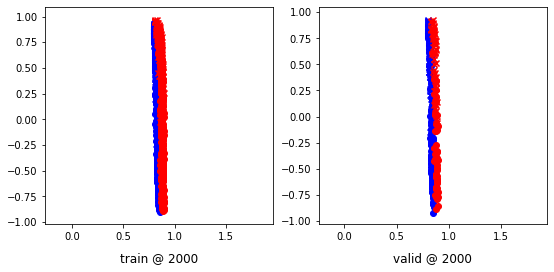

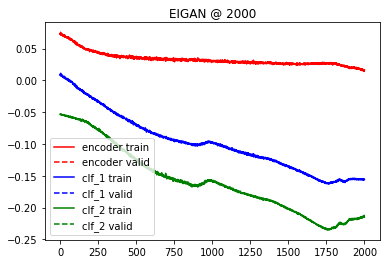

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.085243 	 1.084195 	 0.2967
200 	 0.240006 	 0.249431 	 0.9880
400 	 0.058690 	 0.061951 	 0.9904
600 	 0.040371 	 0.040155 	 0.9904
800 	 0.035001 	 0.032769 	 0.9904
1000 	 0.032891 	 0.029269 	 0.9904
Accuracy: 0.9904306220095693
Error Rate: 0.009569377990430622
F1 Score: 0.9838709677419355
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9904306220095693
Error Rate: 0.009569377990430622
F1 Score: 0.9840000000000001
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9904306220095693
Error Rate: 0

  0%|          | 1/2001 [00:00<04:31,  7.36it/s]

tensor sizes => torch.Size([2552, 2]) torch.Size([638, 2]) torch.Size([2552, 2]) torch.Size([638, 2]) torch.Size([2552, 2]) torch.Size([638, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.61344266 	 0.61487246 	 1.01162326 	 1.00973523 	 1.09145784 	 1.08800995


 25%|██▌       | 502/2001 [00:50<02:21, 10.56it/s]

500 	 0.12584966 	 0.09900054 	 0.34812772 	 0.33285949 	 0.91542858 	 0.92700613


 50%|█████     | 1003/2001 [01:40<01:43,  9.63it/s]

1000 	 0.08135080 	 0.07628447 	 0.31345418 	 0.31173867 	 0.92538607 	 0.92860138


 75%|███████▌  | 1503/2001 [02:30<00:43, 11.58it/s]

1500 	 0.05386060 	 0.07214203 	 0.30460417 	 0.30800232 	 0.94391471 	 0.92900747


100%|██████████| 2001/2001 [03:19<00:00, 10.03it/s]


2000 	 0.08691487 	 0.07632712 	 0.33385015 	 0.31210038 	 0.94027060 	 0.92892045


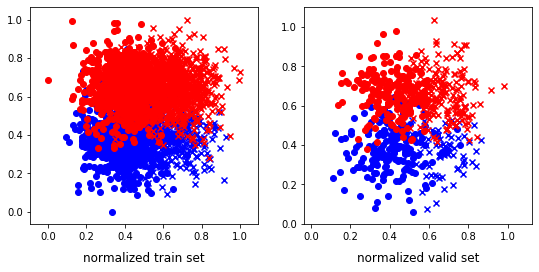

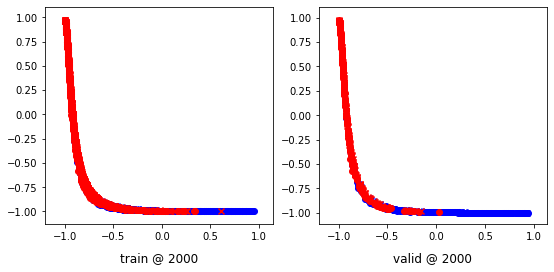

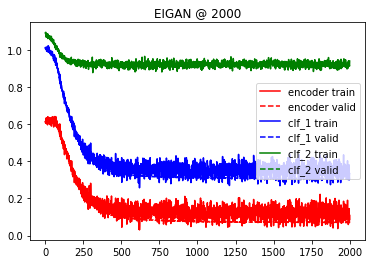

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 1/2001 [00:00<04:20,  7.67it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.05843616 	 0.05656707 	 0.04522668 	 0.04320691 	 0.08525191 	 0.08441387


 25%|██▌       | 501/2001 [00:47<02:27, 10.19it/s]

500 	 -0.09228715 	 -0.09268719 	 -0.12870267 	 -0.12909032 	 0.00918779 	 0.00920394


 50%|█████     | 1001/2001 [01:34<01:29, 11.20it/s]

1000 	 -0.18347168 	 -0.19447735 	 -0.26811227 	 -0.27553245 	 -0.09092982 	 -0.08470175


 75%|███████▌  | 1503/2001 [02:20<00:47, 10.51it/s]

1500 	 -0.30745602 	 -0.30601174 	 -0.44927433 	 -0.45112011 	 -0.17658763 	 -0.18093091


100%|██████████| 2001/2001 [03:08<00:00, 10.64it/s]


2000 	 -0.42436540 	 -0.42069572 	 -0.66330516 	 -0.65823966 	 -0.28881463 	 -0.28738478


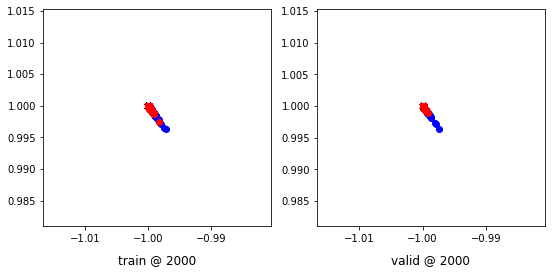

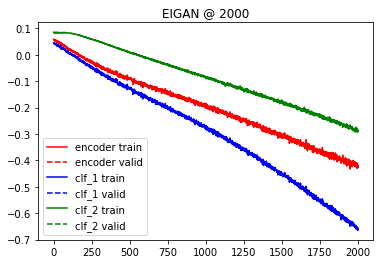

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.035020 	 1.035402 	 0.4013
200 	 0.663170 	 0.648187 	 0.8856
400 	 0.357352 	 0.318546 	 0.9107
600 	 0.341912 	 0.296533 	 0.9091
800 	 0.341079 	 0.294983 	 0.9091
1000 	 0.340932 	 0.294777 	 0.9091
Accuracy: 0.9090909090909091
Error Rate: 0.09090909090909091
F1 Score: 0.9246753246753248
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9137931034482759
Error Rate: 0.08620689655172414
F1 Score: 0.9277266754270697
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9059561128526645
Error Rate: 0.0

  0%|          | 1/2001 [00:00<03:55,  8.51it/s]

Accuracy: 0.5877742946708464
Error Rate: 0.4122257053291536
F1 Score: 0.0
VAR1: 0.4, VAR2: 0.6, TRIAL: 7
X, y_1, y2
(2655, 2) (2655, 1) (2655, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2124, 2) (531, 2) (2124, 1) (531, 1) (2124, 1) (531, 1)
class weights => w1, w2 [1.55376737 2.80581242] [2.49003517 1.6711251 ]
tensor sizes => torch.Size([2124, 2]) torch.Size([531, 2]) torch.Size([2124, 2]) torch.Size([531, 2]) torch.Size([2124, 2]) torch.Size([531, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.65463805 	 0.63505673 	 1.06539130 	 1.04301846 	 1.10396290 	 1.10110891


 25%|██▌       | 502/2001 [00:46<02:25, 10.32it/s]

500 	 0.35426110 	 0.35687518 	 0.50520015 	 0.56037802 	 0.84492272 	 0.89665002


 50%|█████     | 1003/2001 [01:33<01:33, 10.65it/s]

1000 	 0.28343302 	 0.33373517 	 0.52191263 	 0.54428911 	 0.93670493 	 0.90370113


 75%|███████▌  | 1503/2001 [02:19<00:42, 11.85it/s]

1500 	 0.42529362 	 0.33041751 	 0.74167085 	 0.54162574 	 1.01358044 	 0.90435541


100%|██████████| 2001/2001 [03:05<00:00, 10.76it/s]


2000 	 0.38583082 	 0.32937878 	 0.57002622 	 0.53989661 	 0.87813365 	 0.90366501


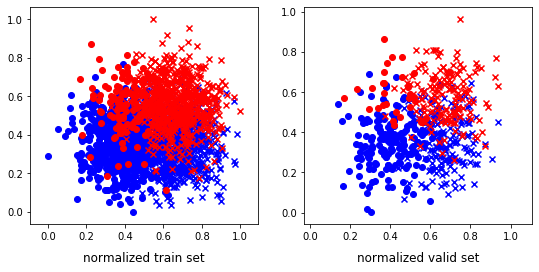

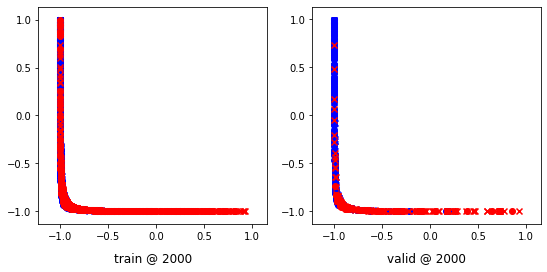

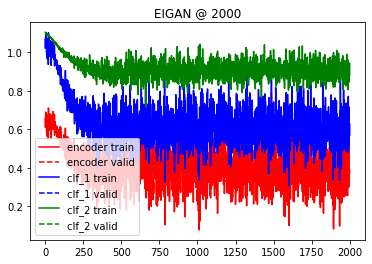

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 1/2001 [00:00<04:30,  7.40it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.05234797 	 0.05274199 	 0.02819330 	 0.02837649 	 0.04469611 	 0.04390548


 25%|██▌       | 503/2001 [00:45<02:24, 10.40it/s]

500 	 -0.06405021 	 -0.05877946 	 -0.13372979 	 -0.12919137 	 -0.06396315 	 -0.06535244


 50%|█████     | 1002/2001 [01:29<01:44,  9.60it/s]

1000 	 -0.12985113 	 -0.12348968 	 -0.27134705 	 -0.26612347 	 -0.17615919 	 -0.17766888


 75%|███████▌  | 1503/2001 [02:14<00:45, 10.98it/s]

1500 	 -0.16717255 	 -0.16330066 	 -0.42750430 	 -0.42513978 	 -0.31022713 	 -0.31170216


100%|██████████| 2001/2001 [02:59<00:00, 11.13it/s]

2000 	 -0.16710976 	 -0.16792867 	 -0.61538237 	 -0.62437707 	 -0.46953163 	 -0.47560966


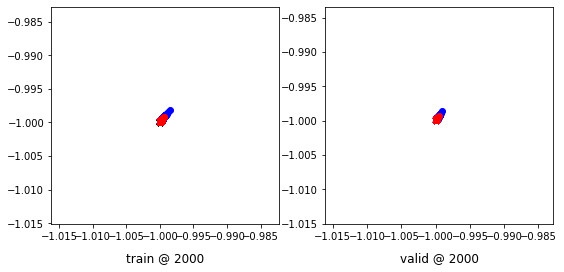

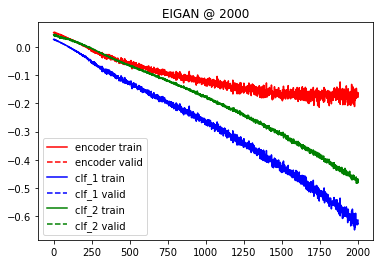

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.001103 	 1.001529 	 0.6441
200 	 0.689216 	 0.660846 	 0.8324
400 	 0.564420 	 0.503742 	 0.8286
600 	 0.562327 	 0.503033 	 0.8286
800 	 0.560532 	 0.502684 	 0.8267
1000 	 0.559217 	 0.502838 	 0.8267
Accuracy: 0.8286252354048964
Error Rate: 0.1713747645951036
F1 Score: 0.7741935483870966
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8248587570621468
Error Rate: 0.1751412429378531
F1 Score: 0.7780429594272076
SVM
--------------------------------------------------------------------------------
Accuracy: 0.839924670433145
Error Rate: 0.1600

  0%|          | 2/2001 [00:00<01:58, 16.81it/s]

Accuracy: 0.8983050847457628
Error Rate: 0.1016949152542373
F1 Score: 0.915625
VAR1: 0.4, VAR2: 0.8, TRIAL: 7
X, y_1, y2
(2333, 2) (2333, 1) (2333, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1866, 2) (467, 2) (1866, 1) (467, 1) (1866, 1) (467, 1)
class weights => w1, w2 [3.87136929 1.3482659 ] [1.9662803 2.0348964]
tensor sizes => torch.Size([1866, 2]) torch.Size([467, 2]) torch.Size([1866, 2]) torch.Size([467, 2]) torch.Size([1866, 2]) torch.Size([467, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.63754833 	 0.63791990 	 1.02424061 	 1.02499008 	 1.08044660 	 1.08021736


 25%|██▌       | 502/2001 [00:34<01:34, 15.85it/s]

500 	 0.47200483 	 0.48032433 	 0.73540115 	 0.74089146 	 0.95658332 	 0.95371431


 50%|█████     | 1004/2001 [01:09<00:56, 17.72it/s]

1000 	 0.45416760 	 0.46161377 	 0.70584553 	 0.71347886 	 0.94490659 	 0.94501227


 75%|███████▌  | 1503/2001 [01:44<00:33, 14.81it/s]

1500 	 0.46611691 	 0.45891398 	 0.71801937 	 0.71054244 	 0.94506085 	 0.94477564


100%|██████████| 2001/2001 [02:19<00:00, 14.33it/s]


2000 	 0.46039242 	 0.45991892 	 0.70951331 	 0.70961678 	 0.94238025 	 0.94284505


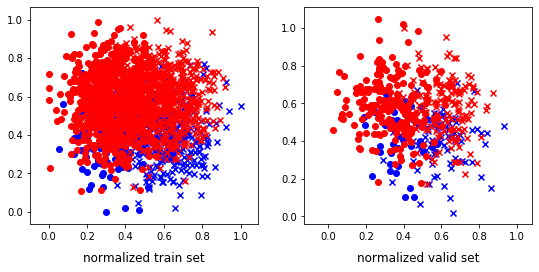

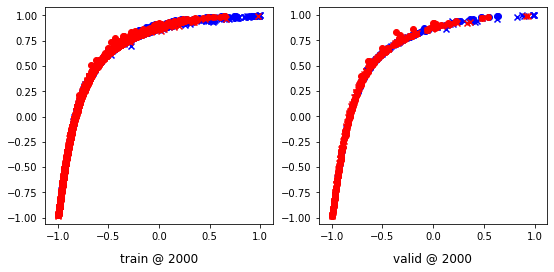

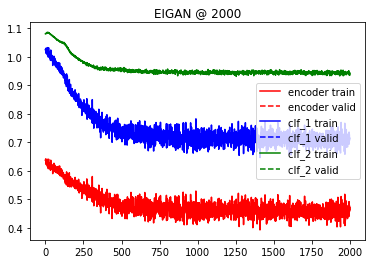

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<01:53, 17.58it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.03745120 	 0.03935966 	 0.01582631 	 0.01784271 	 0.05310482 	 0.05331343


 25%|██▌       | 502/2001 [00:34<01:52, 13.34it/s]

500 	 -0.00261666 	 -0.00512890 	 -0.03636912 	 -0.03904954 	 0.01629270 	 0.01582444


 50%|█████     | 1003/2001 [01:08<01:02, 15.94it/s]

1000 	 -0.03990740 	 -0.03900390 	 -0.08659296 	 -0.08563940 	 -0.01606616 	 -0.01595254


 75%|███████▌  | 1503/2001 [01:41<00:36, 13.71it/s]

1500 	 -0.08505111 	 -0.08657245 	 -0.14830704 	 -0.14987667 	 -0.05150335 	 -0.05160332


100%|██████████| 2001/2001 [02:14<00:00, 14.86it/s]


2000 	 -0.12968661 	 -0.13571934 	 -0.21816596 	 -0.22360449 	 -0.09745464 	 -0.09645429


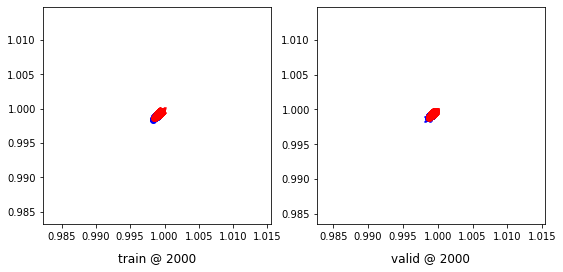

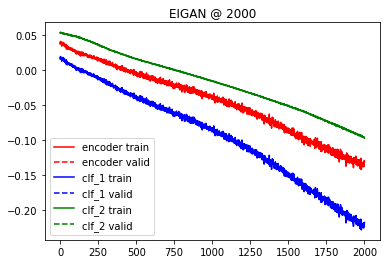

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.049964 	 1.050531 	 0.2591
200 	 0.719007 	 0.719199 	 0.7880
400 	 0.695561 	 0.695494 	 0.7816
600 	 0.694797 	 0.695131 	 0.7816
800 	 0.694407 	 0.694847 	 0.7816
1000 	 0.694081 	 0.694499 	 0.7816
Accuracy: 0.7815845824411135
Error Rate: 0.21841541755888652
F1 Score: 0.8526011560693642
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7430406852248393
Error Rate: 0.2569593147751606
F1 Score: 0.8119122257053292
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7708779443254818
Error Rate: 0.22

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.8586723768736617
Error Rate: 0.14132762312633834
F1 Score: 0.8601694915254238
VAR1: 0.6, VAR2: 0.2, TRIAL: 7
X, y_1, y2
(2458, 2) (2458, 1) (2458, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1966, 2) (492, 2) (1966, 1) (492, 1) (1966, 1) (492, 1)
class weights => w1, w2 [3.35494881 1.42463768] [2.5237484  1.65627633]
tensor sizes => torch.Size([1966, 2]) torch.Size([492, 2]) torch.Size([1966, 2]) torch.Size([492, 2]) torch.Size([1966, 2]) torch.Size([492, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.70273864 	 0.69602668 	 1.03094208 	 1.02270913 	 1.02147770 	 1.01982963


 25%|██▌       | 503/2001 [00:35<01:55, 12.98it/s]

500 	 -0.03601390 	 -0.03646135 	 0.17882608 	 0.17724472 	 0.90798849 	 0.90685326


 50%|█████     | 1004/2001 [01:11<01:02, 15.86it/s]

1000 	 -0.15828522 	 -0.16160181 	 0.05269558 	 0.04872493 	 0.90415168 	 0.90347391


 75%|███████▌  | 1503/2001 [01:46<00:37, 13.29it/s]

1500 	 -0.20131561 	 -0.17665699 	 0.02053150 	 0.03418835 	 0.91506034 	 0.90399253


100%|██████████| 2001/2001 [02:20<00:00, 14.22it/s]


2000 	 -0.19398648 	 -0.17629400 	 0.01699813 	 0.03457318 	 0.90414065 	 0.90401435


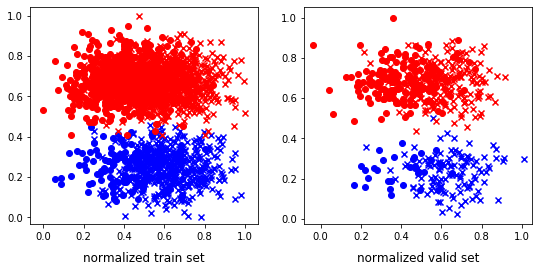

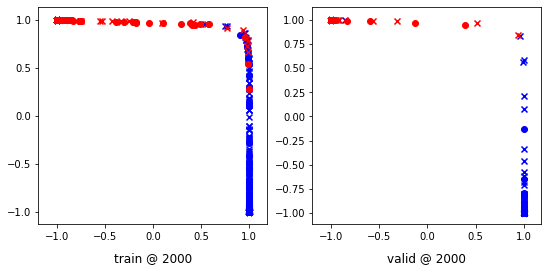

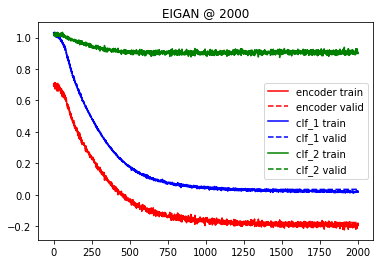

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:07, 15.62it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.13384306 	 0.13364761 	 0.08354535 	 0.08334921 	 -0.02421403 	 -0.02427302


 25%|██▌       | 502/2001 [00:34<01:52, 13.38it/s]

500 	 0.01561788 	 0.01450267 	 -0.05024854 	 -0.05152421 	 -0.05660085 	 -0.05695695


 50%|█████     | 1003/2001 [01:09<01:10, 14.25it/s]

1000 	 -0.13200715 	 -0.13353020 	 -0.22721675 	 -0.22923520 	 -0.10855884 	 -0.10936227


 75%|███████▌  | 1502/2001 [01:43<00:34, 14.37it/s]

1500 	 -0.26133633 	 -0.27284783 	 -0.39457935 	 -0.40566909 	 -0.16502449 	 -0.16444653


100%|██████████| 2001/2001 [02:17<00:00, 14.53it/s]


2000 	 -0.40978795 	 -0.41055867 	 -0.59283578 	 -0.59393173 	 -0.22784080 	 -0.22822081


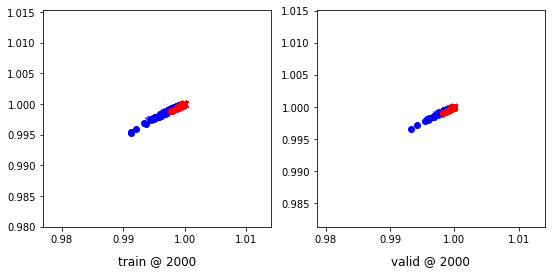

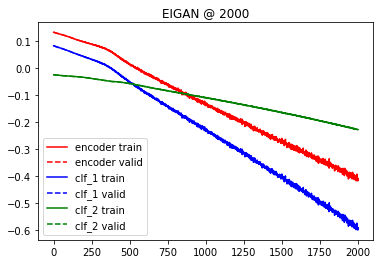

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.053695 	 1.053989 	 0.7012
200 	 0.315552 	 0.289940 	 0.9898
400 	 0.071912 	 0.058946 	 0.9939
600 	 0.039869 	 0.032385 	 0.9959
800 	 0.029737 	 0.025014 	 0.9959
1000 	 0.025050 	 0.022190 	 0.9959
Accuracy: 0.9959349593495935
Error Rate: 0.0040650406504065045
F1 Score: 0.9971014492753624
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9939024390243902
Error Rate: 0.006097560975609756
F1 Score: 0.9956458635703919
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9959349593495935
Error Rate: 

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.7479674796747967
Error Rate: 0.25203252032520324
F1 Score: 0.8012820512820514
VAR1: 0.6, VAR2: 0.4, TRIAL: 7
X, y_1, y2
(1840, 2) (1840, 1) (1840, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1472, 2) (368, 2) (1472, 1) (368, 1) (1472, 1) (368, 1)
class weights => w1, w2 [2.56       1.64102564] [5.35272727 1.22974102]
tensor sizes => torch.Size([1472, 2]) torch.Size([368, 2]) torch.Size([1472, 2]) torch.Size([368, 2]) torch.Size([1472, 2]) torch.Size([368, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.70260119 	 0.71518290 	 1.03402948 	 1.04034460 	 1.02485979 	 1.01830888


 25%|██▌       | 503/2001 [00:31<01:35, 15.62it/s]

500 	 0.27752465 	 0.31190598 	 0.49754804 	 0.49156588 	 0.91325545 	 0.87280709


 50%|█████     | 1004/2001 [01:01<01:02, 15.93it/s]

1000 	 0.16817486 	 0.20084676 	 0.34641063 	 0.37632009 	 0.87146121 	 0.86862051


 75%|███████▌  | 1503/2001 [01:32<00:32, 15.12it/s]

1500 	 0.15530619 	 0.19051713 	 0.33458692 	 0.36634082 	 0.87345111 	 0.86897087


100%|██████████| 2001/2001 [02:02<00:00, 16.30it/s]


2000 	 0.18249968 	 0.19280723 	 0.33979833 	 0.36901632 	 0.85037643 	 0.86935627


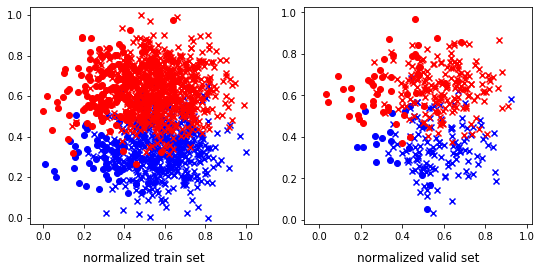

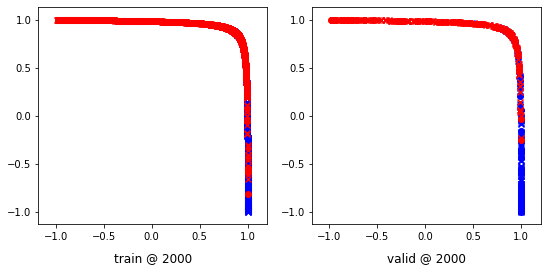

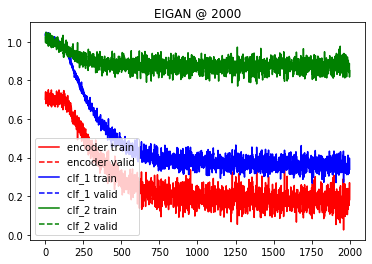

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:31, 21.83it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.13359442 	 0.12962949 	 0.08436628 	 0.08067083 	 -0.02178239 	 -0.02126605


 25%|██▌       | 503/2001 [00:29<01:40, 14.89it/s]

500 	 0.06665705 	 0.07015780 	 0.01053910 	 0.01310592 	 -0.03685571 	 -0.03885536


 50%|█████     | 1005/2001 [00:59<00:57, 17.41it/s]

1000 	 0.02598174 	 0.02758890 	 -0.06621457 	 -0.06463294 	 -0.10363729 	 -0.10368051


 75%|███████▌  | 1503/2001 [01:29<00:29, 17.13it/s]

1500 	 -0.00302847 	 -0.00517727 	 -0.14393553 	 -0.14663728 	 -0.17537548 	 -0.17611168


100%|██████████| 2001/2001 [01:58<00:00, 16.83it/s]


2000 	 -0.02446111 	 -0.02656293 	 -0.23758909 	 -0.23967822 	 -0.26165774 	 -0.26164412


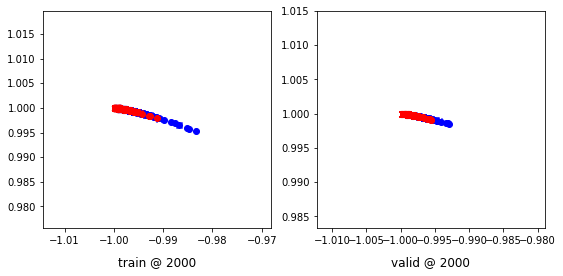

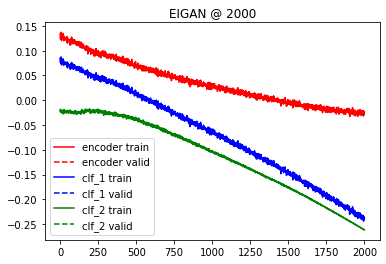

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.043521 	 1.043911 	 0.6087
200 	 0.662129 	 0.667618 	 0.8614
400 	 0.369711 	 0.374047 	 0.8940
600 	 0.361138 	 0.364548 	 0.8913
800 	 0.360392 	 0.364044 	 0.8913
1000 	 0.360118 	 0.363991 	 0.8913
Accuracy: 0.8913043478260869
Error Rate: 0.10869565217391304
F1 Score: 0.9118942731277534
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8885869565217391
Error Rate: 0.11141304347826086
F1 Score: 0.9086859688195991
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8913043478260869
Error Rate: 0.1

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.8152173913043478
Error Rate: 0.18478260869565216
F1 Score: 0.8982035928143712
VAR1: 0.6, VAR2: 0.6, TRIAL: 7
X, y_1, y2
(2203, 2) (2203, 1) (2203, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1762, 2) (441, 2) (1762, 1) (441, 1) (1762, 1) (441, 1)
class weights => w1, w2 [2.05600933 1.94696133] [1.48316498 3.06968641]
tensor sizes => torch.Size([1762, 2]) torch.Size([441, 2]) torch.Size([1762, 2]) torch.Size([441, 2]) torch.Size([1762, 2]) torch.Size([441, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.71525395 	 0.72237289 	 1.03633606 	 1.04185450 	 1.01436925 	 1.01262879


 25%|██▌       | 502/2001 [00:32<01:50, 13.51it/s]

500 	 0.43353307 	 0.38449079 	 0.66529655 	 0.62039959 	 0.92499709 	 0.92905599


 50%|█████     | 1002/2001 [01:05<01:14, 13.45it/s]

1000 	 0.37423497 	 0.33430851 	 0.59943646 	 0.57093078 	 0.91845202 	 0.92976946


 75%|███████▌  | 1504/2001 [01:39<00:27, 18.23it/s]

1500 	 0.36871719 	 0.33141214 	 0.61018634 	 0.56860393 	 0.93462014 	 0.93033898


100%|██████████| 2001/2001 [02:12<00:00, 15.08it/s]


2000 	 0.33121526 	 0.32768023 	 0.55926877 	 0.56534022 	 0.92152268 	 0.93080717


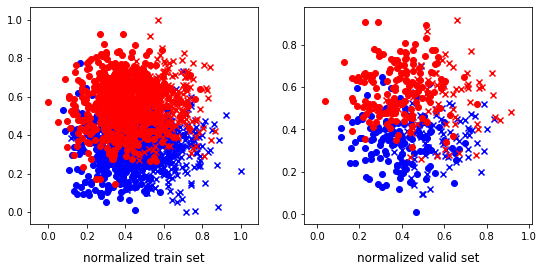

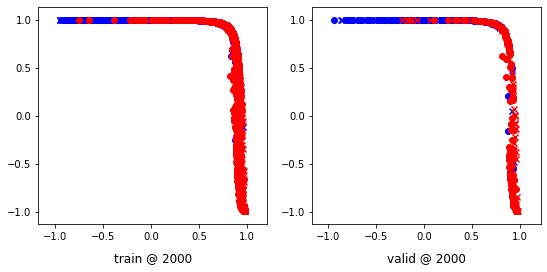

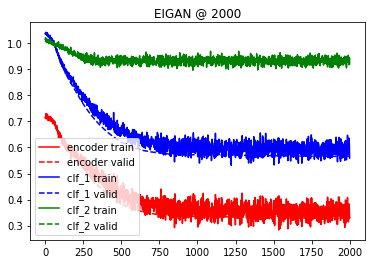

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:31, 21.90it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.06645395 	 0.06696755 	 0.04502032 	 0.04499076 	 0.05362250 	 0.05175427


 25%|██▌       | 504/2001 [00:30<01:16, 19.49it/s]

500 	 0.03863524 	 0.03850651 	 0.00333195 	 0.00329515 	 0.01211925 	 0.01235311


 50%|█████     | 1003/2001 [01:01<01:04, 15.43it/s]

1000 	 -0.01914646 	 -0.01895664 	 -0.08008526 	 -0.08020658 	 -0.04685661 	 -0.04748725


 75%|███████▌  | 1504/2001 [01:32<00:31, 15.75it/s]

1500 	 -0.06258821 	 -0.06198163 	 -0.14915515 	 -0.14918010 	 -0.09422246 	 -0.09529386


100%|██████████| 2001/2001 [02:04<00:00, 16.13it/s]


2000 	 -0.10792383 	 -0.10705645 	 -0.22508281 	 -0.22529468 	 -0.14228490 	 -0.14385785


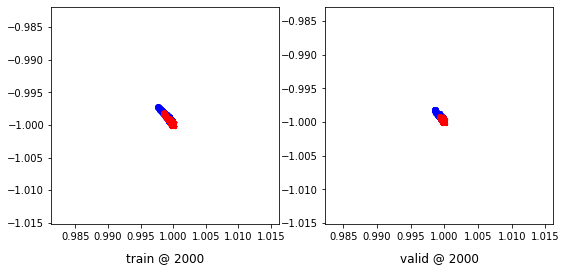

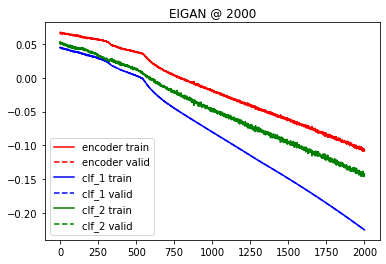

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.021803 	 1.021525 	 0.5147
200 	 0.830165 	 0.823266 	 0.8073
400 	 0.594835 	 0.562260 	 0.8277
600 	 0.592538 	 0.562159 	 0.8231
800 	 0.591858 	 0.561739 	 0.8254
1000 	 0.591687 	 0.562072 	 0.8254
Accuracy: 0.8253968253968254
Error Rate: 0.1746031746031746
F1 Score: 0.8300220750551875
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8276643990929705
Error Rate: 0.17233560090702948
F1 Score: 0.831111111111111
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8344671201814059
Error Rate: 0.165

  0%|          | 1/2001 [00:00<03:25,  9.71it/s]

Accuracy: 0.6757369614512472
Error Rate: 0.3242630385487528
F1 Score: 0.0
VAR1: 0.6, VAR2: 0.8, TRIAL: 7
X, y_1, y2
(2746, 2) (2746, 1) (2746, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2196, 2) (550, 2) (2196, 1) (550, 1) (2196, 1) (550, 1)
class weights => w1, w2 [2.1894317  1.84073764] [2.46741573 1.68147014]
tensor sizes => torch.Size([2196, 2]) torch.Size([550, 2]) torch.Size([2196, 2]) torch.Size([550, 2]) torch.Size([2196, 2]) torch.Size([550, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.65824389 	 0.66585314 	 1.04800987 	 1.04621291 	 1.08343565 	 1.07350695


 25%|██▌       | 501/2001 [00:47<02:24, 10.37it/s]

500 	 0.55519253 	 0.52091289 	 0.78848106 	 0.77165884 	 0.92693156 	 0.94389313


 50%|█████     | 1002/2001 [01:34<01:26, 11.58it/s]

1000 	 0.51976025 	 0.51243168 	 0.74306053 	 0.76316077 	 0.91655415 	 0.94387627


 75%|███████▌  | 1503/2001 [02:21<00:46, 10.80it/s]

1500 	 0.41138417 	 0.51246172 	 0.65175527 	 0.76213038 	 0.93384236 	 0.94281584


100%|██████████| 2001/2001 [03:08<00:00, 10.63it/s]


2000 	 0.47420728 	 0.51307321 	 0.69053119 	 0.76281607 	 0.90942156 	 0.94289005


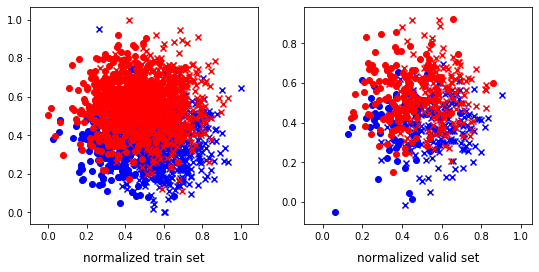

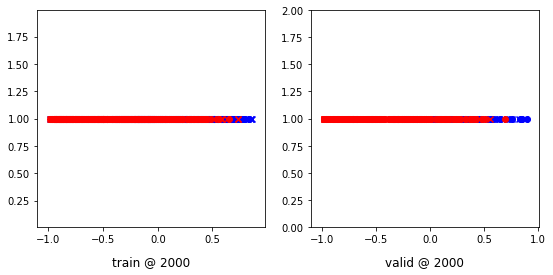

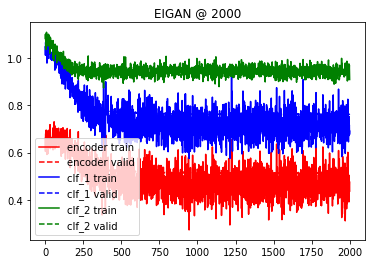

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<01:59, 16.75it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.12746778 	 0.12726228 	 0.04740605 	 0.04712881 	 -0.08292070 	 -0.08307854


 25%|██▌       | 502/2001 [00:45<02:22, 10.52it/s]

500 	 0.07102380 	 0.07965639 	 -0.04950613 	 -0.04687408 	 -0.14716965 	 -0.15571123


 50%|█████     | 1003/2001 [01:31<01:29, 11.21it/s]

1000 	 0.08418675 	 0.07779180 	 -0.14168628 	 -0.14713880 	 -0.27526084 	 -0.27426851


 75%|███████▌  | 1502/2001 [02:16<00:49, 10.14it/s]

1500 	 0.06552942 	 0.07184164 	 -0.13395815 	 -0.12948354 	 -0.24662998 	 -0.24869274


100%|██████████| 2001/2001 [03:01<00:00, 11.03it/s]


2000 	 0.05031304 	 0.04612319 	 -0.19887982 	 -0.20254678 	 -0.29918697 	 -0.29866818


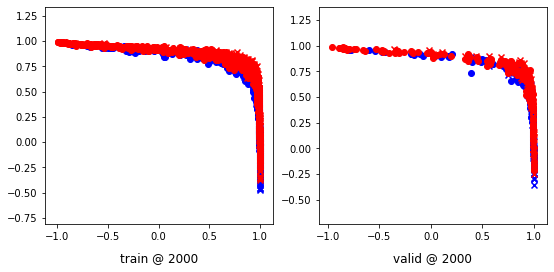

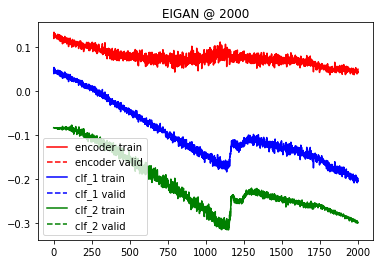

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.049661 	 1.049663 	 0.4564
200 	 0.853468 	 0.864839 	 0.7036
400 	 0.711367 	 0.757510 	 0.7036
600 	 0.710698 	 0.757629 	 0.7036
800 	 0.710577 	 0.757452 	 0.7036
1000 	 0.710523 	 0.757372 	 0.7036
Accuracy: 0.7036363636363636
Error Rate: 0.2963636363636364
F1 Score: 0.7260504201680671
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7090909090909091
Error Rate: 0.2909090909090909
F1 Score: 0.7250859106529209
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7090909090909091
Error Rate: 0.290

  0%|          | 3/2001 [00:00<01:31, 21.86it/s]

Accuracy: 0.7890909090909091
Error Rate: 0.2109090909090909
F1 Score: 0.8289085545722714
VAR1: 0.8, VAR2: 0.2, TRIAL: 7
X, y_1, y2
(1795, 2) (1795, 1) (1795, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1436, 2) (359, 2) (1436, 1) (359, 1) (1436, 1) (359, 1)
class weights => w1, w2 [1.79052369 2.26498423] [4.1744186  1.31501832]
tensor sizes => torch.Size([1436, 2]) torch.Size([359, 2]) torch.Size([1436, 2]) torch.Size([359, 2]) torch.Size([1436, 2]) torch.Size([359, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.68688846 	 0.68946445 	 1.03059947 	 1.03291726 	 1.03756690 	 1.03659999


 25%|██▌       | 502/2001 [00:30<01:28, 16.97it/s]

500 	 0.11018461 	 0.06821477 	 0.13572051 	 0.13194281 	 0.71869016 	 0.75687522


 50%|█████     | 1004/2001 [01:01<01:01, 16.18it/s]

1000 	 0.01009922 	 -0.01254991 	 0.01742412 	 0.02413120 	 0.70047754 	 0.72982830


 75%|███████▌  | 1503/2001 [01:31<00:31, 15.62it/s]

1500 	 -0.01830375 	 -0.02250535 	 0.00833327 	 0.01384055 	 0.72002518 	 0.72949308


100%|██████████| 2001/2001 [02:02<00:00, 16.37it/s]


2000 	 -0.04775315 	 -0.02475769 	 0.01131758 	 0.01104575 	 0.75227147 	 0.72895062


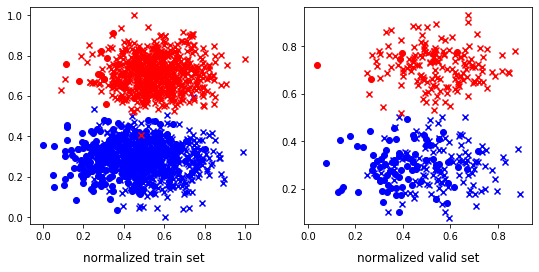

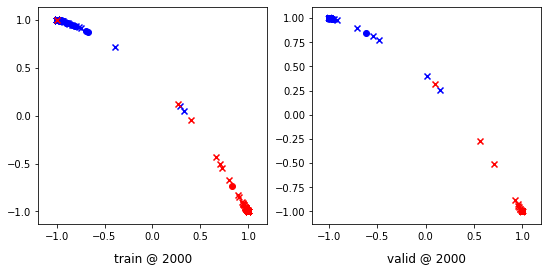

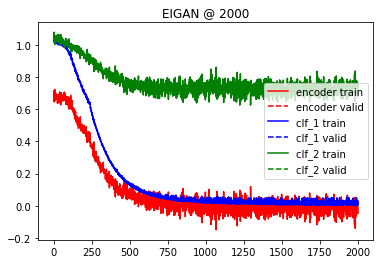

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:20, 24.67it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.00408027 	 -0.00335860 	 -0.04062383 	 -0.04062595 	 0.00896361 	 0.00695245


 25%|██▌       | 502/2001 [00:29<01:26, 17.30it/s]

500 	 -0.08426622 	 -0.08141305 	 -0.15081967 	 -0.15017623 	 -0.05793791 	 -0.06222731


 50%|█████     | 1003/2001 [00:58<00:57, 17.46it/s]

1000 	 -0.10512514 	 -0.10656716 	 -0.19903748 	 -0.20053945 	 -0.10644873 	 -0.10654899


 75%|███████▌  | 1505/2001 [01:27<00:27, 17.73it/s]

1500 	 -0.11563517 	 -0.11267081 	 -0.25182399 	 -0.24792814 	 -0.16903746 	 -0.16777347


100%|██████████| 2001/2001 [01:56<00:00, 17.14it/s]


2000 	 -0.20307432 	 -0.20337617 	 -0.36224195 	 -0.35995337 	 -0.19895539 	 -0.19569838


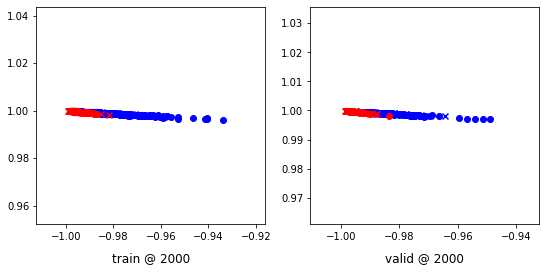

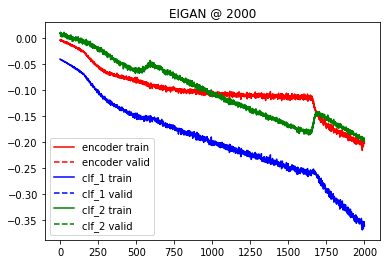

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.048084 	 1.048166 	 0.4429
200 	 0.558084 	 0.560995 	 0.9972
400 	 0.078296 	 0.083297 	 0.9944
600 	 0.035460 	 0.039260 	 0.9944
800 	 0.024981 	 0.026743 	 0.9972
1000 	 0.021553 	 0.021522 	 1.0000
Accuracy: 1.0
Error Rate: 0.0
F1 Score: 1.0
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9944289693593314
Error Rate: 0.005571030640668524
F1 Score: 0.99375
SVM
--------------------------------------------------------------------------------
Accuracy: 1.0
Error Rate: 0.0
F1 Score: 1.0
--------------------------------------------------------

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.7604456824512534
Error Rate: 0.2395543175487465
F1 Score: 0.8639240506329113
VAR1: 0.8, VAR2: 0.4, TRIAL: 7
X, y_1, y2
(1375, 2) (1375, 1) (1375, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1100, 2) (275, 2) (1100, 1) (275, 1) (1100, 1) (275, 1)
class weights => w1, w2 [2.47747748 1.67682927] [4.296875   1.30331754]
tensor sizes => torch.Size([1100, 2]) torch.Size([275, 2]) torch.Size([1100, 2]) torch.Size([275, 2]) torch.Size([1100, 2]) torch.Size([275, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.65112507 	 0.71535945 	 1.06665909 	 1.05963278 	 1.10903990 	 1.03742051


 25%|██▌       | 503/2001 [00:27<01:27, 17.20it/s]

500 	 0.26724952 	 0.26584727 	 0.52338392 	 0.48291749 	 0.95045793 	 0.91021740


 50%|█████     | 1003/2001 [00:56<00:57, 17.44it/s]

1000 	 0.16879949 	 0.16359136 	 0.34593996 	 0.38009706 	 0.86834067 	 0.90965289


 75%|███████▌  | 1502/2001 [01:23<00:24, 20.25it/s]

1500 	 0.29539573 	 0.14783692 	 0.35176829 	 0.36697388 	 0.74960387 	 0.91228414


100%|██████████| 2001/2001 [01:51<00:00, 17.93it/s]


2000 	 0.05150011 	 0.14929658 	 0.38592374 	 0.36747342 	 1.02675390 	 0.91132402


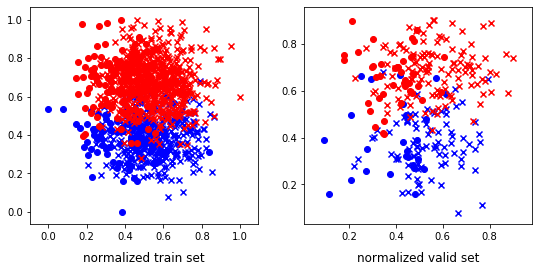

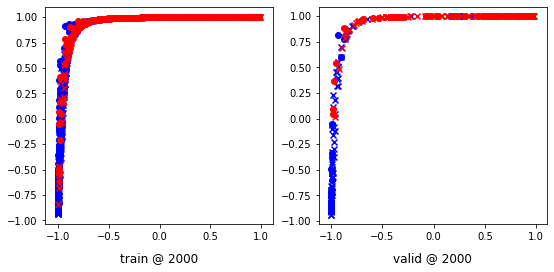

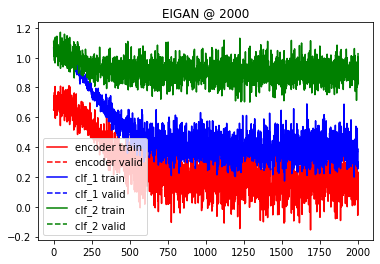

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:30, 22.13it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.01240992 	 -0.00970666 	 -0.09114849 	 -0.08838294 	 -0.08050654 	 -0.08049293


 25%|██▌       | 504/2001 [00:27<01:20, 18.52it/s]

500 	 -0.08160706 	 -0.09201022 	 -0.18474428 	 -0.19539815 	 -0.12113511 	 -0.12153993


 50%|█████     | 1003/2001 [00:53<00:47, 20.98it/s]

1000 	 -0.10498253 	 -0.10289691 	 -0.27508125 	 -0.27172935 	 -0.21242453 	 -0.21089223


 75%|███████▌  | 1503/2001 [01:20<00:27, 18.27it/s]

1500 	 -0.12131833 	 -0.12517998 	 -0.32515758 	 -0.32898518 	 -0.25144696 	 -0.25144789


100%|██████████| 2001/2001 [01:47<00:00, 18.62it/s]


2000 	 -0.16575921 	 -0.16912259 	 -0.39275089 	 -0.40647390 	 -0.27642089 	 -0.28718716


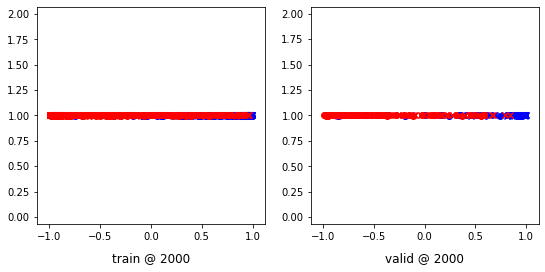

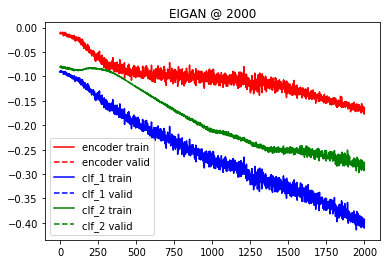

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.063178 	 1.063056 	 0.4036
200 	 0.538493 	 0.513725 	 0.9018
400 	 0.385986 	 0.355156 	 0.9055
600 	 0.384303 	 0.352955 	 0.9055
800 	 0.384148 	 0.352734 	 0.9055
1000 	 0.384039 	 0.352677 	 0.9055
Accuracy: 0.9054545454545454
Error Rate: 0.09454545454545454
F1 Score: 0.9212121212121213
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9090909090909091
Error Rate: 0.09090909090909091
F1 Score: 0.9235474006116207
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9163636363636364
Error Rate: 0.0

  0%|          | 0/2001 [00:00<?, ?it/s]

X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1612, 2) (403, 2) (1612, 1) (403, 1) (1612, 1) (403, 1)
class weights => w1, w2 [1.82146893 2.2173315 ] [1.47483989 3.10597303]
tensor sizes => torch.Size([1612, 2]) torch.Size([403, 2]) torch.Size([1612, 2]) torch.Size([403, 2]) torch.Size([1612, 2]) torch.Size([403, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.69878256 	 0.70371604 	 1.03812408 	 1.03928041 	 1.03251851 	 1.02871156


 25%|██▌       | 503/2001 [00:32<01:49, 13.68it/s]

500 	 0.41734684 	 0.42846197 	 0.65347993 	 0.66783082 	 0.92931587 	 0.93251604


 50%|█████     | 1003/2001 [01:04<01:06, 14.91it/s]

1000 	 0.33247840 	 0.40966809 	 0.60787165 	 0.64966220 	 0.96851385 	 0.93314129


 75%|███████▌  | 1502/2001 [01:36<00:35, 13.94it/s]

1500 	 0.35714823 	 0.41143912 	 0.56845433 	 0.65193772 	 0.90447164 	 0.93364578


100%|██████████| 2001/2001 [02:09<00:00, 15.43it/s]


2000 	 0.39312243 	 0.41223645 	 0.62925398 	 0.65214419 	 0.92928159 	 0.93305492


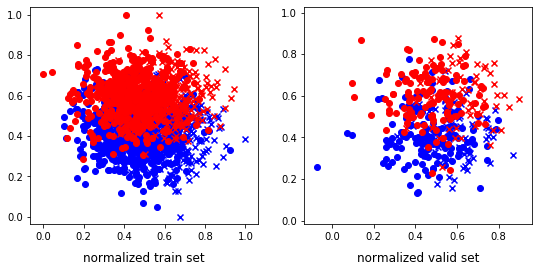

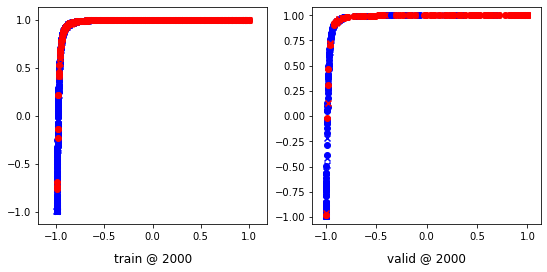

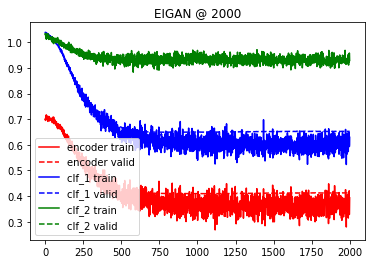

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:34, 21.08it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.08283438 	 0.08225381 	 0.01650313 	 0.01640943 	 -0.05747798 	 -0.05660159


 25%|██▌       | 503/2001 [00:30<01:33, 15.97it/s]

500 	 0.00734891 	 0.00820988 	 -0.05163215 	 -0.05074356 	 -0.04283554 	 -0.04280329


 50%|█████     | 1004/2001 [01:01<01:01, 16.11it/s]

1000 	 -0.03651612 	 -0.03758304 	 -0.11925636 	 -0.12028695 	 -0.08764485 	 -0.08758287


 75%|███████▌  | 1503/2001 [01:33<00:29, 17.14it/s]

1500 	 -0.08403523 	 -0.08448058 	 -0.19741400 	 -0.19776058 	 -0.13671741 	 -0.13657095


100%|██████████| 2001/2001 [02:04<00:00, 16.13it/s]


2000 	 -0.12938656 	 -0.13158205 	 -0.28303668 	 -0.28567544 	 -0.19198221 	 -0.19254729


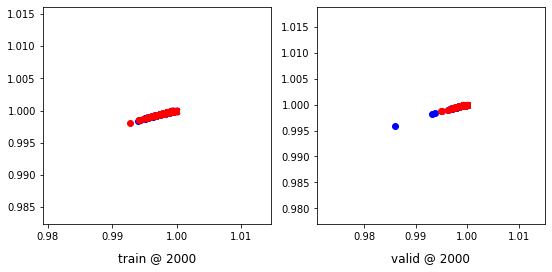

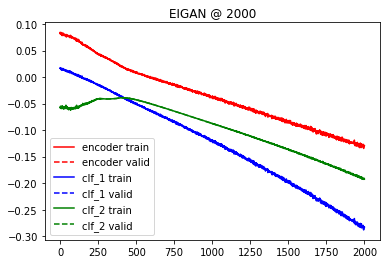

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.013499 	 1.013790 	 0.4516
200 	 0.686101 	 0.702854 	 0.7742
400 	 0.601666 	 0.651206 	 0.7742
600 	 0.601189 	 0.652673 	 0.7742
800 	 0.601024 	 0.652882 	 0.7742
1000 	 0.600641 	 0.653451 	 0.7767
Accuracy: 0.7766749379652605
Error Rate: 0.22332506203473945
F1 Score: 0.7527472527472527
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7866004962779156
Error Rate: 0.21339950372208435
F1 Score: 0.7663043478260869
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7692307692307693
Error Rate: 0.2

  0%|          | 2/2001 [00:00<01:48, 18.37it/s]

Accuracy: 0.7369727047146402
Error Rate: 0.2630272952853598
F1 Score: 0.5923076923076923
VAR1: 0.8, VAR2: 0.8, TRIAL: 7
X, y_1, y2
(1187, 2) (1187, 1) (1187, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(949, 2) (238, 2) (949, 1) (238, 1) (949, 1) (238, 1)
class weights => w1, w2 [2.71919771 1.58166667] [1.39970501 3.50184502]
tensor sizes => torch.Size([949, 2]) torch.Size([238, 2]) torch.Size([949, 2]) torch.Size([238, 2]) torch.Size([949, 2]) torch.Size([238, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.71990430 	 0.71864748 	 1.05782878 	 1.05687606 	 1.03138936 	 1.03137577


 25%|██▌       | 504/2001 [00:16<00:41, 36.24it/s]

500 	 0.60514784 	 0.61776137 	 0.83649069 	 0.85981071 	 0.92450780 	 0.93519652


 50%|█████     | 1006/2001 [00:34<00:32, 30.65it/s]

1000 	 0.49405205 	 0.54295439 	 0.71133131 	 0.78072691 	 0.91043252 	 0.93091971


 75%|███████▌  | 1506/2001 [00:52<00:18, 27.03it/s]

1500 	 0.45781595 	 0.53397661 	 0.67426336 	 0.77015692 	 0.90960526 	 0.92932749


100%|██████████| 2001/2001 [01:10<00:00, 28.55it/s]


2000 	 0.44916683 	 0.54188985 	 0.66414416 	 0.77790707 	 0.90813792 	 0.92916441


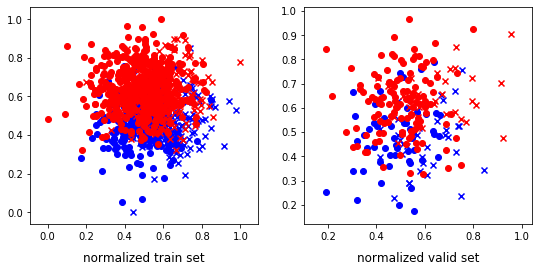

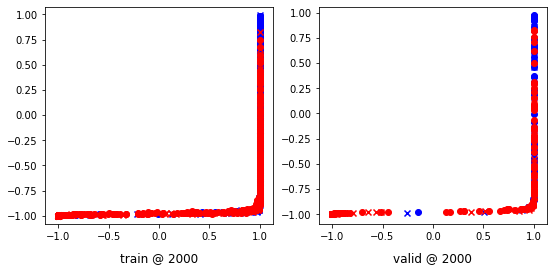

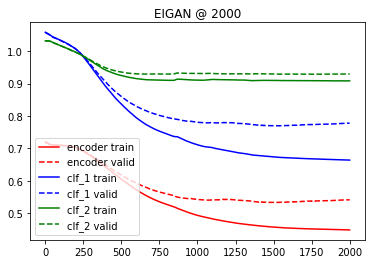

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 4/2001 [00:00<00:57, 34.67it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.13846597 	 0.13827768 	 0.07647845 	 0.07630413 	 -0.04889216 	 -0.04894488


 25%|██▌       | 505/2001 [00:17<00:56, 26.25it/s]

500 	 0.10926113 	 0.10885802 	 0.02425290 	 0.02377713 	 -0.09151610 	 -0.09168630


 50%|█████     | 1006/2001 [00:34<00:32, 30.53it/s]

1000 	 0.08738983 	 0.08691090 	 -0.02444995 	 -0.02502119 	 -0.13439871 	 -0.13456252


 75%|███████▌  | 1506/2001 [00:51<00:19, 25.39it/s]

1500 	 0.07185722 	 0.07154493 	 -0.06669921 	 -0.06712075 	 -0.17222531 	 -0.17237842


100%|██████████| 2001/2001 [01:08<00:00, 29.30it/s]


2000 	 0.06433674 	 0.06419126 	 -0.11115648 	 -0.11130240 	 -0.21891576 	 -0.21891962


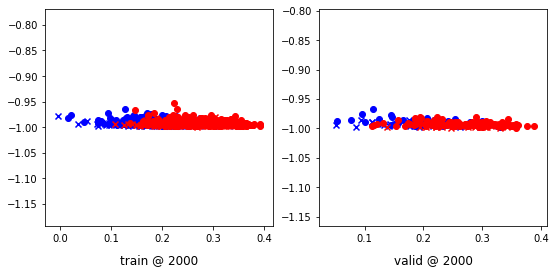

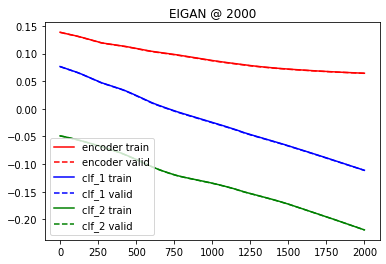

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.102410 	 1.100560 	 0.6303
200 	 0.885227 	 0.892887 	 0.6471
400 	 0.677878 	 0.750818 	 0.7311
600 	 0.663507 	 0.754903 	 0.7311
800 	 0.663170 	 0.755602 	 0.7269
1000 	 0.663102 	 0.755680 	 0.7269
Accuracy: 0.726890756302521
Error Rate: 0.27310924369747897
F1 Score: 0.7796610169491525
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7352941176470589
Error Rate: 0.2647058823529412
F1 Score: 0.7758007117437723
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7394957983193278
Error Rate: 0.260

  0%|          | 3/2001 [00:00<01:26, 23.03it/s]

VAR1: 0.2, VAR2: 0.2, TRIAL: 8
X, y_1, y2
(1916, 2) (1916, 1) (1916, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1532, 2) (384, 2) (1532, 1) (384, 1) (1532, 1) (384, 1)
class weights => w1, w2 [1.1570997  7.36538462] [1.73303167 2.36419753]
tensor sizes => torch.Size([1532, 2]) torch.Size([384, 2]) torch.Size([1532, 2]) torch.Size([384, 2]) torch.Size([1532, 2]) torch.Size([384, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.71865869 	 0.72838533 	 1.04643202 	 1.05239356 	 1.02157664 	 1.01715541


 25%|██▌       | 503/2001 [00:31<01:41, 14.79it/s]

500 	 0.04197326 	 0.05437374 	 0.29376727 	 0.30115843 	 0.94525641 	 0.93993187


 50%|█████     | 1003/2001 [01:01<01:01, 16.22it/s]

1000 	 -0.19236645 	 -0.19555968 	 0.04959509 	 0.04410619 	 0.93457055 	 0.93281305


 75%|███████▌  | 1503/2001 [01:33<00:33, 15.09it/s]

1500 	 -0.20976923 	 -0.22002128 	 0.01940843 	 0.01926603 	 0.92248476 	 0.93243450


100%|██████████| 2001/2001 [02:03<00:00, 16.17it/s]


2000 	 -0.22007301 	 -0.22499871 	 0.01323325 	 0.01412726 	 0.92781943 	 0.93227315


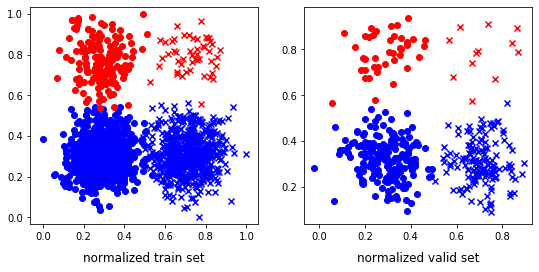

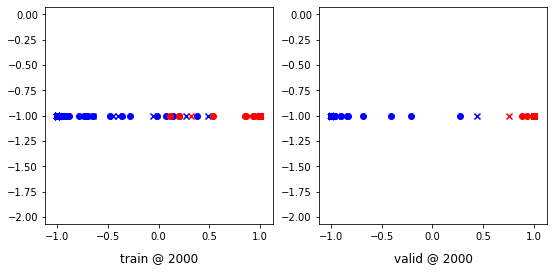

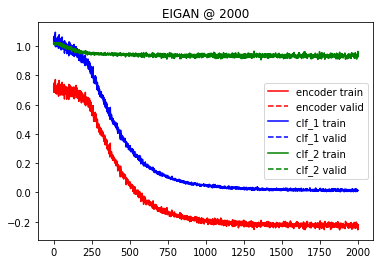

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:36, 20.76it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.05484354 	 0.05759549 	 0.03000183 	 0.03257056 	 0.04247623 	 0.04180732


 25%|██▌       | 503/2001 [00:29<01:32, 16.18it/s]

500 	 -0.00603090 	 -0.00668287 	 -0.04365186 	 -0.04470421 	 0.00607104 	 0.00500938


 50%|█████     | 1003/2001 [00:58<01:05, 15.34it/s]

1000 	 -0.07923391 	 -0.07742029 	 -0.12132999 	 -0.12002804 	 -0.00511196 	 -0.00641645


 75%|███████▌  | 1505/2001 [01:27<00:27, 17.95it/s]

1500 	 -0.17765293 	 -0.17934486 	 -0.24342562 	 -0.24348257 	 -0.05646011 	 -0.05325425


100%|██████████| 2001/2001 [01:56<00:00, 17.14it/s]


2000 	 -0.27708390 	 -0.27843991 	 -0.36895779 	 -0.36974844 	 -0.10310676 	 -0.10217303


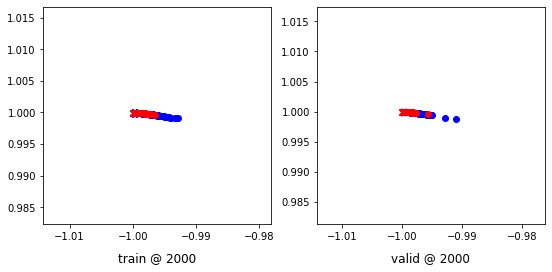

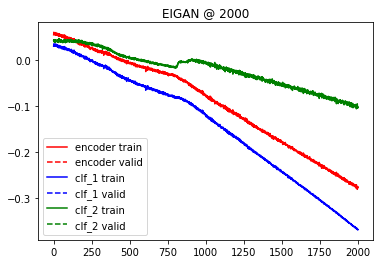

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.010897 	 1.010006 	 0.8646
200 	 0.371277 	 0.369374 	 0.9740
400 	 0.062691 	 0.063504 	 0.9974
600 	 0.029973 	 0.030613 	 0.9974
800 	 0.020993 	 0.020871 	 0.9974
1000 	 0.017046 	 0.016295 	 0.9974
Accuracy: 0.9973958333333334
Error Rate: 0.0026041666666666665
F1 Score: 0.9904761904761905
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9973958333333334
Error Rate: 0.0026041666666666665
F1 Score: 0.9904761904761905
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9895833333333334
Error Rate:

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.578125
Error Rate: 0.421875
F1 Score: 0.0
VAR1: 0.2, VAR2: 0.4, TRIAL: 8
X, y_1, y2
(2740, 2) (2740, 1) (2740, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2192, 2) (548, 2) (2192, 1) (548, 1) (2192, 1) (548, 1)
class weights => w1, w2 [1.79819524 2.25282631] [1.62130178 2.60952381]
tensor sizes => torch.Size([2192, 2]) torch.Size([548, 2]) torch.Size([2192, 2]) torch.Size([548, 2]) torch.Size([2192, 2]) torch.Size([548, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.70814455 	 0.69024241 	 1.07455575 	 1.07523847 	 1.05977511 	 1.07814324


 25%|██▌       | 502/2001 [00:46<02:15, 11.10it/s]

500 	 0.17241681 	 0.13823763 	 0.44296595 	 0.37635919 	 0.96451157 	 0.93126875


 50%|█████     | 1002/2001 [01:33<01:32, 10.77it/s]

1000 	 0.03544095 	 0.10860124 	 0.25186190 	 0.34460327 	 0.90991306 	 0.92914921


 75%|███████▌  | 1502/2001 [02:20<00:47, 10.55it/s]

1500 	 0.11582920 	 0.10441589 	 0.36948791 	 0.34152579 	 0.94843739 	 0.93025708


100%|██████████| 2001/2001 [03:05<00:00, 10.78it/s]


2000 	 -0.00810233 	 0.11637160 	 0.27046877 	 0.34825155 	 0.97234780 	 0.92502713


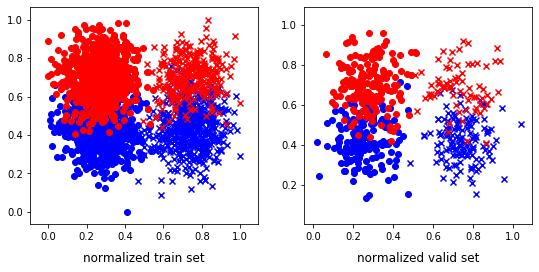

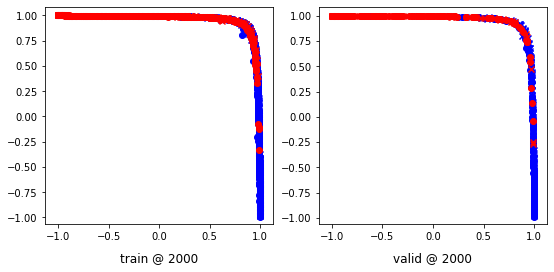

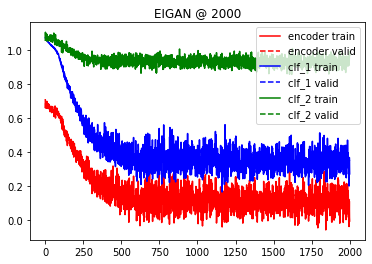

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<03:11, 10.43it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.11205514 	 0.10994343 	 0.03997298 	 0.03919661 	 -0.06839781 	 -0.06598276


 25%|██▌       | 502/2001 [00:45<02:19, 10.73it/s]

500 	 0.02116439 	 0.01818177 	 -0.07410862 	 -0.07789251 	 -0.10865077 	 -0.10995851


 50%|█████     | 1002/2001 [01:30<01:23, 11.97it/s]

1000 	 -0.05352664 	 -0.04236907 	 -0.20686942 	 -0.19531032 	 -0.19158970 	 -0.19107704


 75%|███████▌  | 1502/2001 [02:15<00:45, 11.03it/s]

1500 	 -0.08457601 	 -0.08959715 	 -0.32752290 	 -0.33355597 	 -0.29289642 	 -0.29392186


100%|██████████| 2001/2001 [03:00<00:00, 11.09it/s]


2000 	 -0.10246557 	 -0.10457295 	 -0.49140459 	 -0.50236356 	 -0.42364970 	 -0.43070644


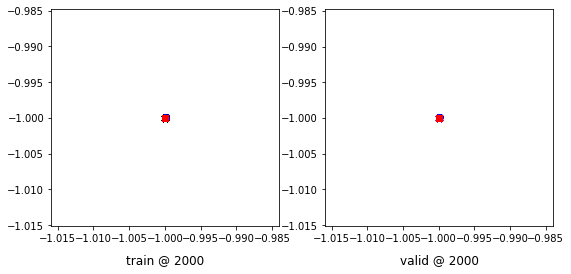

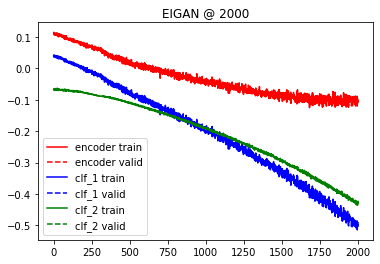

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.110051 	 1.110160 	 0.3923
200 	 0.799564 	 0.802431 	 0.7117
400 	 0.409902 	 0.409961 	 0.8942
600 	 0.345703 	 0.349611 	 0.8978
800 	 0.343384 	 0.348482 	 0.8978
1000 	 0.343231 	 0.348480 	 0.8978
Accuracy: 0.8978102189781022
Error Rate: 0.10218978102189781
F1 Score: 0.8818565400843883
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8959854014598541
Error Rate: 0.10401459854014598
F1 Score: 0.8810020876826722
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8996350364963503
Error Rate: 0.1

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.945556 	 0.945556 	 0.6168
Accuracy: 0.6167883211678832
Error Rate: 0.38321167883211676
F1 Score: 0.0
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.38321167883211676
Error Rate: 0.6167883211678832
F1 Score: 0.554089709762533
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9835766423357665
Error Rate: 0.016423357664233577
F1 Score: 0.9789227166276346
VAR1: 0.2, VAR2: 0.6, TRIAL: 8
X, y_1, y2
(3290, 2) (3290, 1) (3290, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2632, 2) (658, 2) (2632, 1) (658, 1) (2632, 1) (658, 1)
class weights => w1, w2 [2.30674847 1.76525822] [2.16625514 1.85744531]
tensor sizes => torch.Size([2632, 2]) torch.Size([658, 2]) torch.Size([2632, 2]) torch.Size([658, 2]) torch.Size([2632, 2]) torch.Size([658, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------

  0%|          | 3/2001 [00:00<02:40, 12.41it/s]

0 	 0.70011532 	 0.69989991 	 1.05227864 	 1.05200768 	 1.04554951 	 1.04525495


 25%|██▌       | 501/2001 [00:48<02:32,  9.85it/s]

500 	 0.35330075 	 0.39049733 	 0.61190474 	 0.65058166 	 0.95190448 	 0.95323151


 50%|█████     | 1002/2001 [01:38<01:55,  8.65it/s]

1000 	 0.35001320 	 0.35710436 	 0.60416049 	 0.61672550 	 0.94763380 	 0.95276833


 75%|███████▌  | 1502/2001 [02:28<00:44, 11.13it/s]

1500 	 0.36861300 	 0.35412985 	 0.61844605 	 0.61343271 	 0.94312096 	 0.95245004


100%|██████████| 2001/2001 [03:18<00:00, 10.09it/s]

2000 	 0.33993435 	 0.35186064 	 0.59101647 	 0.61109918 	 0.94425899 	 0.95238572


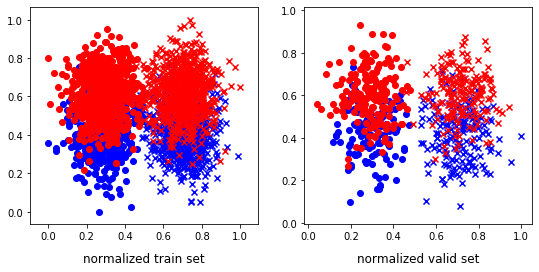

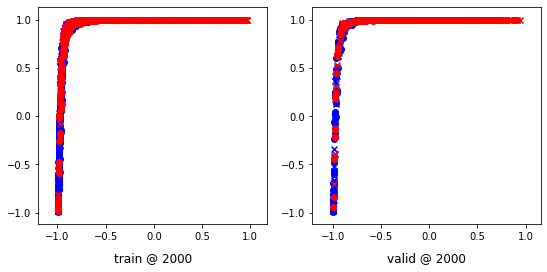

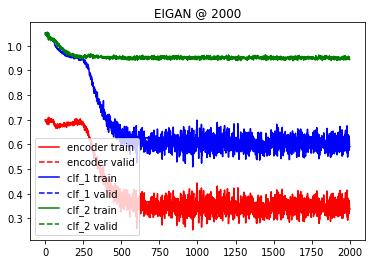

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<03:09, 10.53it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.00500776 	 0.00456326 	 -0.02876508 	 -0.02879894 	 0.01640330 	 0.01734678


 25%|██▌       | 502/2001 [00:47<02:39,  9.39it/s]

500 	 -0.02922339 	 -0.02900661 	 -0.10050610 	 -0.10027221 	 -0.06696356 	 -0.06695618


 50%|█████     | 1002/2001 [01:34<01:32, 10.82it/s]

1000 	 -0.03520633 	 -0.03661077 	 -0.17123608 	 -0.17035130 	 -0.16881765 	 -0.16570552


 75%|███████▌  | 1502/2001 [02:22<00:43, 11.36it/s]

1500 	 -0.02679795 	 -0.02192934 	 -0.21510571 	 -0.21238616 	 -0.23394182 	 -0.23641358


100%|██████████| 2001/2001 [03:08<00:00, 10.59it/s]


2000 	 -0.10976565 	 -0.11502075 	 -0.34576669 	 -0.35170853 	 -0.28579870 	 -0.28650570


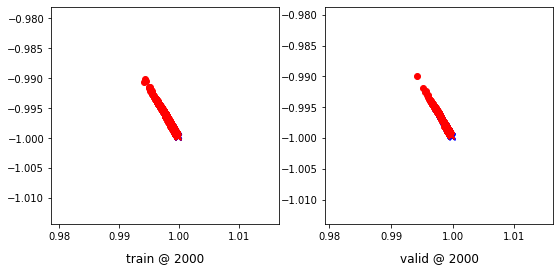

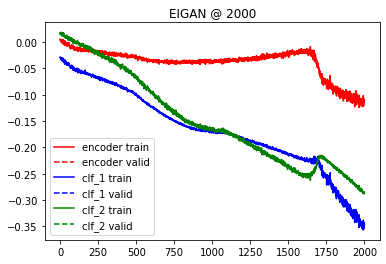

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.094255 	 1.094650 	 0.5653
200 	 0.801420 	 0.804504 	 0.7371
400 	 0.601198 	 0.606452 	 0.8024
600 	 0.600412 	 0.606298 	 0.8009
800 	 0.600287 	 0.606340 	 0.8009
1000 	 0.600222 	 0.606262 	 0.8009
Accuracy: 0.8009118541033434
Error Rate: 0.19908814589665655
F1 Score: 0.8241610738255033
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7948328267477204
Error Rate: 0.20516717325227962
F1 Score: 0.8143053645116919
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8009118541033434
Error Rate: 0.1

  0%|          | 2/2001 [00:00<01:42, 19.58it/s]

Accuracy: 0.5379939209726444
Error Rate: 0.46200607902735563
F1 Score: 0.6996047430830039
VAR1: 0.2, VAR2: 0.8, TRIAL: 8
X, y_1, y2
(2383, 2) (2383, 1) (2383, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1906, 2) (477, 2) (1906, 1) (477, 1) (1906, 1) (477, 1)
class weights => w1, w2 [3.17666667 1.45941807] [2. 2.]
tensor sizes => torch.Size([1906, 2]) torch.Size([477, 2]) torch.Size([1906, 2]) torch.Size([477, 2]) torch.Size([1906, 2]) torch.Size([477, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.73922753 	 0.73969460 	 1.04851377 	 1.04809690 	 1.00260377 	 1.00154948


 25%|██▌       | 502/2001 [00:36<01:48, 13.77it/s]

500 	 0.48164904 	 0.50995255 	 0.73485649 	 0.75924957 	 0.94637656 	 0.94244421


 50%|█████     | 1003/2001 [01:10<01:04, 15.53it/s]

1000 	 0.49133980 	 0.47921818 	 0.73733723 	 0.72695118 	 0.93943542 	 0.94088018


 75%|███████▌  | 1503/2001 [01:43<00:37, 13.46it/s]

1500 	 0.46004939 	 0.47367126 	 0.70556933 	 0.72141302 	 0.93871647 	 0.94088894


100%|██████████| 2001/2001 [02:18<00:00, 14.48it/s]


2000 	 0.47291726 	 0.47184306 	 0.72913677 	 0.71947539 	 0.94994694 	 0.94077951


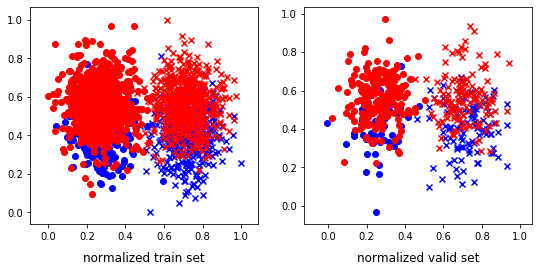

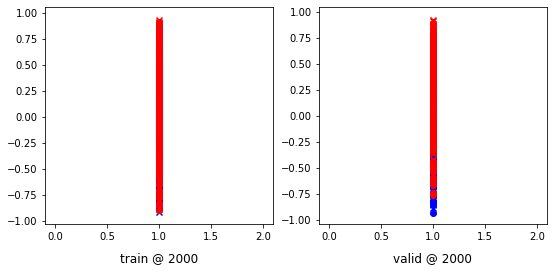

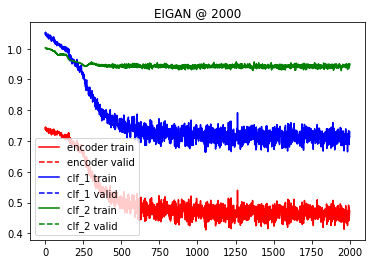

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:23, 13.93it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.00424505 	 -0.00434187 	 -0.03422058 	 -0.03456604 	 0.02696576 	 0.02614900


 25%|██▌       | 503/2001 [00:34<01:54, 13.14it/s]

500 	 -0.05683882 	 -0.05512860 	 -0.10053680 	 -0.09981793 	 -0.00901911 	 -0.01139851


 50%|█████     | 1002/2001 [01:07<01:01, 16.35it/s]

1000 	 -0.06630556 	 -0.06768807 	 -0.13499948 	 -0.13444416 	 -0.06209479 	 -0.05837200


 75%|███████▌  | 1504/2001 [01:40<00:33, 14.98it/s]

1500 	 -0.08075055 	 -0.07800281 	 -0.17431018 	 -0.17267510 	 -0.10587934 	 -0.10768861


100%|██████████| 2001/2001 [02:13<00:00, 14.96it/s]


2000 	 -0.08831830 	 -0.08899349 	 -0.21809764 	 -0.21891303 	 -0.16024895 	 -0.16044354


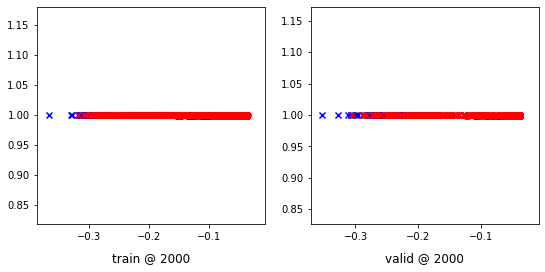

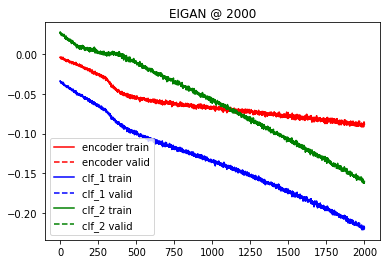

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.028668 	 1.028527 	 0.6855
200 	 0.787250 	 0.783365 	 0.7736
400 	 0.686796 	 0.685005 	 0.7694
600 	 0.685552 	 0.684145 	 0.7694
800 	 0.684969 	 0.683885 	 0.7715
1000 	 0.684481 	 0.683738 	 0.7694
Accuracy: 0.7693920335429769
Error Rate: 0.23060796645702306
F1 Score: 0.8323170731707317
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7610062893081762
Error Rate: 0.2389937106918239
F1 Score: 0.8137254901960783
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7756813417190775
Error Rate: 0.22

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.124853 	 0.105634 	 0.9727
Accuracy: 0.9727463312368972
Error Rate: 0.027253668763102725
F1 Score: 0.9721627408993576
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9643605870020965
Error Rate: 0.03563941299790356
F1 Score: 0.9631236442516269
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9727463312368972
Error Rate: 0.027253668763102725
F1 Score: 0.9721627408993576
VAR1: 0.4, VAR2: 0.2, TRIAL: 8
X, y_1, y2
(734, 2) (734, 1) (734, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(587, 2) (147, 2) (587, 1) (147, 1) (587, 1) (147, 1)
class weights => w1, w2 [1.95016611 2.05244755] [2.31102362 1.76276276]
tensor sizes => torch.Size([587, 2]) torch.Size([147, 2]) torch.Size([587, 2]) torch.Size([147, 2]) torch.Size([587, 2]) torch.Size([147, 2])
--------------------------------------------------------------------------------
EIGAN Training
------------

 25%|██▌       | 505/2001 [00:14<00:47, 31.51it/s]

500 	 0.56941634 	 0.56258523 	 0.58915746 	 0.58228880 	 0.71290308 	 0.71285075


 50%|█████     | 1003/2001 [00:29<00:29, 33.53it/s]

1000 	 0.32793692 	 0.31370252 	 0.36239728 	 0.36237407 	 0.72761846 	 0.74181873


 75%|███████▌  | 1505/2001 [00:43<00:15, 32.41it/s]

1500 	 0.30731785 	 0.29017967 	 0.18832642 	 0.19129455 	 0.57421285 	 0.59426206


100%|██████████| 2001/2001 [00:58<00:00, 34.26it/s]


2000 	 0.30584639 	 0.28923878 	 0.11265624 	 0.10825201 	 0.49997196 	 0.51216042


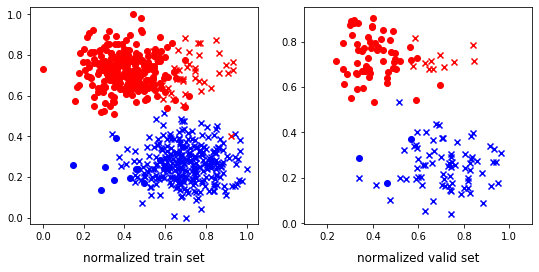

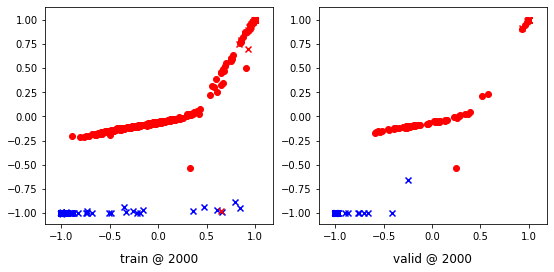

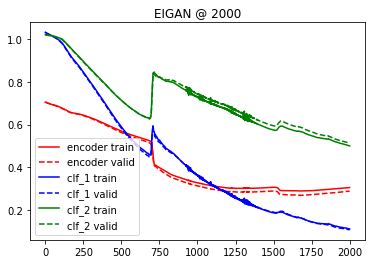

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 5/2001 [00:00<00:43, 45.85it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.06575173 	 0.06543973 	 0.00758736 	 0.00712685 	 -0.04110133 	 -0.04148060


 25%|██▌       | 507/2001 [00:13<00:41, 36.12it/s]

500 	 0.03960248 	 0.03926193 	 -0.03391036 	 -0.03447937 	 -0.07110928 	 -0.07155349


 50%|█████     | 1008/2001 [00:27<00:22, 44.26it/s]

1000 	 0.01909031 	 0.01834289 	 -0.07813938 	 -0.07895952 	 -0.11177612 	 -0.11193335


 75%|███████▌  | 1503/2001 [00:41<00:13, 37.74it/s]

1500 	 -0.00000024 	 -0.00057971 	 -0.12606785 	 -0.12648956 	 -0.15504125 	 -0.15483779


100%|██████████| 2001/2001 [00:55<00:00, 36.13it/s]


2000 	 -0.01074940 	 -0.01093419 	 -0.17196324 	 -0.17213181 	 -0.20150518 	 -0.20149423


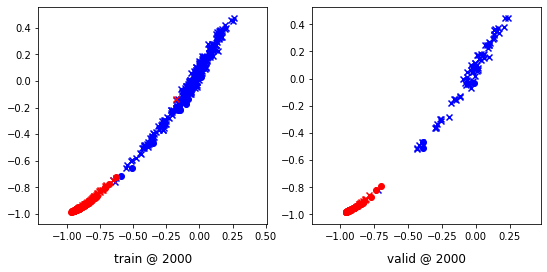

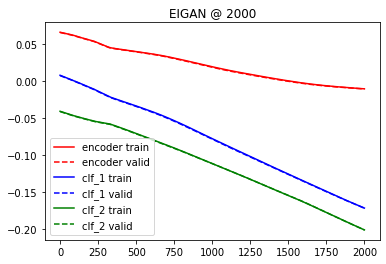

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.096690 	 1.096332 	 0.9932
200 	 0.258126 	 0.240572 	 0.9932
400 	 0.056435 	 0.045849 	 0.9932
600 	 0.036432 	 0.029816 	 0.9932
800 	 0.029920 	 0.025428 	 0.9932
1000 	 0.026982 	 0.023633 	 0.9932
Accuracy: 0.9931972789115646
Error Rate: 0.006802721088435374
F1 Score: 0.993006993006993
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9931972789115646
Error Rate: 0.006802721088435374
F1 Score: 0.993006993006993
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9931972789115646
Error Rate: 0.0

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.340851 	 0.351524 	 0.8912
Accuracy: 0.891156462585034
Error Rate: 0.10884353741496598
F1 Score: 0.9
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8979591836734694
Error Rate: 0.10204081632653061
F1 Score: 0.9056603773584904
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8979591836734694
Error Rate: 0.10204081632653061
F1 Score: 0.9056603773584904
VAR1: 0.4, VAR2: 0.4, TRIAL: 8
X, y_1, y2
(1821, 2) (1821, 1) (1821, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1456, 2) (365, 2) (1456, 1) (365, 1) (1456, 1) (365, 1)
class weights => w1, w2 [1.71294118 2.40264026] [1.43448276 3.3015873 ]
tensor sizes => torch.Size([1456, 2]) torch.Size([365, 2]) torch.Size([1456, 2]) torch.Size([365, 2]) torch.Size([1456, 2]) torch.Size([365, 2])
--------------------------------------------------------------------------------
EIGAN Training
---------------------

  0%|          | 3/2001 [00:00<03:32,  9.42it/s]

0 	 0.65585232 	 0.65202773 	 1.01284194 	 1.00954390 	 1.05038536 	 1.05066335


 25%|██▌       | 504/2001 [00:30<01:31, 16.42it/s]

500 	 0.26530731 	 0.21628591 	 0.45129564 	 0.42311010 	 0.87929112 	 0.89997137


 50%|█████     | 1003/2001 [01:01<01:01, 16.28it/s]

1000 	 0.13755244 	 0.10186616 	 0.34693795 	 0.30731788 	 0.90224552 	 0.89859891


 75%|███████▌  | 1504/2001 [01:30<00:30, 16.47it/s]

1500 	 0.12274340 	 0.08379975 	 0.34943527 	 0.28494260 	 0.92005980 	 0.89429003


100%|██████████| 2001/2001 [02:00<00:00, 16.62it/s]


2000 	 0.11890039 	 0.08015791 	 0.31790403 	 0.27983370 	 0.89253700 	 0.89282298


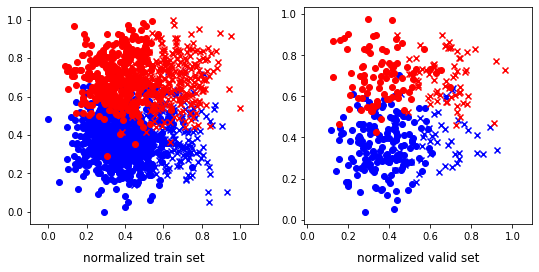

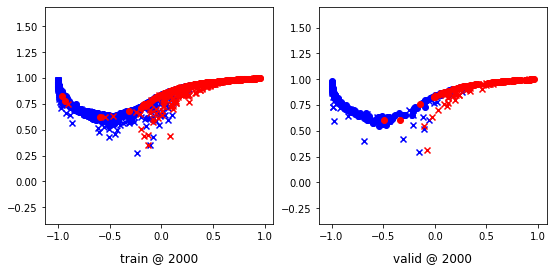

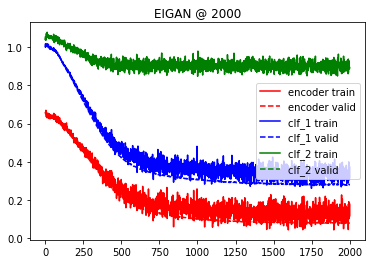

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:11, 15.22it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.00811207 	 0.00805600 	 -0.03309626 	 -0.03312812 	 -0.00290390 	 -0.00293869


 25%|██▌       | 502/2001 [00:30<01:36, 15.57it/s]

500 	 -0.06221670 	 -0.06164930 	 -0.12375697 	 -0.12371433 	 -0.04799221 	 -0.04912854


 50%|█████     | 1003/2001 [00:59<00:59, 16.65it/s]

1000 	 -0.18834843 	 -0.18962340 	 -0.29537046 	 -0.29687023 	 -0.12713979 	 -0.12748562


 75%|███████▌  | 1503/2001 [01:28<00:27, 18.02it/s]

1500 	 -0.30087012 	 -0.29586726 	 -0.46884248 	 -0.46425724 	 -0.20984407 	 -0.21035346


100%|██████████| 2001/2001 [01:56<00:00, 17.25it/s]


2000 	 -0.38955998 	 -0.39161819 	 -0.64912122 	 -0.65050119 	 -0.30947155 	 -0.30880544


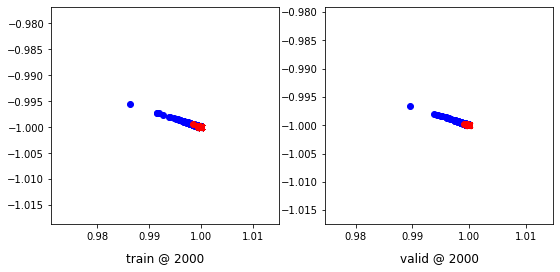

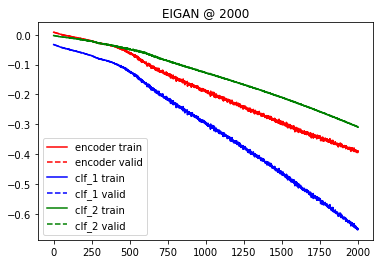

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.036341 	 1.037490 	 0.5836
200 	 0.532677 	 0.503066 	 0.9178
400 	 0.340436 	 0.281069 	 0.9178
600 	 0.335957 	 0.270410 	 0.9178
800 	 0.335722 	 0.269501 	 0.9178
1000 	 0.335669 	 0.269381 	 0.9178
Accuracy: 0.9178082191780822
Error Rate: 0.0821917808219178
F1 Score: 0.9013157894736842
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9123287671232877
Error Rate: 0.08767123287671233
F1 Score: 0.8954248366013072
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9178082191780822
Error Rate: 0.08

  0%|          | 2/2001 [00:00<01:46, 18.78it/s]

Accuracy: 0.6958904109589041
Error Rate: 0.3041095890410959
F1 Score: 0.0
VAR1: 0.4, VAR2: 0.6, TRIAL: 8
X, y_1, y2
(1150, 2) (1150, 1) (1150, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(920, 2) (230, 2) (920, 1) (230, 1) (920, 1) (230, 1)
class weights => w1, w2 [3.22807018 1.4488189 ] [2.99674267 1.50081566]
tensor sizes => torch.Size([920, 2]) torch.Size([230, 2]) torch.Size([920, 2]) torch.Size([230, 2]) torch.Size([920, 2]) torch.Size([230, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.71254051 	 0.71083939 	 1.08893239 	 1.08802044 	 1.06992519 	 1.07032824


 25%|██▌       | 505/2001 [00:18<00:50, 29.81it/s]

500 	 0.65841836 	 0.64926648 	 0.90668851 	 0.89686090 	 0.94149441 	 0.94074160


 50%|█████     | 1003/2001 [00:35<00:33, 29.61it/s]

1000 	 0.57961750 	 0.56617147 	 0.67223668 	 0.63692516 	 0.78576702 	 0.76390088


 75%|███████▌  | 1503/2001 [00:52<00:17, 27.80it/s]

1500 	 0.58115888 	 0.55785537 	 0.61553228 	 0.56672138 	 0.72752428 	 0.70201319


100%|██████████| 2001/2001 [01:09<00:00, 28.74it/s]


2000 	 0.58808827 	 0.55794692 	 0.63304037 	 0.58890885 	 0.73810130 	 0.72410911


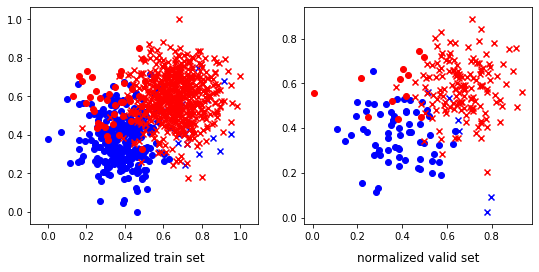

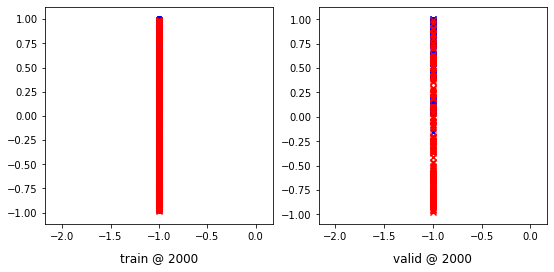

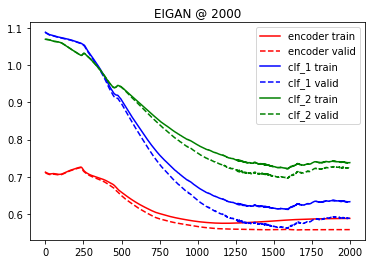

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 4/2001 [00:00<00:57, 34.68it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.04324561 	 0.04322165 	 -0.00184179 	 -0.00179487 	 -0.01218911 	 -0.01217096


 25%|██▌       | 505/2001 [00:16<00:46, 32.24it/s]

500 	 0.00223301 	 0.00209930 	 -0.04740684 	 -0.04748771 	 -0.02273462 	 -0.02268140


 50%|█████     | 1008/2001 [00:32<00:27, 35.58it/s]

1000 	 -0.01910620 	 -0.01933182 	 -0.07572119 	 -0.07591164 	 -0.03790451 	 -0.03786513


 75%|███████▌  | 1504/2001 [00:48<00:17, 28.31it/s]

1500 	 -0.03557418 	 -0.03585368 	 -0.10155486 	 -0.10177794 	 -0.05686216 	 -0.05675719


100%|██████████| 2001/2001 [01:05<00:00, 30.60it/s]


2000 	 -0.05110449 	 -0.05147005 	 -0.12711872 	 -0.12739734 	 -0.07570339 	 -0.07554907


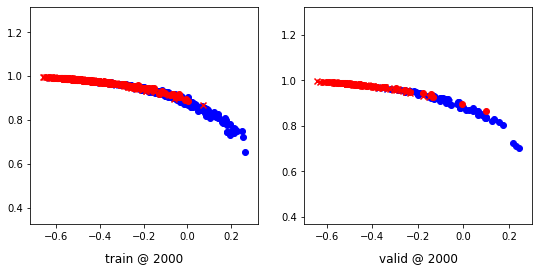

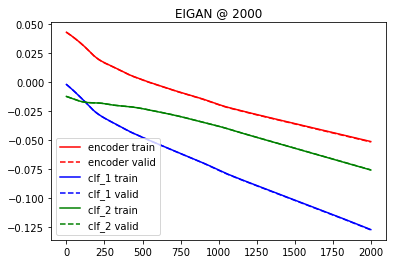

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.036345 	 1.035452 	 0.5217
200 	 0.591237 	 0.568598 	 0.8913
400 	 0.409917 	 0.342958 	 0.9087
600 	 0.401749 	 0.335067 	 0.9130
800 	 0.399835 	 0.334587 	 0.9130
1000 	 0.398191 	 0.330811 	 0.9130
Accuracy: 0.9130434782608695
Error Rate: 0.08695652173913043
F1 Score: 0.9367088607594937
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8913043478260869
Error Rate: 0.10869565217391304
F1 Score: 0.9180327868852458
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8956521739130435
Error Rate: 0.1

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.298516 	 0.286407 	 0.9217
Accuracy: 0.9217391304347826
Error Rate: 0.0782608695652174
F1 Score: 0.9407894736842104
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9130434782608695
Error Rate: 0.08695652173913043
F1 Score: 0.9333333333333332
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9260869565217391
Error Rate: 0.07391304347826087
F1 Score: 0.9446254071661236
VAR1: 0.4, VAR2: 0.8, TRIAL: 8
X, y_1, y2
(1567, 2) (1567, 1) (1567, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1253, 2) (314, 2) (1253, 1) (314, 1) (1253, 1) (314, 1)
class weights => w1, w2 [1.8562963  2.16782007] [2.00801282 1.99205087]
tensor sizes => torch.Size([1253, 2]) torch.Size([314, 2]) torch.Size([1253, 2]) torch.Size([314, 2]) torch.Size([1253, 2]) torch.Size([314, 2])
--------------------------------------------------------------------------------
EIGAN Training
------

 25%|██▌       | 503/2001 [00:29<01:28, 17.00it/s]

500 	 0.49900961 	 0.49944252 	 0.75986475 	 0.75233364 	 0.95408964 	 0.94603831


 50%|█████     | 1004/2001 [00:59<00:59, 16.63it/s]

1000 	 0.41543329 	 0.49011356 	 0.66559708 	 0.72623634 	 0.94338447 	 0.92926997


 75%|███████▌  | 1503/2001 [01:28<00:32, 15.41it/s]

1500 	 0.39523268 	 0.48937732 	 0.65087867 	 0.72324705 	 0.94894022 	 0.92701691


100%|██████████| 2001/2001 [01:57<00:00, 17.05it/s]


2000 	 0.42445761 	 0.49466622 	 0.66118705 	 0.72647059 	 0.92998046 	 0.92495155


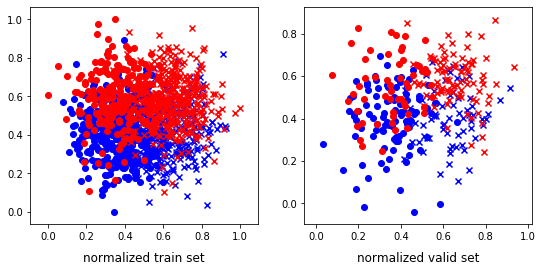

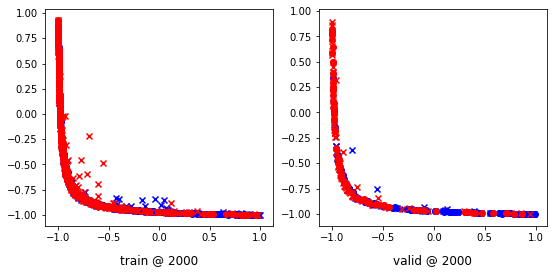

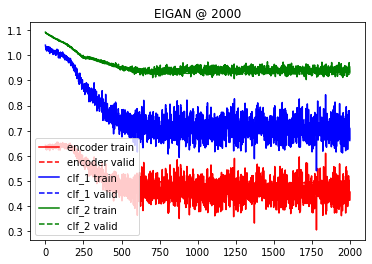

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:33, 21.26it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.13086155 	 0.12910961 	 0.04964091 	 0.04493093 	 -0.08496657 	 -0.09013563


 25%|██▌       | 503/2001 [00:29<01:19, 18.95it/s]

500 	 0.09367462 	 0.09582543 	 -0.00440534 	 0.00164135 	 -0.11317353 	 -0.10689425


 50%|█████     | 1004/2001 [00:58<00:59, 16.62it/s]

1000 	 0.06296045 	 0.06869338 	 -0.07603133 	 -0.07505254 	 -0.17281319 	 -0.17913842


 75%|███████▌  | 1502/2001 [01:27<00:27, 18.02it/s]

1500 	 0.05418202 	 0.05015247 	 -0.14750329 	 -0.15181375 	 -0.24909371 	 -0.24940652


100%|██████████| 2001/2001 [01:55<00:00, 17.26it/s]


2000 	 0.04414004 	 0.03825507 	 -0.24120565 	 -0.23713776 	 -0.33417749 	 -0.32477883


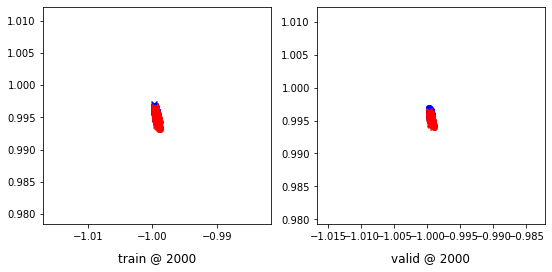

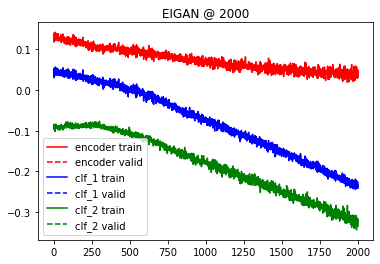

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.019587 	 1.020396 	 0.5541
200 	 0.741748 	 0.744861 	 0.7516
400 	 0.700773 	 0.713742 	 0.7675
600 	 0.699690 	 0.713160 	 0.7675
800 	 0.699132 	 0.712895 	 0.7675
1000 	 0.698642 	 0.712639 	 0.7675
Accuracy: 0.767515923566879
Error Rate: 0.23248407643312102
F1 Score: 0.7456445993031359
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7643312101910829
Error Rate: 0.2356687898089172
F1 Score: 0.7448275862068966
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7707006369426752
Error Rate: 0.229

  0%|          | 3/2001 [00:00<01:29, 22.20it/s]

Accuracy: 0.5031847133757962
Error Rate: 0.4968152866242038
F1 Score: 0.6694915254237288
VAR1: 0.6, VAR2: 0.2, TRIAL: 8
X, y_1, y2
(2232, 2) (2232, 1) (2232, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1785, 2) (447, 2) (1785, 1) (447, 1) (1785, 1) (447, 1)
class weights => w1, w2 [1.54545455 2.83333333] [3.52766798 1.39562158]
tensor sizes => torch.Size([1785, 2]) torch.Size([447, 2]) torch.Size([1785, 2]) torch.Size([447, 2]) torch.Size([1785, 2]) torch.Size([447, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.72181237 	 0.72005069 	 1.06340802 	 1.05813444 	 1.03515315 	 1.03123093


 25%|██▌       | 502/2001 [00:33<01:34, 15.78it/s]

500 	 0.10196903 	 0.08118460 	 0.29913190 	 0.29462120 	 0.89026564 	 0.90658379


 50%|█████     | 1003/2001 [01:06<01:13, 13.53it/s]

1000 	 -0.16116725 	 -0.14752573 	 0.06730814 	 0.06403279 	 0.92161816 	 0.90470570


 75%|███████▌  | 1504/2001 [01:39<00:34, 14.54it/s]

1500 	 -0.17136987 	 -0.17568913 	 0.04026632 	 0.03579870 	 0.90481257 	 0.90463501


100%|██████████| 2001/2001 [02:11<00:00, 15.21it/s]


2000 	 -0.16874120 	 -0.18398204 	 0.04022346 	 0.02781972 	 0.90191239 	 0.90494895


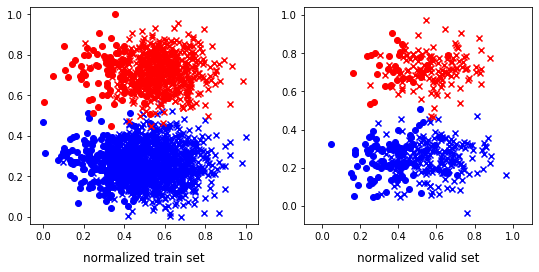

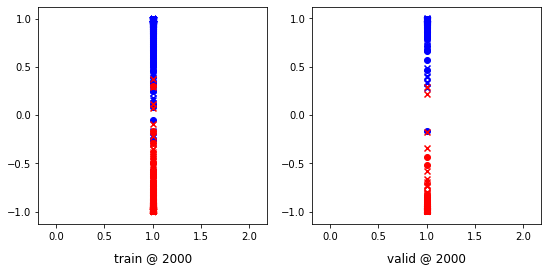

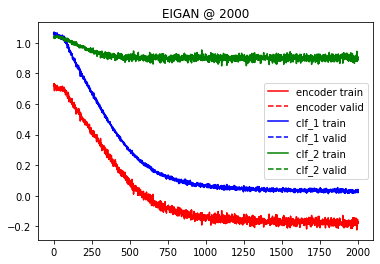

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<01:58, 16.91it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.01686497 	 -0.01679799 	 -0.04469491 	 -0.04458977 	 0.03322152 	 0.03329133


 25%|██▌       | 503/2001 [00:32<01:27, 17.05it/s]

500 	 -0.07591105 	 -0.07575942 	 -0.12291199 	 -0.12291739 	 -0.01678610 	 -0.01715886


 50%|█████     | 1003/2001 [01:03<01:12, 13.86it/s]

1000 	 -0.13138165 	 -0.13179460 	 -0.20002486 	 -0.20042938 	 -0.06199790 	 -0.06198237


 75%|███████▌  | 1503/2001 [01:35<00:30, 16.09it/s]

1500 	 -0.19419302 	 -0.19353002 	 -0.28931487 	 -0.28878868 	 -0.10841818 	 -0.10863999


100%|██████████| 2001/2001 [02:08<00:00, 15.56it/s]


2000 	 -0.26484016 	 -0.26387471 	 -0.39257744 	 -0.39193729 	 -0.15740345 	 -0.15785828


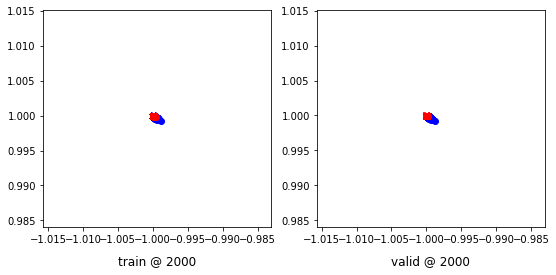

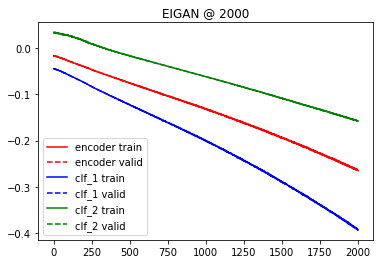

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.023223 	 1.023011 	 0.3535
200 	 0.256288 	 0.239265 	 0.9933
400 	 0.057508 	 0.047962 	 0.9933
600 	 0.035948 	 0.029898 	 0.9933
800 	 0.029554 	 0.024860 	 0.9933
1000 	 0.026886 	 0.022835 	 0.9933
Accuracy: 0.9932885906040269
Error Rate: 0.006711409395973154
F1 Score: 0.9904761904761905
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9932885906040269
Error Rate: 0.006711409395973154
F1 Score: 0.9904761904761905
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9932885906040269
Error Rate: 0

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.7158836689038032
Error Rate: 0.2841163310961969
F1 Score: 0.8344198174706648
VAR1: 0.6, VAR2: 0.4, TRIAL: 8
X, y_1, y2
(2052, 2) (2052, 1) (2052, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1641, 2) (411, 2) (1641, 1) (411, 1) (1641, 1) (411, 1)
class weights => w1, w2 [2.05897114 1.9443128 ] [2.66829268 1.5994152 ]
tensor sizes => torch.Size([1641, 2]) torch.Size([411, 2]) torch.Size([1641, 2]) torch.Size([411, 2]) torch.Size([1641, 2]) torch.Size([411, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.65817332 	 0.64963651 	 1.04467595 	 1.04335976 	 1.08020115 	 1.08687043


 25%|██▌       | 502/2001 [00:32<01:39, 15.01it/s]

500 	 0.19816113 	 0.24687698 	 0.44959503 	 0.49184266 	 0.94468254 	 0.93811285


 50%|█████     | 1002/2001 [01:04<01:07, 14.78it/s]

1000 	 0.13782933 	 0.18437096 	 0.38669485 	 0.42531160 	 0.94251001 	 0.93408781


 75%|███████▌  | 1503/2001 [01:36<00:27, 18.20it/s]

1500 	 0.12925634 	 0.18374968 	 0.35027230 	 0.42487967 	 0.91407484 	 0.93427718


100%|██████████| 2001/2001 [02:08<00:00, 15.59it/s]


2000 	 0.09216395 	 0.18253261 	 0.33650631 	 0.42549193 	 0.93754560 	 0.93610650


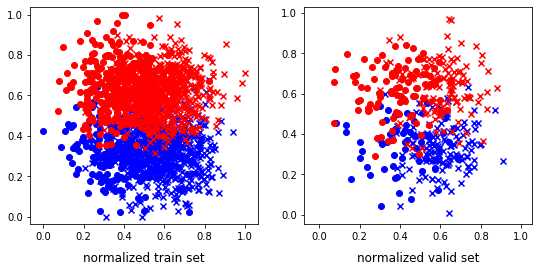

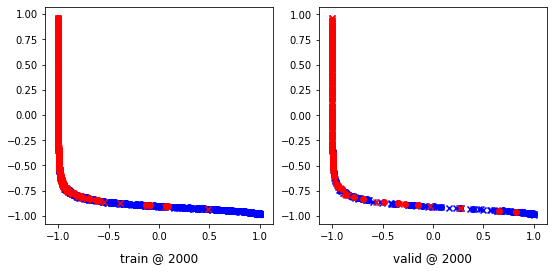

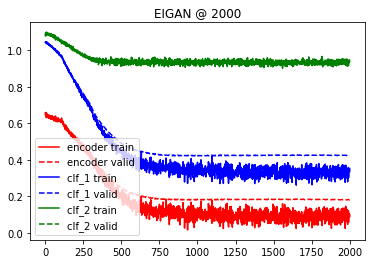

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:27, 22.73it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.04518588 	 0.04530976 	 0.01038115 	 0.00988208 	 0.01353430 	 0.01177760


 25%|██▌       | 502/2001 [00:31<01:37, 15.34it/s]

500 	 -0.01860313 	 -0.01872704 	 -0.06161267 	 -0.06137328 	 -0.00734955 	 -0.00650966


 50%|█████     | 1002/2001 [01:02<01:17, 12.85it/s]

1000 	 -0.10682094 	 -0.10692433 	 -0.16366352 	 -0.16392006 	 -0.03840788 	 -0.03873780


 75%|███████▌  | 1504/2001 [01:33<00:32, 15.12it/s]

1500 	 -0.20901924 	 -0.20620768 	 -0.28660220 	 -0.28437480 	 -0.07853653 	 -0.07958384


100%|██████████| 2001/2001 [02:04<00:00, 16.08it/s]


2000 	 -0.31715092 	 -0.31718689 	 -0.42093715 	 -0.42015308 	 -0.12215860 	 -0.12088343


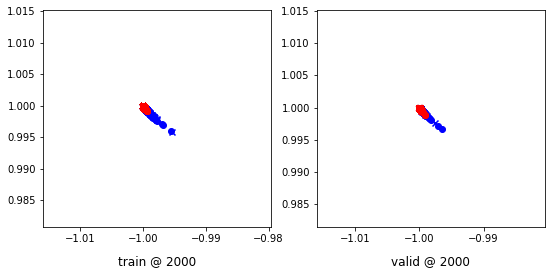

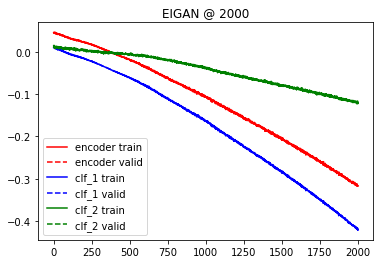

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.089259 	 1.089336 	 0.5158
200 	 0.683734 	 0.701264 	 0.8613
400 	 0.332160 	 0.394128 	 0.8808
600 	 0.325630 	 0.398769 	 0.8808
800 	 0.325050 	 0.398765 	 0.8808
1000 	 0.324639 	 0.398475 	 0.8808
Accuracy: 0.8807785888077859
Error Rate: 0.1192214111922141
F1 Score: 0.8847058823529412
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.878345498783455
Error Rate: 0.12165450121654502
F1 Score: 0.8820754716981133
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8832116788321168
Error Rate: 0.116

  0%|          | 2/2001 [00:00<02:03, 16.13it/s]

Accuracy: 0.6253041362530414
Error Rate: 0.3746958637469586
F1 Score: 0.7694610778443114
VAR1: 0.6, VAR2: 0.6, TRIAL: 8
X, y_1, y2
(2386, 2) (2386, 1) (2386, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1908, 2) (478, 2) (1908, 1) (478, 1) (1908, 1) (478, 1)
class weights => w1, w2 [1.6975089  2.43367347] [1.37068966 3.69767442]
tensor sizes => torch.Size([1908, 2]) torch.Size([478, 2]) torch.Size([1908, 2]) torch.Size([478, 2]) torch.Size([1908, 2]) torch.Size([478, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.65429854 	 0.64681745 	 1.01587474 	 1.01528203 	 1.05484319 	 1.06161177


 25%|██▌       | 504/2001 [00:33<01:24, 17.80it/s]

500 	 0.40129465 	 0.43561381 	 0.61007148 	 0.65579069 	 0.90188134 	 0.91332406


 50%|█████     | 1001/2001 [01:08<01:13, 13.61it/s]

1000 	 0.39206880 	 0.40824950 	 0.59271240 	 0.62398535 	 0.89401281 	 0.90888304


 75%|███████▌  | 1504/2001 [01:42<00:35, 14.13it/s]

1500 	 0.36696827 	 0.39606637 	 0.59136730 	 0.61088455 	 0.91763836 	 0.90796536


100%|██████████| 2001/2001 [02:17<00:00, 14.56it/s]


2000 	 0.38259798 	 0.39028352 	 0.58913845 	 0.60612011 	 0.89992505 	 0.90898377


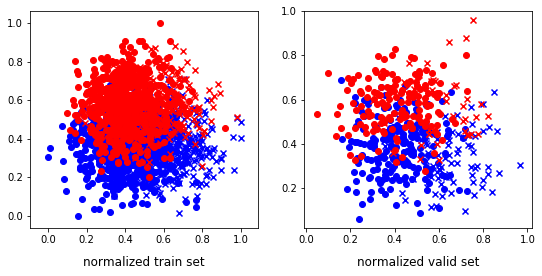

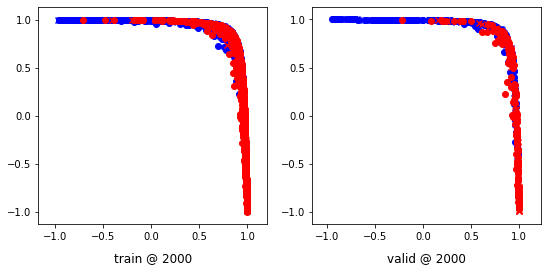

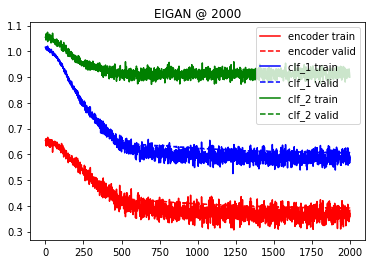

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:10, 15.30it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.10947857 	 0.11131109 	 0.08896435 	 0.09026843 	 0.05688100 	 0.05493909


 25%|██▌       | 504/2001 [00:33<01:26, 17.35it/s]

500 	 0.07949493 	 0.08197457 	 0.04505172 	 0.04715828 	 0.01441176 	 0.01340879


 50%|█████     | 1003/2001 [01:05<01:07, 14.81it/s]

1000 	 0.02289828 	 0.02146927 	 -0.04050300 	 -0.04141991 	 -0.05172330 	 -0.05077716


 75%|███████▌  | 1504/2001 [01:40<00:32, 15.27it/s]

1500 	 -0.04274110 	 -0.04303590 	 -0.16298664 	 -0.16327381 	 -0.14676394 	 -0.14675339


100%|██████████| 2001/2001 [02:14<00:00, 14.90it/s]


2000 	 -0.09193809 	 -0.09288512 	 -0.27914441 	 -0.28048310 	 -0.23267333 	 -0.23312582


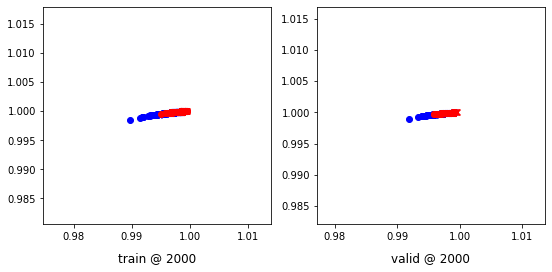

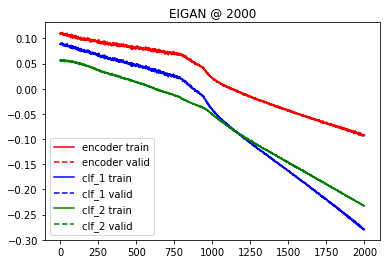

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.031614 	 1.031356 	 0.4100
200 	 0.705109 	 0.709658 	 0.8117
400 	 0.587373 	 0.595082 	 0.8096
600 	 0.585982 	 0.594255 	 0.8117
800 	 0.585560 	 0.594134 	 0.8117
1000 	 0.585225 	 0.593990 	 0.8159
Accuracy: 0.8158995815899581
Error Rate: 0.18410041841004185
F1 Score: 0.7777777777777778
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8075313807531381
Error Rate: 0.19246861924686193
F1 Score: 0.7809523809523811
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8158995815899581
Error Rate: 0.1

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.7280334728033473
Error Rate: 0.2719665271966527
F1 Score: 0.0
VAR1: 0.6, VAR2: 0.8, TRIAL: 8
X, y_1, y2
(2140, 2) (2140, 1) (2140, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1712, 2) (428, 2) (1712, 1) (428, 1) (1712, 1) (428, 1)
class weights => w1, w2 [2.24671916 1.80210526] [1.39413681 3.53719008]
tensor sizes => torch.Size([1712, 2]) torch.Size([428, 2]) torch.Size([1712, 2]) torch.Size([428, 2]) torch.Size([1712, 2]) torch.Size([428, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.66128379 	 0.66821301 	 0.99641478 	 0.99491477 	 1.02835476 	 1.01984894


 25%|██▌       | 502/2001 [00:33<01:38, 15.29it/s]

500 	 0.56501871 	 0.52126276 	 0.75596416 	 0.73315710 	 0.88414782 	 0.90504152


 50%|█████     | 1004/2001 [01:06<01:01, 16.11it/s]

1000 	 0.47795254 	 0.51318848 	 0.68827534 	 0.71158707 	 0.90342301 	 0.89154577


 75%|███████▌  | 1502/2001 [01:35<00:34, 14.35it/s]

1500 	 0.52141917 	 0.51476759 	 0.70157516 	 0.71201515 	 0.87330174 	 0.89039475


100%|██████████| 2001/2001 [02:08<00:00, 15.54it/s]


2000 	 0.49559718 	 0.51238596 	 0.67015129 	 0.71309340 	 0.86786634 	 0.89385462


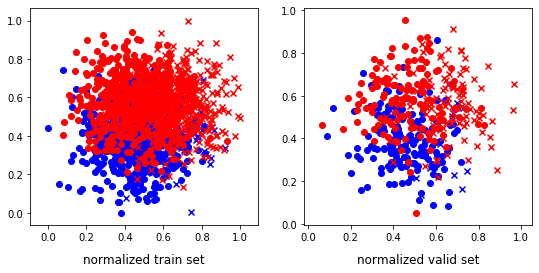

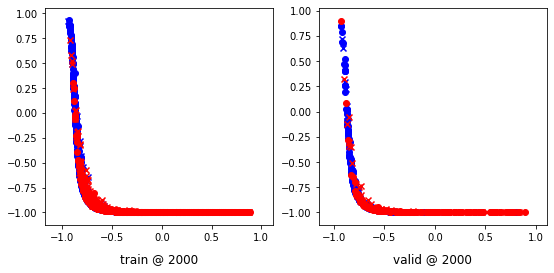

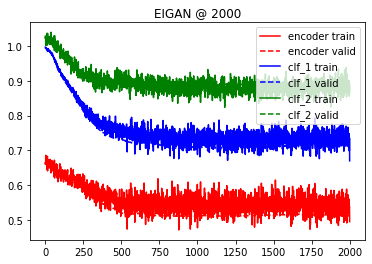

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:04, 16.10it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.01693899 	 -0.01519985 	 -0.04749272 	 -0.04744141 	 0.02524394 	 0.02044065


 25%|██▌       | 502/2001 [00:31<01:36, 15.56it/s]

500 	 -0.07815342 	 -0.07963203 	 -0.12848063 	 -0.12983772 	 -0.02429083 	 -0.02406625


 50%|█████     | 1004/2001 [01:03<01:01, 16.16it/s]

1000 	 -0.18052095 	 -0.18417323 	 -0.26971376 	 -0.26880580 	 -0.09862221 	 -0.09091678


 75%|███████▌  | 1503/2001 [01:34<00:29, 16.90it/s]

1500 	 -0.28367135 	 -0.29004532 	 -0.40663150 	 -0.41244131 	 -0.15065120 	 -0.14985135


100%|██████████| 2001/2001 [02:05<00:00, 15.90it/s]


2000 	 -0.38507158 	 -0.39067081 	 -0.55186832 	 -0.55181158 	 -0.20840578 	 -0.20142342


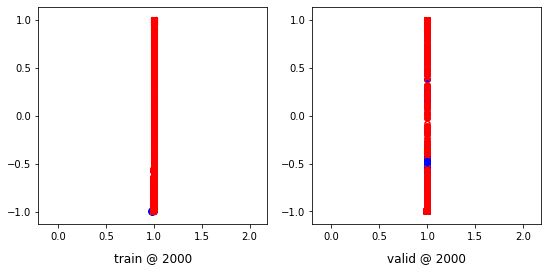

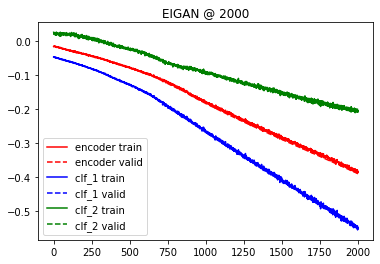

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.048507 	 1.048770 	 0.4463
200 	 0.794826 	 0.783285 	 0.7710
400 	 0.691558 	 0.657892 	 0.7710
600 	 0.687030 	 0.654360 	 0.7827
800 	 0.682908 	 0.650757 	 0.7827
1000 	 0.680600 	 0.648846 	 0.7874
Accuracy: 0.7850467289719626
Error Rate: 0.21495327102803738
F1 Score: 0.7991266375545852
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7733644859813084
Error Rate: 0.2266355140186916
F1 Score: 0.7820224719101123
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7827102803738317
Error Rate: 0.21

  0%|          | 2/2001 [00:00<01:41, 19.67it/s]

Accuracy: 0.7172897196261683
Error Rate: 0.2827102803738318
F1 Score: 0.0
VAR1: 0.8, VAR2: 0.2, TRIAL: 8
X, y_1, y2
(1878, 2) (1878, 1) (1878, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1502, 2) (376, 2) (1502, 1) (376, 1) (1502, 1) (376, 1)
class weights => w1, w2 [3.98408488 1.33511111] [2.58519793 1.63083605]
tensor sizes => torch.Size([1502, 2]) torch.Size([376, 2]) torch.Size([1502, 2]) torch.Size([376, 2]) torch.Size([1502, 2]) torch.Size([376, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.72849345 	 0.72280657 	 1.09046352 	 1.08079171 	 1.05523896 	 1.05113232


 25%|██▌       | 504/2001 [00:30<01:19, 18.83it/s]

500 	 0.61970085 	 0.65559423 	 0.87303764 	 0.91313905 	 0.94648439 	 0.95069200


 50%|█████     | 1004/2001 [01:01<01:02, 15.93it/s]

1000 	 -0.17550132 	 -0.16691983 	 0.07061962 	 0.07118350 	 0.93930501 	 0.93125051


 75%|███████▌  | 1504/2001 [01:32<00:32, 15.10it/s]

1500 	 -0.17414358 	 -0.20920803 	 0.05442229 	 0.03054689 	 0.92172259 	 0.93290210


100%|██████████| 2001/2001 [02:03<00:00, 16.21it/s]


2000 	 -0.21058494 	 -0.20982738 	 0.02258603 	 0.03000086 	 0.92629927 	 0.93297541


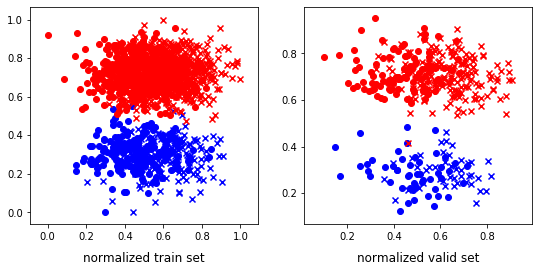

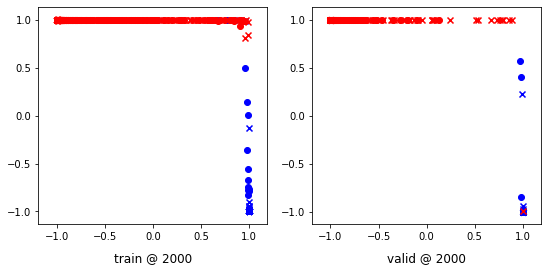

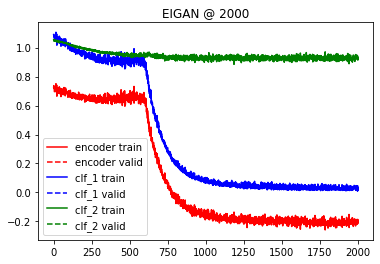

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:31, 21.82it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.08877875 	 0.08839322 	 0.05125188 	 0.05127146 	 0.00635792 	 0.00732992


 25%|██▌       | 503/2001 [00:29<01:26, 17.38it/s]

500 	 0.07198559 	 0.07326087 	 0.01180777 	 0.01312185 	 -0.04529833 	 -0.04523258


 50%|█████     | 1004/2001 [00:59<01:00, 16.51it/s]

1000 	 0.06315714 	 0.06449022 	 -0.06506163 	 -0.06455030 	 -0.15807334 	 -0.15922213


 75%|███████▌  | 1504/2001 [01:27<00:27, 18.27it/s]

1500 	 0.07416788 	 0.06932118 	 -0.09507874 	 -0.09447093 	 -0.21139301 	 -0.20471239


100%|██████████| 2001/2001 [01:57<00:00, 16.99it/s]


2000 	 0.06013609 	 0.06404011 	 -0.13614608 	 -0.13596433 	 -0.24303403 	 -0.24721856


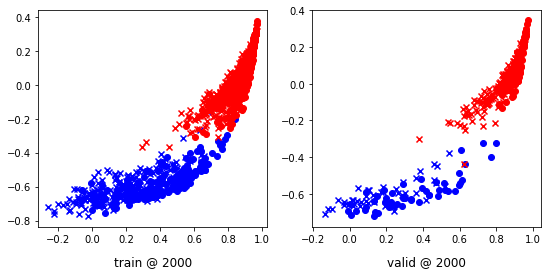

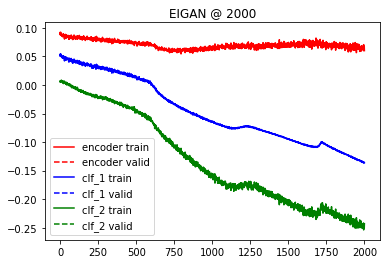

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.059458 	 1.061532 	 0.7500
200 	 0.495548 	 0.490948 	 0.9761
400 	 0.085898 	 0.074375 	 0.9973
600 	 0.045477 	 0.035709 	 0.9973
800 	 0.035561 	 0.026605 	 0.9973
1000 	 0.031799 	 0.023283 	 0.9973
Accuracy: 0.9973404255319149
Error Rate: 0.0026595744680851063
F1 Score: 0.9982174688057042
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9973404255319149
Error Rate: 0.0026595744680851063
F1 Score: 0.9982174688057042
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9973404255319149
Error Rate:

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.7686170212765957
Error Rate: 0.23138297872340424
F1 Score: 0.8129032258064517
VAR1: 0.8, VAR2: 0.4, TRIAL: 8
X, y_1, y2
(2521, 2) (2521, 1) (2521, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2016, 2) (505, 2) (2016, 1) (505, 1) (2016, 1) (505, 1)
class weights => w1, w2 [1.75       2.33333333] [1.53191489 2.88      ]
tensor sizes => torch.Size([2016, 2]) torch.Size([505, 2]) torch.Size([2016, 2]) torch.Size([505, 2]) torch.Size([2016, 2]) torch.Size([505, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.65185249 	 0.64825714 	 1.03456581 	 1.03469181 	 1.07599115 	 1.07958186


 25%|██▌       | 503/2001 [00:36<01:55, 12.98it/s]

500 	 0.23932031 	 0.17399111 	 0.47244519 	 0.40237787 	 0.92630976 	 0.92153394


 50%|█████     | 1002/2001 [01:12<01:10, 14.20it/s]

1000 	 0.20724103 	 0.11355284 	 0.40405077 	 0.32217976 	 0.89006609 	 0.90177411


 75%|███████▌  | 1503/2001 [01:48<00:35, 14.01it/s]

1500 	 0.19337219 	 0.10007775 	 0.40359262 	 0.31092250 	 0.90333533 	 0.90399194


100%|██████████| 2001/2001 [02:23<00:00, 13.95it/s]


2000 	 0.18758073 	 0.09830108 	 0.39359221 	 0.30830625 	 0.89915377 	 0.90315235


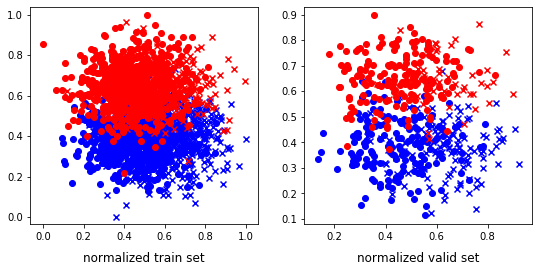

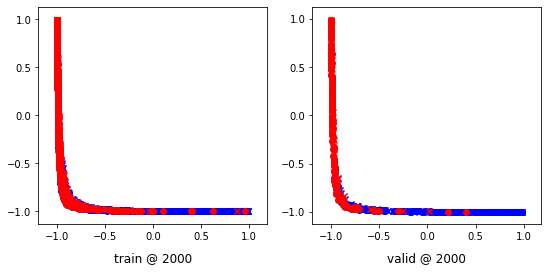

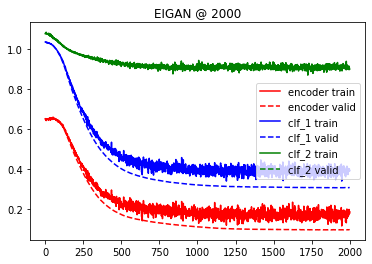

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:41, 19.75it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.03608559 	 -0.03647304 	 -0.08400774 	 -0.08410494 	 -0.01885585 	 -0.01824733


 25%|██▌       | 503/2001 [00:35<01:36, 15.56it/s]

500 	 -0.11797263 	 -0.11961124 	 -0.18318780 	 -0.18266726 	 -0.05528428 	 -0.05110958


 50%|█████     | 1002/2001 [01:09<01:12, 13.87it/s]

1000 	 -0.18090650 	 -0.18517107 	 -0.27819830 	 -0.28146809 	 -0.11191242 	 -0.11031765


 75%|███████▌  | 1503/2001 [01:42<00:39, 12.74it/s]

1500 	 -0.23255600 	 -0.23386960 	 -0.37231407 	 -0.37282428 	 -0.17384148 	 -0.17276624


100%|██████████| 2001/2001 [02:18<00:00, 14.49it/s]


2000 	 -0.27271327 	 -0.27422222 	 -0.47162834 	 -0.47185576 	 -0.24599874 	 -0.24455993


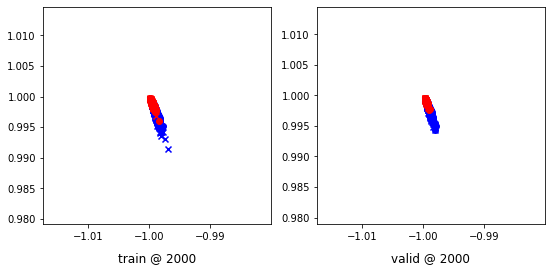

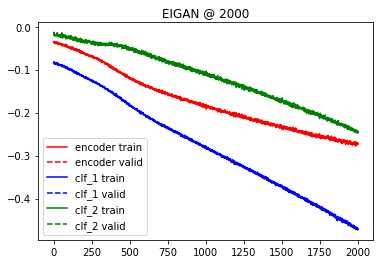

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.003185 	 1.002777 	 0.6436
200 	 0.561662 	 0.533429 	 0.9030
400 	 0.388988 	 0.318118 	 0.9168
600 	 0.384409 	 0.305702 	 0.9188
800 	 0.384141 	 0.304825 	 0.9188
1000 	 0.383977 	 0.304695 	 0.9188
Accuracy: 0.9188118811881189
Error Rate: 0.08118811881188119
F1 Score: 0.9053117782909931
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9168316831683169
Error Rate: 0.08316831683168317
F1 Score: 0.9041095890410958
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9188118811881189
Error Rate: 0.0

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.6534653465346535
Error Rate: 0.3465346534653465
F1 Score: 0.0
VAR1: 0.8, VAR2: 0.6, TRIAL: 8
X, y_1, y2
(2143, 2) (2143, 1) (2143, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1714, 2) (429, 2) (1714, 1) (429, 1) (1714, 1) (429, 1)
class weights => w1, w2 [2.23468057 1.80992608] [1.47886109 3.08828829]
tensor sizes => torch.Size([1714, 2]) torch.Size([429, 2]) torch.Size([1714, 2]) torch.Size([429, 2]) torch.Size([1714, 2]) torch.Size([429, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.70033407 	 0.70036221 	 1.03937387 	 1.03911006 	 1.03252208 	 1.03189504


 25%|██▌       | 503/2001 [00:33<01:36, 15.58it/s]

500 	 0.45062536 	 0.44324219 	 0.69917411 	 0.66107506 	 0.94192076 	 0.91098005


 50%|█████     | 1004/2001 [01:07<01:02, 15.87it/s]

1000 	 0.39264977 	 0.38145250 	 0.62423456 	 0.58465439 	 0.92487431 	 0.89634907


 75%|███████▌  | 1502/2001 [01:40<00:33, 14.69it/s]

1500 	 0.43479222 	 0.37801284 	 0.65369761 	 0.58142263 	 0.91236895 	 0.89655697


100%|██████████| 2001/2001 [02:14<00:00, 14.90it/s]


2000 	 0.44938129 	 0.37730151 	 0.64279413 	 0.58162338 	 0.88656008 	 0.89746904


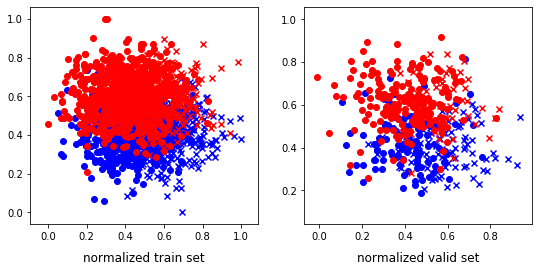

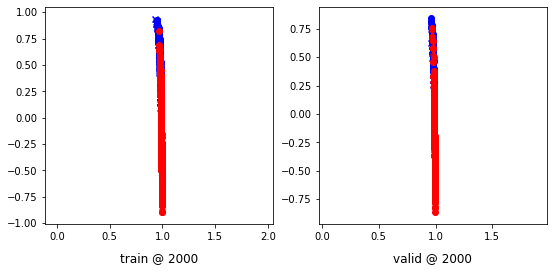

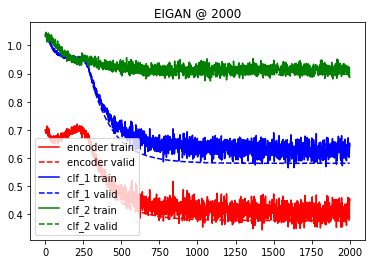

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:38, 20.35it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.18240318 	 0.18340901 	 0.11876235 	 0.11869490 	 -0.05219236 	 -0.05438968


 25%|██▌       | 502/2001 [00:32<01:35, 15.76it/s]

500 	 0.15660390 	 0.15658092 	 0.07397698 	 0.07436271 	 -0.08744720 	 -0.08673719


 50%|█████     | 1003/2001 [01:03<01:01, 16.31it/s]

1000 	 0.14232594 	 0.14352335 	 0.02210587 	 0.02395607 	 -0.14672294 	 -0.14578502


 75%|███████▌  | 1503/2001 [01:35<00:32, 15.09it/s]

1500 	 0.13226938 	 0.13019592 	 -0.02145759 	 -0.02105094 	 -0.19207220 	 -0.18890470


100%|██████████| 2001/2001 [02:07<00:00, 15.70it/s]


2000 	 0.11155593 	 0.10493083 	 -0.10457832 	 -0.10310523 	 -0.26489034 	 -0.25610971


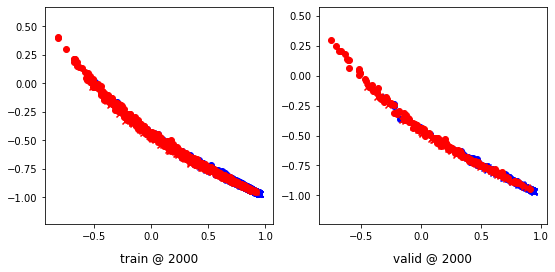

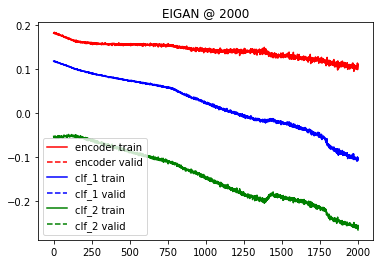

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.052586 	 1.052566 	 0.4476
200 	 0.788515 	 0.774012 	 0.7739
400 	 0.622774 	 0.584558 	 0.8205
600 	 0.618341 	 0.578040 	 0.8252
800 	 0.618195 	 0.578049 	 0.8252
1000 	 0.618133 	 0.577998 	 0.8252
Accuracy: 0.8251748251748252
Error Rate: 0.17482517482517482
F1 Score: 0.8427672955974843
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8251748251748252
Error Rate: 0.17482517482517482
F1 Score: 0.838012958963283
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8205128205128205
Error Rate: 0.17

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.745920745920746
Error Rate: 0.2540792540792541
F1 Score: 0.551440329218107
VAR1: 0.8, VAR2: 0.8, TRIAL: 8
X, y_1, y2
(1228, 2) (1228, 1) (1228, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(982, 2) (246, 2) (982, 1) (246, 1) (982, 1) (246, 1)
class weights => w1, w2 [1.14452214 7.91935484] [1.170441   6.86713287]
tensor sizes => torch.Size([982, 2]) torch.Size([246, 2]) torch.Size([982, 2]) torch.Size([246, 2]) torch.Size([982, 2]) torch.Size([246, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.70606709 	 0.70401168 	 1.02013826 	 1.01952088 	 1.00744796 	 1.00865638


 25%|██▌       | 504/2001 [00:18<00:54, 27.24it/s]

500 	 0.64904249 	 0.64685959 	 0.86085469 	 0.86001778 	 0.90495950 	 0.90630537


 50%|█████     | 1009/2001 [00:37<00:30, 32.13it/s]

1000 	 0.67819494 	 0.67555237 	 0.84497523 	 0.84416902 	 0.85992748 	 0.86176383


 75%|███████▌  | 1506/2001 [00:55<00:15, 31.17it/s]

1500 	 0.68004328 	 0.67730629 	 0.84488362 	 0.84407800 	 0.85798752 	 0.85991889


100%|██████████| 2001/2001 [01:12<00:00, 27.48it/s]


2000 	 0.68004245 	 0.67730343 	 0.84487480 	 0.84407037 	 0.85797954 	 0.85991412


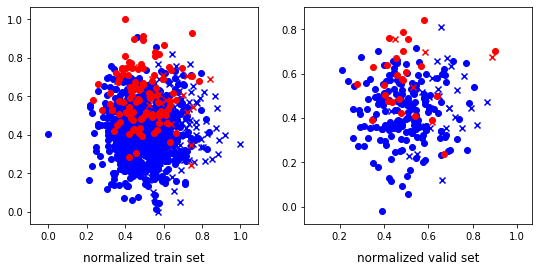

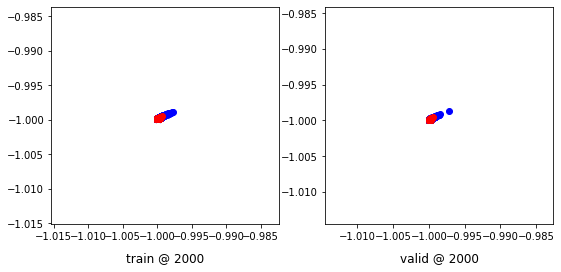

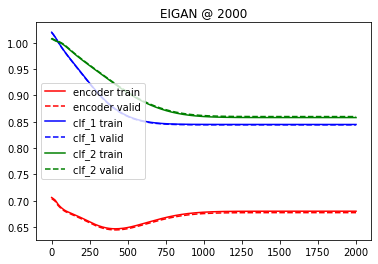

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:17, 25.68it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.08941948 	 0.08936151 	 0.01267684 	 0.01264812 	 -0.07697121 	 -0.07697182


 25%|██▌       | 505/2001 [00:17<00:54, 27.43it/s]

500 	 0.05033344 	 0.05020125 	 -0.03356579 	 -0.03363754 	 -0.08950079 	 -0.08954928


 50%|█████     | 1005/2001 [00:35<00:37, 26.74it/s]

1000 	 0.02270172 	 0.02254377 	 -0.08169535 	 -0.08181340 	 -0.12307666 	 -0.12304358


 75%|███████▌  | 1505/2001 [00:51<00:19, 24.81it/s]

1500 	 0.00881570 	 0.00866824 	 -0.11972668 	 -0.11983588 	 -0.15852308 	 -0.15847471


100%|██████████| 2001/2001 [01:09<00:00, 28.62it/s]


2000 	 0.00106183 	 0.00090025 	 -0.15439841 	 -0.15450759 	 -0.19428341 	 -0.19421804


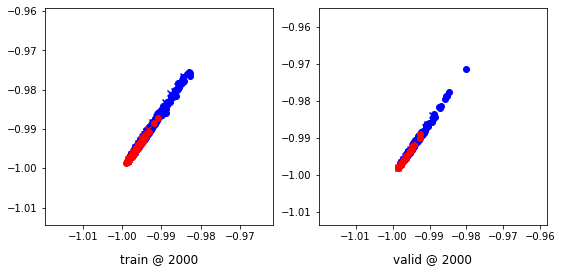

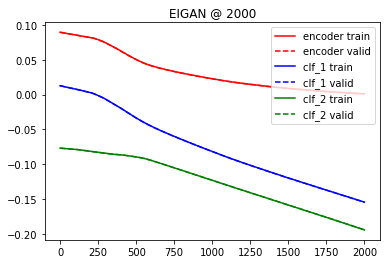

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.034484 	 1.034180 	 0.8740
200 	 0.816384 	 0.821050 	 0.8740
400 	 0.681498 	 0.718950 	 0.8780
600 	 0.646186 	 0.696112 	 0.8577
800 	 0.643809 	 0.693910 	 0.8659
1000 	 0.643290 	 0.693111 	 0.8618
Accuracy: 0.8617886178861789
Error Rate: 0.13821138211382114
F1 Score: 0.4333333333333333
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7398373983739838
Error Rate: 0.2601626016260163
F1 Score: 0.3846153846153846
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8739837398373984
Error Rate: 0.12

  0%|          | 3/2001 [00:00<01:21, 24.41it/s]

X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1580, 2) (396, 2) (1580, 1) (396, 1) (1580, 1) (396, 1)
class weights => w1, w2 [1.67195767 2.48818898] [1.67728238 2.47648903]
tensor sizes => torch.Size([1580, 2]) torch.Size([396, 2]) torch.Size([1580, 2]) torch.Size([396, 2]) torch.Size([1580, 2]) torch.Size([396, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.63726079 	 0.64233303 	 1.02588511 	 1.03034866 	 1.08202612 	 1.08116281


 25%|██▌       | 504/2001 [00:32<01:35, 15.59it/s]

500 	 0.06674273 	 0.08504049 	 0.23836984 	 0.23775779 	 0.86472040 	 0.84586447


 50%|█████     | 1005/2001 [01:03<00:55, 17.79it/s]

1000 	 -0.05242468 	 -0.07857429 	 0.04800917 	 0.05344177 	 0.79361248 	 0.82516325


 75%|███████▌  | 1504/2001 [01:35<00:31, 15.78it/s]

1500 	 -0.12890096 	 -0.13358733 	 0.05370657 	 0.04680511 	 0.87603956 	 0.87353963


100%|██████████| 2001/2001 [02:05<00:00, 15.88it/s]


2000 	 -0.13952616 	 -0.10335977 	 0.04844549 	 0.07845771 	 0.88111037 	 0.87496465


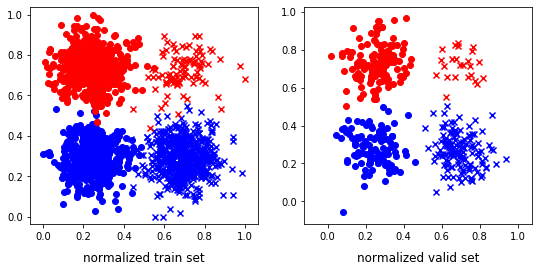

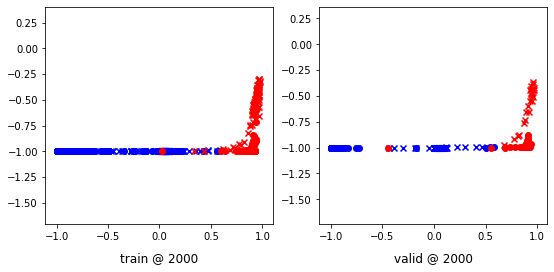

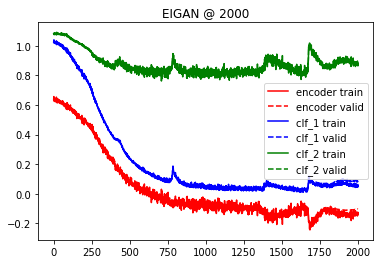

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:24, 23.55it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.07175843 	 -0.07175618 	 -0.10900439 	 -0.10914414 	 0.00703436 	 0.00664035


 25%|██▌       | 504/2001 [00:31<01:35, 15.68it/s]

500 	 -0.11946557 	 -0.12033220 	 -0.17401266 	 -0.17459410 	 -0.03354510 	 -0.03294185


 50%|█████     | 1002/2001 [01:00<00:55, 17.97it/s]

1000 	 -0.19011459 	 -0.19048513 	 -0.28227422 	 -0.28369135 	 -0.10355861 	 -0.10529692


 75%|███████▌  | 1504/2001 [01:30<00:30, 16.27it/s]

1500 	 -0.25673226 	 -0.25661224 	 -0.39986005 	 -0.39893237 	 -0.17831348 	 -0.17725341


100%|██████████| 2001/2001 [02:00<00:00, 16.59it/s]


2000 	 -0.31202832 	 -0.31307840 	 -0.53624845 	 -0.53732187 	 -0.27351752 	 -0.27354354


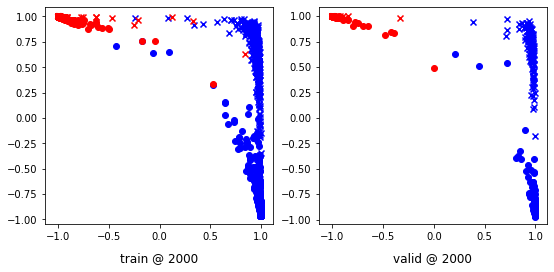

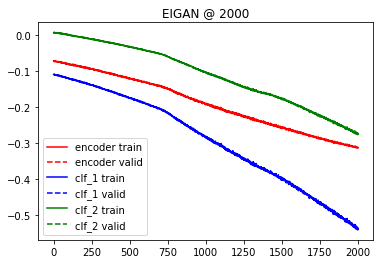

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.015890 	 1.015441 	 0.5985
200 	 0.315029 	 0.314199 	 1.0000
400 	 0.052930 	 0.051259 	 1.0000
600 	 0.030137 	 0.026003 	 1.0000
800 	 0.023747 	 0.018466 	 1.0000
1000 	 0.021151 	 0.015073 	 1.0000
Accuracy: 1.0
Error Rate: 0.0
F1 Score: 1.0
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 1.0
Error Rate: 0.0
F1 Score: 1.0
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9974747474747475
Error Rate: 0.0025252525252525255
F1 Score: 0.9968454258675079
--------------------------------------------

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.277285 	 0.277303 	 0.9343
Accuracy: 0.9343434343434344
Error Rate: 0.06565656565656566
F1 Score: 0.9133333333333333
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9267676767676768
Error Rate: 0.07323232323232323
F1 Score: 0.9036544850498339
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9368686868686869
Error Rate: 0.06313131313131314
F1 Score: 0.9163879598662208
VAR1: 0.2, VAR2: 0.4, TRIAL: 9
X, y_1, y2
(1644, 2) (1644, 1) (1644, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1315, 2) (329, 2) (1315, 1) (329, 1) (1315, 1) (329, 1)
class weights => w1, w2 [1.4578714  3.18401937] [1.71895425 2.39090909]
tensor sizes => torch.Size([1315, 2]) torch.Size([329, 2]) torch.Size([1315, 2]) torch.Size([329, 2]) torch.Size([1315, 2]) torch.Size([329, 2])
--------------------------------------------------------------------------------
EIGAN Training
-----

 25%|██▌       | 503/2001 [00:29<01:27, 17.20it/s]

500 	 0.37633440 	 0.38039777 	 0.41766316 	 0.42821190 	 0.73434669 	 0.74096131


 50%|█████     | 1003/2001 [00:59<00:57, 17.22it/s]

1000 	 0.25686187 	 0.32943216 	 0.29850212 	 0.34887275 	 0.73529696 	 0.71258777


 75%|███████▌  | 1504/2001 [01:29<00:31, 15.63it/s]

1500 	 0.28365186 	 0.30806810 	 0.31935802 	 0.32807678 	 0.73034585 	 0.71315587


100%|██████████| 2001/2001 [01:59<00:00, 16.78it/s]


2000 	 0.21745405 	 0.15802240 	 0.37817341 	 0.32198077 	 0.85411489 	 0.85710555


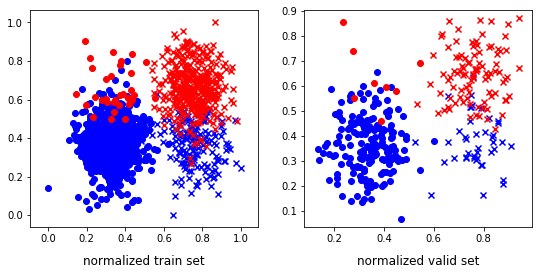

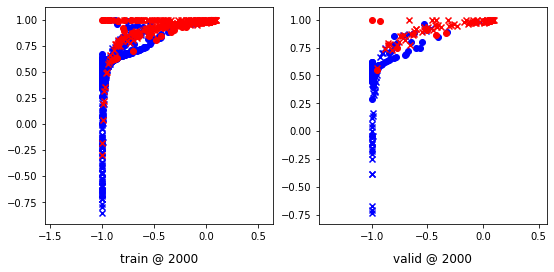

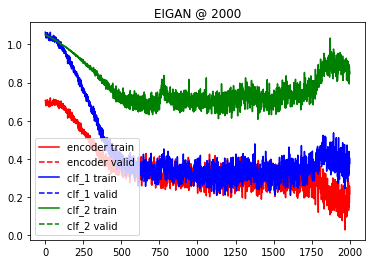

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:12, 27.59it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.07148109 	 -0.07090063 	 -0.12277891 	 -0.12300622 	 -0.02643201 	 -0.02826649


 25%|██▌       | 502/2001 [00:28<01:12, 20.66it/s]

500 	 -0.16937068 	 -0.16752978 	 -0.23303978 	 -0.23317821 	 -0.05231107 	 -0.05621950


 50%|█████     | 1004/2001 [00:57<00:56, 17.66it/s]

1000 	 -0.24653143 	 -0.24741331 	 -0.33273804 	 -0.33272764 	 -0.09360617 	 -0.09208617


 75%|███████▌  | 1502/2001 [01:26<00:29, 16.87it/s]

1500 	 -0.34594527 	 -0.34483248 	 -0.44775343 	 -0.44759473 	 -0.11906628 	 -0.12056553


100%|██████████| 2001/2001 [01:55<00:00, 17.32it/s]


2000 	 -0.46600574 	 -0.46762162 	 -0.58672428 	 -0.58756864 	 -0.14744334 	 -0.14633365


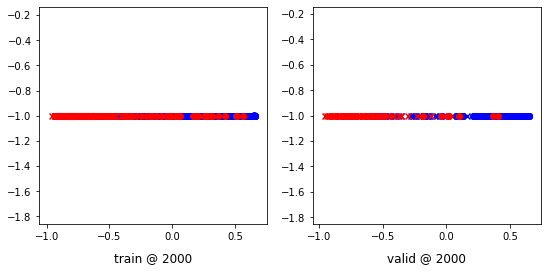

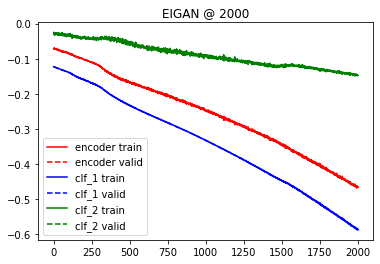

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.034468 	 1.035079 	 0.3161
200 	 0.482743 	 0.488643 	 0.9149
400 	 0.226715 	 0.226326 	 0.9422
600 	 0.209052 	 0.201818 	 0.9453
800 	 0.205926 	 0.198590 	 0.9483
1000 	 0.203386 	 0.198559 	 0.9422
Accuracy: 0.9422492401215805
Error Rate: 0.057750759878419454
F1 Score: 0.9099526066350712
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9422492401215805
Error Rate: 0.057750759878419454
F1 Score: 0.9124423963133641
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9422492401215805
Error Rate: 0

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.153329 	 0.131648 	 0.9666
Accuracy: 0.9665653495440729
Error Rate: 0.03343465045592705
F1 Score: 0.9605734767025089
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9635258358662614
Error Rate: 0.0364741641337386
F1 Score: 0.9568345323741007
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9665653495440729
Error Rate: 0.03343465045592705
F1 Score: 0.9605734767025089
VAR1: 0.2, VAR2: 0.6, TRIAL: 9
X, y_1, y2
(1185, 2) (1185, 1) (1185, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(948, 2) (237, 2) (948, 1) (237, 1) (948, 1) (237, 1)
class weights => w1, w2 [6.07692308 1.1969697 ] [32.68965517  1.03155604]
tensor sizes => torch.Size([948, 2]) torch.Size([237, 2]) torch.Size([948, 2]) torch.Size([237, 2]) torch.Size([948, 2]) torch.Size([237, 2])
--------------------------------------------------------------------------------
EIGAN Training
----------

 25%|██▌       | 505/2001 [00:17<00:53, 28.15it/s]

500 	 0.59402931 	 0.58068246 	 0.75272030 	 0.73286736 	 0.85184962 	 0.84533209


 50%|█████     | 1001/2001 [00:35<00:32, 30.43it/s]

1000 	 0.56474513 	 0.54252404 	 0.63636321 	 0.60925394 	 0.76476485 	 0.75987709


 75%|███████▌  | 1503/2001 [00:52<00:16, 31.12it/s]

1500 	 0.54229599 	 0.51908833 	 0.60082299 	 0.57225865 	 0.75167578 	 0.74631751


100%|██████████| 2001/2001 [01:10<00:00, 28.42it/s]


2000 	 0.52976102 	 0.50749576 	 0.58682716 	 0.55987549 	 0.75021255 	 0.74552691


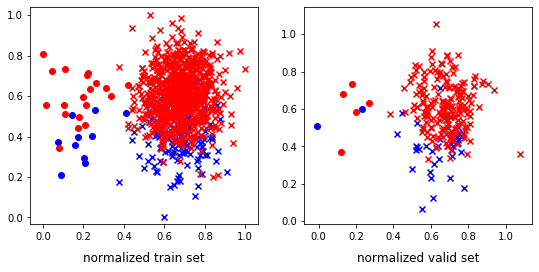

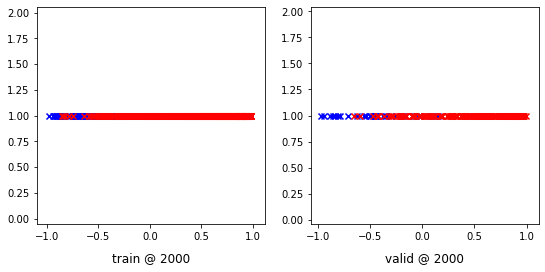

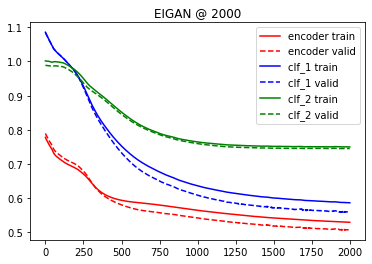

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 5/2001 [00:00<00:44, 44.85it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.06141207 	 0.06138395 	 0.01639396 	 0.01634478 	 -0.01215207 	 -0.01222434


 25%|██▌       | 504/2001 [00:17<01:05, 23.02it/s]

500 	 0.04205541 	 0.04204990 	 -0.02713480 	 -0.02721273 	 -0.06303626 	 -0.06317791


 50%|█████     | 1005/2001 [00:34<00:31, 31.36it/s]

1000 	 0.04375128 	 0.04378095 	 -0.05783295 	 -0.05793146 	 -0.11872239 	 -0.11892383


 75%|███████▌  | 1505/2001 [00:52<00:19, 26.00it/s]

1500 	 0.05098609 	 0.05103911 	 -0.07343365 	 -0.07359900 	 -0.15272623 	 -0.15304121


100%|██████████| 2001/2001 [01:08<00:00, 29.20it/s]


2000 	 0.05708116 	 0.05717575 	 -0.07840866 	 -0.07855720 	 -0.16808318 	 -0.16841954


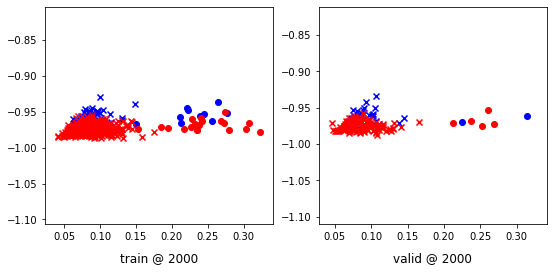

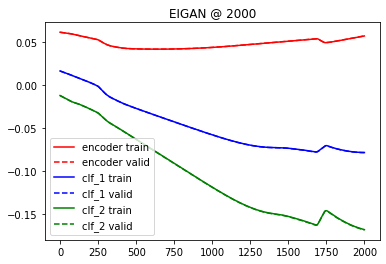

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.064914 	 1.065091 	 0.1646
200 	 0.704438 	 0.690617 	 0.8523
400 	 0.577638 	 0.538515 	 0.8776
600 	 0.567486 	 0.524162 	 0.8692
800 	 0.566073 	 0.523020 	 0.8692
1000 	 0.565370 	 0.523811 	 0.8692
Accuracy: 0.869198312236287
Error Rate: 0.1308016877637131
F1 Score: 0.9211195928753181
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7932489451476793
Error Rate: 0.20675105485232068
F1 Score: 0.8635097493036211
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8818565400843882
Error Rate: 0.118

  0%|          | 0/2001 [00:00<?, ?it/s]

1000 	 0.034211 	 0.024059 	 0.9958
Accuracy: 0.9957805907172996
Error Rate: 0.004219409282700422
F1 Score: 0.9978213507625272
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9957805907172996
Error Rate: 0.004219409282700422
F1 Score: 0.9978213507625272
SVM
--------------------------------------------------------------------------------
Accuracy: 1.0
Error Rate: 0.0
F1 Score: 1.0
VAR1: 0.2, VAR2: 0.8, TRIAL: 9
X, y_1, y2
(1646, 2) (1646, 1) (1646, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1316, 2) (330, 2) (1316, 1) (330, 1) (1316, 1) (330, 1)
class weights => w1, w2 [1.65119197 2.53564547] [3.29824561 1.4351145 ]
tensor sizes => torch.Size([1316, 2]) torch.Size([330, 2]) torch.Size([1316, 2]) torch.Size([330, 2]) torch.Size([1316, 2]) torch.Size([330, 2])
--------------------------------------------------------------------------------
EIGAN Training
-------------------------------------------------

 25%|██▌       | 503/2001 [00:29<01:30, 16.54it/s]

500 	 0.58791333 	 0.62651402 	 0.81675005 	 0.83525705 	 0.92273325 	 0.90189022


 50%|█████     | 1004/2001 [00:59<01:00, 16.35it/s]

1000 	 0.52313942 	 0.60380238 	 0.75378436 	 0.80651355 	 0.92380995 	 0.89585835


 75%|███████▌  | 1504/2001 [01:29<00:27, 17.76it/s]

1500 	 0.51701623 	 0.59133267 	 0.72544485 	 0.79905301 	 0.90197229 	 0.90086752


100%|██████████| 2001/2001 [01:59<00:00, 16.81it/s]


2000 	 0.55324823 	 0.58708096 	 0.73643064 	 0.79378909 	 0.87930739 	 0.89985532


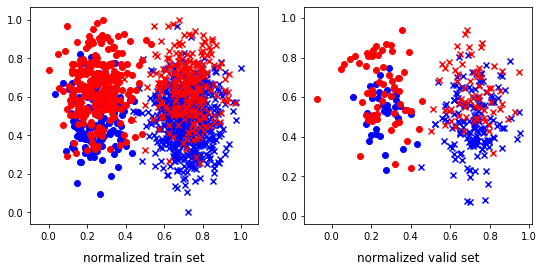

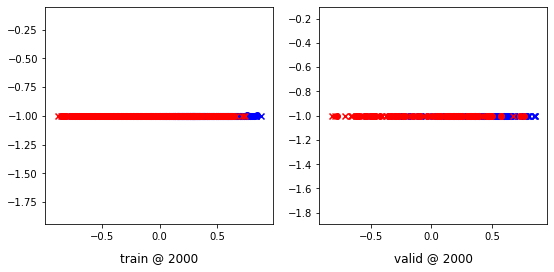

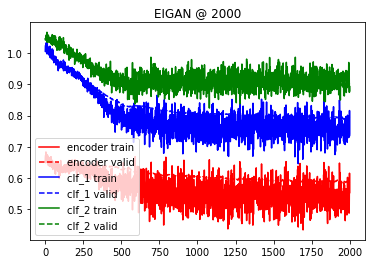

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<02:03, 16.16it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.05042566 	 0.05062421 	 -0.02133599 	 -0.02125739 	 -0.06782299 	 -0.06810744


 25%|██▌       | 504/2001 [00:28<01:24, 17.77it/s]

500 	 0.01442368 	 0.01249050 	 -0.07979617 	 -0.08180609 	 -0.10692482 	 -0.10707749


 50%|█████     | 1004/2001 [00:57<00:56, 17.74it/s]

1000 	 -0.02512561 	 -0.02360998 	 -0.16726445 	 -0.16457386 	 -0.17701249 	 -0.17545155


 75%|███████▌  | 1504/2001 [01:26<00:26, 18.47it/s]

1500 	 -0.05793135 	 -0.05717467 	 -0.25950190 	 -0.25959259 	 -0.24896604 	 -0.24990879


100%|██████████| 2001/2001 [01:55<00:00, 17.34it/s]


2000 	 -0.09310952 	 -0.08718139 	 -0.37845281 	 -0.37398446 	 -0.33417535 	 -0.33554000


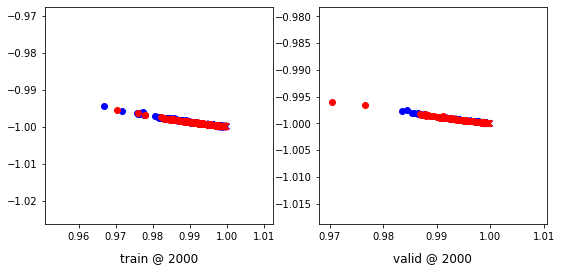

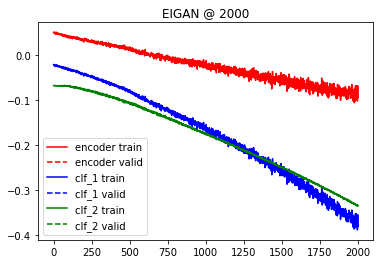

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.074213 	 1.074496 	 0.3939
200 	 0.787596 	 0.800977 	 0.7182
400 	 0.719204 	 0.764057 	 0.6970
600 	 0.718070 	 0.764958 	 0.7000
800 	 0.717280 	 0.764208 	 0.7000
1000 	 0.716470 	 0.763352 	 0.7030
Accuracy: 0.703030303030303
Error Rate: 0.296969696969697
F1 Score: 0.6230769230769231
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.6848484848484848
Error Rate: 0.3151515151515151
F1 Score: 0.6119402985074627
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7121212121212122
Error Rate: 0.28787

  0%|          | 2/2001 [00:00<01:47, 18.66it/s]

Accuracy: 0.696969696969697
Error Rate: 0.30303030303030304
F1 Score: 0.8214285714285715
VAR1: 0.4, VAR2: 0.2, TRIAL: 9
X, y_1, y2
(2153, 2) (2153, 1) (2153, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1722, 2) (431, 2) (1722, 1) (431, 1) (1722, 1) (431, 1)
class weights => w1, w2 [3.35672515 1.42431762] [2.28989362 1.77525773]
tensor sizes => torch.Size([1722, 2]) torch.Size([431, 2]) torch.Size([1722, 2]) torch.Size([431, 2]) torch.Size([1722, 2]) torch.Size([431, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.70949137 	 0.71997714 	 1.08704793 	 1.09726393 	 1.07079709 	 1.07043397


 25%|██▌       | 503/2001 [00:34<01:53, 13.26it/s]

500 	 0.07289004 	 0.07991698 	 0.29104635 	 0.29174039 	 0.91130203 	 0.90497059


 50%|█████     | 1002/2001 [01:08<01:06, 15.04it/s]

1000 	 -0.13057512 	 -0.15651162 	 0.05984150 	 0.04632025 	 0.88361883 	 0.89597905


 75%|███████▌  | 1502/2001 [01:41<00:29, 17.19it/s]

1500 	 -0.18578061 	 -0.18237768 	 0.02376556 	 0.02058454 	 0.90281075 	 0.89610940


100%|██████████| 2001/2001 [02:14<00:00, 14.84it/s]


2000 	 -0.17430997 	 -0.19004656 	 0.03075643 	 0.01421123 	 0.89843553 	 0.89740497


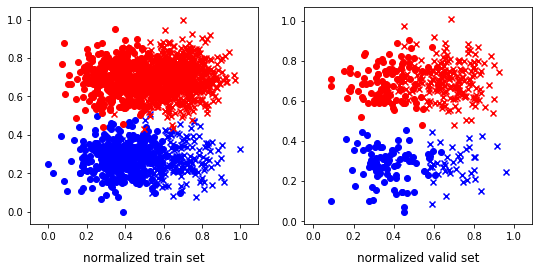

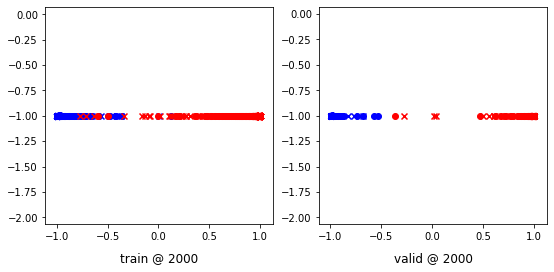

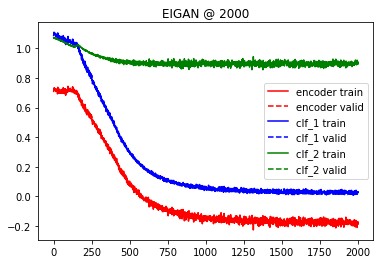

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:38, 12.59it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.02412088 	 0.01909506 	 -0.05438901 	 -0.05919302 	 -0.08008803 	 -0.07980004


 25%|██▌       | 503/2001 [00:31<01:46, 14.00it/s]

500 	 -0.05819991 	 -0.05757739 	 -0.19540311 	 -0.19380531 	 -0.17038529 	 -0.16909066


 50%|█████     | 1002/2001 [01:03<01:05, 15.19it/s]

1000 	 -0.05228600 	 -0.05894329 	 -0.28104728 	 -0.28860381 	 -0.27828914 	 -0.27922907


 75%|███████▌  | 1503/2001 [01:35<00:29, 17.00it/s]

1500 	 -0.03642002 	 -0.03656375 	 -0.37802249 	 -0.37988666 	 -0.38442156 	 -0.38593760


100%|██████████| 2001/2001 [02:06<00:00, 15.78it/s]


2000 	 -0.05542427 	 -0.05304980 	 -0.48593906 	 -0.49097252 	 -0.45612851 	 -0.46175727


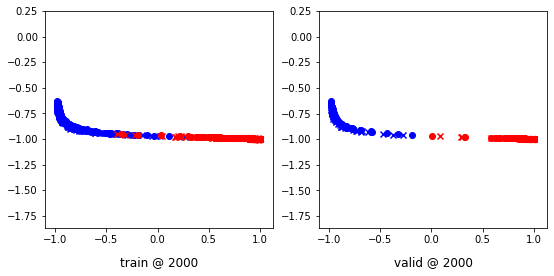

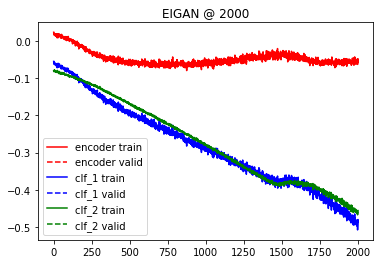

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.074220 	 1.073787 	 0.2970
200 	 0.316234 	 0.317783 	 0.9884
400 	 0.067302 	 0.060490 	 1.0000
600 	 0.035310 	 0.026050 	 1.0000
800 	 0.026738 	 0.016864 	 1.0000
1000 	 0.023136 	 0.012812 	 1.0000
Accuracy: 1.0
Error Rate: 0.0
F1 Score: 1.0
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9976798143851509
Error Rate: 0.002320185614849188
F1 Score: 0.9983471074380166
SVM
--------------------------------------------------------------------------------
Accuracy: 1.0
Error Rate: 0.0
F1 Score: 1.0
---------------------------------------------

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.6566125290023201
Error Rate: 0.3433874709976798
F1 Score: 0.7289377289377289
VAR1: 0.4, VAR2: 0.4, TRIAL: 9
X, y_1, y2
(1611, 2) (1611, 1) (1611, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1288, 2) (323, 2) (1288, 1) (323, 1) (1288, 1) (323, 1)
class weights => w1, w2 [1.5862069  2.70588235] [1.2765114  4.61648746]
tensor sizes => torch.Size([1288, 2]) torch.Size([323, 2]) torch.Size([1288, 2]) torch.Size([323, 2]) torch.Size([1288, 2]) torch.Size([323, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.73525846 	 0.72013044 	 1.05011129 	 1.04537773 	 1.00853968 	 1.01839447


 25%|██▌       | 503/2001 [00:29<01:34, 15.81it/s]

500 	 0.55663162 	 0.52824301 	 0.67828679 	 0.66392434 	 0.81487399 	 0.82882851


 50%|█████     | 1004/2001 [00:59<00:59, 16.70it/s]

1000 	 0.35056937 	 0.40106389 	 0.42889428 	 0.43753096 	 0.77319133 	 0.72961426


 75%|███████▌  | 1504/2001 [01:28<00:30, 16.46it/s]

1500 	 0.35824561 	 0.34516677 	 0.37719047 	 0.40458348 	 0.71221596 	 0.75256389


100%|██████████| 2001/2001 [01:58<00:00, 16.91it/s]


2000 	 0.29152790 	 0.30779910 	 0.33743587 	 0.37118822 	 0.73736167 	 0.75653630


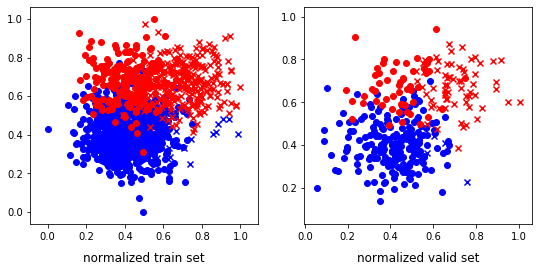

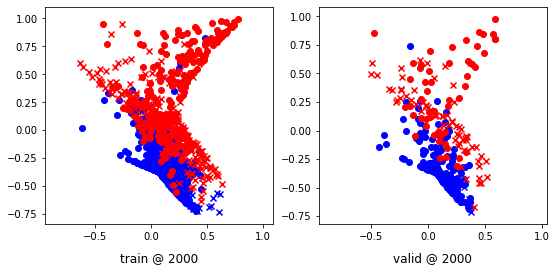

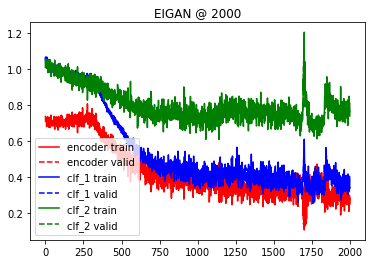

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<01:41, 19.73it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.17356904 	 0.17324758 	 0.07021985 	 0.07011289 	 -0.12138688 	 -0.12114589


 25%|██▌       | 504/2001 [00:28<01:25, 17.53it/s]

500 	 0.11629336 	 0.11658634 	 0.01040185 	 0.01018763 	 -0.12537843 	 -0.12618816


 50%|█████     | 1002/2001 [00:57<00:59, 16.86it/s]

1000 	 0.10208730 	 0.10197197 	 -0.05077689 	 -0.05079592 	 -0.19097193 	 -0.19085529


 75%|███████▌  | 1504/2001 [01:26<00:32, 15.40it/s]

1500 	 0.07099914 	 0.07054608 	 -0.10749538 	 -0.10776940 	 -0.22248228 	 -0.22227418


100%|██████████| 2001/2001 [01:55<00:00, 17.31it/s]


2000 	 0.03010195 	 0.03022154 	 -0.17637965 	 -0.17642361 	 -0.25439772 	 -0.25458238


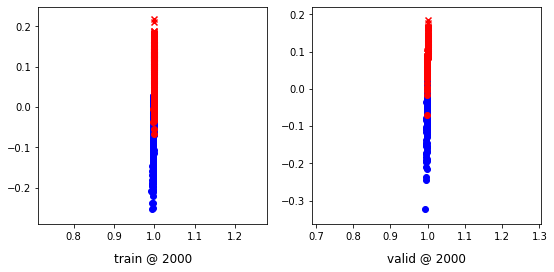

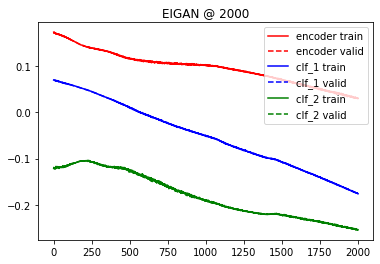

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.012059 	 1.013529 	 0.6285
200 	 0.646982 	 0.633908 	 0.8885
400 	 0.308388 	 0.299843 	 0.9102
600 	 0.286768 	 0.285808 	 0.9102
800 	 0.285690 	 0.286350 	 0.9102
1000 	 0.285554 	 0.286530 	 0.9102
Accuracy: 0.9102167182662538
Error Rate: 0.08978328173374613
F1 Score: 0.8806584362139918
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.913312693498452
Error Rate: 0.08668730650154799
F1 Score: 0.8870967741935484
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9071207430340558
Error Rate: 0.09

  0%|          | 3/2001 [00:00<01:38, 20.22it/s]

tensor sizes => torch.Size([2044, 2]) torch.Size([511, 2]) torch.Size([2044, 2]) torch.Size([511, 2]) torch.Size([2044, 2]) torch.Size([511, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.72110236 	 0.71726680 	 1.05790138 	 1.05754161 	 1.03012955 	 1.03342199


 25%|██▌       | 504/2001 [00:36<01:28, 16.84it/s]

500 	 0.44520867 	 0.43511158 	 0.62942690 	 0.62245697 	 0.87744379 	 0.88049257


 50%|█████     | 1003/2001 [01:14<01:14, 13.32it/s]

1000 	 0.45661616 	 0.43082285 	 0.61918569 	 0.58533412 	 0.85570467 	 0.84765846


 75%|███████▌  | 1502/2001 [01:50<00:33, 15.06it/s]

1500 	 0.45598668 	 0.42646664 	 0.60104662 	 0.57949430 	 0.83824778 	 0.84617484


100%|██████████| 2001/2001 [02:26<00:00, 13.62it/s]


2000 	 0.47068536 	 0.43035656 	 0.62976307 	 0.58442754 	 0.85226923 	 0.84721816


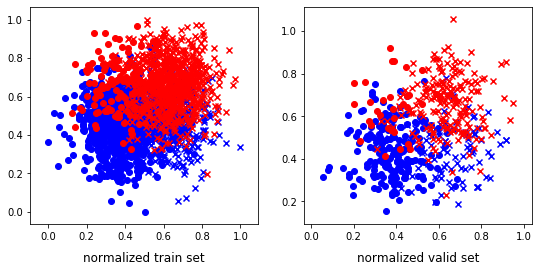

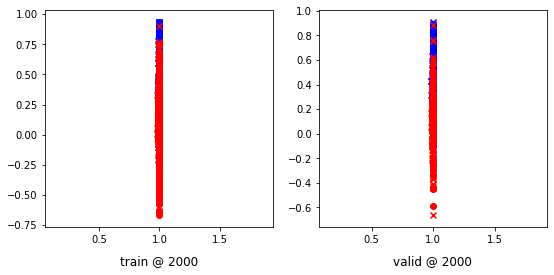

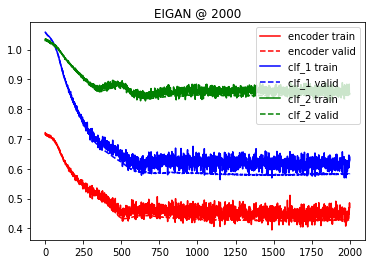

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 1/2001 [00:00<04:15,  7.82it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.00884590 	 -0.00876564 	 -0.03115320 	 -0.03104712 	 0.05082548 	 0.05073019


 25%|██▌       | 503/2001 [00:32<01:41, 14.81it/s]

500 	 -0.15250954 	 -0.15129988 	 -0.18776123 	 -0.18612053 	 0.01236481 	 0.01339708


 50%|█████     | 1003/2001 [01:05<01:17, 12.81it/s]

1000 	 -0.25402045 	 -0.25318035 	 -0.30945945 	 -0.30860069 	 -0.03545080 	 -0.03541525


 75%|███████▌  | 1504/2001 [01:40<00:32, 15.09it/s]

1500 	 -0.35748544 	 -0.35783753 	 -0.43717960 	 -0.43785062 	 -0.08230092 	 -0.08286589


100%|██████████| 2001/2001 [02:13<00:00, 14.95it/s]


2000 	 -0.47918454 	 -0.47958082 	 -0.59212399 	 -0.59243542 	 -0.13606431 	 -0.13593838


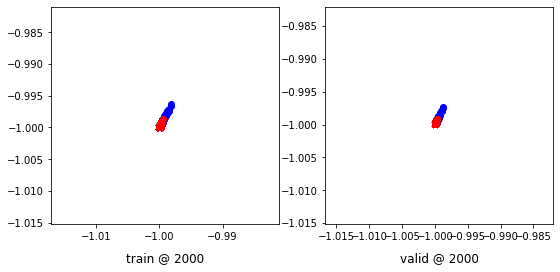

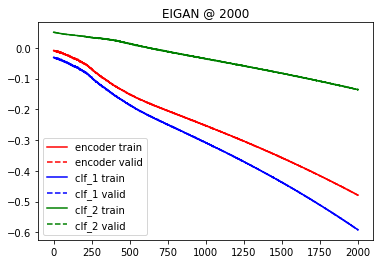

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.066090 	 1.066408 	 0.4384
200 	 0.773748 	 0.778986 	 0.7847
400 	 0.546748 	 0.539087 	 0.8337
600 	 0.538489 	 0.526482 	 0.8297
800 	 0.537846 	 0.525481 	 0.8297
1000 	 0.537465 	 0.524754 	 0.8297
Accuracy: 0.8297455968688845
Error Rate: 0.17025440313111545
F1 Score: 0.8062360801781737
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8258317025440313
Error Rate: 0.17416829745596868
F1 Score: 0.8052516411378556
SVM
--------------------------------------------------------------------------------
Accuracy: 0.8238747553816047
Error Rate: 0.1

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.8395303326810176
Error Rate: 0.16046966731898238
F1 Score: 0.8530465949820789
VAR1: 0.4, VAR2: 0.8, TRIAL: 9
X, y_1, y2
(1980, 2) (1980, 1) (1980, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1584, 2) (396, 2) (1584, 1) (396, 1) (1584, 1) (396, 1)
class weights => w1, w2 [11.   1.1] [2.17881706 1.84830805]
tensor sizes => torch.Size([1584, 2]) torch.Size([396, 2]) torch.Size([1584, 2]) torch.Size([396, 2]) torch.Size([1584, 2]) torch.Size([396, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.68350196 	 0.67284477 	 1.03914797 	 1.02982235 	 1.04916203 	 1.05012476


 25%|██▌       | 504/2001 [00:32<01:28, 16.89it/s]

500 	 0.39643902 	 0.37779301 	 0.64588743 	 0.62045556 	 0.94263655 	 0.93580973


 50%|█████     | 1004/2001 [01:04<00:55, 17.96it/s]

1000 	 0.38920444 	 0.35394937 	 0.64555383 	 0.58937156 	 0.94955719 	 0.92856938


 75%|███████▌  | 1503/2001 [01:35<00:30, 16.21it/s]

1500 	 0.40958267 	 0.35014558 	 0.64579403 	 0.58400822 	 0.92957330 	 0.92700982


100%|██████████| 2001/2001 [02:06<00:00, 15.81it/s]


2000 	 0.32511508 	 0.34786481 	 0.56501657 	 0.58153772 	 0.93311667 	 0.92682010


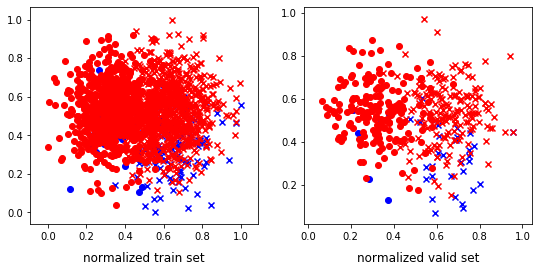

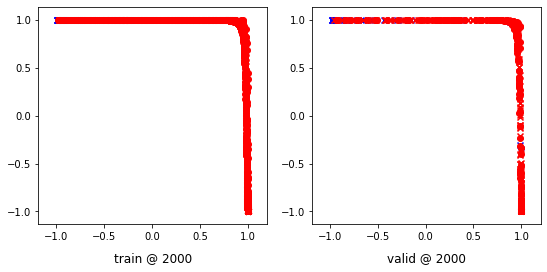

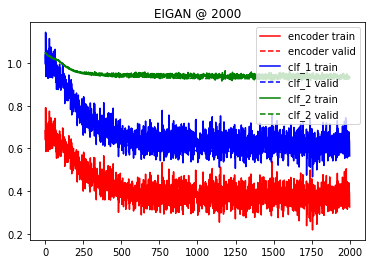

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:40, 19.94it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.04140811 	 0.03979294 	 0.00648602 	 0.00521294 	 0.01325456 	 0.01404301


 25%|██▌       | 502/2001 [00:30<01:41, 14.83it/s]

500 	 -0.00730396 	 -0.00698310 	 -0.05274123 	 -0.05281619 	 -0.01315919 	 -0.01408663


 50%|█████     | 1004/2001 [01:02<01:02, 15.84it/s]

1000 	 -0.02287194 	 -0.02059177 	 -0.10412586 	 -0.10384259 	 -0.08504865 	 -0.08853221


 75%|███████▌  | 1503/2001 [01:33<00:33, 15.07it/s]

1500 	 -0.02057174 	 -0.02030700 	 -0.16010134 	 -0.15719907 	 -0.17353636 	 -0.16998927


100%|██████████| 2001/2001 [02:03<00:00, 16.19it/s]


2000 	 -0.00550808 	 -0.00398962 	 -0.20595281 	 -0.20649090 	 -0.24770996 	 -0.25000143


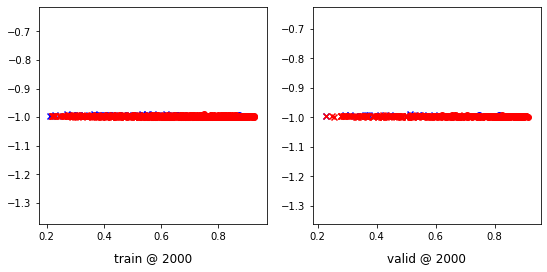

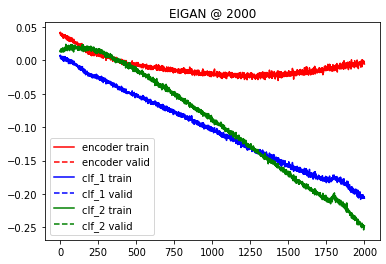

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.117542 	 1.116204 	 0.0909
200 	 0.680618 	 0.655370 	 0.9091
400 	 0.613314 	 0.570822 	 0.9116
600 	 0.607163 	 0.560963 	 0.9141
800 	 0.606259 	 0.558841 	 0.9116
1000 	 0.606050 	 0.558221 	 0.9116
Accuracy: 0.9116161616161617
Error Rate: 0.08838383838383838
F1 Score: 0.9511854951185496
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7853535353535354
Error Rate: 0.21464646464646464
F1 Score: 0.8694316436251921
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9090909090909091
Error Rate: 0.0

  0%|          | 2/2001 [00:00<01:54, 17.44it/s]

tensor sizes => torch.Size([2014, 2]) torch.Size([504, 2]) torch.Size([2014, 2]) torch.Size([504, 2]) torch.Size([2014, 2]) torch.Size([504, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.66124403 	 0.66151655 	 1.03047943 	 1.03114188 	 1.06249809 	 1.06277251


 25%|██▌       | 504/2001 [00:35<01:42, 14.58it/s]

500 	 -0.06311938 	 -0.07549664 	 0.19838950 	 0.18555602 	 0.95470577 	 0.95419985


 50%|█████     | 1003/2001 [01:11<01:15, 13.29it/s]

1000 	 -0.21089083 	 -0.22475410 	 0.05063413 	 0.03618407 	 0.95462704 	 0.95408535


 75%|███████▌  | 1504/2001 [01:48<00:31, 15.55it/s]

1500 	 -0.22619742 	 -0.24270637 	 0.03423489 	 0.01817642 	 0.95363241 	 0.95402998


100%|██████████| 2001/2001 [02:23<00:00, 13.96it/s]


2000 	 -0.24038337 	 -0.24697280 	 0.02179299 	 0.01402133 	 0.95533305 	 0.95414132


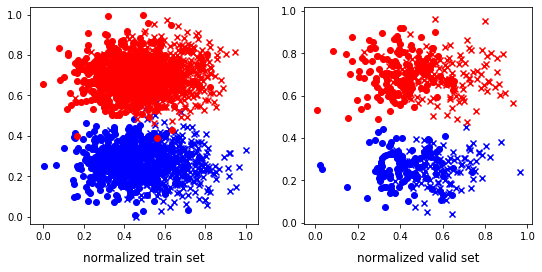

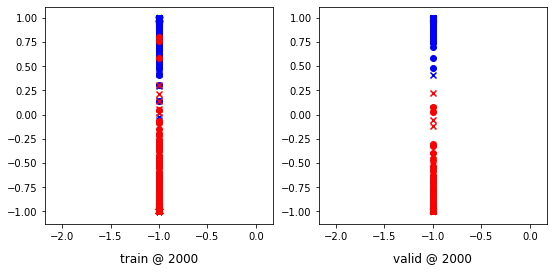

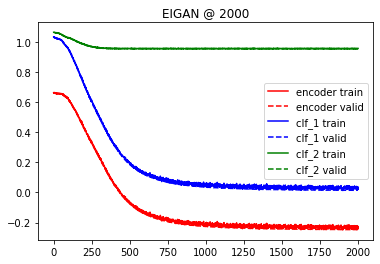

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<01:43, 19.30it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.17450060 	 0.17323038 	 0.14865144 	 0.14739607 	 0.03930958 	 0.03926945


 25%|██▌       | 503/2001 [00:34<01:47, 13.97it/s]

500 	 0.09950799 	 0.09843038 	 0.05197695 	 0.05106801 	 -0.01797145 	 -0.01762898


 50%|█████     | 1004/2001 [01:08<01:04, 15.44it/s]

1000 	 0.03620448 	 0.03986188 	 -0.04454743 	 -0.04197774 	 -0.08414399 	 -0.08607626


 75%|███████▌  | 1504/2001 [01:44<00:28, 17.15it/s]

1500 	 -0.00132303 	 -0.00093509 	 -0.14822967 	 -0.14859597 	 -0.18328249 	 -0.18426669


100%|██████████| 2001/2001 [02:19<00:00, 14.38it/s]


2000 	 -0.01537283 	 -0.02207828 	 -0.26111463 	 -0.26582888 	 -0.29572329 	 -0.29371104


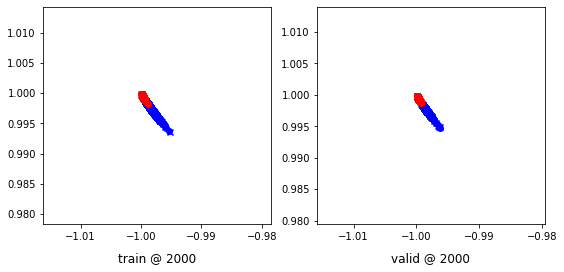

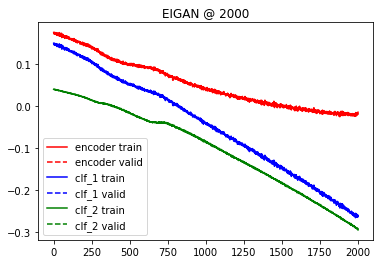

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.043473 	 1.044151 	 0.5694
200 	 0.432303 	 0.420261 	 0.9881
400 	 0.076117 	 0.063491 	 0.9980
600 	 0.042336 	 0.030644 	 0.9980
800 	 0.030636 	 0.018227 	 0.9980
1000 	 0.027713 	 0.014537 	 0.9980
Accuracy: 0.998015873015873
Error Rate: 0.001984126984126984
F1 Score: 0.9982547993019197
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.998015873015873
Error Rate: 0.001984126984126984
F1 Score: 0.9982547993019197
SVM
--------------------------------------------------------------------------------
Accuracy: 0.998015873015873
Error Rate: 0.00

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.4861111111111111
Error Rate: 0.5138888888888888
F1 Score: 0.6542056074766355
VAR1: 0.6, VAR2: 0.4, TRIAL: 9
X, y_1, y2
(1396, 2) (1396, 1) (1396, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1116, 2) (280, 2) (1116, 1) (280, 1) (1116, 1) (280, 1)
class weights => w1, w2 [1.69090909 2.44736842] [1.72488408 2.37953092]
tensor sizes => torch.Size([1116, 2]) torch.Size([280, 2]) torch.Size([1116, 2]) torch.Size([280, 2]) torch.Size([1116, 2]) torch.Size([280, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.70976651 	 0.69241190 	 1.04679370 	 1.02525091 	 1.03023958 	 1.02598619


 25%|██▌       | 503/2001 [00:28<01:20, 18.68it/s]

500 	 0.15019670 	 0.18529999 	 0.39191613 	 0.44002914 	 0.93673283 	 0.94787633


 50%|█████     | 1003/2001 [00:56<00:56, 17.65it/s]

1000 	 0.08236343 	 0.09927753 	 0.30750561 	 0.35345635 	 0.91958141 	 0.94732600


 75%|███████▌  | 1504/2001 [01:24<00:29, 16.67it/s]

1500 	 0.08142680 	 0.09097958 	 0.34956461 	 0.34850532 	 0.96408314 	 0.95067292


100%|██████████| 2001/2001 [01:51<00:00, 17.88it/s]


2000 	 -0.00906393 	 0.08257857 	 0.25035000 	 0.33638290 	 0.95244086 	 0.94695151


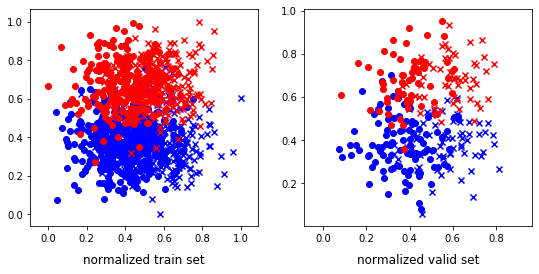

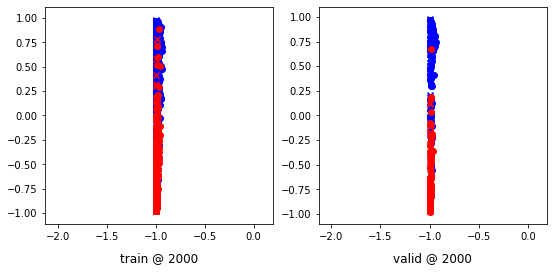

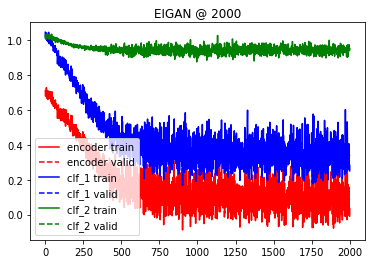

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:21, 24.37it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.11387499 	 0.11431254 	 0.05404985 	 0.05344878 	 -0.04454362 	 -0.04670582


 25%|██▌       | 505/2001 [00:27<01:23, 17.90it/s]

500 	 0.04682750 	 0.04081869 	 -0.04449351 	 -0.05038818 	 -0.10217708 	 -0.10200476


 50%|█████     | 1005/2001 [00:54<00:50, 19.69it/s]

1000 	 -0.00559506 	 -0.00154552 	 -0.14662129 	 -0.14121309 	 -0.17553407 	 -0.17372124


 75%|███████▌  | 1503/2001 [01:21<00:28, 17.26it/s]

1500 	 -0.03122516 	 -0.02852966 	 -0.24290910 	 -0.24128816 	 -0.26009113 	 -0.26125750


100%|██████████| 2001/2001 [01:48<00:00, 18.48it/s]


2000 	 -0.04547340 	 -0.03663868 	 -0.36680603 	 -0.35802498 	 -0.36686209 	 -0.36690944


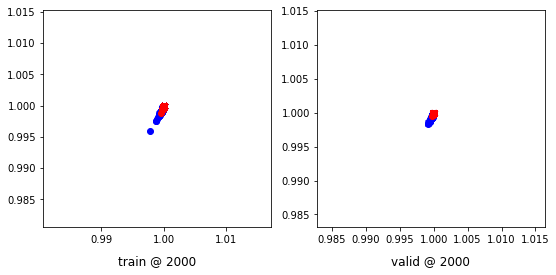

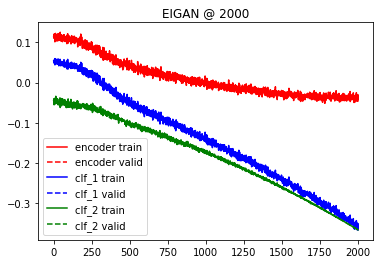

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.022016 	 1.021203 	 0.5929
200 	 0.491712 	 0.502806 	 0.8964
400 	 0.343605 	 0.333562 	 0.9000
600 	 0.341591 	 0.328041 	 0.9000
800 	 0.341421 	 0.327703 	 0.9000
1000 	 0.341335 	 0.327683 	 0.9000
Accuracy: 0.9
Error Rate: 0.1
F1 Score: 0.8813559322033898
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9035714285714286
Error Rate: 0.09642857142857143
F1 Score: 0.8879668049792531
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9
Error Rate: 0.1
F1 Score: 0.8833333333333334
----------------

  0%|          | 1/2001 [00:00<04:25,  7.53it/s]

 [2.21561668 1.82262774]
tensor sizes => torch.Size([2497, 2]) torch.Size([625, 2]) torch.Size([2497, 2]) torch.Size([625, 2]) torch.Size([2497, 2]) torch.Size([625, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.65913904 	 0.65783703 	 1.01201653 	 1.01149487 	 1.04619241 	 1.04680502


 25%|██▌       | 503/2001 [00:48<02:18, 10.83it/s]

500 	 0.39992642 	 0.33076650 	 0.66801471 	 0.59214622 	 0.96229267 	 0.95452690


 50%|█████     | 1002/2001 [01:37<01:41,  9.85it/s]

1000 	 0.32839394 	 0.31553262 	 0.59063721 	 0.57675904 	 0.95617270 	 0.95437360


 75%|███████▌  | 1503/2001 [02:25<00:43, 11.57it/s]

1500 	 0.34128475 	 0.31324881 	 0.60251230 	 0.57475650 	 0.95437318 	 0.95465487


100%|██████████| 2001/2001 [03:13<00:00, 10.35it/s]

2000 	 0.32481200 	 0.31261802 	 0.58130676 	 0.57389075 	 0.95028657 	 0.95441991


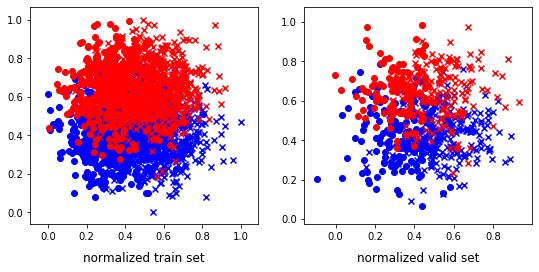

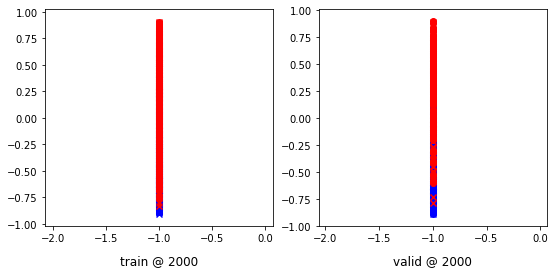

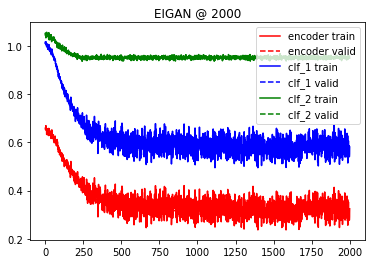

  0%|          | 0/2001 [00:00<?, ?it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.03496648 	 0.03663007 	 -0.03208880 	 -0.03200100 	 -0.05885699 	 -0.06197532


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
 25%|██▌       | 503/2001 [00:46<02:19, 10.74it/s]

500 	 -0.01092984 	 -0.01148063 	 -0.13971698 	 -0.13764368 	 -0.15886045 	 -0.15519439


 50%|█████     | 1002/2001 [01:33<01:27, 11.45it/s]

1000 	 -0.01140200 	 -0.00464332 	 -0.23787096 	 -0.23220649 	 -0.27588609 	 -0.27703583


 75%|███████▌  | 1501/2001 [02:20<00:46, 10.65it/s]

1500 	 0.00988513 	 0.00396019 	 -0.29341570 	 -0.30237970 	 -0.35072494 	 -0.35347977


100%|██████████| 2001/2001 [03:07<00:00, 10.67it/s]


2000 	 0.04469401 	 0.06741482 	 -0.44689465 	 -0.43697363 	 -0.50113368 	 -0.51020312


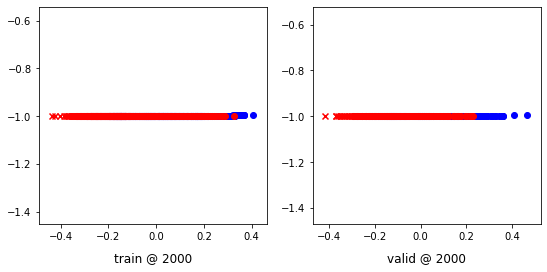

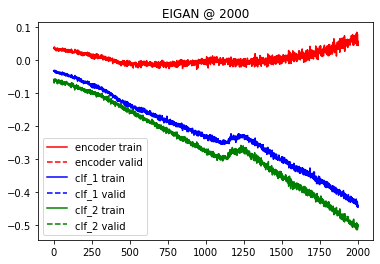

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.049400 	 1.049795 	 0.5808
200 	 0.729748 	 0.733394 	 0.7936
400 	 0.582901 	 0.574541 	 0.8080
600 	 0.582387 	 0.573729 	 0.8064
800 	 0.582277 	 0.573484 	 0.8064
1000 	 0.582223 	 0.573263 	 0.8064
Accuracy: 0.8064
Error Rate: 0.1936
F1 Score: 0.7703984819734346
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.8096
Error Rate: 0.1904
F1 Score: 0.7808471454880295
SVM
--------------------------------------------------------------------------------
Accuracy: 0.808
Error Rate: 0.192
F1 Score: 0.7752808988764045
-------------------------------

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.6944
Error Rate: 0.3056
F1 Score: 0.7336122733612274
VAR1: 0.6, VAR2: 0.8, TRIAL: 9
X, y_1, y2
(2945, 2) (2945, 1) (2945, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2356, 2) (589, 2) (2356, 1) (589, 1) (2356, 1) (589, 1)
class weights => w1, w2 [1.59404601 2.6833713 ] [1.91856678 2.08865248]
tensor sizes => torch.Size([2356, 2]) torch.Size([589, 2]) torch.Size([2356, 2]) torch.Size([589, 2]) torch.Size([2356, 2]) torch.Size([589, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid


  0%|          | 3/2001 [00:00<04:14,  7.85it/s]

0 	 0.65332198 	 0.66327035 	 1.01418293 	 1.02832198 	 1.05404270 	 1.05819881


 25%|██▌       | 502/2001 [00:47<02:35,  9.65it/s]

500 	 0.46197623 	 0.43827564 	 0.71502346 	 0.70037657 	 0.94667447 	 0.95524812


 50%|█████     | 1002/2001 [01:35<01:39, 10.01it/s]

1000 	 0.44564217 	 0.44010419 	 0.70346820 	 0.70336944 	 0.95132703 	 0.95641243


 75%|███████▌  | 1502/2001 [02:23<00:44, 11.28it/s]

1500 	 0.52141720 	 0.43989575 	 0.77924168 	 0.70291495 	 0.95095330 	 0.95616639


100%|██████████| 2001/2001 [03:10<00:00, 10.49it/s]

2000 	 0.48710251 	 0.44153851 	 0.73571151 	 0.70301598 	 0.94173241 	 0.95462465


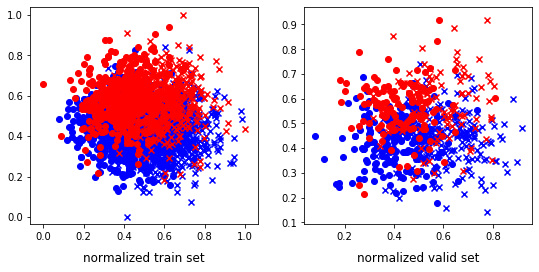

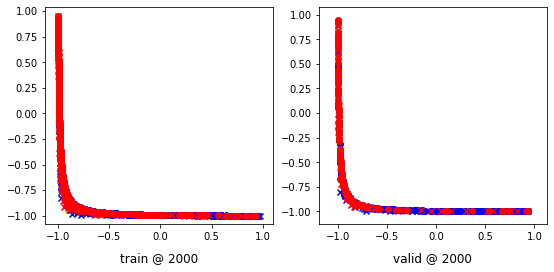

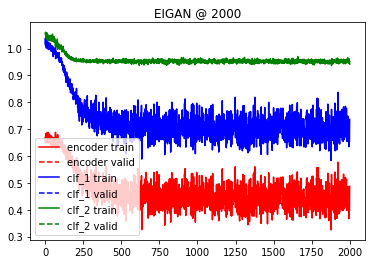

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 1/2001 [00:00<04:29,  7.41it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.00056479 	 0.00097258 	 -0.06555666 	 -0.06522213 	 -0.05491016 	 -0.05728332


 25%|██▌       | 502/2001 [00:47<02:26, 10.22it/s]

500 	 -0.05804987 	 -0.05801341 	 -0.18528423 	 -0.18526463 	 -0.15669134 	 -0.15672287


 50%|█████     | 1003/2001 [01:33<01:44,  9.51it/s]

1000 	 -0.07605909 	 -0.07157096 	 -0.32038549 	 -0.31715497 	 -0.29429370 	 -0.29556435


 75%|███████▌  | 1502/2001 [02:19<00:45, 11.04it/s]

1500 	 -0.02715808 	 -0.02554968 	 -0.41835508 	 -0.41775557 	 -0.42545170 	 -0.42626345


100%|██████████| 2001/2001 [03:04<00:00, 10.82it/s]


2000 	 0.09797275 	 0.08507490 	 -0.56194681 	 -0.56228000 	 -0.61235422 	 -0.60458368


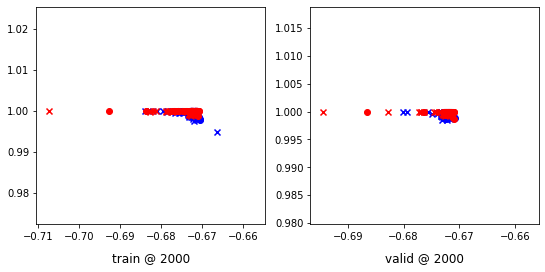

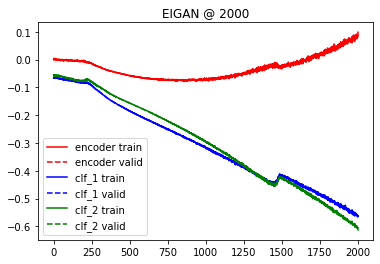

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.017933 	 1.017340 	 0.6282
200 	 0.801983 	 0.800484 	 0.7691
400 	 0.708583 	 0.707135 	 0.7572
600 	 0.707848 	 0.705051 	 0.7572
800 	 0.706870 	 0.703343 	 0.7589
1000 	 0.706437 	 0.702364 	 0.7606
Accuracy: 0.7606112054329371
Error Rate: 0.23938879456706283
F1 Score: 0.6697892271662764
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.767402376910017
Error Rate: 0.23259762308998302
F1 Score: 0.702819956616052
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7623089983022071
Error Rate: 0.237

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.5212224108658744
Error Rate: 0.47877758913412566
F1 Score: 0.0
VAR1: 0.8, VAR2: 0.2, TRIAL: 9
X, y_1, y2
(2257, 2) (2257, 1) (2257, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1805, 2) (452, 2) (1805, 1) (452, 1) (1805, 1) (452, 1)
class weights => w1, w2 [1.6853408  2.45912807] [1.52578191 2.90192926]
tensor sizes => torch.Size([1805, 2]) torch.Size([452, 2]) torch.Size([1805, 2]) torch.Size([452, 2]) torch.Size([1805, 2]) torch.Size([452, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.74840856 	 0.74903178 	 1.07114577 	 1.07147586 	 1.01601684 	 1.01559126


 25%|██▌       | 503/2001 [00:34<01:44, 14.33it/s]

500 	 0.13260733 	 0.14192489 	 0.23478207 	 0.22266552 	 0.79532194 	 0.77388781


 50%|█████     | 1003/2001 [01:09<01:11, 14.03it/s]

1000 	 -0.00167447 	 -0.03857911 	 0.05824257 	 0.04010010 	 0.75307679 	 0.77182639


 75%|███████▌  | 1503/2001 [01:43<00:32, 15.30it/s]

1500 	 -0.02078889 	 -0.05941011 	 0.04146162 	 0.02330743 	 0.75540876 	 0.77586472


100%|██████████| 2001/2001 [02:15<00:00, 14.77it/s]


2000 	 -0.04241483 	 -0.06682754 	 0.02519645 	 0.02547419 	 0.76078379 	 0.78544891


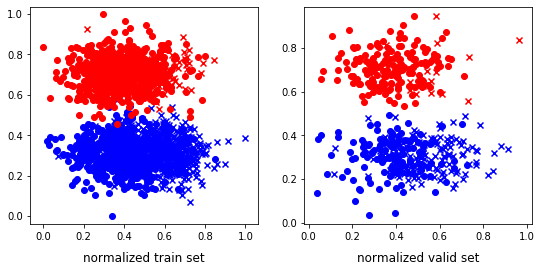

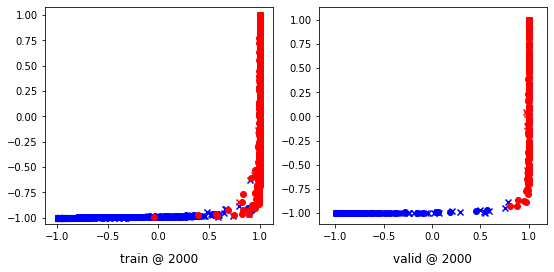

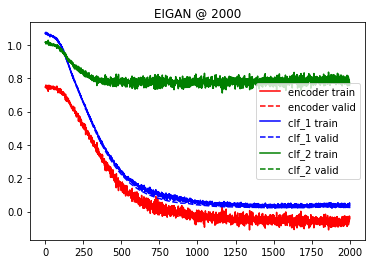

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<01:58, 16.85it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.00337783 	 -0.00299954 	 -0.06226250 	 -0.06211548 	 -0.04262503 	 -0.04313768


 25%|██▌       | 503/2001 [00:32<01:23, 17.91it/s]

500 	 -0.04004490 	 -0.03979617 	 -0.12031696 	 -0.11971887 	 -0.08328731 	 -0.08270601


 50%|█████     | 1003/2001 [01:04<01:04, 15.40it/s]

1000 	 -0.08241438 	 -0.08281636 	 -0.20074590 	 -0.20281960 	 -0.14397331 	 -0.14641483


 75%|███████▌  | 1504/2001 [01:36<00:29, 16.84it/s]

1500 	 -0.10381481 	 -0.10259840 	 -0.28652433 	 -0.28479740 	 -0.22744341 	 -0.22684777


100%|██████████| 2001/2001 [02:08<00:00, 15.59it/s]


2000 	 -0.11797798 	 -0.11829366 	 -0.31723133 	 -0.31795165 	 -0.24637216 	 -0.24683103


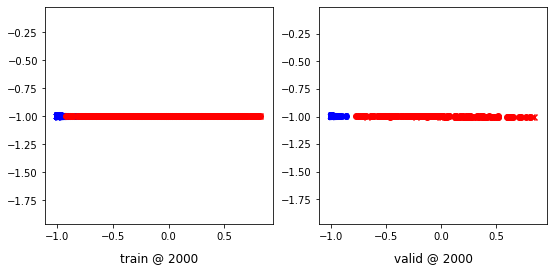

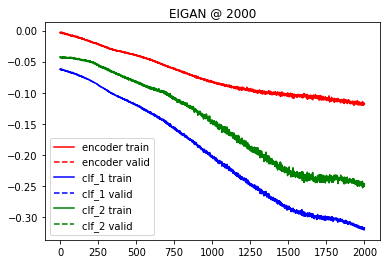

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.051129 	 1.051283 	 0.4071
200 	 0.262137 	 0.255304 	 1.0000
400 	 0.053567 	 0.041980 	 1.0000
600 	 0.035244 	 0.021084 	 1.0000
800 	 0.030060 	 0.014274 	 1.0000
1000 	 0.028039 	 0.011094 	 1.0000
Accuracy: 1.0
Error Rate: 0.0
F1 Score: 1.0
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 1.0
Error Rate: 0.0
F1 Score: 1.0
SVM
--------------------------------------------------------------------------------
Accuracy: 1.0
Error Rate: 0.0
F1 Score: 1.0
--------------------------------------------------------------------------------
ALLY: EIGAN

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.6946902654867256
Error Rate: 0.3053097345132743
F1 Score: 0.6567164179104478
VAR1: 0.8, VAR2: 0.4, TRIAL: 9
X, y_1, y2
(2581, 2) (2581, 1) (2581, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2064, 2) (517, 2) (2064, 1) (517, 1) (2064, 1) (517, 1)
class weights => w1, w2 [2.61596958 1.61882353] [1.5518797 2.8119891]
tensor sizes => torch.Size([2064, 2]) torch.Size([517, 2]) torch.Size([2064, 2]) torch.Size([517, 2]) torch.Size([2064, 2]) torch.Size([517, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.71756923 	 0.71717072 	 1.06181395 	 1.05539501 	 1.03785861 	 1.03137147


 25%|██▌       | 502/2001 [00:45<02:27, 10.17it/s]

500 	 0.51317036 	 0.33496255 	 0.46492776 	 0.37525278 	 0.64496553 	 0.73343742


 50%|█████     | 1002/2001 [01:32<01:30, 11.09it/s]

1000 	 0.60215539 	 0.28372085 	 0.53073680 	 0.33810133 	 0.62341684 	 0.74752766


 75%|███████▌  | 1503/2001 [02:18<00:46, 10.63it/s]

1500 	 0.36095870 	 0.26418167 	 0.55547261 	 0.31820256 	 0.89150351 	 0.74716806


100%|██████████| 2001/2001 [03:04<00:00, 10.82it/s]


2000 	 0.16081388 	 0.26334840 	 0.20559593 	 0.31479365 	 0.73941839 	 0.74459243


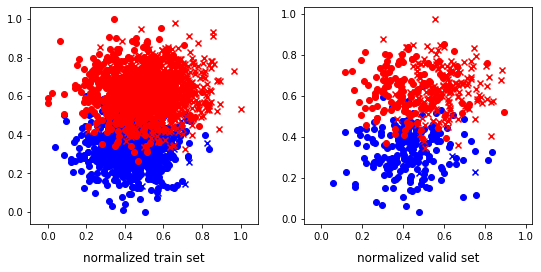

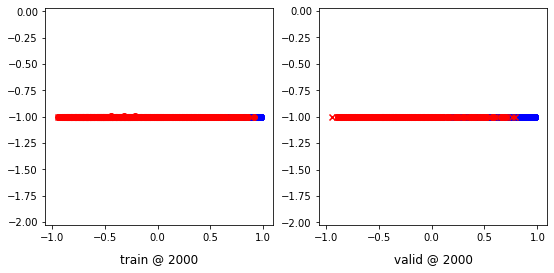

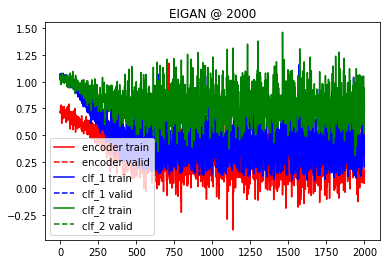

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:24, 13.84it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.13229021 	 0.12018348 	 0.08233486 	 0.07079527 	 -0.02333910 	 -0.02223461


 25%|██▌       | 503/2001 [00:45<01:59, 12.58it/s]

500 	 0.04011261 	 0.04155122 	 -0.06143458 	 -0.06112015 	 -0.11866045 	 -0.12042376


 50%|█████     | 1002/2001 [01:30<01:27, 11.43it/s]

1000 	 0.08671919 	 0.04718629 	 -0.13307644 	 -0.14814141 	 -0.26882362 	 -0.24195893


 75%|███████▌  | 1502/2001 [02:16<00:45, 10.89it/s]

1500 	 0.04203159 	 0.07264370 	 -0.12523428 	 -0.12408496 	 -0.20899576 	 -0.24354105


100%|██████████| 2001/2001 [03:01<00:00, 11.02it/s]


2000 	 0.11388399 	 0.09835891 	 -0.16694227 	 -0.17431243 	 -0.32992601 	 -0.32217941


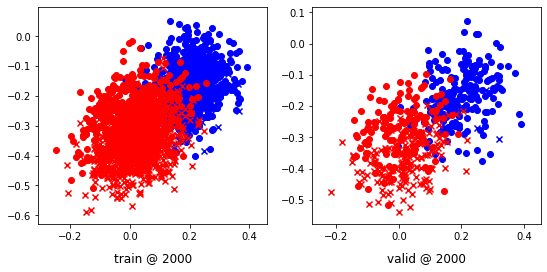

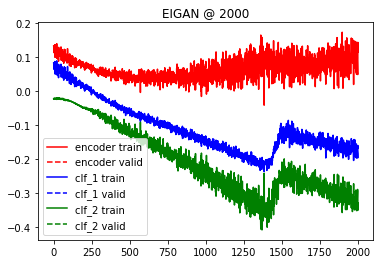

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.073730 	 1.073745 	 0.3830
200 	 0.651537 	 0.630964 	 0.9130
400 	 0.366163 	 0.307818 	 0.9226
600 	 0.353763 	 0.286387 	 0.9265
800 	 0.353196 	 0.284291 	 0.9265
1000 	 0.353096 	 0.283946 	 0.9265
Accuracy: 0.9264990328820116
Error Rate: 0.0735009671179884
F1 Score: 0.9389067524115755
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.9187620889748549
Error Rate: 0.08123791102514506
F1 Score: 0.9320388349514563
SVM
--------------------------------------------------------------------------------
Accuracy: 0.9284332688588007
Error Rate: 0.07

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.839458413926499
Error Rate: 0.16054158607350097
F1 Score: 0.7738419618528609
VAR1: 0.8, VAR2: 0.6, TRIAL: 9
X, y_1, y2
(1511, 2) (1511, 1) (1511, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(1208, 2) (303, 2) (1208, 1) (303, 1) (1208, 1) (303, 1)
class weights => w1, w2 [2.33655706 1.74819103] [2.62608696 1.61497326]
tensor sizes => torch.Size([1208, 2]) torch.Size([303, 2]) torch.Size([1208, 2]) torch.Size([303, 2]) torch.Size([1208, 2]) torch.Size([303, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.73333406 	 0.72223985 	 1.04946995 	 1.04476666 	 1.00939143 	 1.01567400


 25%|██▌       | 504/2001 [00:29<01:32, 16.16it/s]

500 	 0.43071425 	 0.50671560 	 0.69141388 	 0.74553430 	 0.95467079 	 0.93196589


 50%|█████     | 1003/2001 [00:59<01:01, 16.35it/s]

1000 	 0.34645480 	 0.46822101 	 0.57550347 	 0.71372205 	 0.92272735 	 0.93864822


 75%|███████▌  | 1503/2001 [01:29<00:30, 16.49it/s]

1500 	 0.38344961 	 0.47586912 	 0.57117349 	 0.70938045 	 0.88080513 	 0.92665851


100%|██████████| 2001/2001 [01:57<00:00, 16.96it/s]


2000 	 0.35306156 	 0.48527974 	 0.54304761 	 0.71587533 	 0.88294858 	 0.92374277


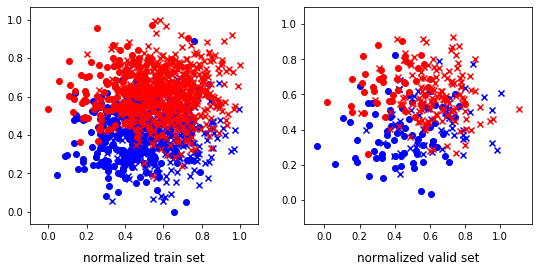

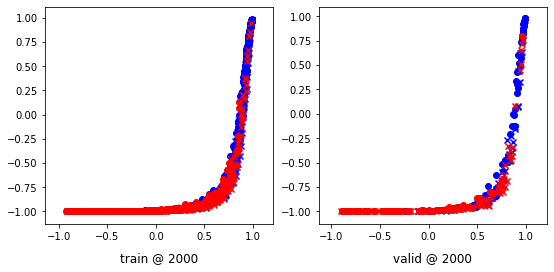

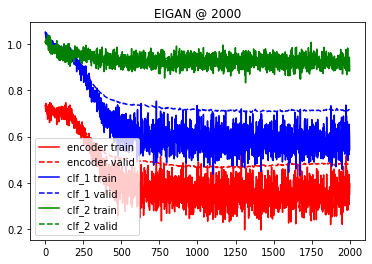

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 3/2001 [00:00<01:31, 21.89it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.00673277 	 0.00305671 	 -0.01932777 	 -0.02331922 	 0.03860708 	 0.03759331


 25%|██▌       | 503/2001 [00:28<01:30, 16.62it/s]

500 	 -0.03816241 	 -0.03902190 	 -0.09702652 	 -0.09845622 	 -0.04258338 	 -0.04379155


 50%|█████     | 1004/2001 [00:57<00:52, 19.14it/s]

1000 	 -0.06723312 	 -0.06677283 	 -0.19561423 	 -0.19339935 	 -0.15830271 	 -0.15584619


 75%|███████▌  | 1504/2001 [01:25<00:26, 18.56it/s]

1500 	 -0.07462277 	 -0.07021263 	 -0.29100555 	 -0.29086688 	 -0.26516956 	 -0.26973850


100%|██████████| 2001/2001 [01:54<00:00, 17.46it/s]


2000 	 -0.03010264 	 -0.04098451 	 -0.40168217 	 -0.40174383 	 -0.40957257 	 -0.40063244


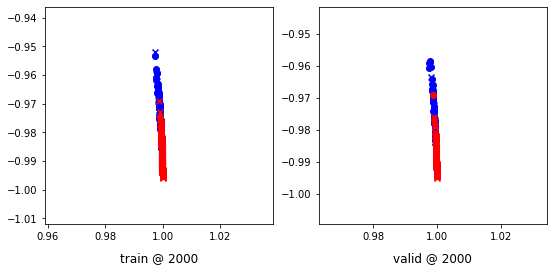

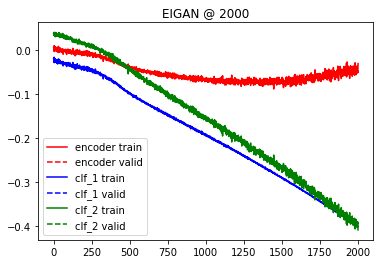

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.067985 	 1.068604 	 0.5710
200 	 0.799074 	 0.819317 	 0.7690
400 	 0.572534 	 0.708297 	 0.7525
600 	 0.571618 	 0.715377 	 0.7525
800 	 0.571560 	 0.715272 	 0.7525
1000 	 0.571513 	 0.715228 	 0.7525
Accuracy: 0.7524752475247525
Error Rate: 0.24752475247524752
F1 Score: 0.7838616714697408
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7392739273927392
Error Rate: 0.2607260726072607
F1 Score: 0.7683284457478007
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7524752475247525
Error Rate: 0.24

  0%|          | 0/2001 [00:00<?, ?it/s]

Accuracy: 0.6204620462046204
Error Rate: 0.3795379537953795
F1 Score: 0.7657841140529531
VAR1: 0.8, VAR2: 0.8, TRIAL: 9
X, y_1, y2
(2807, 2) (2807, 1) (2807, 1)
X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid
(2245, 2) (562, 2) (2245, 1) (562, 1) (2245, 1) (562, 1)
class weights => w1, w2 [1.44465894 3.24891462] [1.82668836 2.20964567]
tensor sizes => torch.Size([2245, 2]) torch.Size([562, 2]) torch.Size([2245, 2]) torch.Size([562, 2]) torch.Size([2245, 2]) torch.Size([562, 2])
--------------------------------------------------------------------------------
EIGAN Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 0.62058735 	 0.62947166 	 1.00734949 	 1.01430523 	 1.08005857 	 1.07798076


 25%|██▌       | 502/2001 [00:47<02:06, 11.83it/s]

500 	 0.45488042 	 0.51318657 	 0.70629853 	 0.76867014 	 0.94496751 	 0.94863075


 50%|█████     | 1002/2001 [01:35<01:36, 10.35it/s]

1000 	 0.39138198 	 0.50645953 	 0.62640387 	 0.76008320 	 0.92955053 	 0.94677085


 75%|███████▌  | 1501/2001 [02:21<00:46, 10.65it/s]

1500 	 0.39585876 	 0.50595474 	 0.64469188 	 0.75933444 	 0.94217426 	 0.94652689


100%|██████████| 2001/2001 [03:08<00:00, 10.62it/s]


2000 	 0.40000695 	 0.50283730 	 0.66794133 	 0.75546300 	 0.96099854 	 0.94577289


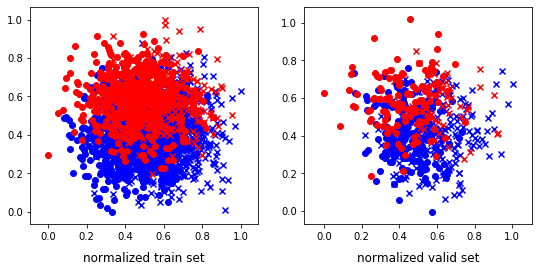

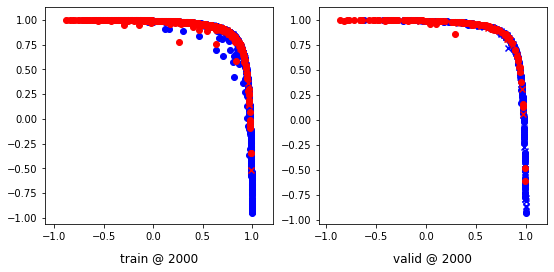

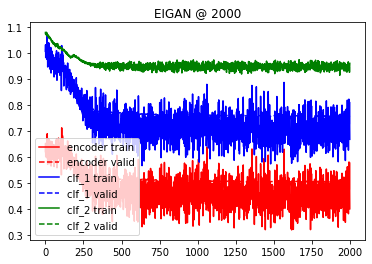

  0%|          | 0/2001 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1975: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn("reduction: 'mean' divides the total loss by both the batch size and the support size."
  0%|          | 2/2001 [00:00<02:19, 14.37it/s]

--------------------------------------------------------------------------------
Bertran Training
--------------------------------------------------------------------------------
epoch 	 encoder_train 	 encoder_valid 	 1_train 	 1_valid 	 2_train 	 2_valid
0 	 -0.00668520 	 -0.00887419 	 -0.04763376 	 -0.04484738 	 -0.00232305 	 0.01033399


 25%|██▌       | 503/2001 [00:45<02:16, 11.01it/s]

500 	 -0.05685412 	 -0.05747841 	 -0.12433096 	 -0.12668455 	 -0.05973446 	 -0.06307060


 50%|█████     | 1003/2001 [01:30<01:28, 11.34it/s]

1000 	 -0.09184463 	 -0.09526348 	 -0.23668250 	 -0.23785189 	 -0.18057545 	 -0.17760880


 75%|███████▌  | 1501/2001 [02:16<00:48, 10.25it/s]

1500 	 -0.12245598 	 -0.11328046 	 -0.36836267 	 -0.36239392 	 -0.29588979 	 -0.29911268


100%|██████████| 2001/2001 [03:02<00:00, 10.95it/s]


2000 	 -0.13034931 	 -0.12646493 	 -0.44884223 	 -0.44216958 	 -0.36435091 	 -0.36187601


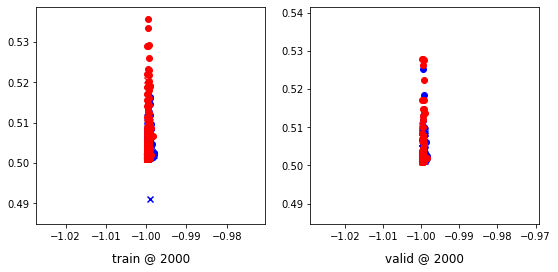

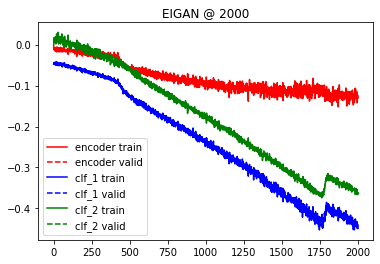

--------------------------------------------------------------------------------
ALLY: BASELINE
--------------------------------------------------------------------------------
MLP
--------------------------------------------------------------------------------
epoch 	 mlp_train 	 mlp_valid 	 v_acc
--------------------------------------------------------------------------------
0 	 1.031290 	 1.032609 	 0.3078
200 	 0.732056 	 0.756087 	 0.7438
400 	 0.705585 	 0.746776 	 0.7367
600 	 0.704586 	 0.746817 	 0.7331
800 	 0.703796 	 0.746486 	 0.7384
1000 	 0.703088 	 0.747043 	 0.7331
Accuracy: 0.7330960854092526
Error Rate: 0.2669039145907473
F1 Score: 0.5856353591160222
Logistic Regression
--------------------------------------------------------------------------------
Accuracy: 0.7259786476868327
Error Rate: 0.27402135231316727
F1 Score: 0.624390243902439
SVM
--------------------------------------------------------------------------------
Accuracy: 0.7295373665480427
Error Rate: 0.270

In [4]:
MAX = 1024
history = {}
NUM_TRIALS = 10
NUM_ITERS = 2001
BATCH_SIZE=1024

for trial in range(NUM_TRIALS):
    for VAR1 in range(2, 9, 2):
        for VAR2 in range(2, 9, 2):
            X, y_1, y_2 = generate_gaussian(VAR1/10, VAR2/10, 1000, 1)
            print('='*80)
            print('VAR1: {}, VAR2: {}, TRIAL: {}'.format(VAR1/10, VAR2/10, trial))
            print('='*80)
            print('X, y_1, y2')
            print(X.shape, y_1.shape, y_2.shape)

            X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid = train_test_split(
            X, y_1, y_2, test_size=0.2, stratify=pd.DataFrame(
                np.concatenate((y_1, y_2), axis=1)
            ))
            print('X_train, X_valid, y_1_train, y_1_valid, y_2_train, y_2_valid')
            print(X_train.shape, X_valid.shape, y_1_train.shape, y_1_valid.shape,
                  y_2_train.shape, y_2_valid.shape)

            w_1 = np.bincount(y_1_train.flatten())
            w_1 = sum(w_1)/w_1
            w_2 = np.bincount(y_2_train.flatten())
            w_2 = sum(w_2)/w_2
            print('class weights => w1, w2', w_1, w_2)

            scaler = MinMaxScaler()
            X_train = scaler.fit_transform(X_train)
            X_valid = scaler.transform(X_valid)

            y_1_train = to_categorical(y_1_train)
            y_2_train = to_categorical(y_2_train)
            y_1_valid = to_categorical(y_1_valid)
            y_2_valid = to_categorical(y_2_valid)

            X_train = torch.Tensor(X_train).to(device)
            y_1_train = torch.Tensor(y_1_train).to(device)
            y_2_train = torch.Tensor(y_2_train).to(device)

            X_valid = torch.Tensor(X_valid).to(device)
            y_1_valid = torch.Tensor(y_1_valid).to(device)
            y_2_valid = torch.Tensor(y_2_valid).to(device)

            fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(9, 4))
            class_plot(X_train.cpu(), np.argmax(y_1_train.cpu(), axis=1), 
                       np.argmax(y_2_train.cpu(), axis=1), 'normalized train set', ax1)
            class_plot(X_valid.cpu(), np.argmax(y_1_valid.cpu(), axis=1), 
                       np.argmax(y_2_valid.cpu(), axis=1), 'normalized valid set', ax2)

            print('tensor sizes =>', X_train.shape, X_valid.shape, 
                  y_1_train.shape, y_1_valid.shape, y_2_train.shape, y_2_valid.shape)

            train_dataset = TensorDataset(X_train, y_1_train, y_2_train)
            train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)

            alpha = 1
            lr_encd = 0.001
            lr_1 = 0.0001
            lr_2 = 0.0001
            n_iter_gan = NUM_ITERS

            input_size = X_train.shape[1]
            hidden_size = input_size*8
            output_size = input_size


            print("-"*80)
            print('EIGAN Training')
            print("-"*80)
            encoder = centralized(
                X_train, X_valid,
                y_1_train, y_1_valid,
                y_2_train, y_2_valid,
                input_size, hidden_size, output_size,
                alpha, lr_encd, lr_1, lr_2, w_1, w_2,
                train_loader, n_iter_gan, device)
            
            encoder.eval()

            alpha = 1
            lr_encd = 0.0001
            lr_1 = 0.00001
            lr_2 = 0.00001
            n_iter_gan = NUM_ITERS
            d_reps = 1

            input_size = X_train.shape[1]
            hidden_size = input_size*8
            output_size = input_size

            print("-"*80)
            print('Bertran Training')
            print("-"*80)
            bertran = bertran_gan(
                X_train, X_valid,
                y_1_train, y_1_valid,
                y_2_train, y_2_valid,
                input_size, hidden_size, output_size,  
                alpha, lr_encd, lr_1, lr_2, 
                train_loader, n_iter_gan, device)
            
            bertran.eval()

            print("-"*80)
            print('ALLY: BASELINE')
            print("-"*80)
            history['{}_{}_{}_{}_{}'.format(VAR1/10, VAR2/10, 'baseline', 'ally', trial)] = metrics(
                None, input_size, hidden_size, output_size,
                X_train, X_valid, y_1_train, y_1_valid, w_1, device)

            print("-"*80)
            print('ALLY: EIGAN')
            print("-"*80)
            history['{}_{}_{}_{}_{}'.format(VAR1/10, VAR2/10, 'eigan', 'ally', trial)] = metrics(
                encoder, input_size, hidden_size, output_size,
                X_train, X_valid, y_1_train, y_1_valid, w_1, device)

            print("-"*80)
            print('ALLY: BERTRAN')
            print("-"*80)
            history['{}_{}_{}_{}_{}'.format(VAR1/10, VAR2/10, 'bertran', 'ally', trial)] = metrics(
                bertran, input_size, hidden_size, output_size,
                X_train, X_valid, y_1_train, y_1_valid, w_1, device)

            print("-"*80)
            print('ADVERSARY:BASELINE')
            print("-"*80)
            history['{}_{}_{}_{}_{}'.format(VAR1/10, VAR2/10, 'baseline', 'advr', trial)] = metrics(
                None, input_size, hidden_size, output_size,
                X_train, X_valid, y_2_train, y_2_valid, w_2, device)

            print("-"*80)
            print('ADVERSARY:EIGAN')
            print("-"*80)
            history['{}_{}_{}_{}_{}'.format(VAR1/10, VAR2/10, 'eigan', 'advr', trial)] = metrics(
                encoder, input_size, hidden_size, output_size,
                X_train, X_valid, y_2_train, y_2_valid, w_2, device)

            print("-"*80)
            print('ADVERSARY:BERTRAN')
            print("-"*80)
            history['{}_{}_{}_{}_{}'.format(VAR1/10, VAR2/10, 'bertran', 'advr', trial)] = metrics(
                bertran, input_size, hidden_size, output_size,
                X_train, X_valid, y_2_train, y_2_valid, w_2, device)
            
    print("Writing trial {} ...".format(trial))
    pkl.dump(history, open('history_centralized_gaussian_5001epocsh_1024batch.pkl', 'wb'))

In [ ]:

pkl.dump(history, open('history_centralized_gaussian_10_runs.pkl', 'wb'))

# Comparisons

In [21]:
baseline_ally = []
baseline_ally_mean = []
baseline_advr = []
baseline_advr_mean = []
eigan_ally = []
eigan_ally_mean = []
eigan_advr = []
eigan_advr_mean = []
bertran_ally = []
bertran_ally_mean = []
bertran_advr = []
bertran_advr_mean = []
ddof = 1

for v1 in range(2, 9, 2):
    for v2 in range(2, 9, 2):
        baseline_iter_ally = []
        baseline_iter_advr = []
        eigan_iter_ally = []
        eigan_iter_advr = []
        bertran_iter_ally = []
        bertran_iter_advr = []
        for run in range(0, 10):
            tmp = history['{}_{}_{}_{}_{}'.format(
                v1/10, v2/10, 'baseline', 'ally', run
            )][2]
            baseline_iter_ally.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
            tmp = history['{}_{}_{}_{}_{}'.format(
                v1/10, v2/10, 'baseline', 'advr', run
            )][2]
            baseline_iter_advr.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))

            tmp = history['{}_{}_{}_{}_{}'.format(
                v1/10, v2/10, 'eigan', 'ally', run
            )][2]
            eigan_iter_ally.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
            tmp = history['{}_{}_{}_{}_{}'.format(
                v1/10, v2/10, 'eigan', 'advr', run
            )][2]
            eigan_iter_advr.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))

            tmp = history['{}_{}_{}_{}_{}'.format(
                v1/10, v2/10, 'bertran', 'ally', run
            )][2]
            bertran_iter_ally.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
            tmp = history['{}_{}_{}_{}_{}'.format(
                v1/10, v2/10, 'bertran', 'advr', run
            )][2]
            bertran_iter_advr.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
            
        baseline_ally += baseline_iter_ally
        baseline_advr += baseline_iter_advr
        eigan_ally += eigan_iter_ally
        eigan_advr += eigan_iter_advr
        bertran_ally += bertran_iter_ally
        bertran_advr += bertran_iter_advr
                
        baseline_iter_ally = np.array(baseline_iter_ally)
        baseline_iter_advr = np.array(baseline_iter_advr)
        eigan_iter_ally = np.array(eigan_iter_ally)
        eigan_iter_advr = np.array(eigan_iter_advr)
        bertran_iter_ally = np.array(bertran_iter_ally)
        bertran_iter_advr = np.array(bertran_iter_advr)
        
        baseline_ally_mean.append(baseline_iter_ally.mean())
        baseline_advr_mean.append(baseline_iter_advr.mean())
        eigan_ally_mean.append(eigan_iter_ally.mean())
        eigan_advr_mean.append(eigan_iter_advr.mean())
        bertran_ally_mean.append(bertran_iter_ally.mean())
        bertran_advr_mean.append(bertran_iter_advr.mean())
              
        print('{}_{}'.format(v1/10, v2/10))
        print('ADVR: {:.2f} +- {:.4f} {:.2f} +- {:.4f} {:.2f} +- {:.4f} => {}'.format(
            baseline_iter_advr.mean(), baseline_iter_advr.var(ddof=ddof),  
            eigan_iter_advr.mean(), eigan_iter_advr.var(ddof=ddof), 
            bertran_iter_advr.mean(), bertran_iter_advr.var(ddof=ddof), 
            eigan_iter_advr.mean() < bertran_iter_advr.mean()
        ))
              
        print('ALLY: {:.2f} +- {:.4f} {:.2f} +- {:.4f} {:.2f} +- {:.4f} => {}'.format(
            baseline_iter_ally.mean(), baseline_iter_ally.var(ddof=ddof),  
            eigan_iter_ally.mean(), eigan_iter_ally.var(ddof=ddof), 
            bertran_iter_ally.mean(), bertran_iter_ally.var(ddof=ddof),
            eigan_iter_ally.mean() > bertran_iter_ally.mean()
        ))

0.2_0.2
ADVR: 1.00 +- 0.0000 0.70 +- 0.0198 0.83 +- 0.0149 => True
ALLY: 1.00 +- 0.0000 0.99 +- 0.0000 0.93 +- 0.0076 => True
0.2_0.4
ADVR: 1.00 +- 0.0000 0.67 +- 0.0145 0.82 +- 0.0349 => True
ALLY: 0.91 +- 0.0003 0.89 +- 0.0015 0.88 +- 0.0030 => True
0.2_0.6
ADVR: 0.99 +- 0.0000 0.68 +- 0.0148 0.90 +- 0.0090 => True
ALLY: 0.82 +- 0.0012 0.81 +- 0.0015 0.74 +- 0.0075 => True
0.2_0.8
ADVR: 1.00 +- 0.0000 0.74 +- 0.0227 0.88 +- 0.0166 => True
ALLY: 0.79 +- 0.0017 0.75 +- 0.0085 0.72 +- 0.0080 => True
0.4_0.2
ADVR: 0.91 +- 0.0004 0.65 +- 0.0153 0.76 +- 0.0094 => True
ALLY: 1.00 +- 0.0000 0.99 +- 0.0000 0.92 +- 0.0217 => True
0.4_0.4
ADVR: 0.91 +- 0.0003 0.72 +- 0.0133 0.78 +- 0.0152 => True
ALLY: 0.92 +- 0.0002 0.91 +- 0.0003 0.84 +- 0.0075 => True
0.4_0.6
ADVR: 0.91 +- 0.0003 0.69 +- 0.0036 0.80 +- 0.0098 => True
ALLY: 0.84 +- 0.0017 0.79 +- 0.0036 0.77 +- 0.0075 => True
0.4_0.8
ADVR: 0.90 +- 0.0002 0.63 +- 0.0050 0.82 +- 0.0088 => True
ALLY: 0.78 +- 0.0036 0.77 +- 0.0037 0.73 +- 0.0066 

In [23]:
from scipy import stats

print('Ally: ', stats.ttest_rel(bertran_ally, eigan_ally))
print('Ally Mean: ', stats.ttest_rel(bertran_ally_mean, eigan_ally_mean))
print('Advr: ', stats.ttest_rel(bertran_advr, eigan_advr))
print('Advr Mean: ', stats.ttest_rel(bertran_advr_mean, eigan_advr_mean))

Ally:  Ttest_relResult(statistic=-7.378903356117161, pvalue=8.355568275313499e-12)
Ally Mean:  Ttest_relResult(statistic=-8.581005595726399, pvalue=3.5937111077272664e-07)
Advr:  Ttest_relResult(statistic=9.507653733481586, pvalue=2.9835671431029154e-17)
Advr Mean:  Ttest_relResult(statistic=6.515702494872615, pvalue=9.760595707041726e-06)


In [24]:
baseline_ally = []
baseline_ally_mean = []
baseline_advr = []
baseline_advr_mean = []
eigan_ally = []
eigan_ally_mean = []
eigan_advr = []
eigan_advr_mean = []
bertran_ally = []
bertran_ally_mean = []
bertran_advr = []
bertran_advr_mean = []
ddof = 1

for v1 in range(2, 9, 2):
    for v2 in range(2, 9, 2):
        baseline_iter_ally = []
        baseline_iter_advr = []
        eigan_iter_ally = []
        eigan_iter_advr = []
        bertran_iter_ally = []
        bertran_iter_advr = []
        for run in range(0, 10):
            tmp = history['{}_{}_{}_{}_{}'.format(
                v1/10, v2/10, 'baseline', 'ally', run
            )][1]
            baseline_iter_ally.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
            tmp = history['{}_{}_{}_{}_{}'.format(
                v1/10, v2/10, 'baseline', 'advr', run
            )][1]
            baseline_iter_advr.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))

            tmp = history['{}_{}_{}_{}_{}'.format(
                v1/10, v2/10, 'eigan', 'ally', run
            )][1]
            eigan_iter_ally.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
            tmp = history['{}_{}_{}_{}_{}'.format(
                v1/10, v2/10, 'eigan', 'advr', run
            )][1]
            eigan_iter_advr.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))

            tmp = history['{}_{}_{}_{}_{}'.format(
                v1/10, v2/10, 'bertran', 'ally', run
            )][1]
            bertran_iter_ally.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
            tmp = history['{}_{}_{}_{}_{}'.format(
                v1/10, v2/10, 'bertran', 'advr', run
            )][1]
            bertran_iter_advr.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
            
        baseline_ally += baseline_iter_ally
        baseline_advr += baseline_iter_advr
        eigan_ally += eigan_iter_ally
        eigan_advr += eigan_iter_advr
        bertran_ally += bertran_iter_ally
        bertran_advr += bertran_iter_advr
                
        baseline_iter_ally = np.array(baseline_iter_ally)
        baseline_iter_advr = np.array(baseline_iter_advr)
        eigan_iter_ally = np.array(eigan_iter_ally)
        eigan_iter_advr = np.array(eigan_iter_advr)
        bertran_iter_ally = np.array(bertran_iter_ally)
        bertran_iter_advr = np.array(bertran_iter_advr)
        
        baseline_ally_mean.append(baseline_iter_ally.mean())
        baseline_advr_mean.append(baseline_iter_advr.mean())
        eigan_ally_mean.append(eigan_iter_ally.mean())
        eigan_advr_mean.append(eigan_iter_advr.mean())
        bertran_ally_mean.append(bertran_iter_ally.mean())
        bertran_advr_mean.append(bertran_iter_advr.mean())
              
        print('{}_{}'.format(v1/10, v2/10))
        print('ADVR: {:.2f} +- {:.4f} {:.2f} +- {:.4f} {:.2f} +- {:.4f} => {}'.format(
            baseline_iter_advr.mean(), baseline_iter_advr.var(ddof=ddof),  
            eigan_iter_advr.mean(), eigan_iter_advr.var(ddof=ddof), 
            bertran_iter_advr.mean(), bertran_iter_advr.var(ddof=ddof), 
            eigan_iter_advr.mean() < bertran_iter_advr.mean()
        ))
              
        print('ALLY: {:.2f} +- {:.4f} {:.2f} +- {:.4f} {:.2f} +- {:.4f} => {}'.format(
            baseline_iter_ally.mean(), baseline_iter_ally.var(ddof=ddof),  
            eigan_iter_ally.mean(), eigan_iter_ally.var(ddof=ddof), 
            bertran_iter_ally.mean(), bertran_iter_ally.var(ddof=ddof),
            eigan_iter_ally.mean() > bertran_iter_ally.mean()
        ))

0.2_0.2
ADVR: 0.01 +- 0.0000 0.42 +- 0.0181 0.34 +- 0.0331 => False
ALLY: 0.01 +- 0.0000 0.01 +- 0.0000 0.23 +- 0.0476 => False
0.2_0.4
ADVR: 0.01 +- 0.0000 0.38 +- 0.0140 0.36 +- 0.0447 => False
ALLY: 0.10 +- 0.0004 0.17 +- 0.0477 0.25 +- 0.0275 => False
0.2_0.6
ADVR: 0.01 +- 0.0000 0.43 +- 0.0050 0.32 +- 0.0242 => False
ALLY: 0.19 +- 0.0007 0.21 +- 0.0006 0.39 +- 0.0256 => False
0.2_0.8
ADVR: 0.01 +- 0.0000 0.44 +- 0.0085 0.21 +- 0.0203 => False
ALLY: 0.26 +- 0.0018 0.31 +- 0.0044 0.39 +- 0.0085 => False
0.4_0.2
ADVR: 0.09 +- 0.0004 0.38 +- 0.0156 0.34 +- 0.0169 => False
ALLY: 0.01 +- 0.0000 0.01 +- 0.0000 0.12 +- 0.0325 => False
0.4_0.4
ADVR: 0.10 +- 0.0003 0.37 +- 0.0101 0.35 +- 0.0284 => False
ALLY: 0.10 +- 0.0002 0.10 +- 0.0001 0.29 +- 0.0441 => False
0.4_0.6
ADVR: 0.10 +- 0.0003 0.39 +- 0.0045 0.36 +- 0.0254 => False
ALLY: 0.18 +- 0.0014 0.25 +- 0.0181 0.39 +- 0.0270 => False
0.4_0.8
ADVR: 0.11 +- 0.0002 0.43 +- 0.0014 0.31 +- 0.0309 => False
ALLY: 0.26 +- 0.0010 0.27 +- 0.0008 

# P-value

In [25]:
from scipy import stats

print('Ally: ', stats.ttest_rel(bertran_ally, eigan_ally))
print('Ally Mean: ', stats.ttest_rel(bertran_ally_mean, eigan_ally_mean))
print('Advr: ', stats.ttest_rel(bertran_advr, eigan_advr))
print('Advr Mean: ', stats.ttest_rel(bertran_advr_mean, eigan_advr_mean))

Ally:  Ttest_relResult(statistic=11.154063581871114, pvalue=1.0462527811859839e-21)
Ally Mean:  Ttest_relResult(statistic=10.609865121842777, pvalue=2.2806928939460465e-08)
Advr:  Ttest_relResult(statistic=-5.347954734835854, pvalue=3.048188917959438e-07)
Advr Mean:  Ttest_relResult(statistic=-4.357558352919682, pvalue=0.000562809773105924)


# Plots

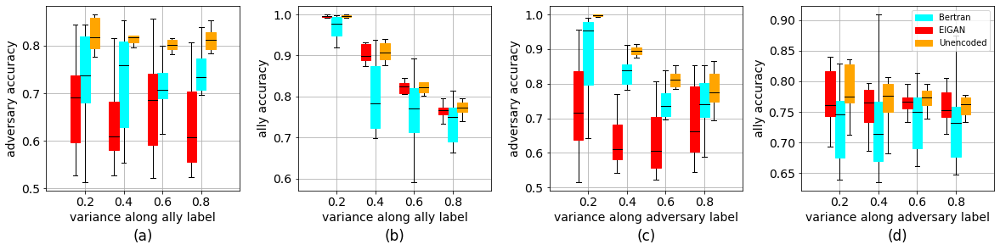

In [55]:
v1 = 6
baseline_ally = []
baseline_advr = []
eigan_ally = []
eigan_advr = []
bertran_ally = []
bertran_advr = []

for v2 in range(2, 9, 2):
    baseline_iter_ally = []
    baseline_iter_advr = []
    eigan_iter_ally = []
    eigan_iter_advr = []
    bertran_iter_ally = []
    bertran_iter_advr = []
    for run in range(0, 10):
        tmp = history['{}_{}_{}_{}_{}'.format(
            v1/10, v2/10, 'baseline', 'ally', run
        )][2]
        baseline_iter_ally.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
        tmp = history['{}_{}_{}_{}_{}'.format(
            v1/10, v2/10, 'baseline', 'advr', run
        )][2]
        baseline_iter_advr.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))

        tmp = history['{}_{}_{}_{}_{}'.format(
            v1/10, v2/10, 'eigan', 'ally', run
        )][2]
        eigan_iter_ally.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
        tmp = history['{}_{}_{}_{}_{}'.format(
            v1/10, v2/10, 'eigan', 'advr', run
        )][2]
        eigan_iter_advr.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))

        tmp = history['{}_{}_{}_{}_{}'.format(
            v1/10, v2/10, 'bertran', 'ally', run
        )][2]
        bertran_iter_ally.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
        tmp = history['{}_{}_{}_{}_{}'.format(
            v1/10, v2/10, 'bertran', 'advr', run
        )][2]
        bertran_iter_advr.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
        
    baseline_ally.append(np.array(baseline_iter_ally))
    baseline_advr.append(np.array(baseline_iter_advr))
    eigan_ally.append(np.array(eigan_iter_ally))
    eigan_advr.append(np.array(eigan_iter_advr))
    bertran_ally.append(np.array(bertran_iter_ally))
    bertran_advr.append(np.array(bertran_iter_advr))
    
    
fig, (ax2, ax1, ax4, ax3) = plt.subplots(1, 4, figsize=(20, 4))

bp1 = ax1.boxplot(bertran_ally, vert=1, whis=1.5, widths=0.05, 
                  positions=[0.2, 0.4, 0.6, 0.8], showfliers=False, patch_artist=True)
plt.setp(bp1['boxes'], color='cyan')
plt.setp(bp1['medians'], color='black')
bp2 = ax1.boxplot(eigan_ally, vert=1, whis=1.5, widths=0.05, 
                  positions=[0.15, 0.35, 0.55, 0.75], showfliers=False, patch_artist=True)
plt.setp(bp2['boxes'], color='red')
plt.setp(bp2['medians'], color='black')
bp3 = ax1.boxplot(baseline_ally, vert=1, whis=1.5, widths=0.05, 
                  positions=[0.25, 0.45, 0.65, 0.85], showfliers=False, patch_artist=True)
plt.setp(bp3['boxes'], color='orange')
plt.setp(bp3['medians'], color='black')
ax1.set_xlim(left=0, right=1)
ax1.set_title('(b)', y=-0.3)
ax1.set_xlabel('variance along ally label')
ax1.set_ylabel('ally accuracy')
ax1.set_xticks([0.2, 0.4, 0.6, 0.8])
ax1.grid()

bp1 = ax2.boxplot(bertran_advr, vert=1, whis=1.5, widths=0.05, 
                  positions=[0.2, 0.4, 0.6, 0.8], showfliers=False, patch_artist=True)
plt.setp(bp1['boxes'], color='cyan')
plt.setp(bp1['medians'], color='black')
bp2 = ax2.boxplot(eigan_advr, vert=1, whis=1.5, widths=0.05, 
                  positions=[0.15, 0.35, 0.55, 0.75], showfliers=False, patch_artist=True)
plt.setp(bp2['boxes'], color='red')
plt.setp(bp2['medians'], color='black')
bp3 = ax2.boxplot(baseline_advr, vert=1, whis=1.5, widths=0.05, 
                  positions=[0.25, 0.45, 0.65, 0.85], showfliers=False, patch_artist=True)
plt.setp(bp3['boxes'], color='orange')
plt.setp(bp3['medians'], color='black')
ax2.set_xlim(left=0, right=1)
ax2.set_title('(a)', y=-0.3)
ax2.set_xlabel('variance along ally label')
ax2.set_ylabel('adversary accuracy')
ax2.set_xticks([0.2, 0.4, 0.6, 0.8])
ax2.grid()

v2 = 8
baseline_ally = []
baseline_advr = []
eigan_ally = []
eigan_advr = []
bertran_ally = []
bertran_advr = []

for v1 in range(2, 9, 2):
    baseline_iter_ally = []
    baseline_iter_advr = []
    eigan_iter_ally = []
    eigan_iter_advr = []
    bertran_iter_ally = []
    bertran_iter_advr = []
    for run in range(0, 10):
        tmp = history['{}_{}_{}_{}_{}'.format(
            v1/10, v2/10, 'baseline', 'ally', run
        )][2]
        baseline_iter_ally.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
        tmp = history['{}_{}_{}_{}_{}'.format(
            v1/10, v2/10, 'baseline', 'advr', run
        )][2]
        baseline_iter_advr.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))

        tmp = history['{}_{}_{}_{}_{}'.format(
            v1/10, v2/10, 'eigan', 'ally', run
        )][2]
        eigan_iter_ally.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
        tmp = history['{}_{}_{}_{}_{}'.format(
            v1/10, v2/10, 'eigan', 'advr', run
        )][2]
        eigan_iter_advr.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))

        tmp = history['{}_{}_{}_{}_{}'.format(
            v1/10, v2/10, 'bertran', 'ally', run
        )][2]
        bertran_iter_ally.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
        tmp = history['{}_{}_{}_{}_{}'.format(
            v1/10, v2/10, 'bertran', 'advr', run
        )][2]
        bertran_iter_advr.append(max(tmp['svm'], tmp['logistic'], tmp['mlp']))
        
    baseline_ally.append(np.array(baseline_iter_ally))
    baseline_advr.append(np.array(baseline_iter_advr))
    eigan_ally.append(np.array(eigan_iter_ally))
    eigan_advr.append(np.array(eigan_iter_advr))
    bertran_ally.append(np.array(bertran_iter_ally))
    bertran_advr.append(np.array(bertran_iter_advr))
    
bp1 = ax3.boxplot(bertran_ally, vert=1, whis=1.5, widths=0.05, 
                  positions=[0.2, 0.4, 0.6, 0.8], showfliers=False, patch_artist=True)
plt.setp(bp1['boxes'], color='cyan')
plt.setp(bp1['medians'], color='black')
bp2 = ax3.boxplot(eigan_ally, vert=1, whis=1.5, widths=0.05, 
                  positions=[0.15, 0.35, 0.55, 0.75], showfliers=False, patch_artist=True)
plt.setp(bp2['boxes'], color='red')
plt.setp(bp2['medians'], color='black')
bp3 = ax3.boxplot(baseline_ally, vert=1, whis=1.5, widths=0.05, 
                  positions=[0.25, 0.45, 0.65, 0.85], showfliers=False, patch_artist=True)
plt.setp(bp3['boxes'], color='orange')
plt.setp(bp3['medians'], color='black')
ax3.legend([bp1["boxes"][0], bp2["boxes"][0], bp3["boxes"][0]], 
           ['Bertran', 'EIGAN', 'Unencoded'], loc='upper right', prop={'size':10})
ax3.set_xlim(left=0, right=1)
ax3.set_title('(d)', y=-0.3)
ax3.set_xlabel('variance along adversary label')
ax3.set_ylabel('ally accuracy')
ax3.set_xticks([0.2, 0.4, 0.6, 0.8])
ax3.grid()

bp1 = ax4.boxplot(bertran_advr, vert=1, whis=1.5, widths=0.05, 
                  positions=[0.2, 0.4, 0.6, 0.8], showfliers=False, patch_artist=True)
plt.setp(bp1['boxes'], color='cyan')
plt.setp(bp1['medians'], color='black')
bp2 = ax4.boxplot(eigan_advr, vert=1, whis=1.5, widths=0.05, 
                  positions=[0.15, 0.35, 0.55, 0.75], showfliers=False, patch_artist=True)
plt.setp(bp2['boxes'], color='red')
plt.setp(bp2['medians'], color='black')
bp3 = ax4.boxplot(baseline_advr, vert=1, whis=1.5, widths=0.05, 
                  positions=[0.25, 0.45, 0.65, 0.85], showfliers=False, patch_artist=True)
plt.setp(bp3['boxes'], color='orange')
plt.setp(bp3['medians'], color='black')
ax4.set_xlim(left=0, right=1)
ax4.set_title('(c)', y=-0.3)
ax4.set_xlabel('variance along adversary label')
ax4.set_ylabel('adversary accuracy')
ax4.set_xticks([0.2, 0.4, 0.6, 0.8])
ax4.grid()

plt.rcParams.update({'font.size': 14})
fig.subplots_adjust(wspace=0.3)
plt.savefig('gaussian_bertran_comparison.png', bbox_inches='tight', dpi=300)

plt.show()